In [45]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.model_zoo as model_zoo
import os
import torch
from torch.utils import data
from PIL import Image
import numpy as np
from torchvision import transforms

In [39]:
import torch
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision

class ResidualBlock(nn.Module):
    """
    子 module: Residual Block ---- ResNet 中一个跨层直连的单元
    """
    def __init__(self, inchannel, outchannel, stride=1):
        super(ResidualBlock, self).__init__()
        self.left = nn.Sequential(
            nn.Conv2d(inchannel, outchannel, kernel_size=3, stride=stride, padding=1, bias=False),
            nn.BatchNorm2d(outchannel),
            nn.ReLU(inplace=True),
            nn.Conv2d(outchannel, outchannel, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(outchannel)
        )
        self.shortcut = nn.Sequential()
        # 如果输入和输出的通道不一致，或其步长不为 1，需要将二者转成一致
        if stride != 1 or inchannel != outchannel:
            self.shortcut = nn.Sequential(
                nn.Conv2d(inchannel, outchannel, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(outchannel)
            )

    def forward(self, x):
        out = self.left(x)
        out += self.shortcut(x)  # 输出 + 输入
        out = F.relu(out)
        return out


class ResNet(nn.Module):
    """
    实现主 module: ResNet-18
    ResNet 包含多个 layer, 每个 layer 又包含多个 residual block (上面实现的类)
    因此, 用 ResidualBlock 实现 Residual 部分，用 _make_layer 函数实现 layer
    """
    def __init__(self, ResidualBlock, num_classes=10):
        super(ResNet, self).__init__()
        self.inchannel = 64
        # 最开始的操作
        self.conv1 = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(),
        )
        # 四个 layer， 对应 2， 3， 4， 5 层， 每层有两个 residual block
        self.layer1 = self._make_layer(ResidualBlock, 64,  2, stride=1)
        self.layer2 = self._make_layer(ResidualBlock, 128, 2, stride=2)
        self.layer3 = self._make_layer(ResidualBlock, 256, 2, stride=2)
        self.layer4 = self._make_layer(ResidualBlock, 512, 2, stride=2)
        # 最后的全连接，分类时使用
        self.fc = nn.Linear(512, num_classes)

    def _make_layer(self, block, channels, num_blocks, stride):
        """
        构建 layer, 每一个 layer 由多个 residual block 组成
        在 ResNet 中，每一个 layer 中只有两个 residual block
        """
        layers = []
        for i in range(num_blocks):
            if i == 0:  # 第一个是输入的 stride
                layers.append(block(self.inchannel, channels, stride))
            else:    # 后面的所有 stride，都置为 1
                layers.append(block(channels, channels, 1))
            self.inchannel = channels
        return nn.Sequential(*layers)  # 时序容器。Modules 会以他们传入的顺序被添加到容器中。

    def forward(self, x):
        # 最开始的处理
        out = self.conv1(x)
        # 四层 layer
        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        # 全连接 输出分类信息
        out = F.avg_pool2d(out, 4)
        out = out.view(out.size(0), -1)
        out = self.fc(out)
        return out


def Accuracy(testloader, net, device):
    # 使用测试数据测试网络
    correct = 0
    total = 0
    with torch.no_grad():
        for data in testloader:
            images, labels = data
            # 将输入和目标在每一步都送入GPU
            images, labels = images.to(device), labels.to(device)
            outputs = net(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    print('Accuracy of the network on the 10000 test images: %d %%' % (
        100 * correct / total))
    return 100.0 * correct / total


def run(device):
    # 超参数设置
    # 批处理尺寸(batch_size)
    BATCH_SIZE = 128
    # 学习率
    LR = 0.1
    # 加载数据集
    # 标准化为范围在[-1, 1]之间的张量
    transform = transforms.Compose([transforms.ToTensor(),
                                    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
    # 训练集
    trainset = torchvision.datasets.CIFAR10(root='./data', train=True, transform=transform)  # 训练数据集
    # 生成一个个batch进行批训练，组成batch的时候顺序打乱取
    trainloader = torch.utils.data.DataLoader(trainset, batch_size=BATCH_SIZE, shuffle=True)
    # 测试集
    testset = torchvision.datasets.CIFAR10(root='./data', train=False, transform=transform)
    testloader = torch.utils.data.DataLoader(testset, batch_size=100, shuffle=False)
    # Cifar-10的标签
    # 建立神经网络
    net = ResNet(ResidualBlock).to(device)
    # 定义损失函数
    criterion = nn.CrossEntropyLoss()  # 损失函数为交叉熵，多用于多分类问题
    # 优化方式为mini-batch momentum-SGD，并采用L2正则化（权重衰减）
    optimizer = optim.SGD(net.parameters(), lr=LR, momentum=0.9, weight_decay=5e-4)
    # 训练网络
    # loop over the dataset multiple times
    for epoch in range(5):
        running_loss = 0.0
        for i, data in enumerate(trainloader, 0):
            # 取数据
            inputs, labels = data
            inputs, labels = inputs.to(device), labels.to(device)  # 将输入和目标在每一步都送入GPU
            # 将梯度置零
            optimizer.zero_grad()
            # 训练
            outputs = net(inputs)
            loss = criterion(outputs, labels).to(device)
            loss.backward()  # 反向传播
            optimizer.step()  # 优化
            # 统计数据
            running_loss += loss.item()
            if i >= 0:  # 每 2000 张图片，打印一次
                print('[%d, %5d] loss: %.3f' % (epoch + 1, i + 1, running_loss / 2000))
                running_loss = 0.0
                acc = Accuracy(testloader, net, device)

In [92]:
import matplotlib.pyplot as plt
import numpy as np
import os
transform = transforms.Compose([
 transforms.RandomResizedCrop(32),
 transforms.ToTensor(), # 将图片转换为Tensor,归一化至[0,1]
 transforms.Normalize(mean=[.5, .5, .5], std=[.5, .5, .5]) # 标准化至[-1,1]
])

#定义自己的数据集合
class FlameSet(torch.utils.data.Dataset):
    def __init__(self,root):
      # 所有图片的绝对路径
        imgs=os.listdir(root)
        self.imgs=[os.path.join(root,k) for k in imgs]
        self.transforms=transform

    def __getitem__(self, index):
        img_path = self.imgs[index]
        try:
            data,label,name= self.make(img_path)
            return data,label,name
        except:
            data,label,name = self.make(self.imgs[0])
            os.remove(img_path)
            return data,label,name
    
    def make(self,img_path):
        name = os.path.basename(img_path)
        label = name.split('.')[0].split('_')[0]
        pil_img = Image.open(img_path)
        if self.transforms:
            data = self.transforms(pil_img)
        else:
            pil_img = np.asarray(pil_img)
            data = torch.from_numpy(pil_img)
        return data,torch.tensor(int(label)),name
            
    
    
    def __len__(self):
        return len(self.imgs)


0
tensor([5, 2, 5, 5, 0, 6, 4, 3, 0, 4, 5, 1, 4, 2, 4, 2, 4, 5, 3, 5, 4, 6, 5, 2,
        3, 6, 1, 2, 2, 5, 4, 5, 5, 5, 2, 5, 4, 0, 0, 5, 2, 1, 2, 5, 0, 5, 2, 5,
        1, 0, 4, 0, 2, 5, 4, 6, 4, 6, 5, 2, 0, 1, 0, 3])
(64, 3, 32, 32)
('5_14.jpg', '2_936.jpg', '5_2244.jpg', '5_209.jpg', '0_2919.jpg', '6_1093.jpg', '4_1981.jpg', '3_1270.jpg', '0_358.jpg', '4_1759.jpg', '5_2522.jpg', '1_1009.png', '4_2250.jpg', '2_1502.jpg', '4_2244.jpg', '2_1516.jpg', '4_1995.jpg', '5_3628.jpg', '3_1264.jpg', '5_2536.jpg', '4_768.jpg', '6_1939.jpg', '5_2250.jpg', '2_922.jpg', '3_1502.jpg', '6_1087.jpg', '1_639.jpg', '2_2779.jpg', '2_1270.jpg', '5_1981.jpg', '4_2522.jpg', '5_1759.jpg', '5_2278.jpg', '5_28.jpg', '2_2989.jpg', '5_235.jpg', '4_1003.jpg', '0_2925.jpg', '0_402.jpg', '5_3166.jpg', '2_2751.jpg', '1_611.jpg', '2_1258.jpg', '5_1771.jpg', '0_1592.jpg', '5_1017.jpg', '2_2037.jpg', '5_3600.jpg', '1_177.jpg', '0_3385.jpg', '4_998.jpg', '0_364.jpg', '2_21.jpg', '5_553.jpg', '4_1765.jpg', '6_1911.jpg',

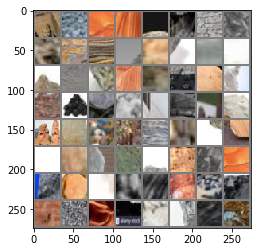

1
tensor([5, 2, 4, 4, 6, 6, 0, 5, 4, 5, 5, 4, 0, 0, 0, 2, 5, 1, 0, 6, 5, 6, 0, 5,
        1, 2, 6, 5, 3, 4, 0, 4, 1, 3, 0, 4, 6, 0, 4, 6, 4, 0, 6, 0, 4, 5, 2, 0,
        0, 0, 5, 1, 2, 0, 3, 6, 2, 3, 2, 0, 6, 5, 4, 0])
(64, 3, 32, 32)
('5_547.jpg', '2_35.jpg', '4_1771.jpg', '4_754.jpg', '6_1905.jpg', '6_484.jpg', '0_1586.jpg', '5_1003.jpg', '4_2278.jpg', '5_1765.jpg', '5_221.jpg', '4_1017.jpg', '0_4398.jpg', '0_416.jpg', '0_2931.jpg', '2_2745.jpg', '5_3172.jpg', '1_605.jpg', '0_4373.jpg', '6_1050.jpg', '5_3199.jpg', '6_309.jpg', '0_2702.jpg', '5_2287.jpg', '1_836.jpg', '2_2976.jpg', '6_2559.jpg', '5_1956.jpg', '3_1066.png', '4_2293.jpg', '0_2064.jpg', '4_1942.jpg', '1_188.jpg', '3_258.jpg', '0_4415.jpg', '4_967.jpg', '6_1736.jpg', '0_2070.jpg', '4_1956.jpg', '6_1722.jpg', '4_973.jpg', '0_4401.jpg', '6_965.jpeg', '0_1579.jpg', '4_2287.jpg', '5_1942.jpg', '2_739.jpg', '0_4367.jpg', '0_3408.jpg', '0_2716.jpg', '5_2293.jpg', '1_822.jpg', '2_2962.jpg', '0_1237.jpg', '3_697.JPEG', '6_2565.jp

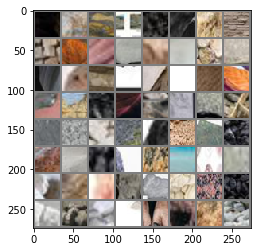

2
tensor([6, 3, 0, 0, 0, 6, 0, 0, 6, 5, 4, 6, 0, 6, 2, 6, 2, 0, 6, 6, 2, 3, 0, 4,
        6, 5, 5, 2, 6, 2, 1, 5, 6, 3, 0, 5, 4, 4, 1, 6, 2, 4, 1, 3, 2, 6, 3, 0,
        3, 0, 4, 5, 2, 5, 3, 5, 6, 2, 0, 4, 6, 0, 4, 4])
(64, 3, 32, 32)
('6_453.jpg', '3_264.jpg', '0_3588.jpeg', '0_3346.jpg', '0_4429.jpg', '6_2203.jpg', '0_1551.jpg', '0_1545.jpg', '6_3109.jpg', '5_584.jpg', '4_797.jpg', '6_447.jpg', '0_3352.jpg', '6_1078.jpg', '2_705.jpg', '6_573.jpeg', '2_2786.jpg', '0_1223.jpg', '6_2290.jpeg', '6_2571.jpg', '2_1700.jpg', '3_910.JPEG', '0_1974.jpg', '4_2052.jpg', '6_79.jpg', '5_1229.jpg', '5_2720.jpg', '2_3117.jpg', '6_876.jpg', '2_2209.jpg', '1_349.jpg', '5_3358.jpg', '6_1291.jpg', '3_1714.jpg', '0_3805.jpg', '5_2046.jpg', '4_218.jpg', '4_2734.jpg', '1_70.jpg', '6_2798.jpg', '2_1066.jpg', '4_2720.jpg', '1_64.jpg', '3_1734.jpeg', '2_1072.jpg', '6_1285.jpg', '3_1700.jpg', '0_628.jpg', '3_933.jpg', '0_3811.jpg', '4_1229.jpg', '5_2052.jpg', '2_3103.jpg', '5_2734.jpg', '3_443.JPEG', '5_779.j

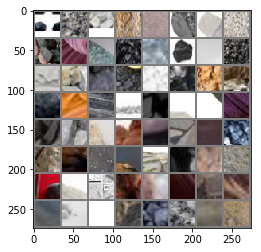

3
tensor([5, 0, 0, 1, 5, 2, 3, 0, 0, 5, 6, 0, 5, 2, 4, 3, 1, 2, 6, 0, 3, 4, 0, 4,
        1, 5, 2, 0, 4, 4, 5, 6, 1, 2, 5, 0, 6, 6, 4, 5, 4, 5, 0, 1, 0, 2, 5, 6,
        2, 0, 5, 0, 0, 4, 4, 3, 3, 0, 6, 5, 0, 0, 0, 6])
(64, 3, 32, 32)
('5_751.jpg', '0_166.jpg', '0_3187.jpg', '1_375.jpg', '5_3402.jpg', '2_2235.jpg', '3_1671.JPEG', '0_1948.jpg', '0_1624.jpeg', '5_1215.jpg', '6_45.jpg', '0_1790.jpg', '5_1573.jpg', '2_2510.webp', '4_2708.jpg', '3_516.png', '1_413.jpg', '2_2553.jpg', '6_1687.jpeg', '0_600.jpg', '3_1728.jpg', '4_1201.jpg', '0_3839.jpg', '4_224.jpg', '1_407.jpg', '5_3370.jpg', '2_2547.jpg', '0_614.jpg', '4_1215.jpg', '4_230.jpg', '5_1567.jpg', '6_2968.jpg', '1_58.jpg', '2_1728.jpg', '5_1201.jpg', '0_1784.jpg', '6_51.jpg', '6_686.jpg', '4_556.jpg', '5_2708.jpg', '4_1573.jpg', '5_745.jpg', '0_172.jpg', '1_361.jpg', '0_3193.jpg', '2_2221.jpg', '5_3416.jpg', '6_1534.jpg', '2_249.jpg', '0_199.jpg', '5_976.jpg', '0_3178.jpg', '0_2266.jpg', '4_1598.jpg', '4_2091.jpg', '3_1108.JPEG',

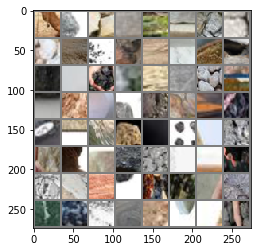

4
tensor([0, 5, 0, 0, 0, 6, 5, 4, 6, 3, 6, 5, 0, 6, 2, 0, 6, 6, 6, 2, 6, 5, 0, 6,
        4, 1, 5, 0, 6, 0, 2, 3, 2, 2, 4, 0, 6, 0, 4, 0, 3, 6, 0, 0, 2, 0, 2, 5,
        2, 0, 6, 4, 1, 5, 2, 6, 0, 6, 4, 0, 2, 3, 6, 3])
(64, 3, 32, 32)
('0_4171.jpg', '5_2091.jpg', '0_833.jpg', '0_2514.jpg', '0_4165.jpg', '6_1246.jpg', '5_1598.jpg', '4_2085.jpg', '6_2029.jpg', '3_56.jpeg', '6_1520.jpg', '5_962.jpg', '0_2272.jpg', '6_679.jpg', '2_1927.jpg', '0_1753.jpg', '6_86.jpg', '6_2001.jpg', '6_889.jpg', '2_275.jpg', '6_1508.jpg', '5_2907.jpg', '0_3144.jpg', '6_651.jpg', '4_581.jpg', '1_1021.jpg', '5_792.jpg', '0_2264.jpeg', '6_137.jpg', '0_3622.jpg', '2_2590.jpg', '3_700.jpg', '2_513.jpg', '2_1099.jpg', '4_2913.jpg', '0_1035.jpg', '6_2773.jpg', '0_1018.jpeg', '4_2907.jpg', '0_1021.jpg', '3_290.jpeg', '6_123.jpg', '0_2528.jpg', '0_3636.jpg', '2_2584.jpg', '0_4159.jpg', '2_507.jpg', '5_2913.jpg', '2_261.jpg', '0_3150.jpg', '6_645.jpg', '4_595.jpg', '1_1035.jpg', '5_786.jpg', '2_1933.jpg', '6_92.jpg', 

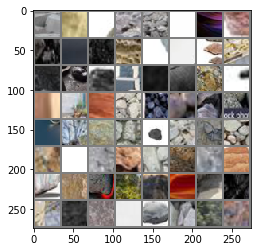

5
tensor([6, 3, 5, 5, 2, 5, 0, 3, 0, 4, 2, 3, 0, 4, 2, 4, 6, 2, 4, 6, 5, 4, 0, 3,
        0, 5, 4, 2, 1, 5, 6, 6, 3, 2, 5, 5, 4, 0, 2, 1, 5, 2, 3, 4, 5, 4, 5, 5,
        6, 2, 2, 5, 0, 4, 4, 5, 0, 0, 1, 4, 2, 5, 4, 4])
(64, 3, 32, 32)
('6_902.jpg', '3_455.JPEG', '5_619.jpg', '5_2654.jpg', '2_3063.jpg', '5_2132.jpg', '0_990.jpg', '3_853.jpg', '0_3971.jpg', '4_1349.jpg', '2_498.jpg', '3_1660.jpg', '0_748.jpg', '4_2898.jpg', '2_1112.jpg', '4_2640.jpg', '6_2834.jpg', '2_1106.jpg', '4_2654.jpg', '6_2820.jpg', '5_2126.jpg', '4_378.jpg', '0_984.jpg', '3_847.jpg', '0_3965.jpg', '5_3238.jpg', '4_68.jpg', '2_2369.jpg', '1_229.jpg', '5_2898.jpg', '6_1497.jpg', '6_916.jpg', '3_1112.jpg', '2_3077.jpg', '5_2640.jpg', '5_1349.jpg', '4_2132.jpg', '0_1814.jpg', '2_1660.jpg', '1_201.jpg', '5_3576.jpg', '2_2341.jpg', '3_49.jpg', '4_1413.jpg', '5_625.jpg', '4_436.jpg', '5_2668.jpg', '5_1361.jpg', '6_2547.jpeg', '2_1890.jpg', '2_1648.jpg', '5_1407.jpg', '0_1182.jpg', '4_350.jpg', '4_1375.jpg', '5_143.jpg',

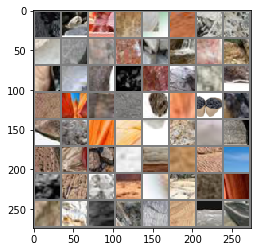

6
tensor([0, 5, 0, 4, 3, 1, 0, 5, 2, 4, 5, 0, 5, 2, 3, 0, 1, 2, 5, 4, 5, 4, 6, 5,
        0, 6, 5, 5, 6, 4, 0, 6, 1, 0, 0, 6, 0, 0, 0, 3, 4, 0, 6, 6, 5, 0, 5, 0,
        6, 2, 6, 0, 2, 6, 0, 3, 2, 5, 2, 0, 2, 4, 0, 0])
(64, 3, 32, 32)
('0_3959.jpg', '5_157.jpg', '0_760.jpg', '4_54.jpg', '3_1237.JPEG', '1_573.jpg', '0_3781.jpg', '5_3204.jpg', '2_2433.jpg', '4_2668.jpg', '5_1413.jpg', '0_1196.jpg', '5_1375.jpg', '2_1884.jpg', '3_1667.JPEG', '0_1828.jpg', '1_215.jpg', '2_2355.jpg', '5_3562.jpg', '4_1407.jpg', '5_631.jpg', '4_422.jpg', '6_3082.png', '5_2697.jpg', '0_2312.jpg', '6_719.jpg', '5_802.jpg', '5_3589.jpg', '6_1440.jpg', '4_2683.jpg', '0_4005.jpg', '6_1326.jpg', '1_598.jpg', '0_953.jpg', '0_2474.jpg', '6_1332.jpg', '0_4011.jpg', '0_2460.jpg', '0_947.jpg', '3_884.jpg', '4_2697.jpg', '0_1169.jpg', '6_1412.jpeg', '6_924.jpeg', '5_2683.jpg', '0_2306.jpg', '5_816.jpg', '0_3018.jpg', '6_1454.jpg', '2_329.jpg', '6_2175.jpg', '0_1627.jpg', '2_1853.jpg', '6_725.jpg', '0_3030.jpg', '3_112.j

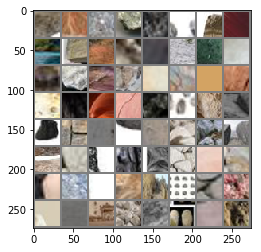

7
tensor([4, 5, 0, 4, 1, 6, 0, 4, 6, 2, 0, 4, 3, 4, 5, 6, 2, 0, 2, 3, 2, 6, 5, 3,
        0, 2, 5, 4, 0, 3, 2, 1, 3, 2, 3, 1, 5, 2, 5, 4, 6, 3, 6, 2, 4, 2, 4, 5,
        4, 0, 0, 6, 3, 0, 1, 5, 2, 5, 3, 4, 2, 5, 2, 1])
(64, 3, 32, 32)
('4_393.jpg', '5_180.jpg', '0_1141.jpg', '4_2867.jpg', '1_771.png', '6_2613.jpg', '0_1155.jpg', '4_2873.jpg', '6_2607.jpg', '2_473.jpg', '0_3742.jpg', '4_97.jpg', '3_660.jpg', '4_387.jpg', '5_194.jpg', '6_731.jpg', '2_3088.jpg', '0_3024.jpg', '2_2396.jpg', '3_106.jpg', '2_315.jpg', '6_1468.jpg', '5_2867.jpg', '3_1338.png', '0_1633.jpg', '2_1847.jpg', '5_1639.jpg', '4_2442.jpg', '0_18.jpg', '3_951.JPEG', '2_1310.jpg', '1_759.jpg', '3_489.jpg', '2_2619.jpg', '3_1462.jpg', '1_981.jpg', '5_2330.jpg', '2_842.jpg', '5_2456.jpg', '4_608.jpg', '6_1859.jpg', '3_1304.jpg', '6_1681.jpg', '2_1476.jpg', '4_2324.jpg', '2_1462.jpg', '4_2330.jpg', '5_2442.jpg', '4_1639.jpg', '0_4522.jpeg', '0_238.jpg', '6_1695.jpg', '3_1476.jpg', '0_2879.jpg', '1_995.jpg', '5_369.jpg', '

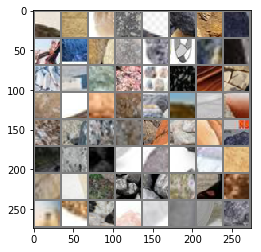

8
tensor([0, 0, 0, 5, 4, 4, 0, 6, 0, 5, 4, 4, 5, 4, 6, 5, 4, 3, 6, 0, 2, 6, 4, 5,
        4, 0, 2, 4, 3, 5, 0, 5, 0, 2, 2, 5, 0, 2, 0, 0, 5, 4, 5, 6, 1, 4, 2, 0,
        2, 0, 2, 6, 0, 5, 4, 0, 3, 6, 4, 0, 4, 0, 5, 0])
(64, 3, 32, 32)
('0_3597.jpg', '0_576.jpg', '0_2851.jpg', '5_341.jpg', '4_1177.jpg', '4_152.jpg', '0_2689.jpg', '6_282.jpg', '0_1380.jpg', '5_1605.jpg', '4_3006.jpg', '4_2318.jpg', '5_1163.jpg', '4_634.jpg', '6_1865.jpg', '5_427.jpg', '4_1611.jpg', '3_547.JPEG', '6_2161.png', '0_210.jpg', '2_2143.jpg', '6_1871.jpg', '4_620.jpg', '5_433.jpg', '4_1605.jpg', '0_204.jpg', '2_2157.jpg', '4_3012.jpg', '3_814.JPEG', '5_1177.jpg', '0_1394.jpg', '5_1611.jpg', '0_30.jpg', '2_1338.jpg', '2_2631.jpg', '5_3006.jpg', '0_3583.jpg', '2_1687.webp', '0_2845.jpg', '0_562.jpg', '5_355.jpg', '4_1163.jpg', '5_2318.jpg', '6_296.jpg', '1_942.jpg', '4_1188.jpg', '2_2802.jpg', '0_2676.jpg', '2_881.jpg', '0_589.jpg', '2_659.jpg', '6_1124.jpg', '0_4207.jpg', '5_1822.jpg', '4_2481.jpg', '0_1419.jpg'

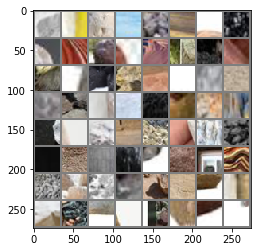

9
tensor([4, 6, 4, 3, 0, 5, 6, 5, 6, 3, 5, 4, 1, 2, 6, 0, 2, 0, 6, 6, 0, 5, 4, 6,
        3, 6, 0, 6, 2, 0, 2, 2, 3, 0, 6, 6, 2, 6, 0, 6, 0, 2, 3, 2, 0, 0, 6, 6,
        5, 4, 6, 3, 0, 2, 0, 3, 0, 6, 0, 6, 6, 0, 2, 0])
(64, 3, 32, 32)
('4_807.jpg', '6_1656.jpg', '4_1822.jpg', '3_338.jpg', '0_2104.jpg', '5_2481.jpg', '6_3041.jpg', '5_1188.jpg', '6_2439.jpg', '3_17.JPEG', '5_1836.jpg', '4_2495.jpg', '1_956.jpg', '2_2816.jpg', '6_269.jpg', '0_2662.jpg', '2_895.jpg', '0_4213.jpg', '6_1130.jpg', '6_2286.jpeg', '0_1343.jpg', '5_382.jpg', '4_191.jpg', '6_241.jpg', '3_476.jpg', '6_1853.jpeg', '0_3554.jpg', '6_1118.jpg', '2_665.jpg', '0_2892.jpg', '2_103.jpg', '2_2180.jpg', '3_310.jpg', '0_3232.jpg', '6_527.jpg', '6_3069.jpg', '2_1489.jpg', '6_2377.jpg', '0_1431.jpg', '6_2363.jpg', '0_4549.jpg', '2_117.jpg', '3_304.jpg', '2_2194.jpg', '0_3226.jpg', '0_2138.jpg', '6_533.jpg', '6_1150.jpeg', '5_396.jpg', '4_185.jpg', '6_255.jpg', '3_462.jpg', '0_3540.jpg', '2_671.jpg', '0_2886.jpg', '3_1489.jpg',

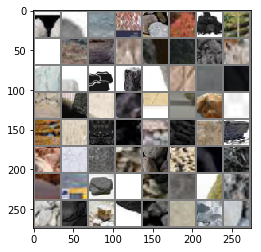

10
tensor([6, 0, 0, 6, 0, 3, 2, 0, 3, 6, 4, 5, 2, 6, 0, 3, 6, 4, 5, 0, 6, 6, 2, 0,
        6, 6, 0, 2, 3, 2, 5, 6, 5, 0, 3, 4, 0, 6, 4, 0, 2, 0, 6, 2, 1, 0, 4, 3,
        6, 5, 4, 5, 6, 2, 0, 0, 0, 2, 0, 2, 1, 4, 5, 0])
(64, 3, 32, 32)
('6_2362.jpg', '0_1430.jpg', '0_1356.jpg', '6_2404.jpg', '0_2887.jpg', '3_1488.jpg', '2_670.jpg', '0_3541.jpg', '3_463.jpg', '6_254.jpg', '4_184.jpg', '5_397.jpg', '2_664.jpg', '6_1119.jpg', '0_3555.jpg', '3_477.jpg', '6_240.jpg', '4_190.jpg', '5_383.jpg', '0_1342.jpg', '6_2410.jpg', '6_2376.jpg', '2_1488.jpg', '0_1424.jpg', '6_772.jpeg', '6_526.jpg', '0_3233.jpg', '2_2181.jpg', '3_311.jpg', '2_102.jpg', '5_1189.jpg', '6_3040.jpg', '5_2480.jpg', '0_2105.jpg', '3_339.jpg', '4_1823.jpg', '0_4574.jpg', '6_1657.jpg', '4_806.jpg', '0_4212.jpg', '2_894.jpg', '0_2663.jpg', '6_268.jpg', '2_2817.jpg', '1_957.jpg', '0_3970.png', '4_2494.jpg', '3_880.JPEG', '6_2438.jpg', '5_1837.jpg', '4_2480.jpg', '5_1823.jpg', '6_1125.jpg', '2_658.jpg', '0_4206.jpg', '0_588.jpg',

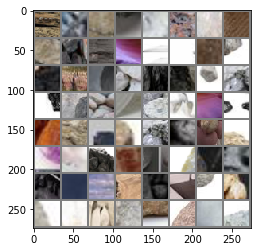

11
tensor([4, 4, 6, 0, 0, 6, 5, 4, 2, 0, 4, 5, 4, 6, 6, 4, 5, 4, 5, 0, 0, 2, 5, 2,
        0, 5, 0, 3, 0, 5, 0, 6, 0, 4, 4, 5, 0, 0, 0, 1, 5, 2, 2, 0, 4, 5, 6, 6,
        4, 5, 4, 4, 6, 3, 0, 4, 5, 4, 6, 2, 2, 4, 2, 5])
(64, 3, 32, 32)
('4_1837.jpg', '4_812.jpg', '6_1643.jpg', '0_4560.jpg', '0_1418.jpg', '6_3054.jpg', '5_1176.jpg', '4_3013.jpg', '2_2156.jpg', '0_205.jpg', '4_1604.jpg', '5_432.jpg', '4_621.jpg', '6_1870.jpg', '6_297.jpg', '4_147.jpg', '5_2319.jpg', '4_1162.jpg', '5_354.jpg', '0_563.jpg', '0_3582.jpg', '2_2630.jpg', '5_3007.jpg', '2_1339.jpg', '0_31.jpg', '5_1610.jpg', '0_1395.jpg', '3_661.png', '0_25.jpg', '5_1604.jpg', '0_1381.jpg', '6_283.jpg', '0_2688.jpg', '4_153.jpg', '4_1176.jpg', '5_340.jpg', '0_2850.jpg', '0_577.jpg', '0_3596.jpg', '1_764.jpg', '5_3013.jpg', '2_2624.jpg', '2_2142.jpg', '0_211.jpg', '4_1610.jpg', '5_426.jpg', '6_1081.jpeg', '6_1864.jpg', '4_635.jpg', '5_1162.jpg', '4_2319.jpg', '4_3007.jpg', '6_1694.jpg', '3_1311.jpg', '0_239.jpg', '4_1638.jpg', 

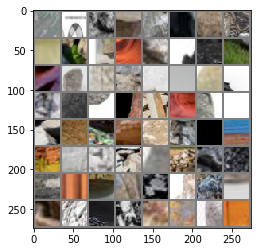

12
tensor([5, 1, 3, 0, 5, 2, 1, 3, 3, 2, 1, 2, 0, 4, 2, 5, 4, 6, 2, 6, 3, 5, 6, 4,
        5, 4, 0, 4, 2, 6, 4, 3, 3, 2, 0, 6, 6, 2, 5, 2, 3, 0, 2, 5, 2, 3, 2, 0,
        6, 2, 0, 6, 0, 6, 1, 4, 5, 4, 0, 3, 4, 0, 0, 2])
(64, 3, 32, 32)
('5_368.jpg', '1_994.jpg', '3_1477.jpg', '0_2878.jpg', '5_2331.jpg', '2_843.jpg', '1_980.jpg', '3_1463.jpg', '3_488.jpg', '2_2618.jpg', '1_758.jpg', '2_1311.jpg', '0_19.jpg', '4_2443.jpg', '2_893.webp', '5_1638.jpg', '4_2325.jpg', '6_2389.jpg', '2_1477.jpg', '6_1680.jpg', '3_1305.jpg', '5_2457.jpg', '6_1858.jpg', '4_609.jpg', '5_195.jpg', '4_386.jpg', '0_3743.jpg', '4_96.jpg', '2_472.jpg', '6_2606.jpg', '4_2872.jpg', '3_992.JPEG', '3_838.JPEG', '2_1846.jpg', '0_1632.jpg', '6_2160.jpg', '6_1469.jpg', '2_314.jpg', '5_2866.jpg', '2_2397.jpg', '3_107.jpg', '0_3025.jpg', '2_3089.jpg', '5_2872.jpg', '2_300.jpg', '3_113.jpg', '2_2383.jpg', '0_3031.jpg', '6_724.jpg', '2_1852.jpg', '0_1626.jpg', '6_2174.jpg', '0_2844.png', '6_2612.jpg', '1_770.png', '4_2866.jpg',

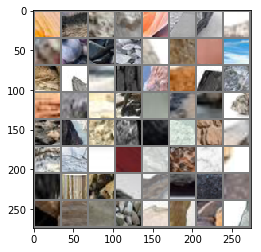

13
tensor([5, 0, 4, 3, 0, 0, 6, 0, 2, 6, 0, 5, 0, 6, 5, 6, 6, 5, 5, 6, 0, 5, 3, 0,
        0, 1, 3, 0, 5, 6, 4, 5, 4, 5, 2, 4, 0, 1, 0, 0, 3, 5, 4, 0, 4, 4, 5, 4,
        2, 5, 1, 0, 2, 3, 5, 0, 2, 2, 5, 4, 5, 5, 4, 3])
(64, 3, 32, 32)
('5_2653.webp', '0_1168.jpg', '4_2696.jpg', '3_885.jpg', '0_946.jpg', '0_2461.jpg', '6_1333.jpg', '0_4010.jpg', '2_328.jpg', '6_1455.jpg', '0_3019.jpg', '5_817.jpg', '0_2307.jpg', '6_1605.jpeg', '5_2682.jpg', '6_3097.png', '6_2148.jpg', '5_803.jpg', '5_3588.jpg', '6_718.jpg', '0_2313.jpg', '5_2696.jpg', '3_891.jpg', '0_2475.jpg', '0_952.jpg', '1_599.jpg', '3_649.jpg', '0_4004.jpg', '5_3412.webp', '6_1327.jpg', '4_2682.jpg', '5_1412.jpg', '4_2669.jpg', '5_3205.jpg', '2_2432.jpg', '4_55.jpg', '0_3780.jpg', '1_572.jpg', '0_1425.jpeg', '0_761.jpg', '3_1649.jpg', '5_156.jpg', '4_1360.jpg', '0_3958.jpg', '4_345.jpg', '4_423.jpg', '5_630.jpg', '4_1406.jpg', '2_2354.jpg', '5_3563.jpg', '1_214.jpg', '0_1829.jpg', '2_1885.jpg', '3_1020.JPEG', '5_1374.jpg', '0_3227

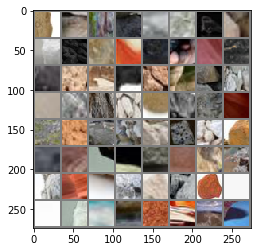

14
tensor([5, 2, 1, 2, 5, 1, 0, 4, 0, 5, 4, 4, 0, 5, 6, 4, 5, 3, 0, 3, 0, 5, 4, 6,
        4, 2, 2, 0, 4, 5, 2, 5, 6, 3, 5, 3, 6, 1, 2, 5, 2, 5, 3, 6, 6, 3, 2, 4,
        6, 4, 2, 4, 3, 3, 0, 2, 4, 0, 5, 0, 2, 2, 0, 0])
(64, 3, 32, 32)
('5_3577.jpg', '2_2340.jpg', '1_200.jpg', '2_2426.jpg', '5_3211.jpg', '1_566.jpg', '0_3794.jpg', '4_41.jpg', '0_775.jpg', '5_142.jpg', '4_1374.jpg', '4_351.jpg', '0_1183.jpg', '5_1406.jpg', '6_2809.jpg', '4_69.jpg', '5_3239.jpg', '3_1675.jpg', '0_3964.jpg', '3_846.jpg', '0_985.jpg', '5_2127.jpg', '4_379.jpg', '6_2821.jpg', '4_2655.jpg', '2_1107.jpg', '2_1661.jpg', '0_1815.jpg', '4_2133.jpg', '5_1348.jpg', '2_3076.jpg', '5_2641.jpg', '6_917.jpg', '3_1113.jpg', '5_2899.jpg', '3_60.jpg', '6_1496.jpg', '1_228.jpg', '2_2368.jpg', '5_2655.jpg', '2_3062.jpg', '5_618.jpg', '3_1107.jpg', '6_903.jpg', '6_1482.jpg', '3_74.jpg', '2_1675.jpg', '4_2127.jpg', '6_2835.jpg', '4_2641.jpg', '2_1113.jpg', '4_2899.jpg', '3_1165.JPEG', '3_1661.jpg', '0_749.jpg', '2_499.jpg', 

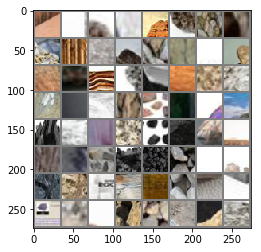

15
tensor([6, 4, 6, 6, 6, 0, 2, 5, 1, 4, 6, 0, 0, 2, 3, 5, 1, 4, 6, 0, 6, 2, 5, 6,
        6, 0, 6, 2, 0, 4, 2, 6, 2, 2, 0, 6, 5, 3, 0, 6, 3, 0, 0, 5, 1, 6, 0, 5,
        6, 6, 4, 4, 4, 0, 0, 5, 0, 2, 6, 0, 0, 0, 5, 6])
(64, 3, 32, 32)
('6_122.jpg', '4_2906.jpg', '6_2772.jpg', '6_2014.jpg', '6_1306.jpeg', '0_1746.jpg', '2_1932.jpg', '5_787.jpg', '1_1034.jpg', '4_594.jpg', '6_644.jpg', '0_1593.png', '0_3151.jpg', '2_260.jpg', '3_1098.jpg', '5_793.jpg', '1_1020.jpg', '4_580.jpg', '6_650.jpg', '0_3145.jpg', '6_1509.jpg', '2_274.jpg', '5_2906.jpg', '6_888.jpg', '6_2000.jpg', '0_1752.jpg', '6_87.jpg', '2_1926.jpg', '0_1034.jpg', '4_2912.jpg', '2_1098.jpg', '6_2766.jpg', '2_512.jpg', '2_2591.jpg', '0_3623.jpg', '6_136.jpg', '5_1599.jpg', '3_1517.png', '0_4164.jpg', '6_1247.jpg', '3_729.jpg', '0_2515.jpg', '0_832.jpg', '5_2090.jpg', '1_1008.jpg', '6_678.jpg', '0_2273.jpg', '5_963.jpg', '6_1521.jpg', '6_2028.jpg', '4_2084.jpg', '4_2090.jpg', '4_1599.jpg', '0_2267.jpg', '0_3179.jpg', '5_977.jpg

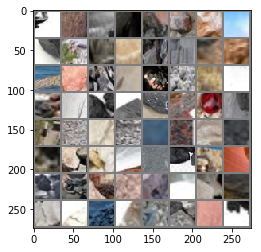

16
tensor([0, 5, 6, 4, 4, 0, 5, 2, 1, 2, 5, 0, 1, 0, 5, 4, 4, 5, 6, 0, 6, 5, 2, 6,
        0, 5, 0, 5, 5, 1, 0, 0, 5, 4, 4, 0, 6, 4, 4, 0, 0, 3, 2, 5, 1, 4, 5, 5,
        0, 4, 3, 3, 0, 6, 2, 3, 1, 4, 4, 6, 0, 2, 6, 3])
(64, 3, 32, 32)
('0_1008.jpg', '5_1566.jpg', '6_2969.jpg', '4_231.jpg', '4_1214.jpg', '0_615.jpg', '5_3371.jpg', '2_2546.jpg', '1_406.jpg', '2_2220.jpg', '5_3417.jpg', '0_3192.jpg', '1_360.jpg', '0_173.jpg', '5_744.jpg', '4_1572.jpg', '4_557.jpg', '5_2709.jpg', '6_687.jpg', '0_1785.jpg', '6_50.jpg', '5_1200.jpg', '2_1729.jpg', '6_44.jpg', '0_1791.jpg', '5_1214.jpg', '0_1949.jpg', '5_988.jpg', '5_3403.jpg', '1_374.jpg', '0_3186.jpg', '0_167.jpg', '5_750.jpg', '4_1566.jpg', '4_543.jpg', '0_2298.jpg', '6_693.jpg', '4_225.jpg', '4_1200.jpg', '0_3838.jpg', '0_601.jpg', '3_1729.jpg', '2_2552.jpg', '5_3365.jpg', '1_412.jpg', '4_2709.jpg', '5_1572.jpg', '5_2053.jpg', '0_3810.jpg', '4_1228.jpg', '3_932.jpg', '3_1701.jpg', '0_629.jpg', '6_1284.jpg', '2_1073.jpg', '3_1173.JPEG', '

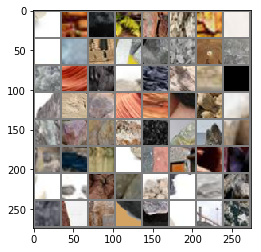

17
tensor([6, 5, 2, 5, 1, 2, 6, 6, 6, 5, 2, 5, 6, 4, 0, 2, 2, 6, 1, 4, 6, 0, 5, 4,
        0, 6, 5, 0, 3, 4, 6, 5, 6, 0, 6, 6, 0, 6, 0, 2, 3, 2, 6, 6, 0, 3, 2, 2,
        6, 0, 0, 0, 6, 0, 0, 3, 6, 0, 4, 5, 4, 3, 0, 3])
(64, 3, 32, 32)
('6_863.jpg', '5_778.jpg', '2_3102.jpg', '5_2735.jpg', '1_348.jpg', '2_2208.jpg', '6_877.jpg', '6_2603.jpeg', '6_3134.png', '5_2721.jpg', '2_3116.jpg', '5_1228.jpg', '6_78.jpg', '4_2053.jpg', '0_1975.jpg', '2_1701.jpg', '2_1067.jpg', '6_2799.jpg', '1_71.jpg', '4_2735.jpg', '6_2941.jpg', '0_2717.png', '5_2047.jpg', '4_219.jpg', '0_3804.jpg', '6_1290.jpg', '5_3359.jpg', '0_3353.jpg', '3_271.jpg', '4_796.jpg', '6_2087.jpeg', '5_585.jpg', '6_3108.jpg', '0_1544.jpg', '6_2216.jpg', '6_2570.jpg', '0_1222.jpg', '6_320.jpg', '0_3435.jpg', '2_2787.jpg', '3_517.jpg', '2_704.jpg', '6_1079.jpg', '6_334.jpg', '0_3421.jpg', '3_503.jpg', '2_2793.jpg', '2_710.jpg', '6_2564.jpg', '0_1236.jpg', '0_3635.jpeg', '0_1550.jpg', '6_2202.jpg', '0_4428.jpg', '0_3347.jpg', '3_265.j

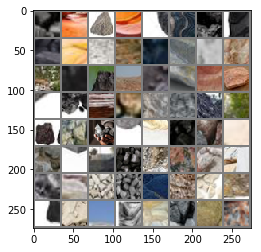

18
tensor([4, 6, 0, 4, 3, 0, 2, 1, 5, 6, 0, 6, 2, 0, 3, 5, 3, 6, 5, 2, 1, 0, 5, 0,
        6, 0, 4, 4, 1, 0, 4, 6, 4, 5, 0, 6, 4, 4, 2, 5, 0, 3, 1, 0, 5, 2, 1, 2,
        5, 0, 0, 2, 0, 4, 5, 5, 5, 2, 6, 1, 5, 0, 0, 4])
(64, 3, 32, 32)
('4_972.jpg', '6_1723.jpg', '0_4400.jpg', '4_1957.jpg', '3_1348.JPEG', '0_2071.jpg', '2_2963.jpg', '1_823.jpg', '5_2292.jpg', '6_1644.jpeg', '0_3409.jpg', '6_1045.jpg', '2_738.jpg', '0_4366.jpg', '3_1715.png', '5_1943.jpg', '3_926.png', '6_2558.jpg', '5_1957.jpg', '2_2977.jpg', '1_837.jpg', '0_2703.jpg', '5_3198.jpg', '0_4372.jpg', '6_1051.jpg', '0_4414.jpg', '4_966.jpg', '4_1943.jpg', '1_189.jpg', '0_2065.jpg', '4_2292.jpg', '6_3120.jpg', '4_2279.jpg', '5_1002.jpg', '0_1587.jpg', '6_485.jpg', '4_755.jpg', '4_1770.jpg', '2_34.jpg', '5_546.jpg', '0_371.jpg', '3_1259.jpg', '1_162.jpg', '0_3390.jpg', '5_3615.jpg', '2_2022.jpg', '1_604.jpg', '2_2744.jpg', '5_3173.jpg', '0_2930.jpg', '0_417.jpg', '2_2750.webp', '0_4399.jpg', '4_1016.jpg', '5_220.jpg', '5_1764

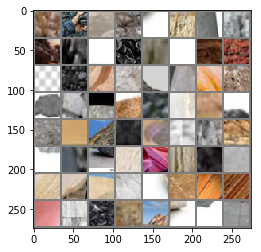

19
tensor([2, 5, 5, 5, 6, 4, 6, 4, 5, 2, 0, 4, 0, 1, 2, 5, 5, 5, 6, 4, 5, 4, 2, 4,
        5, 4, 5, 2, 2, 1, 6, 3, 6, 5, 2, 3, 3, 6, 0, 5, 2, 5, 5, 4, 5, 2, 3, 2,
        4, 5, 4, 3, 0, 4, 2, 5, 4, 6, 3, 6, 0, 3, 2, 5])
(64, 3, 32, 32)
('2_2988.jpg', '5_234.jpg', '5_29.jpg', '5_2279.jpg', '6_491.jpg', '4_741.jpg', '6_1910.jpg', '4_1764.jpg', '5_552.jpg', '2_20.jpg', '0_365.jpg', '4_999.jpg', '0_3384.jpg', '1_176.jpg', '2_2036.jpg', '5_3601.jpg', '5_1016.jpg', '5_2537.jpg', '6_1938.jpg', '4_769.jpg', '5_3629.jpg', '4_1994.jpg', '2_1517.jpg', '4_2245.jpg', '5_1758.jpg', '4_2523.jpg', '5_1980.jpg', '2_1271.jpg', '2_2778.jpg', '1_638.jpg', '6_1086.jpg', '3_1503.jpg', '6_2654.jpeg', '5_2251.jpg', '2_923.jpg', '3_253.JPEG', '3_1574.JPEG', '6_1092.jpg', '0_2918.jpg', '5_208.jpg', '2_937.jpg', '5_2245.jpg', '5_15.jpg', '4_2537.jpg', '5_1994.jpg', '2_1265.jpg', '3_1124.jpeg', '2_1503.jpg', '4_2251.jpg', '5_2523.jpg', '4_1758.jpg', '3_1271.jpg', '0_359.jpg', '4_1980.jpg', '2_921.jpg', '5_2253.jp

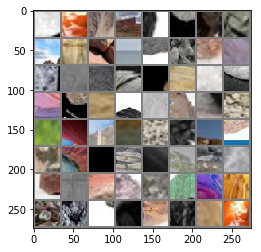

20
tensor([3, 4, 4, 2, 4, 3, 5, 5, 3, 2, 4, 1, 5, 5, 4, 2, 2, 6, 5, 4, 5, 2, 5, 6,
        5, 5, 4, 5, 0, 0, 1, 5, 2, 0, 1, 2, 5, 4, 5, 2, 6, 4, 6, 5, 5, 0, 2, 6,
        5, 3, 0, 1, 0, 5, 2, 0, 4, 2, 5, 0, 6, 6, 4, 2])
(64, 3, 32, 32)
('3_674.JPEG', '4_2521.jpg', '4_2247.jpg', '2_1515.jpg', '4_1996.jpg', '3_1267.jpg', '5_578.jpg', '5_2535.jpg', '3_298.jpg', '2_2008.jpg', '4_1982.jpg', '1_148.jpg', '5_2521.jpg', '5_1028.jpg', '4_2253.jpg', '2_1501.jpg', '2_1267.jpg', '6_2599.jpg', '5_1996.jpg', '4_2535.jpg', '5_2247.jpg', '2_935.jpg', '5_17.jpg', '6_1090.jpg', '5_3159.jpg', '5_1766.jpg', '4_1014.jpg', '5_222.jpg', '0_415.jpg', '0_2932.jpg', '1_606.jpg', '5_3171.jpg', '2_2746.jpg', '0_3392.jpg', '1_160.jpg', '2_2020.jpg', '5_3617.jpg', '4_1772.jpg', '5_544.jpg', '2_36.jpg', '6_487.jpg', '4_757.jpg', '6_1906.jpg', '5_2509.jpg', '5_1000.jpg', '0_1585.jpg', '2_1529.jpg', '6_2336.jpeg', '5_1014.jpg', '3_1016.JPEG', '0_1591.jpg', '1_174.jpg', '0_3386.jpg', '5_3603.jpg', '2_2034.jpg', '0_367.

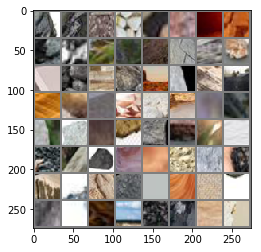

21
tensor([4, 5, 0, 0, 1, 2, 5, 3, 4, 5, 5, 5, 0, 5, 0, 2, 1, 6, 0, 4, 0, 6, 4, 6,
        4, 4, 6, 4, 2, 0, 0, 4, 4, 6, 0, 0, 6, 0, 5, 2, 0, 1, 2, 1, 6, 0, 5, 0,
        2, 0, 3, 2, 0, 6, 0, 6, 6, 0, 5, 6, 4, 4, 0, 3])
(64, 3, 32, 32)
('4_1000.jpg', '5_236.jpg', '0_2926.jpg', '0_401.jpg', '1_612.jpg', '2_2752.jpg', '5_3165.jpg', '3_717.png', '4_2509.jpg', '5_1772.jpg', '5_1799.jpg', '5_1941.jpg', '0_4364.jpg', '5_2290.jpg', '0_2715.jpg', '2_2961.jpg', '1_821.jpg', '6_478.jpg', '0_2073.jpg', '4_1955.jpg', '0_4402.jpg', '6_1721.jpg', '4_970.jpg', '6_2228.jpg', '4_2284.jpg', '4_2290.jpg', '6_3122.jpg', '4_1799.jpg', '2_237.webp', '0_2067.jpg', '0_3379.jpg', '4_1941.jpg', '4_964.jpg', '6_1735.jpg', '0_4416.jpg', '0_398.jpg', '6_1053.jpg', '0_4370.jpg', '5_2284.jpg', '2_8.jpg', '0_2701.jpg', '1_67.png', '2_2975.jpg', '1_835.jpg', '6_1799.jpeg', '0_1208.jpg', '5_1955.jpg', '0_4358.jpg', '2_706.jpg', '0_3437.jpg', '3_515.jpg', '2_2785.jpg', '0_2729.jpg', '6_322.jpg', '0_1220.jpg', '6_2572.jp

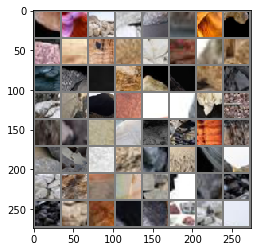

22
tensor([5, 6, 4, 0, 3, 4, 6, 6, 0, 2, 5, 6, 2, 0, 2, 3, 6, 1, 2, 5, 2, 4, 6, 3,
        5, 2, 0, 4, 6, 5, 4, 2, 1, 6, 0, 3, 5, 3, 3, 3, 6, 0, 3, 5, 6, 1, 4, 2,
        2, 0, 4, 2, 5, 4, 3, 6, 2, 4, 0, 5, 4, 6, 5, 4])
(64, 3, 32, 32)
('5_593.jpg', '6_450.jpg', '4_780.jpg', '0_3345.jpg', '3_267.jpg', '4_958.jpg', '6_1709.jpg', '6_2200.jpg', '0_1552.jpg', '2_1298.jpg', '5_1969.jpg', '6_2566.jpg', '2_712.jpg', '0_3423.jpg', '2_2791.jpg', '3_501.jpg', '6_336.jpg', '1_809.jpg', '2_2949.jpg', '5_2737.jpg', '2_3100.jpg', '4_569.jpg', '6_861.jpg', '3_1065.jpg', '5_3429.jpg', '2_1717.jpg', '0_1963.jpg', '4_2045.jpg', '6_2957.jpg', '5_1558.jpg', '4_2723.jpg', '2_1071.jpg', '1_438.jpg', '6_1286.jpg', '0_3812.jpg', '3_930.jpg', '5_2051.jpg', '3_273.JPEG', '3_1717.jpg', '3_1554.JPEG', '6_1292.jpg', '0_3806.jpg', '3_924.jpg', '5_2045.jpg', '6_2943.jpg', '1_73.jpg', '4_2737.jpg', '2_1065.jpg', '2_1703.jpg', '0_1977.jpg', '4_2051.jpg', '2_3114.jpg', '5_2723.jpg', '4_1558.jpg', '3_1071.jpg', '6_875.j

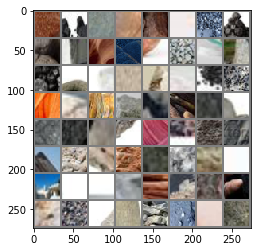

23
tensor([0, 5, 2, 1, 0, 2, 5, 1, 0, 0, 4, 4, 0, 5, 0, 5, 2, 5, 1, 6, 3, 4, 4, 5,
        4, 5, 4, 0, 6, 6, 2, 5, 0, 1, 0, 6, 5, 4, 0, 3, 6, 5, 3, 0, 0, 0, 5, 0,
        2, 6, 0, 5, 4, 6, 6, 6, 0, 0, 6, 5, 5, 0, 6, 5])
(64, 3, 32, 32)
('0_171.jpg', '5_3415.jpg', '2_2222.jpg', '1_362.jpg', '0_3190.jpg', '2_2544.jpg', '5_3373.jpg', '1_404.jpg', '0_4199.jpg', '0_617.jpg', '4_1216.jpg', '4_233.jpg', '0_1234.png', '5_1564.jpg', '0_1014.jpeg', '5_1570.jpg', '2_1059.jpg', '5_3367.jpg', '1_410.jpg', '6_482.jpeg', '3_918.jpg', '4_1202.jpg', '4_227.jpg', '5_2079.jpg', '4_541.jpg', '5_752.jpg', '4_1564.jpg', '0_165.jpg', '6_528.jpeg', '6_849.jpg', '2_2236.jpg', '5_3401.jpg', '0_3184.jpg', '1_376.jpg', '0_1793.jpg', '6_46.jpg', '5_1216.jpg', '4_2086.jpg', '0_1778.jpg', '3_1273.png', '6_1523.jpg', '5_961.jpg', '3_1368.jpeg', '0_2271.jpg', '0_830.jpg', '0_2517.jpg', '5_2092.jpg', '0_3609.jpg', '2_538.jpg', '6_1245.jpg', '0_4166.jpg', '5_162.webp', '4_2938.jpg', '6_2994.jpg', '6_2758.jpg', '6_2980.j

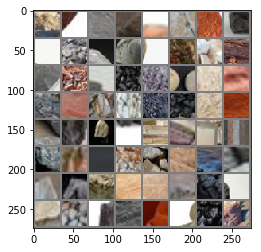

24
tensor([6, 1, 5, 0, 2, 4, 2, 5, 0, 4, 6, 5, 1, 2, 0, 6, 6, 6, 4, 0, 3, 1, 6, 2,
        6, 2, 0, 6, 2, 0, 2, 6, 4, 0, 2, 6, 0, 0, 6, 5, 2, 5, 0, 4, 6, 0, 5, 1,
        3, 6, 6, 3, 4, 5, 4, 3, 0, 2, 2, 4, 0, 5, 0, 5])
(64, 3, 32, 32)
('6_1537.jpg', '1_389.jpg', '5_975.jpg', '0_2265.jpg', '2_1918.jpg', '4_2092.jpg', '2_262.jpg', '5_2910.jpg', '0_3153.jpg', '4_596.jpg', '6_646.jpg', '5_785.jpg', '1_1036.jpg', '2_1930.jpg', '0_1744.jpg', '6_91.jpg', '6_2016.jpg', '6_2770.jpg', '4_2904.jpg', '0_1022.jpg', '3_859.JPEG', '1_98.jpg', '6_120.jpg', '2_2587.jpg', '6_1279.jpg', '2_504.jpg', '0_818.jpg', '6_134.jpg', '2_2593.jpg', '0_3621.jpg', '2_510.jpg', '6_2764.jpg', '4_2910.jpg', '0_1036.jpg', '2_1924.jpg', '6_85.jpg', '0_1750.jpg', '0_1988.jpg', '6_2002.jpg', '5_2904.jpg', '2_276.jpg', '5_949.jpg', '0_3147.jpg', '4_582.jpg', '6_652.jpg', '0_2259.jpg', '5_791.jpg', '1_1022.jpg', '3_1111.jpg', '6_915.jpg', '6_1494.jpg', '3_62.jpg', '4_1438.jpg', '5_2643.jpg', '4_2131.jpg', '3_635.JPEG', '0_1

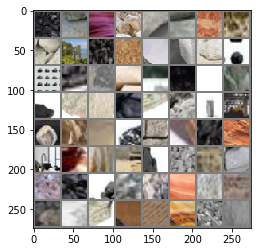

25
tensor([3, 0, 5, 0, 3, 1, 3, 2, 2, 0, 4, 5, 4, 6, 0, 2, 5, 6, 3, 3, 6, 2, 5, 4,
        6, 5, 2, 5, 2, 1, 6, 5, 4, 4, 2, 4, 5, 5, 3, 4, 0, 2, 5, 1, 0, 2, 0, 5,
        3, 3, 0, 5, 4, 0, 5, 6, 4, 0, 5, 2, 4, 0, 1, 2])
(64, 3, 32, 32)
('3_1677.jpg', '0_993.jpg', '5_2131.jpg', '0_3972.jpg', '3_850.jpg', '1_558.jpg', '3_688.jpg', '2_2418.jpg', '2_1111.jpg', '0_3879.jpeg', '4_2643.jpg', '5_1438.jpg', '4_2125.jpg', '6_2189.jpg', '0_1803.jpg', '2_1677.jpg', '5_3549.jpg', '6_901.jpg', '3_1105.jpg', '3_76.jpg', '6_1480.jpg', '2_3060.jpg', '5_2657.jpg', '4_409.jpg', '6_524.png', '5_1376.jpg', '2_1887.jpg', '5_3561.jpg', '2_2356.jpg', '1_216.jpg', '6_929.jpg', '5_632.jpg', '4_1404.jpg', '4_421.jpg', '2_3048.jpg', '4_347.jpg', '5_2119.jpg', '5_154.jpg', '3_878.jpg', '4_1362.jpg', '0_763.jpg', '2_2430.jpg', '5_3207.jpg', '1_570.jpg', '0_3782.jpg', '2_1139.jpg', '0_1195.jpg', '5_1410.jpg', '3_770.JPEG', '3_1057.JPEG', '0_1181.jpg', '5_1404.jpg', '4_353.jpg', '0_2488.jpg', '5_140.jpg', '6_3136.jpe

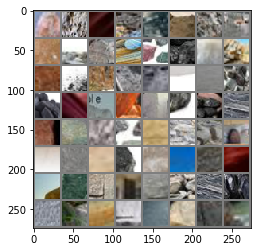

26
tensor([5, 1, 5, 3, 4, 4, 5, 4, 2, 5, 2, 0, 5, 5, 5, 6, 0, 6, 0, 0, 3, 4, 6, 4,
        4, 0, 2, 6, 0, 0, 0, 0, 4, 3, 3, 5, 5, 6, 3, 0, 6, 0, 5, 3, 2, 0, 5, 2,
        0, 0, 1, 4, 0, 2, 3, 4, 0, 4, 0, 5, 0, 6, 2, 3])
(64, 3, 32, 32)
('5_3575.jpg', '1_202.jpg', '5_626.jpg', '3_1407.JPEG', '4_1410.jpg', '4_435.jpg', '5_1362.jpg', '4_2119.jpg', '2_1893.jpg', '5_1389.jpg', '2_1878.jpg', '0_2305.jpg', '5_2680.jpg', '5_815.jpg', '5_2858.jpg', '6_1457.jpg', '0_4012.jpg', '6_1331.jpg', '0_2463.jpg', '0_944.jpg', '3_887.jpg', '4_2694.jpg', '6_2638.jpg', '4_2680.jpg', '4_2858.jpg', '0_788.jpg', '2_458.jpg', '6_1325.jpg', '0_4006.jpg', '0_3769.jpg', '0_950.jpg', '0_2477.jpg', '4_1389.jpg', '3_893.jpg', '3_459.JPEG', '5_2694.jpg', '5_801.jpg', '6_1443.jpg', '3_1313.png', '0_1618.jpg', '6_732.jpg', '0_2339.jpg', '5_829.jpg', '3_105.jpg', '2_2395.jpg', '0_3027.jpg', '5_2864.jpg', '2_316.jpg', '0_1630.jpg', '0_1156.jpg', '1_766.png', '4_2870.jpg', '0_3594.png', '2_470.jpg', '3_663.jpg', '4_94.jpg'

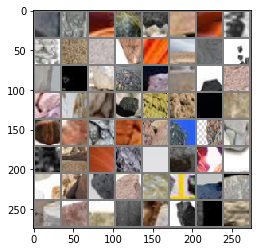

27
tensor([4, 4, 5, 0, 6, 4, 6, 6, 2, 2, 6, 2, 3, 0, 2, 5, 5, 1, 5, 4, 2, 4, 2, 2,
        4, 6, 0, 5, 5, 6, 2, 5, 5, 6, 3, 3, 2, 4, 4, 6, 4, 3, 2, 2, 3, 1, 4, 2,
        5, 5, 0, 4, 0, 0, 0, 1, 5, 2, 0, 0, 3, 4, 5, 3])
(64, 3, 32, 32)
('4_80.jpg', '4_390.jpg', '5_183.jpg', '0_1142.jpg', '6_295.png', '4_2864.jpg', '6_2610.jpg', '6_2176.jpg', '2_1688.jpg', '2_1850.jpg', '6_726.jpg', '2_2381.jpg', '3_111.jpg', '0_3033.jpg', '2_302.jpg', '5_2870.jpg', '5_3039.jpg', '1_996.jpg', '5_2327.jpg', '4_179.jpg', '2_855.jpg', '4_2455.jpg', '2_1307.jpg', '2_1461.jpg', '4_2333.jpg', '6_3081.jpg', '0_2311.png', '5_1148.jpg', '5_2441.jpg', '6_1696.jpg', '2_2168.jpg', '5_2455.jpg', '5_418.jpg', '6_1682.jpg', '3_1515.JPEG', '3_1307.jpg', '2_1475.jpg', '4_3039.jpg', '4_2327.jpg', '6_3095.jpg', '4_2441.jpg', '3_1145.JPEG', '2_1313.jpg', '2_699.jpg', '3_1461.jpg', '1_982.jpg', '4_1148.jpg', '2_841.jpg', '5_2333.jpg', '5_1612.jpg', '0_1397.jpg', '4_2469.jpg', '0_33.jpg', '0_3755.png', '0_3580.jpg', '1_772.j

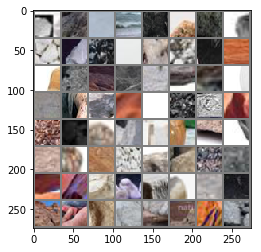

28
tensor([4, 2, 6, 4, 4, 5, 0, 0, 2, 4, 6, 5, 2, 4, 5, 4, 6, 5, 4, 5, 0, 2, 2, 5,
        0, 4, 5, 6, 4, 5, 0, 0, 3, 3, 5, 0, 4, 2, 1, 2, 0, 6, 0, 4, 6, 2, 0, 0,
        4, 5, 0, 6, 4, 6, 6, 0, 6, 4, 4, 5, 6, 0, 2, 1])
(64, 3, 32, 32)
('4_145.jpg', '2_869.jpg', '6_1872.jpg', '4_623.jpg', '4_1606.jpg', '5_430.jpg', '0_207.jpg', '0_4589.jpg', '2_2154.jpg', '4_3011.jpg', '6_990.jpeg', '5_1174.jpg', '2_1449.jpg', '4_3005.jpg', '5_1160.jpg', '4_637.jpg', '6_1866.jpg', '5_2469.jpg', '4_1612.jpg', '5_424.jpg', '0_213.jpg', '2_2140.jpg', '2_2626.jpg', '5_3011.jpg', '0_2852.jpg', '4_1174.jpg', '5_342.jpg', '6_281.jpg', '4_151.jpg', '5_1606.jpg', '0_1383.jpg', '0_27.jpg', '3_1688.png', '3_0.JPEG', '5_1835.jpg', '0_1368.jpg', '4_2496.jpg', '2_2815.jpg', '1_955.jpg', '2_896.jpg', '0_2661.jpg', '6_1133.jpg', '0_4210.jpg', '4_804.jpg', '6_1655.jpg', '2_128.jpg', '0_4576.jpg', '0_3219.jpg', '4_1821.jpg', '5_2482.jpg', '0_2107.jpg', '6_3042.jpg', '4_2141.webp', '6_3056.jpg', '6_2348.jpg', '0_4562.jpg

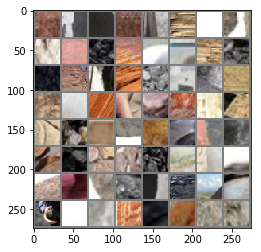

29
tensor([2, 0, 3, 6, 1, 0, 6, 5, 4, 1, 2, 5, 6, 0, 0, 2, 5, 0, 0, 6, 3, 4, 6, 0,
        2, 6, 2, 4, 0, 3, 2, 0, 6, 6, 0, 5, 0, 6, 4, 0, 3, 0, 0, 2, 6, 6, 0, 6,
        3, 2, 4, 0, 2, 0, 2, 0, 3, 0, 4, 6, 0, 5, 0, 6])
(64, 3, 32, 32)
('2_882.jpg', '0_2675.jpg', '3_449.jpg', '6_210.jpeg', '1_799.jpg', '0_4204.jpg', '6_1127.jpg', '5_1821.jpg', '4_2482.jpg', '1_969.jpg', '2_2829.jpg', '5_395.jpg', '6_256.jpg', '0_3543.jpg', '0_2885.jpg', '2_672.jpg', '5_1809.jpg', '0_1354.jpg', '0_1432.jpg', '6_2360.jpg', '3_1139.png', '4_838.jpg', '6_1669.jpg', '0_3225.jpg', '2_2197.jpg', '6_530.jpg', '2_100.jpg', '4_1809.jpg', '0_3231.jpg', '3_313.jpg', '2_2183.jpg', '0_1426.jpg', '6_2374.jpg', '6_2412.jpg', '0_1340.jpg', '5_381.jpg', '0_2649.jpg', '6_242.jpg', '4_192.jpg', '0_3557.jpg', '3_475.jpg', '0_2891.jpg', '0_4238.jpg', '2_666.jpg', '6_2375.jpg', '6_1577.jpeg', '0_1427.jpg', '6_525.jpg', '3_312.jpg', '2_2182.jpg', '4_1808.jpg', '0_3230.jpg', '2_101.jpg', '0_4239.jpg', '2_667.jpg', '0_2890.jpg'

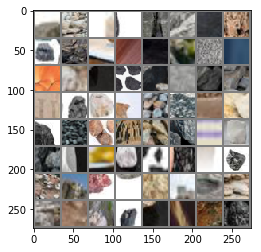

30
tensor([0, 5, 6, 2, 0, 3, 0, 4, 6, 2, 5, 1, 6, 2, 3, 0, 6, 2, 4, 6, 0, 0, 6, 5,
        6, 4, 0, 4, 6, 6, 6, 4, 5, 0, 6, 1, 0, 2, 1, 2, 0, 0, 2, 1, 2, 4, 0, 0,
        5, 3, 3, 0, 5, 0, 4, 2, 6, 4, 2, 0, 5, 4, 6, 4])
(64, 3, 32, 32)
('0_1355.jpg', '5_1808.jpg', '6_2407.jpg', '2_673.jpg', '0_2884.jpg', '3_460.jpg', '0_3542.jpg', '4_187.jpg', '6_257.jpg', '2_2828.jpg', '5_394.jpg', '1_968.jpg', '6_531.jpg', '2_2196.jpg', '3_306.jpg', '0_3224.jpg', '6_1668.jpg', '2_115.jpg', '4_839.jpg', '6_2361.jpg', '0_1433.jpg', '0_2112.jpg', '6_519.jpg', '5_2497.jpg', '6_1898.jpg', '4_1834.jpg', '0_4563.jpg', '4_811.jpg', '6_1640.jpg', '6_2349.jpg', '6_3057.jpg', '4_2483.jpg', '5_1820.jpg', '0_4205.jpg', '6_1126.jpg', '1_798.jpg', '0_2674.jpg', '2_883.jpg', '1_940.jpg', '2_2800.jpg', '0_4211.jpg', '0_2660.jpg', '2_897.jpg', '1_954.jpg', '2_2814.jpg', '4_2497.jpg', '0_1369.jpg', '0_2492.webp', '5_1834.jpg', '3_77.png', '3_619.JPEG', '0_2106.jpg', '5_2483.jpg', '0_3218.jpg', '4_1820.jpg', '2_129.jpg'

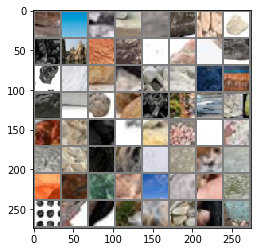

31
tensor([5, 5, 4, 0, 2, 0, 0, 0, 5, 4, 6, 6, 5, 4, 0, 0, 2, 5, 0, 2, 4, 5, 4, 0,
        0, 5, 2, 1, 0, 0, 4, 0, 5, 5, 4, 2, 0, 0, 5, 4, 4, 6, 4, 4, 2, 5, 3, 5,
        2, 5, 1, 4, 3, 0, 2, 2, 3, 4, 2, 4, 5, 2, 4, 3])
(64, 3, 32, 32)
('5_2468.jpg', '5_1161.jpg', '4_3004.jpg', '0_603.webp', '2_1448.jpg', '0_26.jpg', '0_1382.jpg', '0_3450.webp', '5_1607.jpg', '4_150.jpg', '6_2137.jpeg', '6_280.jpg', '5_343.jpg', '4_1175.jpg', '0_2853.jpg', '0_574.jpg', '2_2627.jpg', '5_3010.jpg', '0_3595.jpg', '2_868.jpg', '4_144.jpg', '5_357.jpg', '4_1161.jpg', '0_560.jpg', '0_2847.jpg', '5_3004.jpg', '2_2633.jpg', '1_773.jpg', '0_3581.jpg', '0_32.jpg', '4_2468.jpg', '0_1396.jpg', '5_1613.jpg', '5_1175.jpg', '4_3010.jpg', '2_2155.jpg', '0_4588.jpg', '0_206.jpg', '5_431.jpg', '4_1607.jpg', '4_622.jpg', '6_1873.jpg', '4_2326.jpg', '4_3038.jpg', '2_1474.jpg', '5_419.jpg', '3_1352.JPEG', '5_2454.jpg', '2_840.jpg', '5_2332.jpg', '1_983.jpg', '4_1149.jpg', '3_1460.jpg', '0_548.jpg', '2_698.jpg', '2_1312.jpg

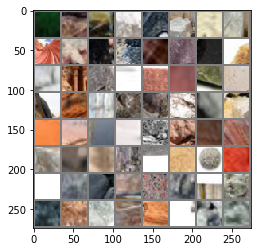

32
tensor([5, 2, 3, 6, 5, 5, 6, 4, 2, 6, 3, 4, 0, 5, 4, 0, 4, 2, 6, 3, 2, 5, 0, 2,
        3, 6, 2, 0, 2, 6, 2, 0, 0, 6, 5, 2, 0, 5, 2, 0, 6, 0, 5, 0, 4, 4, 0, 3,
        2, 6, 4, 1, 0, 3, 4, 0, 0, 3, 0, 6, 2, 0, 0, 4])
(64, 3, 32, 32)
('5_3038.jpg', '2_2169.jpg', '3_1312.jpg', '6_1697.jpg', '5_2440.jpg', '5_1149.jpg', '6_3080.jpg', '4_2332.jpg', '2_1460.jpg', '6_2611.jpg', '3_1448.png', '4_2865.jpg', '0_1143.jpg', '5_182.jpg', '4_391.jpg', '0_3754.jpg', '4_81.jpg', '2_465.jpg', '6_1318.jpg', '3_88.jpg', '2_303.jpg', '5_2871.jpg', '0_3032.jpg', '2_2380.jpg', '3_110.jpg', '6_727.jpg', '2_1851.jpg', '0_1625.jpg', '2_1689.jpg', '6_2177.jpg', '2_1845.jpg', '0_1631.jpg', '0_3044.jpeg', '6_2163.jpg', '5_2865.jpg', '2_317.jpg', '0_3026.jpg', '5_828.jpg', '2_2394.jpg', '0_2338.jpg', '6_733.jpg', '0_3998.jpg', '5_196.jpg', '0_979.jpg', '4_385.jpg', '4_95.jpg', '0_3740.jpg', '3_662.jpg', '2_471.jpg', '6_2605.jpg', '4_2871.jpg', '1_767.png', '0_1157.jpg', '3_892.jpg', '4_1388.jpg', '0_2476.jpg', 

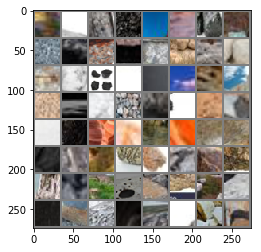

33
tensor([0, 4, 1, 0, 6, 5, 5, 0, 5, 6, 3, 5, 5, 0, 6, 6, 2, 5, 6, 4, 0, 0, 0, 6,
        4, 1, 0, 5, 2, 4, 0, 5, 0, 4, 5, 0, 3, 2, 4, 5, 4, 4, 5, 1, 2, 5, 4, 2,
        4, 5, 6, 1, 5, 2, 2, 5, 6, 5, 0, 2, 1, 4, 2, 5])
(64, 3, 32, 32)
('0_3101.jpeg', '4_2681.jpg', '1_997.png', '0_1619.jpg', '6_1442.jpg', '5_800.jpg', '5_2695.jpg', '0_2310.jpg', '5_2859.jpg', '6_1456.jpg', '3_138.jpg', '5_814.jpg', '5_2681.jpg', '0_2304.jpg', '6_2619.jpeg', '6_3094.png', '2_1879.jpg', '5_1388.jpg', '6_2639.jpg', '4_2695.jpg', '0_945.jpg', '0_2462.jpg', '0_4013.jpg', '6_1330.jpg', '4_42.jpg', '1_565.jpg', '0_3797.jpg', '5_3212.jpg', '2_2425.jpg', '4_1377.jpg', '0_4447.jpeg', '5_141.jpg', '0_2489.jpg', '4_352.jpg', '5_1405.jpg', '0_1180.jpg', '3_137.JPEG', '2_1892.jpg', '4_2118.jpg', '5_1363.jpg', '4_434.jpg', '4_1411.jpg', '5_627.jpg', '1_203.jpg', '2_2343.jpg', '5_3574.jpg', '4_420.jpg', '2_3049.jpg', '4_1405.jpg', '5_633.jpg', '6_928.jpg', '1_217.jpg', '5_3560.jpg', '2_2357.jpg', '2_1886.jpg', '5_1377

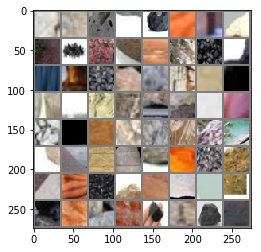

34
tensor([4, 3, 5, 4, 5, 6, 5, 4, 6, 2, 3, 2, 1, 3, 0, 5, 0, 2, 5, 6, 3, 5, 2, 0,
        6, 4, 2, 0, 4, 3, 5, 6, 4, 6, 3, 6, 3, 5, 0, 5, 0, 4, 2, 0, 4, 6, 2, 0,
        2, 6, 0, 1, 5, 0, 6, 4, 0, 5, 5, 2, 6, 0, 0, 2])
(64, 3, 32, 32)
('4_1363.jpg', '3_879.jpg', '5_155.jpg', '4_346.jpg', '5_2118.jpg', '6_2836.jpg', '5_1439.jpg', '4_2642.jpg', '6_1132.png', '2_1110.jpg', '3_689.jpg', '2_2419.jpg', '1_559.jpg', '3_851.jpg', '0_3973.jpg', '5_2130.jpg', '0_992.jpg', '2_3061.jpg', '5_2656.jpg', '6_900.jpg', '3_1104.jpg', '5_3548.jpg', '2_1676.jpg', '0_1802.jpg', '6_2188.jpg', '4_2124.jpg', '2_1662.jpg', '0_1816.jpg', '4_2130.jpg', '3_588.JPEG', '5_2642.jpg', '6_2926.jpeg', '4_1439.jpg', '6_1495.jpg', '3_1110.jpg', '6_914.jpg', '3_1676.jpg', '5_169.jpg', '0_3967.jpg', '5_2124.jpg', '0_986.jpg', '4_2656.jpg', '2_1104.jpg', '0_1037.jpg', '4_2911.jpg', '6_2765.jpg', '2_511.jpg', '0_3620.jpg', '2_2592.jpg', '6_135.jpg', '0_819.jpg', '1_1023.jpg', '5_790.jpg', '0_2258.jpg', '6_653.jpg', '4_583.j

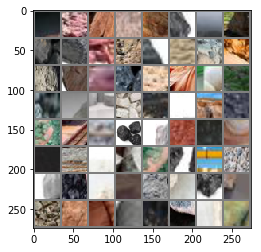

35
tensor([6, 0, 6, 2, 1, 5, 6, 4, 0, 2, 5, 2, 6, 0, 2, 3, 6, 1, 0, 4, 6, 5, 0, 6,
        5, 5, 6, 0, 0, 0, 4, 2, 5, 1, 5, 6, 0, 5, 6, 0, 4, 6, 4, 6, 0, 3, 0, 5,
        0, 0, 4, 5, 4, 3, 0, 1, 5, 2, 2, 3, 5, 5, 0, 6])
(64, 3, 32, 32)
('6_2017.jpg', '0_1745.jpg', '6_90.jpg', '2_1931.jpg', '1_1037.jpg', '5_784.jpg', '6_647.jpg', '4_597.jpg', '0_3152.jpg', '2_263.jpg', '5_2911.jpg', '2_505.jpg', '6_1278.jpg', '0_3634.jpg', '2_2586.jpg', '3_716.jpg', '6_121.jpg', '1_99.jpg', '0_1023.jpg', '4_2905.jpg', '6_2771.jpg', '5_2999.webp', '0_4173.jpg', '6_1250.jpg', '5_3399.jpg', '5_2087.jpg', '6_109.jpg', '0_825.jpg', '0_2502.jpg', '0_1983.jpeg', '4_2093.jpg', '2_1919.jpg', '5_974.jpg', '1_388.jpg', '5_2939.jpg', '6_1536.jpg', '0_2270.jpg', '5_960.jpg', '6_1522.jpg', '0_1779.jpg', '4_2087.jpg', '6_2995.jpg', '4_2939.jpg', '6_1244.jpg', '0_4167.jpg', '3_1485.JPEG', '0_3608.jpg', '5_2093.jpg', '0_2516.jpg', '0_831.jpg', '4_226.jpg', '5_2078.jpg', '4_1203.jpg', '3_919.jpg', '0_602.jpg', '1_411.jpg

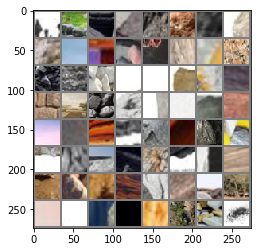

36
tensor([1, 0, 2, 5, 6, 0, 4, 5, 6, 4, 0, 1, 5, 2, 0, 3, 4, 5, 6, 4, 5, 6, 0, 4,
        5, 4, 4, 0, 1, 2, 5, 2, 4, 1, 5, 3, 6, 2, 3, 4, 2, 5, 4, 0, 2, 4, 0, 2,
        5, 6, 3, 5, 2, 4, 5, 3, 0, 6, 2, 1, 2, 4, 1, 6])
(64, 3, 32, 32)
('1_377.jpg', '0_3185.jpg', '2_2237.jpg', '5_3400.jpg', '6_848.jpg', '0_164.jpg', '4_1565.jpg', '5_753.jpg', '6_690.jpg', '4_540.jpg', '0_3191.jpg', '1_363.jpg', '5_3414.jpg', '2_2223.jpg', '0_170.jpg', '3_1058.jpg', '4_1571.jpg', '5_747.jpg', '6_684.jpg', '4_554.jpg', '5_1203.jpg', '6_53.jpg', '0_1786.jpg', '4_2078.jpg', '5_1565.jpg', '4_232.jpg', '4_1217.jpg', '0_4198.jpg', '1_405.jpg', '2_2545.jpg', '5_3372.jpg', '2_1064.jpg', '4_2736.jpg', '1_72.jpg', '5_2044.jpg', '3_925.jpg', '6_1293.jpg', '2_288.jpg', '3_1070.jpg', '4_1559.jpg', '2_3115.jpg', '5_2722.jpg', '4_2050.jpg', '0_1976.jpg', '2_1702.jpg', '4_2044.jpg', '0_1962.jpg', '2_1716.jpg', '5_3428.jpg', '6_860.jpg', '3_1064.jpg', '5_2736.jpg', '2_3101.jpg', '4_568.jpg', '5_2050.jpg', '3_931.jpg', '

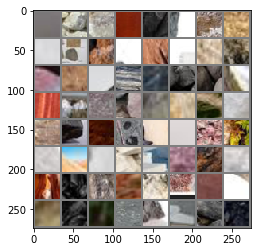

37
tensor([5, 0, 0, 6, 6, 4, 3, 0, 4, 6, 5, 2, 1, 6, 2, 3, 0, 2, 5, 6, 2, 0, 6, 0,
        6, 0, 2, 0, 0, 2, 3, 3, 4, 0, 4, 6, 5, 0, 6, 6, 0, 6, 4, 0, 0, 4, 0, 4,
        4, 5, 3, 0, 1, 2, 0, 2, 5, 6, 0, 1, 6, 2, 0, 6])
(64, 3, 32, 32)
('5_1559.jpg', '0_3906.jpeg', '0_1553.jpg', '6_2201.jpg', '6_1708.jpg', '4_959.jpg', '3_266.jpg', '0_3344.jpg', '4_781.jpg', '6_451.jpg', '5_592.jpg', '2_2948.jpg', '1_808.jpg', '6_337.jpg', '2_2790.jpg', '3_500.jpg', '0_3422.jpg', '2_713.jpg', '5_1968.jpg', '6_2567.jpg', '2_1299.jpg', '0_1235.jpg', '6_2573.jpg', '0_1221.jpg', '6_1131.jpeg', '0_2728.jpg', '2_2784.jpg', '0_3436.jpg', '0_4359.jpg', '2_707.jpg', '3_1299.jpg', '3_272.jpg', '4_1968.jpg', '0_3350.jpg', '4_795.jpg', '6_445.jpg', '5_586.jpg', '0_1547.jpg', '6_2215.jpg', '6_3049.jpeg', '0_399.jpg', '6_1734.jpg', '4_965.jpg', '0_4417.jpg', '0_3378.jpg', '4_1940.jpg', '0_2066.jpg', '4_1798.jpg', '4_2291.jpg', '5_1954.jpg', '3_1702.png', '0_1209.jpg', '1_834.jpg', '2_2974.jpg', '0_2700.jpg', '2_9.jp

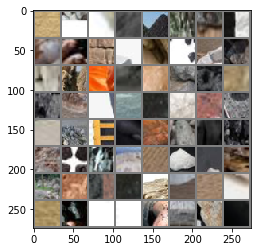

38
tensor([5, 0, 6, 5, 5, 6, 4, 6, 6, 0, 4, 6, 4, 0, 6, 4, 6, 6, 0, 5, 2, 4, 6, 5,
        2, 0, 1, 0, 5, 5, 4, 2, 5, 1, 3, 0, 0, 3, 5, 4, 2, 5, 2, 1, 0, 0, 5, 4,
        5, 2, 0, 5, 6, 4, 5, 6, 2, 5, 4, 0, 2, 5, 1, 0])
(64, 3, 32, 32)
('5_2291.jpg', '0_4365.jpg', '6_1046.jpg', '5_1940.jpg', '5_1798.jpg', '6_3137.jpg', '4_2285.jpg', '6_2229.jpg', '6_874.png', '0_4403.jpg', '4_971.jpg', '6_1720.jpg', '4_1954.jpg', '0_2072.jpg', '6_479.jpg', '4_742.jpg', '6_1913.jpg', '6_492.jpg', '0_2099.jpg', '5_551.jpg', '2_23.jpg', '4_1767.jpg', '6_2822.jpeg', '5_3602.jpg', '2_2035.jpg', '0_3387.jpg', '1_175.jpg', '0_1590.jpg', '5_1015.jpg', '5_1773.jpg', '4_2508.jpg', '2_2753.jpg', '5_3164.jpg', '1_613.jpg', '3_526.JPEG', '0_400.jpg', '0_2927.jpg', '3_1528.jpg', '5_237.jpg', '4_1001.jpg', '2_908.jpg', '5_3170.jpg', '2_2747.jpg', '1_607.jpg', '0_2933.jpg', '0_414.jpg', '5_223.jpg', '4_1015.jpg', '5_1767.jpg', '2_1528.jpg', '0_1584.jpg', '5_1001.jpg', '6_1907.jpg', '4_756.jpg', '5_2508.jpg', '6_486.jp

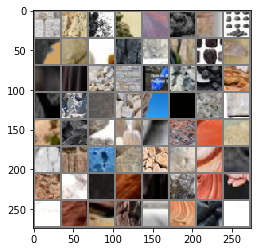

39
tensor([2, 4, 5, 5, 4, 2, 5, 3, 6, 5, 5, 2, 4, 6, 5, 4, 5, 2, 3, 6, 4, 2, 5, 5,
        5, 3, 4, 2, 4, 6, 0, 0, 1, 2, 5, 0, 4, 6, 4, 5, 2, 0, 5, 0, 3, 5, 4, 4,
        5, 2, 1, 5, 0, 0, 4, 5, 2, 5, 0, 5, 5, 0, 2, 0])
(64, 3, 32, 32)
('2_1500.jpg', '4_2252.jpg', '5_1029.jpg', '5_2520.jpg', '4_1983.jpg', '2_2009.jpg', '5_3158.jpg', '3_1514.jpg', '6_1091.jpg', '5_16.jpg', '5_2246.jpg', '2_934.jpg', '4_2534.jpg', '6_2598.jpg', '5_1997.jpg', '4_2520.jpg', '5_1983.jpg', '2_1272.jpg', '3_1500.jpg', '6_1085.jpg', '4_1029.jpg', '2_920.jpg', '5_2252.jpg', '5_2534.jpg', '5_579.jpg', '3_1266.jpg', '4_1997.jpg', '2_1514.jpg', '4_2246.jpg', '6_2823.jpeg', '0_376.jpg', '0_3397.jpg', '1_165.jpg', '2_2025.jpg', '5_3612.jpg', '0_2089.jpg', '4_752.jpg', '6_1903.jpg', '4_1777.jpg', '5_541.jpg', '2_33.jpg', '0_88.jpeg', '5_1005.jpg', '0_1580.jpg', '3_177.jpeg', '5_1763.jpg', '4_2518.jpg', '4_1011.jpg', '5_227.jpg', '2_918.jpg', '1_603.jpg', '5_3174.jpg', '0_2937.jpg', '0_410.jpg', '4_1005.jpg', '5_233.j

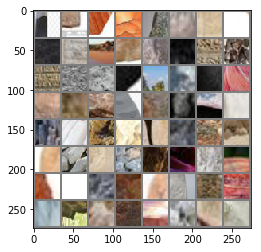

40
tensor([1, 0, 5, 2, 6, 4, 5, 4, 2, 5, 4, 6, 5, 2, 3, 3, 2, 4, 5, 5, 2, 6, 5, 2,
        4, 5, 2, 4, 4, 2, 5, 5, 6, 3, 0, 4, 5, 5, 4, 3, 6, 2, 6, 0, 6, 4, 5, 6,
        4, 0, 0, 0, 0, 2, 3, 2, 2, 6, 5, 6, 2, 0, 6, 0])
(64, 3, 32, 32)
('1_171.jpg', '0_3383.jpg', '5_3606.jpg', '2_2031.jpg', '6_496.jpg', '4_746.jpg', '5_2518.jpg', '4_1763.jpg', '2_27.jpg', '5_555.jpg', '4_2242.jpg', '6_19.jpeg', '5_1039.jpg', '2_1510.jpg', '3_1262.jpg', '3_289.jpg', '2_2019.jpg', '4_1993.jpg', '5_2530.jpg', '5_2256.jpg', '2_924.jpg', '6_2588.jpg', '5_1987.jpg', '2_1276.jpg', '4_2524.jpg', '5_1993.jpg', '2_1262.jpg', '4_2530.jpg', '4_1039.jpg', '2_930.jpg', '5_2242.jpg', '5_12.jpg', '6_1095.jpg', '3_1510.jpg', '0_438.jpg', '4_1987.jpg', '5_2524.jpg', '5_569.jpg', '4_2256.jpg', '3_198.JPEG', '6_1219.jpeg', '2_1504.jpg', '6_2211.jpg', '0_1543.jpg', '6_441.jpg', '4_791.jpg', '5_582.jpg', '6_1718.jpg', '4_949.jpg', '0_4044.webp', '0_3354.jpg', '0_2893.webp', '0_3432.jpg', '2_2780.jpg', '3_510.jpg', '2_703.jp

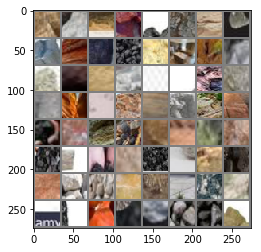

41
tensor([3, 2, 0, 2, 6, 0, 6, 4, 5, 4, 0, 3, 6, 0, 0, 4, 6, 4, 0, 0, 4, 4, 0, 3,
        5, 6, 6, 3, 6, 0, 2, 1, 5, 0, 3, 6, 2, 1, 5, 0, 5, 5, 6, 4, 6, 0, 0, 4,
        6, 4, 0, 2, 5, 1, 4, 5, 3, 4, 3, 5, 2, 0, 5, 3])
(64, 3, 32, 32)
('3_504.jpg', '2_2794.jpg', '0_4349.jpg', '2_717.jpg', '6_333.jpg', '0_2738.jpg', '6_455.jpg', '4_785.jpg', '5_596.jpg', '4_1978.jpg', '0_3340.jpg', '3_262.jpg', '6_2205.jpg', '0_1557.jpg', '0_2076.jpg', '4_1788.jpg', '6_1724.jpg', '4_975.jpg', '0_4407.jpg', '0_3368.jpg', '4_1950.jpg', '4_2281.jpg', '0_1219.jpg', '3_1083.JPEG', '5_1944.jpg', '6_913.jpeg', '6_1425.jpeg', '3_1579.JPEG', '6_1042.jpg', '0_4361.jpg', '2_2964.jpg', '1_824.jpg', '5_2295.jpg', '0_2710.jpg', '3_538.jpg', '6_1056.jpg', '2_2970.jpg', '1_830.jpg', '5_2281.jpg', '0_2704.jpg', '5_1788.jpg', '5_1950.jpg', '6_2239.jpg', '4_2295.jpg', '6_3127.jpg', '0_2062.jpg', '0_4413.jpg', '4_961.jpg', '6_1730.jpg', '4_1944.jpg', '0_612.jpg', '2_2541.jpg', '5_3376.jpg', '1_401.jpg', '4_236.jpg', '5_20

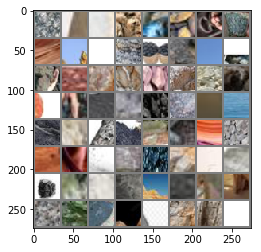

42
tensor([5, 4, 4, 6, 5, 2, 1, 0, 6, 0, 5, 4, 4, 6, 2, 5, 0, 1, 0, 3, 6, 0, 5, 4,
        1, 5, 3, 0, 0, 5, 2, 1, 4, 4, 1, 4, 2, 3, 6, 5, 0, 3, 4, 5, 2, 3, 6, 0,
        2, 0, 2, 4, 0, 2, 4, 2, 5, 4, 5, 6, 3, 3, 6, 1])
(64, 3, 32, 32)
('5_743.jpg', '4_1575.jpg', '4_550.jpg', '6_680.jpg', '5_3410.jpg', '2_2227.jpg', '1_367.jpg', '0_3195.jpg', '6_858.jpg', '0_174.jpg', '5_757.jpg', '4_1561.jpg', '4_544.jpg', '6_694.jpg', '2_2233.jpg', '5_3404.jpg', '0_3181.jpg', '1_373.jpg', '0_160.jpg', '3_1048.jpg', '6_43.jpg', '0_1796.jpg', '5_1213.jpg', '4_2068.jpg', '1_818.png', '5_1575.jpg', '3_1607.JPEG', '0_4188.jpg', '0_606.jpg', '5_3362.jpg', '2_2555.jpg', '1_415.jpg', '4_222.jpg', '4_1207.jpg', '1_62.jpg', '4_2726.jpg', '2_1074.jpg', '3_1706.jpg', '6_1283.jpg', '5_2054.jpg', '0_3817.jpg', '3_935.jpg', '4_1549.jpg', '5_2732.jpg', '2_3105.jpg', '3_1060.jpg', '6_864.jpg', '0_148.jpg', '2_298.jpg', '0_1966.jpg', '2_1712.jpg', '4_2040.jpg', '0_1972.jpg', '2_1706.jpg', '4_2054.jpg', '2_3111.jpg', '

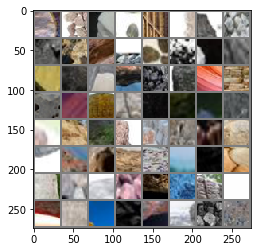

43
tensor([2, 5, 0, 3, 1, 4, 6, 5, 2, 1, 4, 6, 0, 6, 0, 3, 2, 0, 5, 0, 5, 2, 5, 1,
        4, 0, 6, 6, 0, 6, 2, 0, 6, 0, 6, 2, 6, 0, 2, 5, 5, 1, 6, 6, 6, 2, 3, 0,
        4, 6, 1, 0, 6, 0, 0, 5, 0, 6, 5, 6, 6, 2, 4, 3])
(64, 3, 32, 32)
('2_2569.jpg', '5_2040.jpg', '0_3803.jpg', '3_921.jpg', '1_76.jpg', '4_2732.jpg', '6_2946.jpg', '5_1549.jpg', '2_1060.jpg', '1_617.png', '4_2901.jpg', '6_2775.jpg', '0_1027.jpg', '6_125.jpg', '0_809.jpg', '3_712.jpg', '2_2582.jpg', '0_3630.jpg', '5_958.jpg', '0_3156.jpg', '5_2915.jpg', '2_267.jpg', '5_780.jpg', '1_1033.jpg', '4_593.jpg', '0_2248.jpg', '6_643.jpg', '6_94.jpg', '0_1741.jpg', '6_1917.png', '2_1935.jpg', '0_1999.jpg', '6_2013.jpg', '0_1755.jpg', '6_80.jpg', '2_1921.jpg', '6_2007.jpg', '0_3142.jpg', '2_273.jpg', '5_2901.jpg', '5_794.jpg', '1_1027.jpg', '6_657.jpg', '6_131.jpg', '6_1268.jpg', '2_515.jpg', '3_706.jpg', '0_3624.jpg', '4_2915.jpg', '6_2761.jpg', '1_89.jpg', '0_1033.jpg', '6_119.jpg', '0_2512.jpg', '0_835.jpg', '5_2097.jpg', '0_41

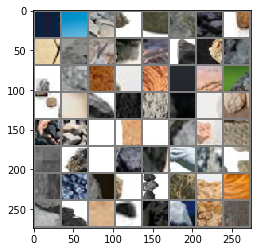

44
tensor([1, 5, 5, 6, 0, 5, 0, 0, 4, 1, 4, 6, 0, 0, 5, 2, 6, 0, 0, 5, 4, 4, 0, 2,
        5, 4, 1, 0, 0, 5, 4, 2, 5, 3, 3, 5, 2, 3, 1, 4, 5, 4, 6, 2, 5, 1, 4, 2,
        5, 4, 3, 2, 5, 2, 0, 5, 3, 5, 4, 4, 5, 5, 2, 0])
(64, 3, 32, 32)
('1_398.jpg', '5_964.jpg', '5_2929.jpg', '6_1526.jpg', '0_2274.jpg', '5_970.jpg', '0_2260.jpg', '0_1769.jpg', '4_2097.jpg', '1_159.png', '4_2929.jpg', '6_2985.jpg', '0_821.jpg', '0_2506.jpg', '5_2083.jpg', '2_529.jpg', '6_1254.jpg', '0_4177.jpg', '0_3618.jpg', '5_151.jpg', '4_1367.jpg', '4_342.jpg', '0_2499.jpg', '2_2435.jpg', '5_3202.jpg', '4_52.jpg', '1_575.jpg', '0_766.jpg', '0_1190.jpg', '5_1415.jpg', '4_2108.jpg', '2_1882.jpg', '5_1373.jpg', '3_566.JPEG', '3_1128.jpg', '5_3564.jpg', '2_2353.jpg', '3_1241.JPEG', '1_213.jpg', '4_424.jpg', '5_637.jpg', '4_1401.jpg', '6_938.jpg', '2_2347.jpg', '5_3570.jpg', '1_207.jpg', '4_430.jpg', '2_3059.jpg', '5_623.jpg', '4_1415.jpg', '3_835.JPEG', '2_1896.jpg', '5_1367.jpg', '2_1128.jpg', '0_1184.jpg', '5_1401.jpg

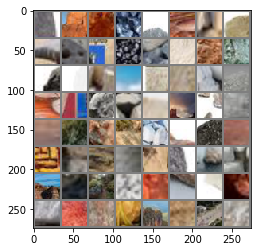

45
tensor([1, 4, 0, 2, 6, 5, 4, 0, 3, 5, 1, 2, 3, 6, 6, 3, 5, 5, 2, 4, 4, 2, 6, 6,
        0, 4, 2, 0, 3, 6, 6, 2, 5, 3, 4, 0, 3, 5, 0, 5, 0, 3, 0, 0, 2, 6, 4, 0,
        4, 0, 4, 6, 2, 5, 4, 6, 2, 5, 2, 0, 2, 6, 2, 0])
(64, 3, 32, 32)
('1_561.jpg', '4_46.jpg', '0_772.jpg', '2_1100.jpg', '6_2826.jpg', '5_1429.jpg', '4_2652.jpg', '0_3963.jpg', '3_841.jpg', '5_2120.jpg', '1_549.jpg', '2_2409.jpg', '3_1672.jpg', '6_910.jpg', '6_1491.jpg', '3_67.jpg', '5_3558.jpg', '5_2646.jpg', '2_3071.jpg', '4_418.jpg', '4_2134.jpg', '2_1666.jpg', '6_2198.jpg', '6_2474.jpeg', '0_1812.jpg', '4_2120.jpg', '2_1672.jpg', '0_1806.jpg', '3_1100.jpg', '6_904.jpg', '6_1485.jpg', '2_3065.jpg', '5_2652.jpg', '3_589.JPEG', '4_1429.jpg', '0_3977.jpg', '3_855.jpg', '5_179.jpg', '0_996.jpg', '5_2134.jpg', '0_1351.jpeg', '3_1666.jpg', '0_2984.jpeg', '0_4215.png', '2_1114.jpg', '6_2832.jpg', '4_2646.jpg', '0_1153.jpg', '4_2875.jpg', '0_3744.jpg', '4_91.jpg', '6_1308.jpg', '2_475.jpg', '5_192.jpg', '4_381.jpg', '6_737.jp

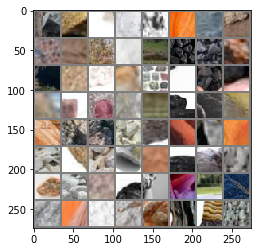

46
tensor([6, 2, 0, 0, 6, 6, 5, 2, 3, 5, 2, 0, 3, 4, 0, 0, 2, 3, 5, 0, 4, 0, 6, 4,
        0, 3, 2, 0, 4, 3, 0, 0, 4, 3, 4, 0, 6, 0, 5, 6, 3, 5, 0, 5, 5, 6, 5, 2,
        5, 1, 4, 3, 0, 6, 3, 0, 0, 4, 5, 6, 4, 5, 2, 4])
(64, 3, 32, 32)
('6_2173.jpg', '2_1855.jpg', '0_1621.jpg', '0_2328.jpg', '6_723.jpg', '6_1171.jpeg', '5_2875.jpg', '2_307.jpg', '3_114.jpg', '5_838.jpg', '2_2384.jpg', '0_3036.jpg', '3_672.jpg', '4_85.jpg', '0_3750.jpg', '0_36.png', '2_461.jpg', '3_1699.jpg', '5_186.jpg', '0_3988.jpg', '4_395.jpg', '0_1147.jpg', '6_2615.jpg', '4_2861.jpg', '0_3778.jpg', '3_1492.JPEG', '2_449.jpg', '0_4017.jpg', '4_1398.jpg', '3_882.jpg', '0_941.jpg', '0_2466.jpg', '4_2691.jpg', '3_1168.JPEG', '4_2849.jpg', '0_1609.jpg', '6_9.jpg', '0_2300.jpg', '5_2685.jpg', '6_1452.jpg', '3_1538.JPEG', '5_810.jpg', '0_2314.jpg', '5_2691.jpg', '5_2849.jpg', '6_1446.jpg', '5_804.jpg', '2_1869.jpg', '5_1398.jpg', '1_993.png', '4_2685.jpg', '3_36.JPEG', '0_4003.jpg', '6_1320.jpg', '3_896.jpg', '0_2472.jpg'

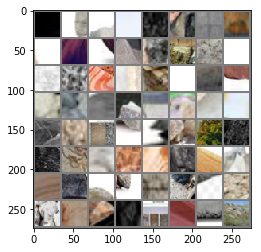

47
tensor([2, 5, 5, 0, 0, 0, 0, 1, 5, 2, 6, 4, 5, 0, 0, 3, 3, 1, 0, 2, 5, 6, 2, 4,
        4, 5, 4, 5, 0, 0, 0, 4, 5, 4, 5, 4, 6, 2, 0, 4, 2, 4, 5, 5, 3, 6, 2, 3,
        0, 2, 5, 4, 4, 3, 2, 4, 2, 3, 5, 5, 2, 4, 1, 5])
(64, 3, 32, 32)
('2_1458.jpg', '5_1171.jpg', '5_1617.jpg', '0_1392.jpg', '0_564.jpg', '0_2843.jpg', '0_3585.jpg', '1_777.jpg', '5_3000.jpg', '2_2637.jpg', '6_290.jpg', '4_1165.jpg', '5_353.jpg', '0_2857.jpg', '0_570.jpg', '3_1458.jpg', '3_1216.JPEG', '1_763.jpg', '0_3591.jpg', '2_2623.jpg', '5_3014.jpg', '6_284.jpg', '2_878.jpg', '4_154.jpg', '4_1171.jpg', '5_347.jpg', '4_2478.jpg', '5_1603.jpg', '0_3784.jpeg', '0_1386.jpg', '0_22.jpg', '4_3000.jpg', '5_1165.jpg', '4_1617.jpg', '5_421.jpg', '4_632.jpg', '6_1863.jpg', '2_2145.jpg', '0_216.jpg', '4_3028.jpg', '2_1464.jpg', '4_2336.jpg', '5_409.jpg', '5_2444.jpg', '3_1353.JPEG', '6_1693.jpg', '2_688.jpg', '3_1470.jpg', '0_558.jpg', '2_850.jpg', '5_2322.jpg', '4_1159.jpg', '4_2450.jpg', '3_1703.JPEG', '2_1302.jpg', '4_2444.

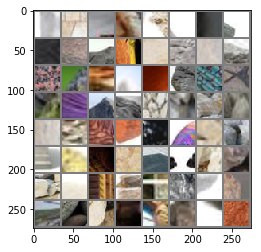

48
tensor([2, 3, 6, 2, 5, 4, 6, 0, 6, 4, 0, 3, 2, 2, 6, 6, 0, 3, 5, 0, 0, 2, 0, 3,
        6, 5, 0, 6, 4, 1, 2, 5, 0, 2, 0, 0, 2, 2, 6, 4, 0, 6, 4, 0, 4, 6, 5, 6,
        0, 6, 6, 6, 5, 4, 0, 2, 1, 6, 3, 1, 2, 0, 2, 1])
(64, 3, 32, 32)
('2_2179.jpg', '3_1302.jpg', '6_790.jpeg', '2_1470.jpg', '5_1159.jpg', '4_2322.jpg', '6_3090.jpg', '0_1437.jpg', '6_2365.jpg', '4_1818.jpg', '0_3220.jpg', '3_302.jpg', '2_2192.jpg', '2_111.jpg', '6_535.jpg', '6_253.jpg', '0_2658.jpg', '3_1580.JPEG', '5_390.jpg', '0_2880.jpg', '0_4229.jpg', '2_677.jpg', '0_3546.jpg', '3_464.jpg', '6_2403.jpg', '5_1818.jpg', '0_1345.jpg', '6_247.jpg', '4_197.jpg', '1_978.jpg', '2_2838.jpg', '5_384.jpg', '0_2894.jpg', '2_663.jpg', '0_3552.jpg', '0_3234.jpg', '2_2186.jpg', '2_105.jpg', '6_1678.jpg', '4_829.jpg', '0_1423.jpg', '6_2371.jpg', '4_1824.jpg', '0_4573.jpg', '4_801.jpg', '6_1650.jpg', '5_2487.jpg', '6_1888.jpg', '0_2102.jpg', '6_509.jpg', '6_3047.jpg', '6_2359.jpg', '5_1830.jpg', '4_2493.jpg', '0_2664.jpg', '2_2810.

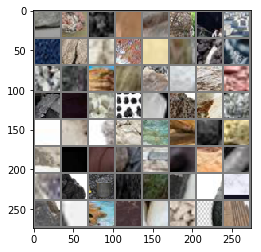

49
tensor([6, 0, 3, 3, 3, 5, 4, 0, 0, 6, 0, 4, 2, 4, 5, 0, 0, 4, 5, 0, 1, 2, 0, 0,
        2, 0, 5, 4, 2, 6, 0, 0, 4, 3, 6, 6, 0, 5, 6, 0, 6, 4, 4, 1, 0, 0, 6, 1,
        2, 0, 2, 4, 5, 0, 2, 0, 2, 5, 1, 4, 6, 0, 5, 6])
(64, 3, 32, 32)
('6_1122.jpg', '0_4201.jpg', '3_248.jpeg', '3_699.png', '3_1095.JPEG', '5_1824.jpg', '4_2487.jpg', '0_1379.jpg', '0_982.png', '6_3053.jpg', '0_3208.jpg', '4_1830.jpg', '2_139.jpg', '4_815.jpg', '5_2493.jpg', '0_2116.jpg', '0_1378.jpg', '4_2486.jpg', '5_1825.jpg', '0_4200.jpg', '1_945.jpg', '2_2805.jpg', '0_1801.webp', '0_2671.jpg', '2_886.jpg', '0_2117.jpg', '5_2492.jpg', '4_814.jpg', '2_138.jpg', '6_1645.jpg', '0_4566.jpg', '0_3209.jpg', '4_1831.jpg', '3_1115.png', '6_2358.jpg', '6_508.jpg', '0_2103.jpg', '5_2486.jpg', '6_1889.jpg', '0_4572.jpg', '6_1651.jpg', '4_800.jpg', '4_1825.jpg', '1_789.jpg', '0_810.jpeg', '0_4214.jpg', '6_1137.jpg', '1_951.jpg', '2_2811.jpg', '0_2665.jpg', '2_892.jpg', '4_2492.jpg', '5_1831.jpg', '0_3553.jpg', '2_662.jpg', '0_28

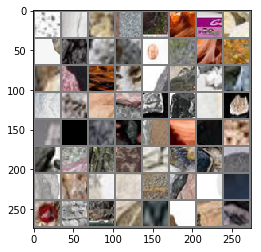

50
tensor([0, 6, 4, 6, 2, 2, 0, 6, 2, 3, 2, 4, 0, 1, 6, 0, 0, 6, 3, 0, 0, 2, 5, 4,
        0, 6, 1, 5, 4, 2, 5, 3, 2, 4, 6, 4, 5, 2, 6, 2, 5, 3, 6, 3, 5, 5, 6, 4,
        2, 4, 2, 4, 1, 4, 2, 5, 0, 2, 5, 4, 5, 4, 4, 2])
(64, 3, 32, 32)
('0_1422.jpg', '6_520.jpg', '4_828.jpg', '6_1679.jpg', '2_104.jpg', '2_2187.jpg', '0_3235.jpg', '6_534.jpg', '2_110.jpg', '3_303.jpg', '2_2193.jpg', '4_1819.jpg', '0_3221.jpg', '1_206.png', '6_2364.jpg', '0_1436.jpg', '0_1350.jpg', '6_2402.jpg', '3_465.jpg', '0_3547.jpg', '0_4228.jpg', '2_676.jpg', '5_391.jpg', '4_182.jpg', '0_2659.jpg', '6_252.jpg', '1_986.jpg', '5_2337.jpg', '4_169.jpg', '2_845.jpg', '5_3029.jpg', '3_1465.jpg', '2_1317.jpg', '4_2445.jpg', '6_3091.jpg', '4_2323.jpg', '5_1158.jpg', '2_1471.jpg', '6_1686.jpg', '2_2178.jpg', '5_2451.jpg', '3_1317.jpg', '6_1692.jpg', '3_233.JPEG', '5_2445.jpg', '5_408.jpg', '6_3085.jpg', '4_2337.jpg', '2_1465.jpg', '4_3029.jpg', '2_1303.jpg', '4_2451.jpg', '1_992.jpg', '4_1158.jpg', '2_851.jpg', '5_2323.jpg

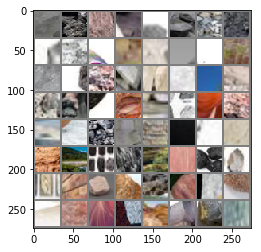

51
tensor([3, 6, 2, 5, 0, 1, 0, 0, 2, 6, 4, 5, 4, 5, 4, 5, 2, 4, 2, 4, 6, 5, 4, 5,
        4, 4, 6, 5, 2, 1, 0, 0, 0, 6, 3, 0, 5, 5, 2, 5, 3, 5, 6, 5, 0, 0, 0, 3,
        0, 6, 6, 4, 4, 4, 0, 0, 3, 4, 6, 2, 0, 0, 0, 0])
(64, 3, 32, 32)
('3_376.JPEG', '6_285.jpg', '2_2622.jpg', '5_3015.jpg', '0_3590.jpg', '1_762.jpg', '0_571.jpg', '0_2856.jpg', '2_2144.jpg', '6_1862.jpg', '4_633.jpg', '5_420.jpg', '4_1616.jpg', '5_1164.jpg', '4_3001.jpg', '5_1170.jpg', '2_1459.jpg', '4_3015.jpg', '2_2150.jpg', '4_627.jpg', '6_1876.jpg', '5_2479.jpg', '4_1602.jpg', '5_352.jpg', '4_1164.jpg', '4_141.jpg', '6_291.jpg', '5_3001.jpg', '2_2636.jpg', '1_776.jpg', '0_3584.jpg', '0_2842.jpg', '0_565.jpg', '6_568.jpeg', '3_1698.png', '0_1393.jpg', '5_1616.jpg', '5_1399.jpg', '2_1868.jpg', '5_805.jpg', '3_129.jpg', '5_2848.jpg', '6_1447.jpg', '5_2690.jpg', '0_2315.jpg', '0_954.jpg', '0_2473.jpg', '3_897.jpg', '0_4002.jpg', '6_1321.jpg', '6_2628.jpg', '4_2684.jpg', '4_2848.jpg', '4_2690.jpg', '0_2467.jpg', '0_940.j

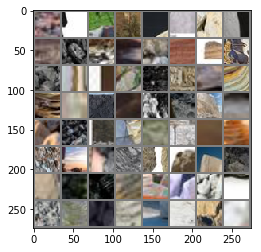

52
tensor([5, 6, 5, 0, 6, 0, 5, 0, 5, 2, 6, 5, 2, 6, 0, 0, 2, 6, 4, 6, 0, 4, 0, 5,
        2, 4, 0, 3, 4, 5, 2, 6, 0, 4, 3, 4, 6, 0, 0, 2, 6, 2, 0, 2, 3, 2, 5, 6,
        4, 2, 6, 3, 3, 6, 0, 2, 0, 4, 4, 6, 2, 5, 0, 0])
(64, 3, 32, 32)
('5_811.jpg', '6_1453.jpg', '5_2684.jpg', '0_2301.jpg', '6_8.jpg', '0_1608.jpg', '5_2625.webp', '0_3037.jpg', '5_839.jpg', '2_2385.jpg', '6_2819.jpeg', '5_2874.jpg', '2_306.jpg', '6_722.jpg', '0_2329.jpg', '0_1620.jpg', '2_1854.jpg', '6_2172.jpg', '4_2860.jpg', '6_2614.jpg', '0_968.jpg', '4_394.jpg', '0_3989.jpg', '5_187.jpg', '2_460.jpg', '4_84.jpg', '0_3751.jpg', '3_673.jpg', '4_380.jpg', '5_193.jpg', '2_474.jpg', '6_1309.jpg', '0_3745.jpg', '4_90.jpg', '3_667.jpg', '4_2874.jpg', '6_2600.jpg', '0_1152.jpg', '0_1634.jpg', '2_1840.jpg', '6_2166.jpg', '2_1698.jpg', '0_3023.jpg', '2_2391.jpg', '3_101.jpg', '2_312.jpg', '5_2860.jpg', '6_736.jpg', '4_1428.jpg', '2_3064.jpg', '6_1484.jpg', '3_72.jpg', '3_1101.jpg', '6_905.jpg', '0_1807.jpg', '2_1673.jpg', '0_

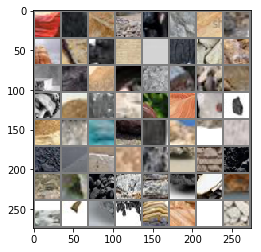

53
tensor([5, 3, 0, 3, 3, 2, 1, 5, 0, 0, 4, 6, 6, 5, 2, 0, 6, 2, 6, 4, 5, 2, 4, 5,
        3, 6, 6, 5, 2, 4, 5, 2, 2, 5, 6, 0, 1, 0, 5, 2, 4, 5, 4, 5, 3, 0, 5, 0,
        2, 0, 3, 5, 0, 3, 4, 0, 1, 2, 5, 0, 4, 4, 5, 4])
(64, 3, 32, 32)
('5_178.jpg', '3_854.jpg', '0_3976.jpg', '3_1673.jpg', '3_698.jpg', '2_2408.jpg', '1_548.jpg', '5_2121.jpg', '0_983.jpg', '0_3962.jpg', '4_2653.jpg', '6_2399.jpeg', '6_2827.jpg', '5_1428.jpg', '2_1101.jpg', '0_1813.jpg', '6_2199.jpg', '2_1667.jpg', '6_2233.jpeg', '4_2135.jpg', '5_2647.jpg', '2_3070.jpg', '4_419.jpg', '5_3559.jpg', '3_66.jpg', '6_1490.jpg', '6_911.jpg', '5_1366.jpg', '2_1897.jpg', '4_1414.jpg', '5_622.jpg', '2_3058.jpg', '2_2346.jpg', '5_3571.jpg', '6_939.jpg', '0_773.jpg', '1_560.jpg', '0_3792.jpg', '5_3217.jpg', '2_2420.jpg', '4_357.jpg', '5_2109.jpg', '4_1372.jpg', '5_144.jpg', '3_868.jpg', '0_3897.jpeg', '5_1400.jpg', '0_1185.jpg', '2_1129.jpg', '0_2881.png', '3_771.JPEG', '5_1414.jpg', '0_1191.jpg', '3_471.png', '4_53.jpg', '0_3786.j

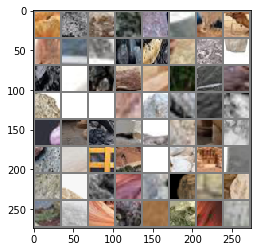

54
tensor([5, 3, 4, 1, 5, 2, 3, 5, 2, 4, 4, 2, 0, 0, 6, 5, 0, 6, 2, 0, 5, 0, 0, 6,
        4, 6, 6, 6, 6, 5, 0, 6, 5, 0, 0, 6, 0, 5, 6, 5, 1, 4, 2, 6, 4, 1, 5, 2,
        5, 0, 6, 2, 0, 6, 0, 6, 4, 0, 2, 3, 2, 6, 0, 3])
(64, 3, 32, 32)
('5_636.jpg', '3_321.JPEG', '4_425.jpg', '1_212.jpg', '5_3565.jpg', '2_2352.jpg', '3_1129.jpg', '5_1372.jpg', '2_1883.jpg', '4_2109.jpg', '4_2096.jpg', '2_631.webp', '0_1768.jpg', '0_2261.jpg', '6_1533.jpg', '5_971.jpg', '0_3619.jpg', '6_1255.jpg', '2_528.jpg', '0_4176.jpg', '5_2082.jpg', '0_2507.jpg', '0_820.jpg', '6_2984.jpg', '4_2928.jpg', '6_2990.jpg', '6_600.jpeg', '6_2419.jpeg', '6_2748.jpg', '5_3388.jpg', '0_4162.jpg', '6_1241.jpg', '5_2096.jpg', '0_834.jpg', '0_2513.jpg', '6_118.jpg', '0_2275.jpg', '5_2928.jpg', '6_1527.jpg', '5_965.jpg', '1_399.jpg', '4_2082.jpg', '2_1908.jpg', '6_656.jpg', '4_586.jpg', '1_1026.jpg', '5_795.jpg', '2_272.jpg', '5_2900.jpg', '0_3143.jpg', '6_2006.jpg', '2_1920.jpg', '0_1754.jpg', '6_81.jpg', '0_1032.jpg', '6_2760.

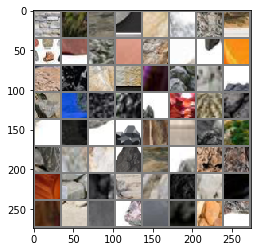

55
tensor([2, 2, 0, 6, 0, 6, 4, 6, 0, 2, 6, 0, 6, 0, 4, 1, 5, 5, 2, 0, 5, 6, 3, 5,
        2, 5, 4, 4, 2, 0, 2, 6, 5, 4, 0, 5, 2, 1, 6, 0, 5, 6, 2, 3, 6, 4, 4, 2,
        0, 2, 6, 3, 6, 5, 2, 4, 4, 5, 6, 0, 0, 3, 1, 0])
(64, 3, 32, 32)
('2_2583.jpg', '2_500.jpg', '0_808.jpg', '6_124.jpg', '0_1026.jpg', '6_2774.jpg', '4_2900.jpg', '6_2012.jpg', '0_1998.jpg', '2_1934.jpg', '6_95.jpg', '0_1740.jpg', '6_642.jpg', '0_2249.jpg', '4_592.jpg', '1_1032.jpg', '5_781.jpg', '5_2914.jpg', '2_266.jpg', '0_3157.jpg', '5_959.jpg', '6_871.jpg', '3_1075.jpg', '5_3439.jpg', '2_3110.jpg', '5_2727.jpg', '4_579.jpg', '4_2055.jpg', '2_1707.jpg', '0_1973.jpg', '2_1061.jpg', '6_2947.jpg', '5_1548.jpg', '4_2733.jpg', '0_3802.jpg', '5_2041.jpg', '2_2568.jpg', '1_428.jpg', '6_1296.jpg', '0_3816.jpg', '5_2055.jpg', '6_1282.jpg', '2_1075.jpg', '3_539.png', '6_2953.jpg', '4_2727.jpg', '4_2041.jpg', '2_1713.jpg', '0_1967.jpg', '2_299.jpg', '6_1059.jpeg', '3_1061.jpg', '6_865.jpg', '5_2733.jpg', '2_3104.jpg', '4_1548.

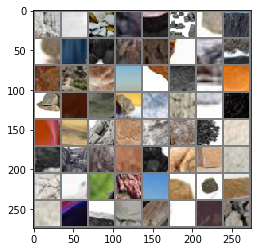

56
tensor([2, 5, 4, 4, 5, 6, 4, 4, 1, 5, 2, 0, 0, 5, 2, 5, 4, 3, 4, 5, 2, 5, 0, 6,
        0, 6, 0, 1, 2, 6, 4, 4, 5, 5, 0, 6, 0, 5, 5, 0, 5, 1, 2, 0, 6, 4, 0, 6,
        4, 6, 0, 6, 4, 4, 0, 4, 0, 4, 6, 0, 4, 0, 0, 5])
(64, 3, 32, 32)
('2_2232.jpg', '5_3405.jpg', '4_545.jpg', '4_1560.jpg', '5_756.jpg', '6_3121.jpeg', '4_1206.jpg', '4_223.jpg', '1_414.jpg', '5_3363.jpg', '2_2554.jpg', '0_607.jpg', '0_4189.jpg', '5_1574.jpg', '2_1049.jpg', '5_1560.jpg', '4_1212.jpg', '3_908.jpg', '4_237.jpg', '5_2069.jpg', '2_2540.jpg', '5_3377.jpg', '0_613.jpg', '6_2562.png', '0_175.jpg', '6_859.jpg', '0_3194.jpg', '1_366.jpg', '2_2226.jpg', '6_681.jpg', '4_551.jpg', '4_1574.jpg', '5_742.jpg', '5_1206.jpg', '0_1783.jpg', '6_56.jpg', '0_2639.jpeg', '5_1951.jpg', '5_1789.jpg', '0_2705.jpg', '5_2280.jpg', '1_831.jpg', '2_2971.jpg', '0_4374.jpg', '6_1057.jpg', '4_1945.jpg', '0_4412.jpg', '6_1731.jpg', '4_960.jpg', '6_468.jpg', '0_2063.jpg', '6_3126.jpg', '4_2294.jpg', '4_2280.jpg', '0_3369.jpg', '4_1951.jp

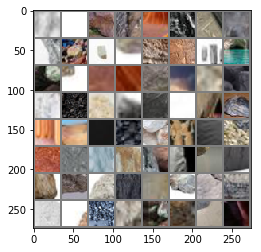

57
tensor([1, 2, 6, 0, 5, 0, 0, 2, 3, 2, 0, 1, 0, 0, 6, 3, 4, 0, 5, 4, 6, 3, 0, 4,
        6, 5, 4, 6, 6, 0, 6, 2, 5, 6, 0, 2, 1, 2, 2, 3, 0, 0, 6, 5, 2, 5, 4, 4,
        2, 5, 4, 2, 4, 5, 5, 4, 3, 5, 4, 3, 2, 3, 2, 5])
(64, 3, 32, 32)
('1_825.jpg', '2_2965.jpg', '6_1043.jpg', '0_4360.jpg', '5_1945.jpg', '0_1218.jpg', '0_2739.jpg', '2_716.jpg', '3_505.jpg', '2_2795.jpg', '0_3427.jpg', '1_400.png', '0_1230.jpg', '0_1556.jpg', '6_2204.jpg', '3_263.jpg', '4_1979.jpg', '0_3341.jpg', '5_597.jpg', '4_784.jpg', '6_454.jpg', '3_277.jpg', '0_3355.jpg', '4_948.jpg', '6_1719.jpg', '5_583.jpg', '4_790.jpg', '6_342.jpeg', '6_440.jpg', '0_1542.jpg', '6_2210.jpg', '2_1288.jpg', '5_1979.jpg', '6_2576.jpg', '0_1224.jpg', '2_2959.jpg', '1_819.jpg', '2_702.jpg', '2_2781.jpg', '3_511.jpg', '0_3433.jpg', '0_439.jpg', '6_1094.jpg', '5_13.jpg', '2_931.jpg', '5_2243.jpg', '4_1038.jpg', '4_2531.jpg', '2_1263.jpg', '5_1992.jpg', '4_1845.webp', '2_1505.jpg', '4_2257.jpg', '5_568.jpg', '5_2525.jpg', '4_1986.jpg',

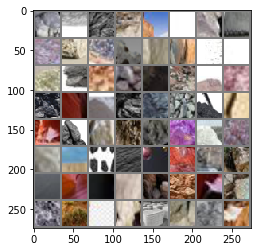

58
tensor([4, 4, 2, 6, 5, 3, 6, 5, 5, 6, 2, 5, 6, 0, 0, 2, 5, 1, 5, 4, 5, 2, 4, 4,
        6, 5, 6, 5, 2, 0, 1, 0, 2, 0, 5, 0, 5, 2, 5, 4, 6, 4, 0, 6, 2, 5, 1, 0,
        0, 3, 5, 2, 1, 2, 3, 5, 4, 4, 5, 4, 0, 5, 2, 5])
(64, 3, 32, 32)
('4_2243.jpg', '4_2525.jpg', '2_1277.jpg', '6_2589.jpg', '5_1986.jpg', '3_1505.jpg', '6_1080.jpg', '5_3149.jpg', '5_2257.jpg', '6_2788.jpeg', '2_925.jpg', '5_1776.jpg', '6_2767.jpeg', '0_2922.jpg', '0_405.jpg', '2_2756.jpg', '5_3161.jpg', '1_616.jpg', '5_232.jpg', '4_1004.jpg', '5_554.jpg', '2_26.jpg', '4_1762.jpg', '4_747.jpg', '6_1916.jpg', '5_2519.jpg', '6_497.jpg', '5_3607.jpg', '2_2030.jpg', '0_3382.jpg', '1_170.jpg', '0_363.jpg', '2_1539.jpg', '0_1595.jpg', '5_1010.jpg', '0_1581.jpg', '5_1004.jpg', '2_32.jpg', '5_540.jpg', '4_1776.jpg', '6_1902.jpg', '4_753.jpg', '0_2088.jpg', '6_483.jpg', '2_2024.jpg', '5_3613.jpg', '1_164.jpg', '0_3396.jpg', '0_377.jpg', '3_1539.jpg', '5_3175.jpg', '2_2742.jpg', '1_602.jpg', '2_919.jpg', '3_360.JPEG', '5_226.jpg'

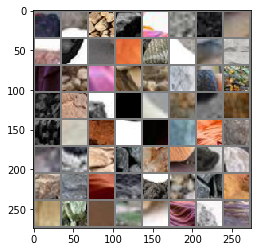

59
tensor([1, 0, 6, 4, 6, 5, 4, 5, 4, 5, 2, 1, 0, 0, 0, 5, 3, 2, 5, 2, 5, 4, 5, 5,
        2, 1, 0, 0, 4, 0, 5, 2, 0, 1, 4, 6, 6, 5, 2, 4, 0, 5, 3, 4, 6, 4, 4, 2,
        5, 2, 5, 4, 5, 5, 2, 1, 2, 3, 6, 5, 2, 5, 0, 6])
(64, 3, 32, 32)
('1_172.jpg', '0_3380.jpg', '6_1914.jpg', '4_745.jpg', '6_495.jpg', '5_556.jpg', '4_1760.jpg', '5_230.jpg', '4_1006.jpg', '5_3163.jpg', '2_2754.jpg', '1_614.jpg', '0_4389.jpg', '0_407.jpg', '0_2920.jpg', '5_1774.jpg', '3_747.JPEG', '2_1249.jpg', '5_1760.jpg', '2_2998.jpg', '5_224.jpg', '4_1012.jpg', '5_2269.jpg', '5_39.jpg', '2_2740.jpg', '1_600.jpg', '0_2934.jpg', '0_413.jpg', '4_989.jpg', '0_375.jpg', '5_3611.jpg', '2_2026.jpg', '0_3394.jpg', '1_166.jpg', '4_751.jpg', '6_1900.jpg', '6_481.jpg', '5_542.jpg', '2_30.jpg', '4_1774.jpg', '0_1583.jpg', '5_1006.jpg', '3_1275.jpg', '4_1984.jpg', '6_1928.jpg', '4_779.jpg', '4_2255.jpg', '2_1507.jpg', '5_1990.jpg', '2_1261.jpg', '5_1748.jpg', '4_2533.jpg', '5_11.jpg', '5_2241.jpg', '2_933.jpg', '1_628.jpg', '2_2

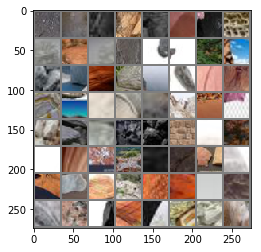

60
tensor([5, 2, 4, 4, 0, 2, 5, 3, 0, 4, 5, 4, 4, 6, 5, 3, 0, 6, 0, 0, 6, 2, 3, 0,
        6, 2, 2, 0, 2, 6, 0, 6, 6, 0, 4, 6, 0, 5, 0, 0, 3, 6, 4, 3, 0, 3, 0, 4,
        6, 0, 4, 0, 2, 6, 0, 1, 2, 0, 6, 5, 3, 3, 5, 5])
(64, 3, 32, 32)
('5_1984.jpg', '2_1275.jpg', '4_2527.jpg', '4_2241.jpg', '0_1170.jpeg', '2_1513.jpg', '5_2185.webp', '3_1261.jpg', '0_349.jpg', '4_1990.jpg', '5_2533.jpg', '4_1748.jpg', '4_786.jpg', '6_456.jpg', '5_595.jpg', '3_261.jpg', '0_3343.jpg', '6_2206.jpg', '0_1554.jpg', '0_1232.jpg', '6_2560.jpg', '2_2797.jpg', '3_507.jpg', '0_3425.jpg', '6_1069.jpg', '2_714.jpg', '2_2783.jpg', '0_3431.jpg', '2_700.jpg', '6_324.jpg', '0_1226.jpg', '6_2574.jpg', '6_2212.jpg', '0_1540.jpg', '4_792.jpg', '6_442.jpg', '0_2049.jpg', '5_581.jpg', '0_4438.jpg', '0_3357.jpg', '3_1063.png', '6_3124.jpg', '4_2296.jpg', '3_194.JPEG', '0_1568.jpg', '3_1349.jpeg', '0_2061.jpg', '4_962.jpg', '6_1733.jpg', '0_4410.jpg', '4_1947.jpg', '0_3419.jpg', '2_728.jpg', '6_1055.jpg', '0_4376.jpg', '1_8

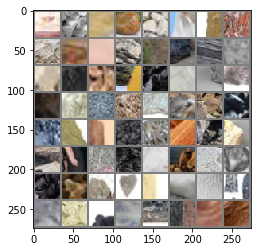

61
tensor([5, 0, 6, 1, 2, 1, 0, 6, 5, 0, 6, 4, 4, 1, 6, 4, 1, 5, 6, 1, 5, 4, 4, 4,
        5, 6, 4, 5, 0, 1, 5, 2, 0, 2, 5, 0, 6, 0, 5, 6, 3, 0, 4, 5, 6, 0, 4, 1,
        0, 5, 2, 5, 0, 0, 3, 1, 5, 2, 3, 4, 4, 0, 4, 5])
(64, 3, 32, 32)
('5_3188.jpg', '0_4362.jpg', '6_1041.jpg', '1_827.jpg', '2_2967.jpg', '1_75.png', '0_2713.jpg', '6_318.jpg', '5_2296.jpg', '0_2075.jpg', '6_1727.jpg', '4_976.jpg', '4_1953.jpg', '1_199.jpg', '6_3130.jpg', '4_2282.jpg', '1_49.jpg', '5_1576.jpg', '6_2979.jpg', '1_416.jpg', '5_3361.jpg', '4_221.jpg', '4_1204.jpg', '4_1562.jpg', '5_754.jpg', '6_697.jpg', '4_547.jpg', '5_2719.jpg', '0_3182.jpg', '1_370.jpg', '5_3407.jpg', '2_2230.jpg', '0_163.jpg', '2_1739.jpg', '5_1210.jpg', '0_1795.jpg', '6_40.jpg', '0_1959.jpg', '5_1204.jpg', '6_54.jpg', '3_1037.jpeg', '0_1781.jpg', '4_1576.jpg', '5_740.jpg', '6_3118.png', '0_2288.jpg', '4_553.jpg', '1_364.jpg', '0_3196.jpg', '5_998.jpg', '2_2224.jpg', '5_3413.jpg', '0_177.jpg', '0_611.jpg', '3_1739.jpg', '1_402.jpg', '5_3

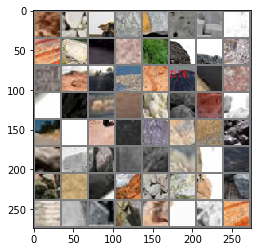

62
tensor([6, 6, 5, 3, 0, 4, 4, 2, 0, 0, 2, 4, 5, 5, 2, 3, 6, 2, 5, 2, 1, 6, 0, 2,
        6, 5, 4, 4, 1, 2, 2, 6, 6, 3, 5, 5, 4, 0, 0, 6, 6, 0, 2, 0, 3, 2, 4, 6,
        6, 0, 2, 6, 0, 3, 5, 2, 1, 5, 6, 4, 0, 6, 2, 6])
(64, 3, 32, 32)
('6_1294.jpg', '6_2548.png', '5_2043.jpg', '3_922.jpg', '0_3800.jpg', '4_1238.jpg', '4_2731.jpg', '2_1063.jpg', '0_1971.jpg', '0_4404.png', '2_1705.jpg', '4_2057.jpg', '5_768.jpg', '5_2725.jpg', '2_3112.jpg', '3_1077.jpg', '6_873.jpg', '2_3106.jpg', '5_2731.jpg', '2_2218.jpg', '1_358.jpg', '6_867.jpg', '0_1965.jpg', '2_1711.jpg', '6_68.jpg', '5_1238.jpg', '4_2043.jpg', '4_2725.jpg', '1_61.jpg', '2_979.webp', '2_1077.jpg', '6_2789.jpg', '6_1280.jpg', '3_1705.jpg', '5_3349.jpg', '5_2057.jpg', '4_209.jpg', '0_3814.jpg', '0_2539.jpg', '6_132.jpg', '6_2878.jpeg', '0_4148.jpg', '2_516.jpg', '0_3627.jpg', '3_705.jpg', '2_2595.jpg', '4_2916.jpg', '6_2762.jpg', '6_83.jpg', '0_1756.jpg', '2_1922.jpg', '6_2004.jpg', '0_3141.jpg', '3_1088.jpg', '5_2902.jpg', '2_270.

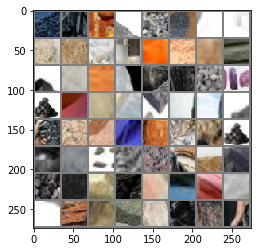

63
tensor([5, 1, 5, 6, 0, 6, 2, 6, 2, 4, 6, 0, 6, 2, 0, 2, 3, 5, 5, 0, 0, 0, 6, 5,
        6, 1, 6, 0, 4, 6, 4, 5, 0, 6, 0, 4, 0, 5, 0, 0, 0, 3, 6, 0, 6, 5, 0, 4,
        4, 0, 3, 5, 4, 4, 0, 1, 2, 5, 3, 1, 5, 2, 4, 4])
(64, 3, 32, 32)
('5_2916.jpg', '1_1030.jpg', '5_783.jpg', '6_640.jpg', '0_1742.jpg', '6_97.jpg', '2_1936.jpg', '6_2010.jpg', '2_1088.jpg', '4_2902.jpg', '6_2776.jpg', '0_1024.jpg', '6_126.jpg', '2_502.jpg', '0_3633.jpg', '2_2581.jpg', '3_711.jpg', '5_1589.jpg', '5_2080.jpg', '0_822.jpg', '0_2505.jpg', '0_4174.jpg', '6_1257.jpg', '5_973.jpg', '6_1531.jpg', '1_1018.jpg', '6_668.jpg', '0_2263.jpg', '4_2094.jpg', '6_2038.jpg', '4_2080.jpg', '5_967.jpg', '0_3169.jpg', '6_1525.jpg', '0_188.jpg', '4_1589.jpg', '0_2277.jpg', '5_2094.jpg', '0_1837.webp', '0_2511.jpg', '0_836.jpg', '3_439.JPEG', '6_1243.jpg', '0_4160.jpg', '6_2992.jpg', '5_1402.jpg', '0_1187.jpg', '4_2679.jpg', '4_1370.jpg', '0_3948.jpg', '3_1471.JPEG', '5_146.jpg', '4_355.jpg', '4_45.jpg', '0_3790.jpg', '1_562.j

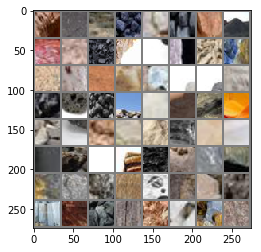

64
tensor([5, 2, 5, 3, 0, 2, 5, 2, 1, 2, 5, 4, 5, 4, 5, 4, 5, 4, 4, 5, 2, 0, 5, 0,
        3, 0, 5, 4, 0, 5, 4, 2, 6, 4, 4, 5, 2, 0, 5, 3, 6, 6, 2, 1, 5, 2, 6, 3,
        2, 5, 0, 5, 4, 2, 0, 3, 4, 2, 6, 4, 0, 4, 5, 0])
(64, 3, 32, 32)
('5_620.jpg', '2_1895.jpg', '5_1364.jpg', '3_1021.JPEG', '0_1839.jpg', '2_1881.jpg', '5_1370.jpg', '2_1659.jpg', '1_210.jpg', '2_2350.jpg', '5_3567.jpg', '4_427.jpg', '5_2679.jpg', '4_1402.jpg', '5_634.jpg', '4_1364.jpg', '5_152.jpg', '4_341.jpg', '4_51.jpg', '5_3201.jpg', '2_2436.jpg', '0_765.jpg', '5_1416.jpg', '0_1193.jpg', '3_856.jpg', '0_3974.jpg', '5_2137.jpg', '4_369.jpg', '0_995.jpg', '5_3229.jpg', '4_79.jpg', '2_1117.jpg', '6_2831.jpg', '4_2645.jpg', '4_2123.jpg', '5_1358.jpg', '2_1671.jpg', '0_1805.jpg', '5_2889.jpg', '3_70.jpg', '6_1486.jpg', '6_907.jpg', '2_2378.jpg', '1_238.jpg', '5_2651.jpg', '2_3066.jpg', '6_1492.jpg', '3_1117.jpg', '2_3072.jpg', '5_2645.jpg', '0_4299.jpeg', '5_608.jpg', '4_2137.jpg', '2_1665.jpg', '0_1811.jpg', '3_643.JPE

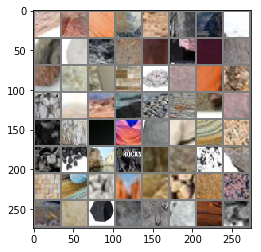

65
tensor([2, 0, 0, 4, 3, 2, 5, 4, 0, 6, 4, 6, 2, 3, 6, 2, 2, 6, 5, 0, 2, 3, 6, 5,
        2, 0, 2, 6, 2, 0, 0, 6, 4, 1, 4, 0, 3, 0, 2, 5, 0, 4, 0, 4, 2, 6, 0, 3,
        3, 0, 3, 5, 0, 6, 2, 5, 0, 3, 6, 5, 6, 0, 6, 5])
(64, 3, 32, 32)
('2_489.jpg', '0_759.jpg', '0_3753.jpg', '4_86.jpg', '3_671.jpg', '2_462.jpg', '5_185.jpg', '4_396.jpg', '0_1144.jpg', '6_2616.jpg', '4_2862.jpg', '6_2170.jpg', '2_1856.jpg', '3_839.JPEG', '6_720.jpg', '2_3099.jpg', '2_304.jpg', '6_1479.jpg', '5_2876.jpg', '0_3035.jpg', '2_2387.jpg', '3_117.jpg', '6_734.jpg', '5_2862.jpg', '2_310.jpg', '0_3021.jpg', '2_2393.jpg', '6_2164.jpg', '2_1842.jpg', '0_1636.jpg', '0_1150.jpg', '6_2602.jpg', '4_2876.jpg', '1_760.png', '4_92.jpg', '0_3747.jpg', '3_665.jpg', '0_4028.jpg', '2_476.jpg', '5_191.jpg', '0_2459.jpg', '4_382.jpg', '0_1178.jpg', '4_2686.jpg', '2_2439.webp', '6_1323.jpg', '0_4000.jpg', '3_895.jpg', '3_1308.jpeg', '0_2471.jpg', '3_585.JPEG', '5_2692.jpg', '0_2317.jpg', '6_1445.jpg', '2_338.jpg', '5_807.jpg', 

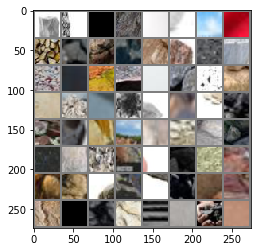

66
tensor([5, 3, 0, 6, 0, 4, 3, 4, 5, 4, 4, 6, 2, 0, 5, 2, 0, 4, 5, 6, 5, 4, 0, 5,
        2, 0, 3, 0, 5, 0, 0, 0, 2, 5, 0, 1, 4, 6, 0, 5, 4, 6, 5, 3, 4, 6, 4, 2,
        0, 3, 4, 5, 4, 4, 5, 6, 6, 3, 2, 6, 4, 4, 2, 3])
(64, 3, 32, 32)
('5_3598.jpg', '3_659.jpg', '0_4014.jpg', '6_1337.jpg', '0_2465.jpg', '4_2692.jpg', '3_1467.png', '4_3003.jpg', '5_1166.jpg', '4_1614.jpg', '4_631.jpg', '6_1860.jpg', '2_2146.jpg', '0_2854.jpg', '5_3017.jpg', '2_2620.jpg', '0_3592.jpg', '4_157.jpg', '5_2309.jpg', '6_287.jpg', '5_344.jpg', '4_1172.jpg', '0_1385.jpg', '5_1600.jpg', '2_1329.jpg', '0_21.jpg', '3_751.JPEG', '0_1391.jpg', '5_1614.jpg', '0_35.jpg', '0_567.jpg', '0_2840.jpg', '2_2634.jpg', '5_3003.jpg', '0_3586.jpg', '1_774.jpg', '4_143.jpg', '6_293.jpg', '0_2698.jpg', '5_350.jpg', '4_1166.jpg', '6_3117.jpeg', '5_436.jpg', '3_1426.JPEG', '4_1600.jpg', '6_1874.jpg', '4_625.jpg', '2_2152.jpg', '0_201.jpg', '3_1329.jpg', '4_3017.jpg', '5_1172.jpg', '4_2309.jpg', '4_1628.jpg', '5_2453.jpg', '6_3052.

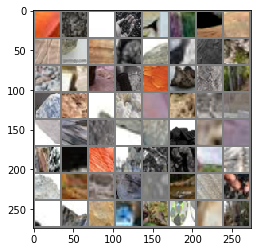

67
tensor([0, 2, 5, 1, 5, 2, 3, 1, 3, 2, 5, 2, 1, 4, 5, 2, 2, 6, 4, 5, 6, 4, 6, 2,
        0, 0, 2, 6, 0, 0, 6, 1, 6, 0, 4, 5, 2, 0, 3, 0, 4, 6, 6, 5, 6, 2, 0, 0,
        6, 6, 2, 2, 3, 0, 2, 6, 5, 3, 4, 0, 6, 4, 0, 5])
(64, 3, 32, 32)
('0_2868.jpg', '2_847.jpg', '5_2335.jpg', '1_984.jpg', '5_378.jpg', '2_3013.webp', '3_1473.jpg', '1_748.jpg', '3_498.jpg', '2_2608.jpg', '5_2321.jpg', '2_853.jpg', '1_990.jpg', '4_2453.jpg', '5_1628.jpg', '2_1301.jpg', '2_1467.jpg', '6_3087.jpg', '4_2335.jpg', '5_2447.jpg', '6_1848.jpg', '4_619.jpg', '6_1690.jpg', '2_2185.jpg', '0_3237.jpg', '0_4558.jpg', '2_106.jpg', '6_522.jpg', '0_2129.jpg', '0_1420.jpg', '6_2372.jpg', '1_576.png', '6_2414.jpg', '0_1346.jpg', '4_194.jpg', '5_387.jpg', '2_660.jpg', '0_2897.jpg', '3_1498.jpg', '0_3551.jpg', '4_180.jpg', '6_323.jpeg', '6_250.jpg', '5_393.jpg', '6_1109.jpg', '2_674.jpg', '0_2883.jpg', '0_3545.jpg', '6_3078.jpg', '6_2366.jpg', '2_1498.jpg', '2_2191.jpg', '3_301.jpg', '0_3223.jpg', '2_112.jpg', '6_536.jpg',

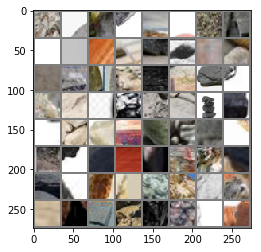

68
tensor([0, 6, 2, 1, 0, 6, 3, 6, 5, 4, 5, 3, 4, 0, 2, 1, 4, 2, 0, 2, 6, 0, 0, 4,
        4, 6, 0, 0, 4, 5, 0, 6, 3, 5, 0, 6, 2, 0, 3, 2, 1, 4, 2, 0, 4, 5, 6, 0,
        5, 4, 0, 6, 3, 0, 4, 5, 0, 0, 4, 6, 3, 4, 6, 5])
(64, 3, 32, 32)
('0_2673.jpg', '6_278.jpg', '2_884.jpg', '1_947.jpg', '0_4202.jpg', '6_1121.jpg', '3_881.jpeg', '6_2428.jpg', '5_1827.jpg', '4_2484.jpg', '5_1833.jpg', '3_1665.png', '4_2490.jpg', '0_2667.jpg', '2_890.jpg', '1_953.jpg', '4_1199.jpg', '2_2813.jpg', '0_598.jpg', '2_648.jpg', '6_1135.jpg', '0_4216.jpg', '0_3579.jpg', '4_1827.jpg', '4_802.jpg', '6_1653.jpg', '0_4570.jpg', '0_2101.jpg', '4_8.jpg', '5_2484.jpg', '0_1408.jpg', '6_3044.jpg', '3_1103.png', '5_2412.webp', '0_3578.jpg', '6_1134.jpg', '2_649.jpg', '0_4217.jpg', '3_395.jpeg', '2_2812.jpg', '1_952.jpg', '4_1198.jpg', '2_891.jpg', '0_2666.jpg', '4_2491.jpg', '5_1832.jpg', '6_3045.jpg', '0_1409.jpg', '5_2485.jpg', '4_9.jpg', '0_2100.jpg', '6_1652.jpg', '3_1518.JPEG', '0_4571.jpg', '4_1826.jpg', '5_2491.

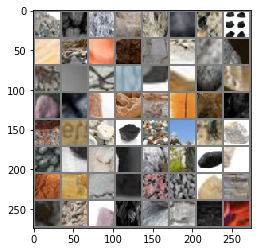

69
tensor([4, 3, 6, 5, 0, 6, 2, 1, 2, 6, 0, 0, 6, 3, 0, 3, 0, 2, 6, 5, 6, 4, 6, 2,
        0, 2, 2, 6, 6, 0, 6, 0, 0, 0, 2, 0, 3, 2, 0, 2, 5, 6, 4, 0, 6, 1, 2, 5,
        4, 1, 5, 2, 3, 2, 1, 3, 6, 3, 5, 4, 6, 4, 6, 2])
(64, 3, 32, 32)
('4_2485.jpg', '3_843.png', '6_2429.jpg', '5_1826.jpg', '0_4203.jpg', '6_1120.jpg', '2_2806.jpg', '1_946.jpg', '2_885.jpg', '6_279.jpg', '0_2672.jpg', '0_1353.jpg', '6_2401.jpg', '3_1658.png', '0_3544.jpg', '3_466.jpg', '0_2882.jpg', '2_675.jpg', '6_1108.jpg', '5_392.jpg', '6_251.jpg', '4_181.jpg', '6_537.jpg', '2_113.jpg', '0_3222.jpg', '2_2190.jpg', '2_1499.jpg', '6_2367.jpg', '6_3079.jpg', '0_1435.jpg', '6_2373.jpg', '0_1421.jpg', '0_2128.jpg', '0_4559.jpg', '2_107.jpg', '0_3236.jpg', '3_314.jpg', '2_2184.jpg', '0_2896.jpg', '2_661.jpg', '5_386.jpg', '6_245.jpg', '4_195.jpg', '0_1347.jpg', '6_2415.jpg', '1_577.png', '2_1300.jpg', '5_1629.jpg', '4_2452.jpg', '1_991.jpg', '5_2320.jpg', '2_852.jpg', '3_499.jpg', '2_2609.jpg', '1_749.jpg', '3_1472.jpg', '

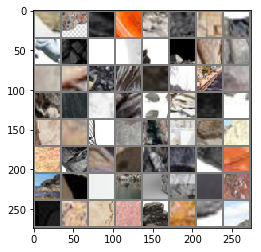

70
tensor([6, 6, 4, 2, 6, 3, 5, 4, 3, 5, 2, 5, 3, 0, 2, 4, 4, 0, 5, 0, 6, 4, 1, 0,
        2, 5, 0, 0, 3, 5, 0, 2, 4, 5, 4, 3, 2, 4, 6, 4, 2, 6, 4, 4, 5, 5, 4, 0,
        2, 3, 5, 0, 4, 5, 4, 5, 0, 1, 5, 2, 0, 5, 5, 0])
(64, 3, 32, 32)
('6_2398.jpg', '6_2454.jpeg', '4_2320.jpg', '2_1472.jpg', '6_1685.jpg', '3_1300.jpg', '5_2452.jpg', '4_1629.jpg', '3_403.jpeg', '5_379.jpg', '2_846.jpg', '5_2334.jpg', '3_1466.jpg', '0_2869.jpg', '2_1314.jpg', '4_2446.jpg', '4_1167.jpg', '0_4466.jpeg', '5_351.jpg', '0_2699.jpg', '6_292.jpg', '4_142.jpg', '1_775.jpg', '0_3587.jpg', '2_2635.jpg', '5_3002.jpg', '0_2841.jpg', '0_566.jpg', '3_1631.JPEG', '5_1615.jpg', '0_1390.jpg', '2_2550.webp', '4_2308.jpg', '5_1173.jpg', '4_3016.jpg', '3_1328.jpg', '2_2153.jpg', '4_624.jpg', '6_1875.jpg', '4_1601.jpg', '2_2147.jpg', '6_1861.jpg', '4_630.jpg', '4_1615.jpg', '5_423.jpg', '5_1167.jpg', '4_3002.jpg', '0_20.jpg', '2_1328.jpg', '3_664.png', '5_1601.jpg', '0_1384.jpg', '4_1173.jpg', '5_345.jpg', '4_156.jpg', '5_2

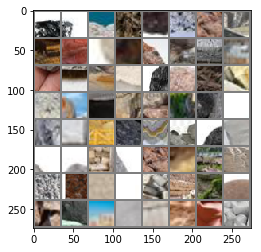

71
tensor([6, 5, 6, 1, 4, 0, 0, 0, 6, 1, 3, 0, 0, 3, 6, 0, 4, 0, 0, 5, 2, 6, 0, 0,
        5, 0, 2, 6, 3, 2, 0, 5, 2, 6, 4, 0, 5, 0, 2, 2, 4, 0, 4, 6, 0, 4, 6, 0,
        4, 5, 2, 3, 0, 4, 2, 0, 6, 5, 2, 6, 2, 6, 0, 2])
(64, 3, 32, 32)
('6_709.jpg', '5_2687.jpg', '6_2159.jpg', '1_985.png', '4_2693.jpg', '0_2464.jpg', '0_943.jpg', '0_4015.jpg', '6_1336.jpg', '1_588.jpg', '3_658.jpg', '0_957.jpg', '0_2470.jpg', '3_894.jpg', '6_1322.jpg', '0_4001.jpg', '4_2687.jpg', '0_1179.jpg', '0_3008.jpg', '5_806.jpg', '2_339.jpg', '6_1444.jpg', '0_2316.jpg', '0_4348.jpeg', '5_2693.jpg', '0_1637.jpg', '2_1843.jpg', '6_2165.jpg', '3_102.jpg', '2_2392.jpg', '0_3020.jpg', '5_2863.jpg', '2_311.jpg', '6_735.jpg', '4_383.jpg', '0_2458.jpg', '5_190.jpg', '0_4029.jpg', '2_477.jpg', '2_1844.webp', '4_93.jpg', '0_3746.jpg', '4_2877.jpg', '6_286.png', '0_1151.jpg', '4_2863.jpg', '6_2617.jpg', '0_1145.jpg', '4_397.jpg', '5_184.jpg', '2_463.jpg', '3_670.jpg', '0_3752.jpg', '4_87.jpg', '2_2386.jpg', '0_3034.jpg', '

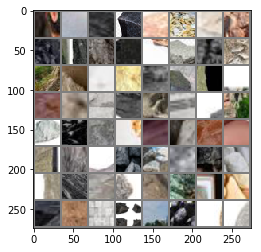

72
tensor([3, 4, 5, 2, 5, 3, 6, 3, 0, 2, 5, 0, 4, 4, 6, 2, 4, 4, 6, 2, 3, 4, 5, 0,
        5, 4, 0, 3, 5, 2, 1, 2, 6, 5, 6, 3, 0, 2, 5, 4, 4, 4, 5, 2, 5, 1, 3, 2,
        5, 2, 3, 0, 5, 6, 0, 3, 3, 5, 2, 0, 4, 4, 5, 4])
(64, 3, 32, 32)
('3_1689.JPEG', '4_2136.jpg', '5_609.jpg', '2_3073.jpg', '5_2644.jpg', '3_65.jpg', '6_1493.jpg', '3_1670.jpg', '0_758.jpg', '2_488.jpg', '5_2122.jpg', '0_3961.jpg', '4_1359.jpg', '4_2650.jpg', '6_2824.jpg', '2_1102.jpg', '4_2888.jpg', '4_2644.jpg', '6_2830.jpg', '2_1116.jpg', '3_1664.jpg', '4_78.jpg', '5_3228.jpg', '0_994.jpg', '5_2136.jpg', '4_368.jpg', '0_3975.jpg', '3_857.jpg', '5_2650.jpg', '2_3067.jpg', '1_239.jpg', '2_2379.jpg', '6_906.jpg', '5_2888.jpg', '6_1487.jpg', '3_71.jpg', '0_1804.jpg', '2_1670.jpg', '5_1359.jpg', '4_2122.jpg', '4_1403.jpg', '4_426.jpg', '5_2678.jpg', '2_2351.jpg', '5_3566.jpg', '1_211.jpg', '3_59.jpg', '2_1658.jpg', '5_1371.jpg', '2_1880.jpg', '3_842.JPEG', '0_1192.jpg', '5_1417.jpg', '6_2818.jpg', '0_3550.png', '3_472.png

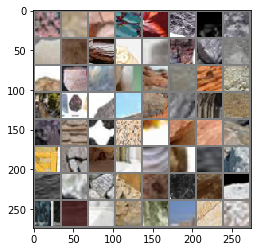

73
tensor([0, 2, 5, 4, 1, 0, 4, 5, 4, 0, 4, 5, 0, 5, 2, 5, 4, 4, 5, 2, 1, 0, 4, 6,
        2, 6, 0, 5, 4, 6, 0, 6, 0, 0, 0, 5, 3, 0, 6, 0, 0, 5, 6, 5, 3, 6, 4, 0,
        6, 1, 6, 5, 6, 2, 0, 6, 4, 6, 5, 1, 6, 2, 5, 6])
(64, 3, 32, 32)
('0_770.jpg', '2_2423.jpg', '5_3214.jpg', '4_44.jpg', '1_563.jpg', '0_3791.jpg', '4_354.jpg', '5_147.jpg', '4_1371.jpg', '0_3949.jpg', '4_2678.jpg', '5_1403.jpg', '0_1838.jpg', '5_1365.jpg', '2_1894.jpg', '5_621.jpg', '4_1417.jpg', '4_432.jpg', '5_3572.jpg', '2_2345.jpg', '1_205.jpg', '0_2276.jpg', '4_1588.jpg', '6_3068.jpeg', '2_259.jpg', '6_1524.jpg', '0_3168.jpg', '5_966.jpg', '4_2081.jpg', '6_2993.jpg', '0_1019.jpg', '6_1242.jpg', '0_4161.jpg', '0_837.jpg', '0_2510.jpg', '5_2095.jpg', '3_738.jpg', '0_4175.jpg', '6_1256.jpg', '0_2504.jpg', '0_823.jpg', '5_2081.jpg', '6_2987.jpg', '5_1588.jpg', '3_1506.png', '6_2039.jpg', '4_2095.jpg', '0_2262.jpg', '6_669.jpg', '1_1019.jpg', '6_1530.jpg', '5_972.jpg', '6_2011.jpg', '2_1937.jpg', '0_1743.jpg', '6_96.jp

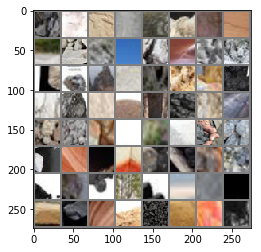

74
tensor([0, 2, 3, 0, 2, 6, 0, 4, 2, 0, 6, 4, 3, 2, 0, 2, 6, 0, 4, 6, 5, 1, 5, 2,
        0, 2, 6, 0, 4, 5, 6, 2, 0, 6, 3, 1, 2, 2, 5, 0, 3, 5, 4, 6, 2, 6, 1, 4,
        2, 6, 3, 4, 0, 4, 3, 5, 6, 3, 6, 3, 5, 2, 5, 4])
(64, 3, 32, 32)
('0_3154.jpg', '2_2580.jpg', '3_710.jpg', '0_3632.jpg', '2_503.jpg', '6_127.jpg', '0_1025.jpg', '4_2903.jpg', '2_1089.jpg', '0_1031.jpg', '6_2763.jpg', '4_2917.jpg', '3_704.jpg', '2_2594.jpg', '0_4149.jpg', '2_517.jpg', '6_133.jpg', '0_2538.jpg', '4_585.jpg', '6_655.jpg', '5_796.jpg', '1_1025.jpg', '5_2903.jpg', '2_271.jpg', '0_3140.jpg', '2_1923.jpg', '6_82.jpg', '0_1757.jpg', '4_2042.jpg', '5_1239.jpg', '6_69.jpg', '2_1710.jpg', '0_1964.jpg', '6_866.jpg', '3_1062.jpg', '1_359.jpg', '2_2219.jpg', '2_3107.jpg', '5_2730.jpg', '0_3815.jpg', '3_937.jpg', '5_2056.jpg', '4_208.jpg', '6_1281.jpg', '2_1076.jpg', '6_2950.jpg', '1_60.jpg', '4_2724.jpg', '2_1062.jpg', '6_2944.jpg', '3_1735.JPEG', '4_2730.jpg', '0_3801.jpg', '4_1239.jpg', '3_923.jpg', '5_2042.jpg',

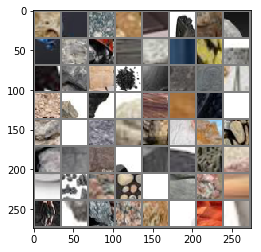

75
tensor([2, 0, 5, 2, 0, 1, 4, 6, 0, 5, 4, 6, 0, 5, 3, 0, 5, 4, 4, 0, 4, 5, 2, 1,
        3, 4, 4, 2, 5, 1, 0, 3, 5, 6, 1, 0, 6, 5, 2, 0, 5, 2, 1, 0, 4, 5, 6, 5,
        4, 5, 6, 0, 2, 1, 0, 6, 5, 0, 6, 5, 4, 6, 4, 1])
(64, 3, 32, 32)
('2_1704.jpg', '0_1970.jpg', '5_999.jpg', '2_2225.jpg', '0_3197.jpg', '1_365.jpg', '4_552.jpg', '6_682.jpg', '0_2289.jpg', '5_741.jpg', '4_1577.jpg', '6_55.jpg', '0_1780.jpg', '5_1205.jpg', '3_157.JPEG', '0_1958.jpg', '5_1563.jpg', '4_2718.jpg', '4_1211.jpg', '0_3829.jpg', '4_234.jpg', '5_3374.jpg', '2_2543.jpg', '1_403.jpg', '3_1738.jpg', '4_1205.jpg', '4_220.jpg', '2_2557.jpg', '5_3360.jpg', '1_417.jpg', '0_604.jpg', '3_512.png', '5_1577.jpg', '6_2978.jpg', '1_48.jpg', '0_1794.jpg', '6_41.jpg', '5_1211.jpg', '2_1738.jpg', '0_162.jpg', '5_3406.jpg', '2_2231.jpg', '1_371.jpg', '0_3183.jpg', '4_546.jpg', '5_2718.jpg', '6_696.jpg', '5_755.jpg', '4_1563.jpg', '5_2297.jpg', '6_319.jpg', '0_2712.jpg', '2_2966.jpg', '1_826.jpg', '0_4363.jpg', '6_1040.jpg', '5_

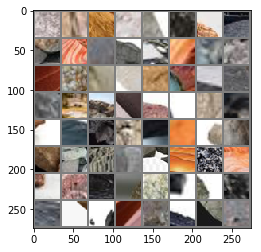

76
tensor([4, 6, 0, 3, 4, 6, 4, 0, 0, 4, 6, 3, 5, 5, 0, 2, 1, 6, 2, 0, 0, 6, 3, 0,
        6, 2, 0, 2, 0, 3, 0, 5, 0, 6, 4, 0, 6, 0, 6, 6, 0, 2, 5, 6, 4, 6, 2, 6,
        0, 2, 3, 6, 4, 2, 5, 6, 0, 2, 5, 5, 4, 5, 4, 3])
(64, 3, 32, 32)
('4_977.jpg', '6_1726.jpg', '0_2074.jpg', '3_229.JPEG', '4_1946.jpg', '6_1732.jpg', '4_963.jpg', '0_4411.jpg', '0_2060.jpg', '4_2297.jpg', '6_964.jpeg', '3_1704.png', '5_1952.jpg', '5_2283.jpg', '0_2706.jpg', '2_2972.jpg', '1_832.jpg', '6_1054.jpg', '2_729.jpg', '0_4377.jpg', '0_3418.jpg', '6_2575.jpg', '3_696.jpeg', '0_1227.jpg', '6_325.jpg', '2_701.jpg', '0_3430.jpg', '2_2782.jpg', '0_3356.jpg', '3_274.jpg', '0_4439.jpg', '5_580.jpg', '0_2048.jpg', '6_443.jpg', '4_793.jpg', '0_1541.jpg', '6_2213.jpg', '0_1555.jpg', '6_3119.jpg', '6_2207.jpg', '0_3342.jpg', '2_867.jfif', '5_594.jpg', '6_457.jpg', '4_787.jpg', '6_331.jpg', '2_715.jpg', '6_1068.jpg', '0_3424.jpg', '2_2796.jpg', '3_506.jpg', '6_2561.jpg', '4_2526.jpg', '2_1274.jpg', '5_1985.jpg', '6_1083.j

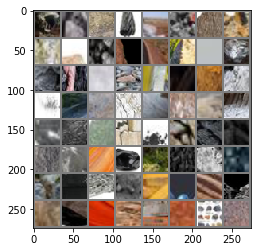

77
tensor([0, 2, 4, 2, 4, 5, 4, 6, 4, 3, 6, 3, 2, 1, 5, 2, 5, 4, 5, 2, 5, 0, 0, 1,
        2, 5, 5, 5, 2, 5, 5, 2, 3, 5, 4, 2, 5, 6, 6, 4, 1, 0, 5, 2, 0, 4, 4, 5,
        2, 6, 4, 6, 0, 1, 2, 5, 0, 3, 5, 4, 5, 0, 0, 6])
(64, 3, 32, 32)
('0_348.jpg', '2_1512.jpg', '4_2240.jpg', '2_1506.jpg', '4_2254.jpg', '5_2526.jpg', '4_778.jpg', '6_1929.jpg', '4_1985.jpg', '3_1274.jpg', '6_1097.jpg', '3_1512.jpg', '2_2769.jpg', '1_629.jpg', '5_2240.jpg', '2_932.jpg', '5_10.jpg', '4_2532.jpg', '5_1749.jpg', '2_1260.jpg', '5_1991.jpg', '0_412.jpg', '0_2935.jpg', '1_601.jpg', '2_2741.jpg', '5_3176.jpg', '5_38.jpg', '5_2268.jpg', '2_2999.jpg', '5_225.jpg', '5_1761.jpg', '2_1248.jpg', '3_1089.png', '5_1007.jpg', '4_1775.jpg', '2_31.jpg', '5_543.jpg', '6_480.jpg', '6_1901.jpg', '4_750.jpg', '1_167.jpg', '0_3395.jpg', '5_3610.jpg', '2_2027.jpg', '0_374.jpg', '4_988.jpg', '4_1761.jpg', '5_557.jpg', '2_25.jpg', '6_494.jpg', '4_744.jpg', '6_1915.jpg', '0_3381.jpg', '1_173.jpg', '2_2033.jpg', '5_3604.jpg', '0_3

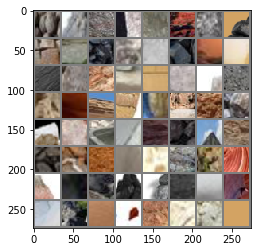

78
tensor([0, 1, 5, 2, 4, 5, 5, 4, 2, 2, 1, 6, 2, 6, 5, 5, 2, 5, 1, 5, 0, 2, 4, 2,
        4, 2, 5, 5, 1, 4, 2, 3, 0, 6, 3, 5, 5, 2, 4, 6, 2, 1, 2, 0, 0, 4, 2, 4,
        6, 5, 4, 5, 0, 6, 2, 4, 5, 3, 0, 0, 1, 0, 5, 2])
(64, 3, 32, 32)
('0_4388.jpg', '1_615.jpg', '5_3162.jpg', '2_2755.jpg', '4_1007.jpg', '5_231.jpg', '5_1048.jpg', '4_2233.jpg', '2_1561.jpg', '2_2068.jpg', '1_128.jpg', '6_1796.jpg', '2_3075.webp', '6_2625.jpeg', '5_2541.jpg', '5_2227.jpg', '2_955.jpg', '5_77.jpg', '1_896.jpg', '5_3139.jpg', '0_3994.jpeg', '2_1207.jpg', '4_2555.jpg', '2_1213.jpg', '4_2541.jpg', '2_941.jpg', '5_2233.jpg', '5_63.jpg', '1_882.jpg', '4_1048.jpg', '2_799.jpg', '3_1561.jpg', '0_449.jpg', '6_1782.jpg', '3_1207.jpg', '5_518.jpg', '5_2555.jpg', '2_2234.webp', '4_2227.jpg', '6_1459.jpeg', '2_1575.jpg', '1_114.jpg', '2_2054.jpg', '0_307.jpg', '0_4489.jpg', '4_1706.jpg', '2_42.jpg', '4_723.jpg', '6_1972.jpg', '5_1074.jpg', '4_2569.jpg', '5_1712.jpg', '0_1297.jpg', '6_395.jpg', '2_969.jpg', '4_1060.j

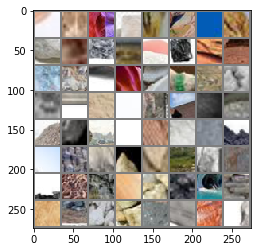

79
tensor([6, 4, 5, 0, 0, 0, 1, 2, 5, 3, 5, 0, 5, 4, 2, 1, 2, 0, 4, 2, 5, 6, 4, 5,
        3, 5, 0, 0, 4, 6, 4, 0, 4, 0, 5, 6, 0, 0, 2, 3, 0, 2, 1, 6, 1, 2, 0, 2,
        1, 4, 5, 6, 5, 6, 0, 6, 4, 4, 6, 6, 0, 3, 2, 6])
(64, 3, 32, 32)
('6_381.jpg', '4_1074.jpg', '5_242.jpg', '0_475.jpg', '0_2952.jpg', '0_3494.jpg', '1_666.jpg', '2_2726.jpg', '5_3111.jpg', '3_763.png', '5_1706.jpg', '0_1283.jpg', '5_1060.jpg', '4_3105.jpg', '2_1549.jpg', '1_100.jpg', '2_2040.jpg', '0_313.jpg', '4_1712.jpg', '2_56.jpg', '5_524.jpg', '6_1966.jpg', '4_737.jpg', '5_2569.jpg', '3_1293.JPEG', '5_2582.jpg', '0_2007.jpg', '0_3319.jpg', '4_1921.jpg', '6_1755.jpg', '4_904.jpg', '0_4476.jpg', '4_2596.jpg', '0_1268.jpg', '5_1935.jpg', '6_1033.jpg', '0_4310.jpg', '0_4494.jpeg', '2_996.jpg', '3_1339.jpeg', '0_2761.jpg', '2_2915.jpg', '1_855.jpg', '6_1027.jpg', '1_699.jpg', '2_982.jpg', '0_2775.jpg', '2_2901.jpg', '1_841.jpg', '4_2582.jpg', '5_1921.jpg', '6_2248.jpg', '5_2596.jpg', '6_1999.jpg', '0_2013.jpg', '6_418.

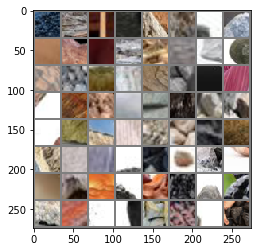

80
tensor([0, 2, 6, 4, 0, 0, 3, 5, 1, 2, 5, 0, 5, 6, 0, 6, 0, 0, 2, 0, 3, 0, 5, 2,
        6, 4, 0, 3, 2, 6, 0, 1, 4, 0, 2, 3, 0, 3, 0, 5, 5, 4, 3, 6, 0, 6, 2, 3,
        0, 0, 4, 2, 6, 0, 4, 5, 4, 6, 6, 3, 6, 5, 1, 3])
(64, 3, 32, 32)
('0_3325.jpg', '2_2097.jpg', '6_1769.jpg', '4_938.jpg', '0_2985.jpg', '0_3443.jpg', '3_561.jpg', '5_88.jpg', '1_869.jpg', '2_2929.jpg', '5_295.jpg', '0_1254.jpg', '5_1909.jpg', '6_2506.jpg', '0_2956.jpeg', '6_2512.jpg', '0_2991.jpg', '0_4338.jpg', '2_766.jpg', '0_3457.jpg', '3_575.jpg', '0_2749.jpg', '5_281.jpg', '2_95.jpg', '6_424.jpg', '4_1909.jpg', '0_3331.jpg', '3_213.jpg', '2_2083.jpg', '6_2274.jpg', '0_1526.jpg', '1_13.jpg', '4_2757.jpg', '0_4304.png', '2_1005.jpg', '3_549.png', '0_3866.jpg', '3_944.jpg', '0_887.jpg', '5_2025.jpg', '5_2743.jpg', '4_1538.jpg', '3_1011.jpg', '6_815.jpg', '0_139.jpg', '6_1594.jpg', '2_1763.jpg', '3_1102.JPEG', '0_4462.png', '0_1917.jpg', '4_2031.jpg', '2_1777.jpg', '6_2089.jpg', '0_1903.jpg', '4_2025.jpg', '5_2757.jpg

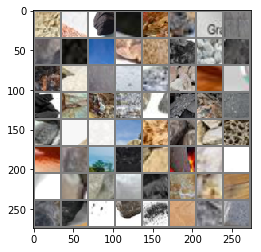

81
tensor([2, 0, 3, 0, 5, 6, 5, 6, 4, 2, 2, 5, 0, 1, 0, 3, 4, 4, 5, 6, 0, 5, 2, 2,
        6, 5, 4, 1, 5, 4, 6, 5, 2, 1, 1, 5, 4, 0, 2, 5, 1, 3, 4, 2, 6, 5, 0, 5,
        5, 2, 1, 0, 0, 4, 4, 4, 0, 3, 6, 0, 0, 0, 6, 6])
(64, 3, 32, 32)
('2_2518.jpg', '0_3872.jpg', '3_950.jpg', '0_893.jpg', '5_2031.jpg', '6_2937.jpg', '5_1538.jpg', '6_2388.jpeg', '4_2743.jpg', '2_1011.jpg', '2_2530.jpg', '5_3307.jpg', '0_3682.jpg', '1_470.jpg', '0_663.jpg', '3_978.jpg', '4_1262.jpg', '4_247.jpg', '5_2019.jpg', '6_197.jpg', '0_1095.jpg', '5_1510.jpg', '2_1039.jpg', '2_1987.jpg', '6_26.jpg', '5_1276.jpg', '4_521.jpg', '1_1081.jpg', '5_732.jpg', '4_1504.jpg', '6_829.jpg', '5_3461.jpg', '2_2256.jpg', '1_316.jpg', '1_1095.jpg', '5_726.jpg', '4_1510.jpg', '0_111.jpg', '2_2242.jpg', '5_3475.jpg', '1_302.jpg', '3_207.png', '4_2019.jpg', '2_1993.jpg', '6_32.jpg', '5_1262.jpg', '0_1081.jpg', '5_1504.jpg', '5_3313.jpg', '2_2524.jpg', '1_464.jpg', '0_3696.jpg', '0_677.jpg', '4_1276.jpg', '4_2385.webp', '4_253.jpg',

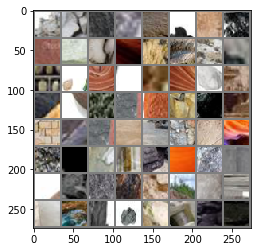

82
tensor([4, 2, 5, 5, 6, 5, 0, 5, 6, 5, 0, 5, 0, 3, 3, 4, 4, 4, 3, 0, 0, 0, 0, 2,
        6, 0, 6, 4, 0, 0, 4, 6, 0, 0, 2, 5, 2, 6, 5, 2, 0, 0, 6, 1, 2, 0, 6, 2,
        0, 2, 6, 2, 5, 2, 0, 6, 1, 4, 6, 3, 0, 2, 6, 4])
(64, 3, 32, 32)
('4_2794.jpg', '2_1978.jpg', '5_1289.jpg', '5_2958.jpg', '6_1557.jpg', '5_915.jpg', '0_2205.jpg', '5_2780.jpg', '6_1543.jpg', '5_901.jpg', '0_2211.jpg', '5_2794.jpg', '0_1718.jpg', '3_1213.png', '3_1575.png', '4_2958.jpg', '4_2780.jpg', '4_1289.jpg', '3_993.jpg', '0_850.jpg', '0_2577.jpg', '0_3669.jpg', '0_688.jpg', '2_558.jpg', '6_1225.jpg', '0_4106.jpg', '6_2704.jpg', '4_2970.jpg', '0_1056.jpg', '0_3899.jpg', '4_284.jpg', '6_154.jpg', '0_3641.jpg', '0_1902.webp', '2_570.jpg', '5_2964.jpg', '2_216.jpg', '6_2808.jpeg', '5_929.jpg', '2_2295.jpg', '0_3127.jpg', '0_2239.jpg', '6_632.jpg', '1_1042.jpg', '2_1944.jpg', '0_1730.jpg', '6_2062.jpg', '2_1950.jpg', '0_1724.jpg', '2_1788.jpg', '6_2076.jpg', '2_202.jpg', '5_2970.jpg', '2_2281.jpg', '0_3133.jpg', '6_6

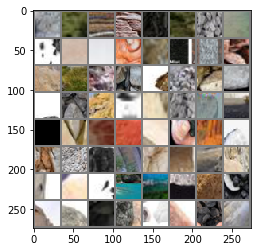

83
tensor([2, 4, 1, 6, 5, 3, 5, 0, 6, 1, 2, 5, 5, 2, 4, 4, 2, 6, 4, 0, 6, 2, 3, 6,
        3, 6, 2, 4, 6, 2, 5, 5, 3, 5, 6, 3, 2, 4, 6, 4, 5, 4, 0, 2, 5, 4, 1, 3,
        5, 0, 5, 4, 5, 2, 0, 3, 5, 4, 4, 6, 2, 5, 1, 0])
(64, 3, 32, 32)
('2_1171.jpg', '4_2623.jpg', '1_935.png', '6_2857.jpg', '5_1458.jpg', '3_8.png', '5_2151.jpg', '0_3912.jpg', '6_1386.jpg', '1_538.jpg', '2_2478.jpg', '5_3529.jpg', '5_2637.jpg', '2_3000.jpg', '4_469.jpg', '4_2145.jpg', '2_1617.jpg', '6_578.png', '4_2151.jpg', '0_1877.jpg', '6_884.jpeg', '2_1603.jpg', '3_1114.JPEG', '6_3075.jpeg', '3_1171.jpg', '6_975.jpg', '2_389.jpg', '4_1458.jpg', '6_3036.png', '2_3014.jpg', '5_2623.jpg', '5_2145.jpg', '3_824.jpg', '5_108.jpg', '6_1392.jpg', '3_1544.JPEG', '2_1165.jpg', '4_2637.jpg', '6_2843.jpg', '4_333.jpg', '5_120.jpg', '4_1316.jpg', '0_4099.jpg', '2_2444.jpg', '5_3273.jpg', '4_23.jpg', '1_504.jpg', '3_1051.JPEG', '5_1464.jpg', '0_1687.jpg', '5_1302.jpg', '4_2179.jpg', '5_3515.jpg', '2_2322.jpg', '0_3090.jpg', '3_11

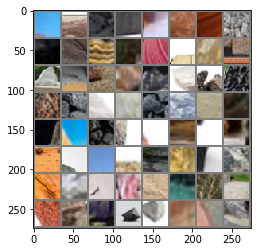

84
tensor([6, 5, 4, 2, 6, 0, 5, 2, 5, 4, 5, 0, 3, 5, 0, 5, 2, 1, 2, 6, 0, 0, 0, 0,
        5, 6, 4, 3, 0, 4, 0, 5, 6, 0, 3, 5, 5, 6, 2, 4, 6, 0, 6, 5, 0, 0, 5, 3,
        6, 6, 2, 2, 3, 0, 1, 5, 4, 6, 3, 0, 0, 5, 6, 0])
(64, 3, 32, 32)
('6_949.jpg', '5_652.jpg', '4_1464.jpg', '2_3028.jpg', '6_791.jpg', '0_1693.jpg', '5_1316.jpg', '2_1159.jpg', '5_1470.jpg', '4_327.jpg', '5_2179.jpg', '0_1320.png', '3_818.jpg', '5_134.jpg', '0_703.jpg', '5_3267.jpg', '2_2450.jpg', '1_510.jpg', '2_438.jpg', '6_1345.jpg', '0_4066.jpg', '0_3709.jpg', '0_930.jpg', '0_2417.jpg', '5_2192.jpg', '6_2894.jpg', '4_2838.jpg', '3_1682.JPEG', '0_1678.jpg', '4_2186.jpg', '0_2371.jpg', '5_861.jpg', '6_1423.jpg', '0_2365.jpg', '3_159.jpg', '5_875.jpg', '5_2838.jpg', '6_1437.jpg', '2_1818.jpg', '4_2192.jpg', '6_2880.jpg', '0_4072.jpg', '6_1351.jpg', '5_3298.jpg', '0_2403.jpg', '0_924.jpg', '5_2186.jpg', '3_1429.png', '6_2670.jpg', '6_1379.jpg', '2_404.jpg', '2_2487.jpg', '3_617.jpg', '0_3735.jpg', '1_1136.jpg', '5_685.j

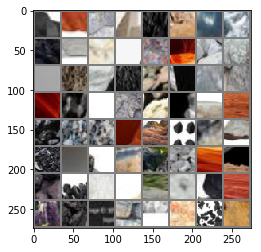

85
tensor([2, 0, 6, 0, 2, 1, 5, 4, 0, 6, 3, 5, 0, 5, 2, 3, 2, 3, 2, 0, 0, 4, 6, 2,
        4, 4, 5, 5, 3, 4, 6, 3, 0, 4, 2, 5, 4, 5, 2, 4, 2, 5, 2, 5, 5, 2, 4, 5,
        3, 2, 4, 2, 4, 5, 6, 6, 4, 5, 4, 5, 0, 0, 2, 2])
(64, 3, 32, 32)
('2_1830.jpg', '0_1888.jpg', '6_2102.jpg', '0_1650.jpg', '2_1824.jpg', '1_1122.jpg', '5_691.jpg', '4_482.jpg', '0_2359.jpg', '6_752.jpg', '3_165.jpg', '5_849.jpg', '0_3047.jpg', '5_2804.jpg', '2_376.jpg', '3_1397.JPEG', '2_410.jpg', '3_603.jpg', '2_2493.jpg', '0_3721.jpg', '0_1136.jpg', '4_2810.jpg', '6_2664.jpg', '2_1415.jpg', '4_3059.jpg', '4_2347.jpg', '5_2435.jpg', '5_478.jpg', '3_1367.jpg', '4_1896.jpg', '6_1184.jpg', '3_1401.jpg', '0_529.jpg', '4_1128.jpg', '2_821.jpg', '5_2353.jpg', '4_2421.jpg', '5_1882.jpg', '2_1373.jpg', '4_2435.jpg', '2_1183.jfif', '5_1896.jpg', '2_1367.jpg', '5_3059.jpg', '5_2347.jpg', '2_835.jpg', '4_119.jpg', '5_2421.jpg', '3_1373.jpg', '2_2108.jpg', '4_1882.jpg', '2_1401.jpg', '4_2353.jpg', '5_1128.jpg', '6_587.jpg', '6_18

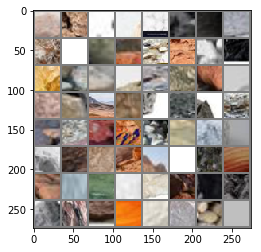

86
tensor([4, 5, 0, 5, 0, 1, 5, 2, 0, 0, 4, 5, 4, 1, 2, 5, 0, 0, 4, 5, 2, 4, 5, 4,
        0, 4, 3, 5, 0, 6, 0, 4, 6, 4, 5, 0, 0, 2, 4, 6, 4, 0, 4, 6, 5, 5, 2, 1,
        5, 0, 3, 0, 6, 2, 5, 0, 6, 0, 3, 5, 0, 3, 4, 6])
(64, 3, 32, 32)
('4_3065.jpg', '5_1100.jpg', '0_1485.jpg', '5_1666.jpg', '0_47.jpg', '1_706.jpg', '5_3071.jpg', '2_2646.jpg', '0_515.jpg', '0_2832.jpg', '4_1114.jpg', '5_322.jpg', '4_131.jpg', '1_712.jpg', '2_2652.jpg', '5_3065.jpg', '0_2826.jpg', '0_501.jpg', '4_1100.jpg', '5_336.jpg', '2_809.jpg', '4_125.jpg', '5_1672.jpg', '4_2409.jpg', '0_53.jpg', '4_3071.jpg', '3_721.JPEG', '5_1114.jpg', '0_1491.jpg', '6_593.jpg', '0_2198.jpg', '4_643.jpg', '6_1812.jpg', '4_1666.jpg', '5_450.jpg', '0_267.jpg', '0_3286.jpg', '2_2134.jpg', '4_870.jpg', '6_1621.jpg', '4_1855.jpg', '0_2173.jpg', '4_2384.jpg', '6_2328.jpg', '5_1841.jpg', '5_1699.jpg', '2_2861.jpg', '1_921.jpg', '5_2390.jpg', '0_2615.jpg', '3_429.jpg', '0_4264.jpg', '6_1147.jpg', '2_2875.jpg', '5_2384.jpg', '0_2601.jpg',

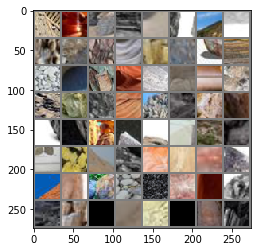

87
tensor([6, 6, 2, 0, 0, 0, 4, 0, 4, 6, 3, 4, 0, 3, 6, 4, 5, 6, 0, 3, 2, 0, 2, 6,
        0, 5, 0, 6, 2, 0, 1, 2, 6, 0, 2, 2, 6, 0, 3, 6, 4, 5, 6, 2, 2, 3, 0, 6,
        2, 0, 1, 0, 2, 5, 0, 6, 3, 5, 4, 6, 3, 0, 4, 6])
(64, 3, 32, 32)
('6_961.png', '6_1635.jpg', '2_148.jpg', '0_4516.jpg', '0_298.jpg', '0_3279.jpg', '4_1841.jpg', '0_2167.jpg', '4_1699.jpg', '6_2314.jpg', '3_1398.jpg', '4_1869.jpg', '0_3251.jpg', '3_373.jpg', '6_544.jpg', '4_694.jpg', '5_487.jpg', '6_222.jpg', '0_3537.jpg', '3_415.jpg', '2_2685.jpg', '0_4258.jpg', '2_606.jpg', '6_2472.jpg', '0_84.jpg', '5_1869.jpg', '0_90.jpg', '6_2466.jpg', '2_1398.jpg', '0_1334.jpg', '1_909.jpg', '2_2849.jpg', '6_236.jpg', '0_3523.jpg', '2_2691.jpg', '2_174.jpg', '6_1609.jpg', '0_3245.jpg', '3_367.jpg', '6_550.jpg', '4_680.jpg', '5_493.jpg', '6_2300.jpg', '2_613.jpg', '2_2690.jpg', '3_400.jpg', '0_3522.jpg', '6_237.jpg', '2_2848.jpg', '0_2254.jpeg', '1_908.jpg', '0_1335.jpg', '2_1399.jpg', '5_1868.jpg', '0_91.jpg', '6_2301.jpg', '3_89

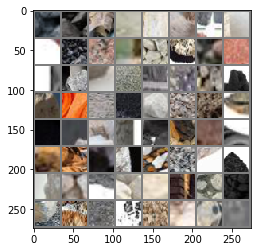

88
tensor([2, 5, 4, 6, 4, 0, 2, 3, 6, 0, 3, 0, 0, 6, 0, 2, 3, 2, 0, 5, 3, 0, 6, 0,
        5, 6, 0, 0, 5, 1, 0, 2, 4, 0, 0, 4, 0, 2, 0, 3, 6, 4, 5, 6, 0, 4, 0, 6,
        4, 6, 3, 0, 5, 2, 0, 5, 5, 0, 4, 0, 5, 4, 2, 5])
(64, 3, 32, 32)
('2_175.jpg', '5_486.jpg', '4_695.jpg', '6_545.jpg', '4_1868.jpg', '0_3250.jpg', '2_161.jpg', '3_1399.jpg', '6_2315.jpg', '0_1447.jpg', '3_819.png', '0_1321.jpg', '0_85.jpg', '6_2473.jpg', '0_4259.jpg', '2_607.jpg', '3_414.jpg', '2_2684.jpg', '0_3536.jpg', '5_2527.webp', '3_1587.JPEG', '0_2628.jpg', '6_223.jpg', '0_1309.jpg', '5_1854.jpg', '6_1152.jpg', '0_4271.jpg', '0_2600.jpg', '5_2385.jpg', '1_934.jpg', '0_3500.jpeg', '2_2874.jpg', '4_1698.jpg', '0_2166.jpg', '0_3278.jpg', '4_1840.jpg', '0_299.jpg', '2_149.jpg', '0_4517.jpg', '3_1138.JPEG', '6_3023.jpg', '4_2391.jpg', '5_3623.webp', '6_579.jpg', '0_2172.jpg', '4_1854.jpg', '0_4503.jpg', '6_1620.jpg', '4_871.jpg', '6_1146.jpg', '3_428.jpg', '0_2614.jpg', '5_2391.jpg', '2_2860.jpg', '0_3907.png', '5_16

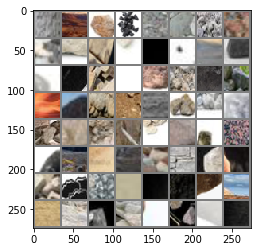

89
tensor([4, 3, 0, 2, 5, 1, 2, 0, 5, 4, 6, 4, 0, 6, 0, 5, 4, 3, 0, 5, 4, 2, 2, 0,
        5, 4, 4, 6, 5, 6, 4, 5, 4, 0, 0, 5, 2, 1, 0, 5, 5, 4, 2, 3, 6, 5, 2, 6,
        5, 4, 5, 4, 3, 2, 4, 3, 2, 3, 5, 4, 3, 3, 5, 5])
(64, 3, 32, 32)
('4_1101.jpg', '3_536.JPEG', '0_2827.jpg', '2_2653.jpg', '5_3064.jpg', '1_713.jpg', '2_2135.jpg', '0_3287.jpg', '5_451.jpg', '4_1667.jpg', '6_1813.jpg', '4_642.jpg', '0_2199.jpg', '6_592.jpg', '0_1490.jpg', '5_1115.jpg', '4_3070.jpg', '3_1641.JPEG', '0_1484.jpg', '5_1101.jpg', '4_3064.jpg', '2_1428.jpg', '2_2121.jpg', '0_3293.jpg', '5_445.jpg', '4_1673.jpg', '4_656.jpg', '6_1807.jpg', '5_2408.jpg', '6_586.jpg', '4_130.jpg', '5_323.jpg', '4_1115.jpg', '0_2833.jpg', '0_514.jpg', '5_3070.jpg', '2_2647.jpg', '1_707.jpg', '0_46.jpg', '5_1667.jpg', '5_2346.jpg', '4_118.jpg', '2_834.jpg', '3_1414.jpg', '6_1191.jpg', '5_3058.jpg', '2_1366.jpg', '6_2498.jpg', '5_1897.jpg', '4_2434.jpg', '5_1129.jpg', '4_2352.jpg', '3_920.JPEG', '2_1400.jpg', '4_1883.jpg', '3_399.

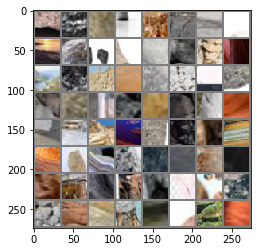

90
tensor([4, 4, 0, 2, 2, 5, 4, 5, 6, 4, 3, 0, 5, 2, 0, 5, 3, 6, 0, 4, 5, 1, 2, 0,
        6, 0, 6, 4, 0, 6, 0, 0, 3, 2, 2, 0, 2, 3, 2, 6, 6, 3, 4, 0, 2, 0, 6, 2,
        5, 0, 3, 6, 4, 5, 1, 4, 2, 5, 5, 1, 0, 5, 0, 0])
(64, 3, 32, 32)
('4_2346.jpg', '4_3058.jpg', '0_4103.jpeg', '2_1414.jpg', '2_1372.jpg', '5_1883.jpg', '4_2420.jpg', '5_2352.jpg', '6_2977.jpeg', '4_1129.jpg', '3_1400.jpg', '0_528.jpg', '5_2805.jpg', '2_377.jpg', '0_3046.jpg', '5_848.jpg', '3_164.jpg', '6_753.jpg', '0_2358.jpg', '4_483.jpg', '5_690.jpg', '1_1123.jpg', '2_1825.jpg', '0_1651.jpg', '6_2103.jpg', '0_1889.jpg', '6_2665.jpg', '4_2811.jpg', '0_1137.jpg', '6_810.jpeg', '0_919.jpg', '0_3720.jpg', '3_602.jpg', '2_2492.jpg', '2_411.jpg', '0_3734.jpg', '2_2486.jpg', '3_616.jpg', '2_405.jpg', '6_1378.jpg', '6_2671.jpg', '3_1428.png', '4_2805.jpg', '0_1123.jpg', '2_1831.jpg', '0_1645.jpg', '6_2117.jpg', '2_363.jpg', '5_2811.jpg', '0_3052.jpg', '3_170.jpg', '6_747.jpg', '4_497.jpg', '5_684.jpg', '1_1137.jpg', '4_2193.

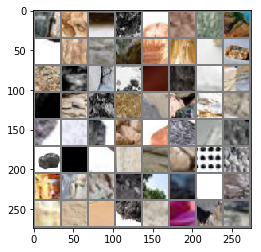

91
tensor([5, 0, 6, 6, 6, 3, 4, 6, 5, 0, 0, 0, 6, 2, 0, 5, 0, 4, 6, 3, 5, 0, 4, 2,
        4, 5, 6, 0, 1, 2, 5, 1, 4, 5, 0, 4, 5, 4, 5, 5, 2, 5, 3, 4, 1, 2, 5, 0,
        4, 5, 4, 6, 4, 4, 5, 3, 3, 1, 0, 5, 2, 4, 5, 0])
(64, 3, 32, 32)
('5_3299.jpg', '0_4073.jpg', '6_1350.jpg', '6_2659.jpg', '6_2881.jpg', '3_648.JPEG', '4_2839.jpg', '6_2895.jpg', '5_2193.jpg', '0_2416.jpg', '0_931.jpg', '0_3708.jpg', '6_1344.jpg', '2_439.jpg', '0_4067.jpg', '5_860.jpg', '0_2370.jpg', '4_2187.jpg', '6_1463.jpeg', '3_372.png', '5_1317.jpg', '0_1692.jpg', '4_440.jpg', '2_3029.jpg', '4_1465.jpg', '5_653.jpg', '6_948.jpg', '0_3085.jpg', '1_277.jpg', '2_2337.jpg', '5_3500.jpg', '1_511.jpg', '4_36.jpg', '5_3266.jpg', '0_702.jpg', '4_1303.jpg', '5_135.jpg', '4_326.jpg', '5_2178.jpg', '5_1471.jpg', '2_1158.jpg', '5_1465.jpg', '3_131.JPEG', '4_22.jpg', '1_505.jpg', '2_2445.jpg', '5_3272.jpg', '0_4098.jpg', '4_1317.jpg', '5_121.jpg', '4_332.jpg', '6_784.jpg', '4_454.jpg', '4_1471.jpg', '5_647.jpg', '3_1158.jpg', 

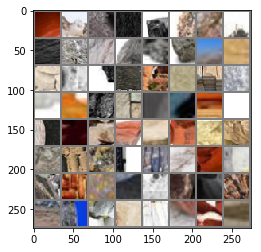

92
tensor([2, 5, 4, 2, 6, 3, 6, 2, 0, 4, 6, 1, 4, 2, 6, 3, 5, 3, 5, 3, 2, 1, 6, 3,
        3, 0, 5, 6, 5, 4, 2, 2, 0, 4, 5, 2, 4, 6, 3, 5, 1, 6, 0, 2, 2, 5, 6, 2,
        0, 2, 0, 4, 6, 2, 6, 0, 3, 6, 4, 2, 0, 3, 0, 6])
(64, 3, 32, 32)
('2_3015.jpg', '5_2622.jpg', '4_1459.jpg', '2_388.jpg', '6_2329.png', '3_1170.jpg', '6_974.jpg', '2_1602.jpg', '0_1876.jpg', '4_2150.jpg', '6_2842.jpg', '1_920.png', '4_2636.jpg', '2_1164.jpg', '6_1393.jpg', '3_1616.jpg', '5_109.jpg', '3_825.jpg', '5_2144.jpg', '3_1303.JPEG', '2_2479.jpg', '1_539.jpg', '6_1387.jpg', '3_1602.jpg', '3_831.jpg', '0_3913.jpg', '5_2150.jpg', '6_2856.jpg', '5_1459.jpg', '4_2622.jpg', '2_1170.jpg', '2_1616.jpg', '0_1862.jpg', '4_2144.jpg', '5_2636.jpg', '2_3001.jpg', '4_468.jpg', '6_960.jpg', '3_1164.jpg', '5_3528.jpg', '1_1057.jpg', '6_627.jpg', '0_3132.jpg', '2_2280.jpg', '2_203.jpg', '5_2971.jpg', '6_2077.jpg', '2_1789.jpg', '0_1725.jpg', '2_1951.jpg', '0_1043.jpg', '4_2965.jpg', '6_2711.jpg', '2_565.jpg', '6_1218.jpg', '0_3

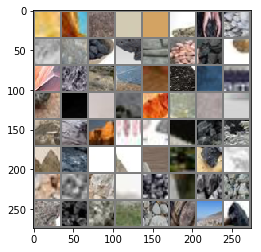

93
tensor([0, 4, 6, 6, 2, 1, 6, 0, 0, 5, 2, 5, 2, 0, 5, 0, 5, 3, 6, 6, 2, 0, 0, 3,
        0, 0, 0, 4, 4, 4, 4, 6, 6, 0, 0, 6, 3, 5, 0, 5, 5, 6, 3, 5, 2, 5, 6, 2,
        4, 3, 1, 2, 5, 0, 3, 3, 4, 5, 1, 4, 6, 0, 4, 4])
(64, 3, 32, 32)
('0_3898.jpg', '4_2971.jpg', '6_2705.jpg', '6_2063.jpg', '2_1945.jpg', '1_1043.jpg', '6_633.jpg', '0_2238.jpg', '0_3126.jpg', '5_928.jpg', '2_2294.jpg', '5_2965.jpg', '2_217.jpg', '0_1719.jpg', '5_2795.jpg', '0_2210.jpg', '5_900.jpg', '3_1529.JPEG', '6_1542.jpg', '6_1224.jpg', '2_559.jpg', '0_4107.jpg', '0_689.jpg', '3_1483.JPEG', '0_3668.jpg', '0_2576.jpg', '0_851.jpg', '4_1288.jpg', '4_2781.jpg', '4_2959.jpg', '4_2795.jpg', '6_2739.jpg', '6_1230.jpg', '0_845.jpg', '0_2562.jpg', '6_169.jpg', '3_986.jpg', '5_2781.jpg', '0_2204.jpg', '5_914.jpg', '5_2959.jpg', '6_1556.jpg', '3_1206.png', '5_1288.jpg', '2_1979.jpg', '5_1263.jpg', '6_33.jpg', '2_1992.jpg', '4_2018.jpg', '3_1250.JPEG', '1_303.jpg', '2_2243.jpg', '5_3474.jpg', '0_110.jpg', '3_1038.jpg', '3_57

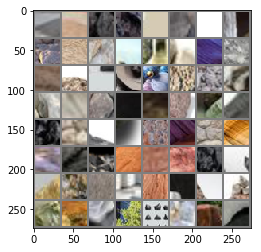

94
tensor([0, 0, 1, 5, 2, 3, 5, 0, 2, 5, 0, 6, 6, 4, 5, 4, 3, 0, 1, 0, 2, 5, 1, 5,
        2, 0, 6, 4, 5, 1, 4, 5, 6, 2, 3, 5, 6, 6, 5, 4, 4, 6, 2, 2, 4, 6, 5, 5,
        0, 0, 2, 1, 5, 3, 0, 3, 0, 2, 4, 1, 6, 4, 3, 0])
(64, 3, 32, 32)
('0_676.jpg', '0_3697.jpg', '1_465.jpg', '5_3312.jpg', '2_2525.jpg', '3_127.JPEG', '5_1505.jpg', '0_1080.jpg', '2_1038.jpg', '5_1511.jpg', '0_1094.jpg', '6_343.png', '6_196.jpg', '4_246.jpg', '5_2018.jpg', '4_1263.jpg', '3_979.jpg', '0_662.jpg', '1_471.jpg', '0_3683.jpg', '2_2531.jpg', '5_3306.jpg', '1_317.jpg', '5_3460.jpg', '2_2257.jpg', '0_104.jpg', '6_828.jpg', '4_1505.jpg', '5_733.jpg', '1_1080.jpg', '4_520.jpg', '5_1277.jpg', '6_27.jpg', '2_1986.jpg', '3_212.png', '5_3448.jpg', '6_1581.jpg', '6_800.jpg', '5_2756.jpg', '4_508.jpg', '4_2024.jpg', '6_2088.jpg', '2_1776.jpg', '2_1010.jpg', '4_2742.jpg', '6_2936.jpg', '5_1539.jpg', '5_2030.jpg', '0_892.jpg', '0_3873.jpg', '2_2519.jpg', '1_459.jpg', '5_2024.jpg', '3_1315.JPEG', '0_886.jpg', '3_432.JPEG',

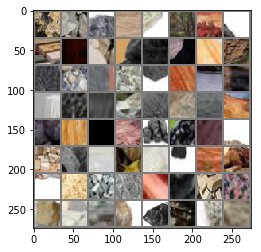

95
tensor([2, 6, 3, 0, 6, 4, 5, 6, 5, 0, 3, 0, 0, 2, 0, 6, 0, 0, 6, 2, 6, 2, 4, 0,
        6, 2, 4, 6, 2, 3, 0, 6, 2, 0, 6, 5, 6, 0, 0, 2, 5, 1, 5, 6, 3, 0, 2, 5,
        4, 1, 2, 0, 2, 1, 3, 0, 6, 0, 6, 4, 4, 6, 0, 5])
(64, 3, 32, 32)
('2_1762.jpg', '6_1595.jpg', '3_1010.jpg', '0_138.jpg', '6_814.jpg', '4_1539.jpg', '5_2742.jpg', '6_1619.jpeg', '5_280.jpg', '0_2748.jpg', '3_574.jpg', '0_3456.jpg', '0_4339.jpg', '2_767.jpg', '0_2990.jpg', '6_2513.jpg', '0_1241.jpg', '0_1527.jpg', '6_1567.jpeg', '2_163.webp', '6_2275.jpg', '2_2082.jpg', '4_1908.jpg', '0_3330.jpg', '6_425.jpg', '2_94.jpg', '4_939.jpg', '6_1768.jpg', '2_2096.jpg', '3_206.jpg', '0_3324.jpg', '6_431.jpg', '2_80.jpg', '0_1533.jpg', '6_2261.jpg', '5_1908.jpg', '6_2507.jpg', '0_1255.jpg', '0_1897.jpeg', '2_2928.jpg', '5_294.jpg', '1_868.jpg', '5_89.jpg', '6_357.jpg', '3_560.jpg', '0_3442.jpg', '2_773.jpg', '5_1920.jpg', '4_2583.jpg', '1_840.jpg', '2_2900.jpg', '0_2774.jpg', '2_983.jpg', '1_698.jpg', '3_548.jpg', '0_4305.jpg', 

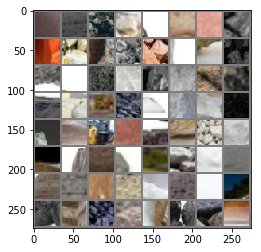

96
tensor([6, 6, 6, 4, 6, 0, 0, 4, 0, 5, 1, 2, 0, 2, 3, 6, 0, 5, 3, 3, 0, 4, 0, 5,
        3, 2, 5, 1, 0, 0, 0, 5, 6, 4, 6, 5, 5, 2, 4, 0, 2, 1, 2, 4, 5, 5, 4, 2,
        5, 4, 0, 0, 2, 1, 5, 2, 0, 1, 0, 0, 3, 5, 4, 2])
(64, 3, 32, 32)
('6_1998.jpg', '6_2249.jpg', '6_3143.jpg', '4_905.jpg', '6_1754.jpg', '0_4477.jpg', '0_3318.jpg', '4_1920.jpg', '0_2006.jpg', '5_2583.jpg', '1_854.jpg', '2_2914.jpg', '0_2760.jpg', '2_997.jpg', '3_259.JPEG', '6_1032.jpg', '0_4311.jpg', '5_1934.jpg', '3_1084.JPEG', '3_789.png', '0_1269.jpg', '4_2597.jpg', '0_1282.jpg', '5_1707.jpg', '3_873.JPEG', '2_2727.jpg', '5_3110.jpg', '1_667.jpg', '0_3495.jpg', '0_2953.jpg', '0_474.jpg', '5_243.jpg', '6_380.jpg', '4_736.jpg', '6_1967.jpg', '5_2568.jpg', '5_525.jpg', '2_57.jpg', '4_1713.jpg', '0_312.jpg', '2_2041.jpg', '1_101.jpg', '2_1548.jpg', '4_3104.jpg', '5_1061.jpg', '5_1075.jpg', '4_722.jpg', '2_43.jpg', '5_531.jpg', '4_1707.jpg', '0_4488.jpg', '0_306.jpg', '2_2055.jpg', '1_115.jpg', '5_3104.jpg', '2_2733.jpg'

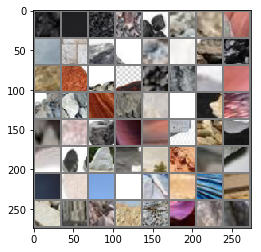

97
tensor([6, 5, 4, 0, 1, 4, 5, 2, 5, 4, 0, 2, 2, 4, 3, 5, 5, 6, 5, 0, 3, 6, 1, 2,
        2, 4, 5, 4, 2, 5, 1, 5, 5, 2, 6, 2, 5, 6, 4, 4, 6, 2, 2, 4, 5, 5, 5, 2,
        1, 3, 1, 2, 5, 2, 5, 1, 5, 3, 0, 2, 4, 4, 2, 3])
(64, 3, 32, 32)
('6_394.jpg', '5_1713.jpg', '4_2568.jpg', '0_448.jpg', '1_883.jpg', '4_1049.jpg', '5_62.jpg', '2_940.jpg', '5_2232.jpg', '4_2540.jpg', '0_4113.png', '2_1212.jpg', '2_1574.jpg', '4_2226.jpg', '3_1342.JPEG', '5_2554.jpg', '5_519.jpg', '6_1783.jpg', '5_2540.jpg', '0_2491.jpeg', '3_1212.jpg', '6_1797.jpg', '1_129.jpg', '2_2069.jpg', '2_1560.jpg', '4_2232.jpg', '5_1049.jpg', '4_2554.jpg', '2_1206.jpg', '5_3138.jpg', '1_897.jpg', '5_76.jpg', '5_2226.jpg', '2_954.jpg', '6_1781.jpg', '2_69.jpg', '5_2556.jpg', '6_1959.jpg', '4_708.jpg', '4_2224.jpg', '6_2288.jpg', '2_1576.jpg', '2_1210.jpg', '4_2542.jpg', '5_1739.jpg', '5_60.jpg', '5_2230.jpg', '2_942.jpg', '1_881.jpg', '3_1562.jpg', '1_659.jpg', '2_2719.jpg', '5_74.jpg', '2_956.jpg', '5_2224.jpg', '1_895.jpg', '

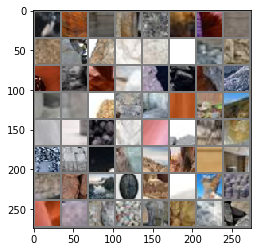

98
tensor([0, 6, 4, 5, 5, 4, 2, 1, 0, 3, 2, 5, 4, 6, 4, 6, 0, 5, 4, 0, 0, 6, 5, 2,
        1, 3, 0, 5, 2, 0, 6, 0, 5, 5, 5, 6, 5, 4, 0, 0, 2, 5, 1, 0, 2, 0, 5, 2,
        4, 4, 6, 5, 1, 0, 0, 5, 4, 4, 6, 0, 6, 0, 2, 6])
(64, 3, 32, 32)
('0_338.jpg', '6_1795.jpg', '4_1739.jpg', '5_2542.jpg', '5_1063.jpg', '4_2218.jpg', '2_2043.jpg', '1_103.jpg', '0_310.jpg', '3_1238.jpg', '2_55.jpg', '5_527.jpg', '4_1711.jpg', '6_1965.jpg', '4_734.jpg', '6_382.jpg', '0_2789.jpg', '5_241.jpg', '4_1077.jpg', '0_476.jpg', '0_2951.jpg', '6_2853.jpeg', '5_3112.jpg', '2_2725.jpg', '1_665.jpg', '3_1620.JPEG', '0_1280.jpg', '5_1705.jpg', '2_1238.jpg', '0_4139.png', '6_2500.jpeg', '0_1294.jpg', '5_1711.jpg', '5_2218.jpg', '5_48.jpg', '6_396.jpg', '5_255.jpg', '4_1063.jpg', '0_2945.jpg', '0_462.jpg', '2_2731.jpg', '5_3106.jpg', '1_671.jpg', '0_3483.jpg', '2_2057.jpg', '0_304.jpg', '5_533.jpg', '2_41.jpg', '4_1705.jpg', '4_720.jpg', '6_1971.jpg', '5_1077.jpg', '1_1055.png', '0_1519.jpg', '0_2010.jpg', '5_2595.jpg'

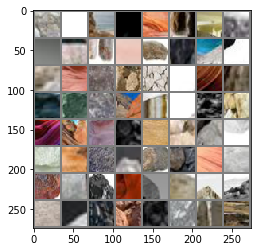

99
tensor([0, 0, 0, 2, 1, 4, 2, 4, 5, 4, 6, 5, 0, 6, 0, 2, 1, 2, 6, 5, 4, 3, 2, 0,
        6, 4, 5, 6, 2, 6, 2, 3, 0, 6, 2, 6, 6, 2, 0, 0, 5, 2, 0, 3, 3, 0, 6, 5,
        0, 6, 6, 0, 2, 6, 0, 3, 2, 0, 0, 2, 0, 4, 5, 0])
(64, 3, 32, 32)
('0_4307.jpg', '0_3468.jpg', '0_2776.jpg', '2_981.jpg', '1_842.jpg', '4_1088.jpg', '2_2902.jpg', '4_2581.jpg', '5_1922.jpg', '4_2595.jpg', '6_2539.jpg', '5_1936.jpg', '0_4313.jpg', '6_1030.jpg', '0_2762.jpg', '2_995.jpg', '1_856.jpg', '2_2916.jpg', '6_2629.jpeg', '5_2581.jpg', '4_1922.jpg', '3_238.jpg', '2_3079.webp', '0_4475.jpg', '6_1756.jpg', '4_907.jpg', '5_1088.jpg', '6_3141.jpg', '2_96.jpg', '6_427.jpg', '2_2080.jpg', '3_210.jpg', '0_3332.jpg', '6_2277.jpg', '2_1589.jpg', '6_2511.jpg', '6_1018.jpg', '2_765.jpg', '0_2992.jpg', '0_3454.jpg', '5_282.jpg', '2_771.jpg', '0_2986.jpg', '3_1589.jpg', '3_562.jpg', '0_3440.jpg', '6_355.jpg', '5_296.jpg', '0_1257.jpg', '6_2505.jpg', '6_2263.jpg', '0_1531.jpg', '2_82.jpg', '6_433.jpg', '0_2038.jpg', '3_204.jpg

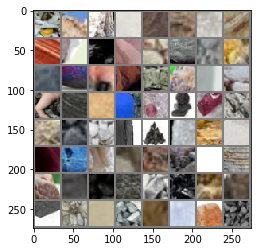

100
tensor([6, 4, 3, 4, 2, 2, 0, 4, 5, 5, 6, 3, 6, 5, 5, 6, 3, 2, 2, 0, 4, 5, 6, 4,
        1, 2, 5, 3, 0, 5, 0, 5, 6, 0, 1, 1, 0, 2, 5, 0, 6, 4, 4, 5, 4, 1, 1, 5,
        2, 2, 2, 5, 6, 0, 0, 2, 5, 6, 4, 4, 5, 1, 0, 1])
(64, 3, 32, 32)
('6_2934.jpg', '4_2740.jpg', '3_1732.jpeg', '4_2998.jpg', '2_1012.jpg', '2_1774.jpg', '0_1900.jpg', '4_2026.jpg', '5_2754.jpg', '5_719.jpg', '6_1583.jpg', '3_1006.jpg', '6_802.jpg', '5_2740.jpg', '5_2998.jpg', '6_1597.jpg', '3_1012.jpg', '2_2269.jpg', '2_1760.jpg', '0_1914.jpg', '4_2032.jpg', '5_1249.jpg', '6_2920.jpg', '4_2754.jpg', '1_10.jpg', '2_1006.jpg', '5_3338.jpg', '3_947.jpg', '0_3865.jpg', '5_2026.jpg', '0_884.jpg', '5_1507.jpg', '6_2908.jpg', '0_1082.jpg', '1_38.jpg', '1_467.jpg', '0_3695.jpg', '2_2527.jpg', '5_3310.jpg', '0_674.jpg', '6_180.jpg', '4_250.jpg', '4_536.jpg', '5_2768.jpg', '4_1513.jpg', '1_1096.jpg', '1_301.jpg', '5_3476.jpg', '2_2241.jpg', '2_1748.jpg', '2_1990.jpg', '5_1261.jpg', '6_31.jpg', '0_1928.jpg', '0_1622.jpeg', '2_198

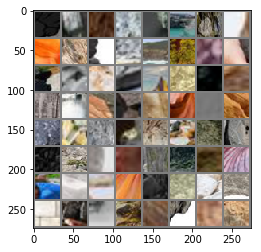

101
tensor([2, 5, 0, 5, 2, 0, 3, 4, 0, 6, 4, 5, 0, 4, 4, 3, 0, 3, 1, 0, 6, 6, 5, 5,
        5, 0, 1, 6, 3, 6, 2, 5, 0, 5, 3, 0, 6, 0, 3, 0, 4, 0, 6, 4, 0, 3, 2, 6,
        4, 0, 2, 0, 6, 5, 0, 2, 6, 2, 5, 0, 2, 6, 6, 1])
(64, 3, 32, 32)
('2_2255.jpg', '5_3462.jpg', '0_3681.jpg', '5_3304.jpg', '2_2533.jpg', '0_660.jpg', '3_1748.jpg', '4_1261.jpg', '0_3859.jpg', '6_194.jpg', '4_244.jpg', '5_1513.jpg', '0_1096.jpg', '4_2768.jpg', '4_2783.jpg', '3_990.jpg', '0_2574.jpg', '3_748.jpg', '1_498.jpg', '0_4105.jpg', '6_1226.jpg', '6_1540.jpg', '5_902.jpg', '5_3489.jpg', '5_2797.jpg', '0_2212.jpg', '1_1069.jpg', '6_2049.jpg', '3_1204.png', '6_1554.jpg', '2_229.jpg', '5_916.jpg', '0_3118.jpg', '5_2783.jpg', '3_984.jpg', '0_2560.jpg', '6_1232.jpg', '0_4111.jpg', '3_783.JPEG', '0_1069.jpg', '4_2797.jpg', '0_2548.jpg', '6_143.jpg', '4_293.jpg', '0_3656.jpg', '3_774.jpg', '2_567.jpg', '6_2713.jpg', '4_2967.jpg', '0_1041.jpg', '2_1953.jpg', '0_1727.jpg', '6_2075.jpg', '5_2973.jpg', '0_3130.jpg', '2_228

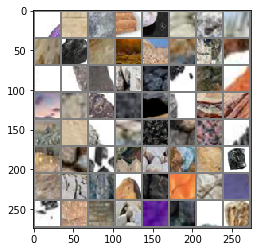

102
tensor([2, 6, 0, 4, 0, 6, 4, 0, 3, 2, 5, 4, 3, 0, 6, 3, 5, 2, 0, 6, 1, 4, 6, 5,
        4, 3, 0, 2, 3, 2, 1, 6, 3, 5, 2, 3, 3, 6, 5, 2, 5, 4, 0, 0, 2, 2, 4, 6,
        6, 5, 4, 6, 3, 0, 4, 5, 4, 0, 5, 0, 1, 2, 5, 1])
(64, 3, 32, 32)
('2_1947.jpg', '6_2707.jpg', '0_3497.png', '4_2973.jpg', '0_1055.jpg', '6_157.jpg', '4_287.jpg', '0_3642.jpg', '3_760.jpg', '2_573.jpg', '5_2146.jpg', '4_318.jpg', '3_827.jpg', '0_3905.jpg', '6_1391.jpg', '3_1614.jpg', '5_3258.jpg', '2_1166.jpg', '0_3499.webp', '6_2698.jpg', '1_922.png', '4_2634.jpg', '6_2840.jpg', '5_1329.jpg', '4_2152.jpg', '3_900.jpeg', '0_1874.jpg', '2_1600.jpg', '3_199.jpg', '2_2309.jpg', '1_249.jpg', '6_976.jpg', '3_1172.jpg', '5_2620.jpg', '2_3017.jpg', '3_15.jpg', '3_1166.jpg', '6_962.jpg', '5_679.jpg', '2_3003.jpg', '5_2634.jpg', '4_2146.jpg', '0_1860.jpg', '0_4123.jpeg', '2_1614.jpg', '2_1172.jpg', '4_2620.jpg', '6_1382.jpeg', '6_2854.jpg', '5_2152.jpg', '4_1329.jpg', '6_1385.jpg', '3_1600.jpg', '0_728.jpg', '4_2608.jpg', '5_1

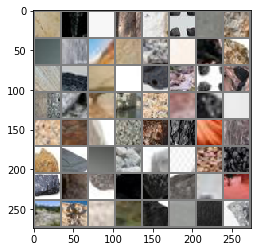

103
tensor([0, 5, 5, 2, 4, 5, 0, 6, 4, 5, 0, 0, 5, 0, 2, 0, 1, 2, 5, 4, 5, 6, 4, 5,
        4, 4, 5, 0, 1, 4, 5, 2, 3, 5, 6, 0, 6, 3, 6, 0, 1, 0, 0, 4, 0, 5, 0, 6,
        2, 6, 4, 6, 6, 4, 1, 0, 5, 6, 0, 6, 3, 5, 6, 0])
(64, 3, 32, 32)
('0_3087.jpg', '5_889.jpg', '5_3502.jpg', '2_2335.jpg', '4_1467.jpg', '5_651.jpg', '0_2399.jpg', '6_792.jpg', '4_442.jpg', '5_1315.jpg', '0_1690.jpg', '0_1848.jpg', '5_1301.jpg', '0_1684.jpg', '2_1628.jpg', '0_3093.jpg', '1_261.jpg', '2_2321.jpg', '5_3516.jpg', '4_1473.jpg', '5_645.jpg', '6_786.jpg', '4_456.jpg', '5_2608.jpg', '4_330.jpg', '4_1315.jpg', '5_123.jpg', '0_714.jpg', '1_507.jpg', '4_20.jpg', '5_3270.jpg', '2_2447.jpg', '3_845.JPEG', '5_1467.jpg', '6_2868.jpg', '0_1109.jpg', '6_2883.jpg', '3_795.jpeg', '6_1352.jpg', '0_4071.jpg', '1_9.jpg', '0_2400.jpg', '0_927.jpg', '4_1498.jpg', '0_2366.jpg', '5_876.jpg', '0_3078.jpg', '6_1434.jpg', '2_349.jpg', '6_1044.jpeg', '4_2191.jpg', '6_2129.jpg', '6_2238.jpeg', '4_2185.jpg', '1_1109.jpg', '0_2372.jp

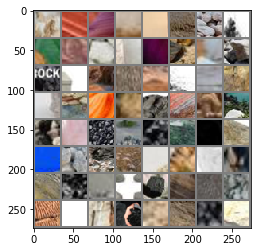

104
tensor([0, 6, 5, 2, 0, 2, 0, 2, 4, 6, 6, 2, 5, 1, 6, 4, 3, 6, 2, 6, 5, 5, 1, 6,
        6, 4, 0, 3, 5, 6, 0, 2, 0, 4, 6, 0, 2, 0, 2, 5, 3, 4, 3, 0, 2, 4, 2, 4,
        4, 5, 2, 3, 0, 6, 5, 2, 5, 1, 2, 3, 6, 5, 2, 5])
(64, 3, 32, 32)
('0_2414.jpg', '6_2897.jpg', '5_1498.jpg', '2_413.jpg', '0_3722.jpg', '2_2490.jpg', '0_1135.jpg', '2_1199.jpg', '4_2813.jpg', '6_2667.jpg', '6_2101.jpg', '2_1827.jpg', '5_692.jpg', '1_1121.jpg', '6_751.jpg', '4_481.jpg', '3_166.jpg', '6_989.jpg', '2_375.jpg', '6_1408.jpg', '5_2807.jpg', '5_686.jpg', '1_1135.jpg', '6_745.jpg', '6_3096.jpeg', '4_495.jpg', '0_3050.jpg', '3_1199.jpg', '5_2813.jpg', '6_2115.jpg', '0_1647.jpg', '2_1833.jpg', '0_1121.jpg', '4_2807.jpg', '6_2673.jpg', '0_4059.jpg', '2_407.jpg', '0_3736.jpg', '2_2484.jpg', '5_2422.jpg', '3_1289.JPEG', '4_1659.jpg', '3_1370.jpg', '0_258.jpg', '2_188.jpg', '4_1881.jpg', '2_1402.jpg', '4_2350.jpg', '4_2436.jpg', '5_1895.jpg', '2_1364.jpg', '3_1416.jpg', '0_2819.jpg', '6_1193.jpg', '5_309.jpg', '2_8

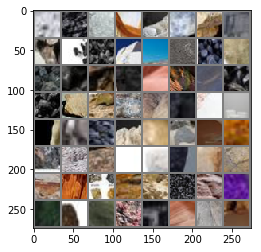

105
tensor([4, 0, 5, 3, 2, 2, 4, 5, 6, 4, 3, 4, 4, 0, 5, 4, 6, 5, 4, 0, 2, 0, 5, 2,
        1, 0, 0, 2, 5, 4, 4, 5, 5, 2, 5, 0, 5, 1, 0, 0, 5, 4, 4, 6, 4, 6, 0, 5,
        4, 0, 3, 2, 0, 4, 4, 5, 4, 0, 6, 4, 4, 3, 0, 1])
(64, 3, 32, 32)
('4_2422.jpg', '0_78.jpg', '5_1881.jpg', '3_957.jpeg', '2_1370.jpg', '2_1416.jpg', '4_2344.jpg', '5_2436.jpg', '6_1839.jpg', '4_668.jpg', '3_1364.jpg', '4_1895.jpg', '4_3072.jpg', '0_1492.jpg', '5_1117.jpg', '4_640.jpg', '6_1811.jpg', '5_453.jpg', '4_1665.jpg', '0_264.jpg', '2_2137.jpg', '0_3285.jpg', '5_3066.jpg', '2_2651.jpg', '1_711.jpg', '0_2825.jpg', '0_502.jpg', '2_2889.jpg', '5_335.jpg', '4_1103.jpg', '4_126.jpg', '5_2378.jpg', '5_1671.jpg', '2_1358.jpg', '5_1665.jpg', '0_44.jpg', '5_3072.jpg', '1_705.jpg', '0_4298.jpg', '0_516.jpg', '5_321.jpg', '4_1117.jpg', '4_132.jpg', '6_1805.jpg', '4_654.jpg', '6_584.jpg', '0_1233.jpeg', '5_447.jpg', '4_1671.jpg', '0_270.jpg', '3_1358.jpg', '2_2123.jpg', '0_3291.jpg', '4_3066.jpg', '4_2378.jpg', '5_1103.jpg

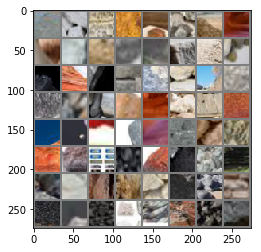

106
tensor([2, 0, 6, 5, 5, 0, 6, 5, 0, 5, 2, 0, 5, 0, 3, 2, 6, 0, 4, 6, 0, 4, 0, 4,
        4, 0, 2, 0, 4, 6, 0, 5, 0, 0, 6, 6, 3, 2, 0, 2, 6, 2, 0, 6, 2, 6, 6, 0,
        6, 6, 3, 0, 4, 5, 0, 0, 6, 2, 6, 0, 2, 3, 6, 5])
(64, 3, 32, 32)
('2_2876.jpg', '0_2602.jpg', '6_209.jpg', '5_2387.jpg', '5_3099.jpg', '0_4273.jpg', '6_2459.jpg', '5_1856.jpg', '0_3911.png', '5_1842.jpg', '2_2862.jpg', '0_2616.jpg', '5_2393.jpg', '0_3508.jpg', '3_392.JPEG', '2_639.jpg', '6_1144.jpg', '0_4267.jpg', '4_873.jpg', '6_1622.jpg', '0_4501.jpg', '4_1856.jpg', '0_2170.jpg', '4_2387.jpg', '4_3099.jpg', '0_4529.jpg', '2_177.jpg', '0_3246.jpg', '4_683.jpg', '6_553.jpg', '0_2158.jpg', '5_490.jpg', '0_1451.jpg', '0_93.jpg', '6_2465.jpg', '6_235.jpg', '3_402.jpg', '2_2692.jpg', '0_3520.jpg', '2_611.jpg', '6_221.jpg', '2_2686.jpg', '0_3534.jpg', '6_1178.jpg', '2_605.jpg', '6_2280.jpeg', '6_2471.jpg', '0_87.jpg', '6_3009.jpg', '6_2317.jpg', '3_370.jpg', '0_3252.jpg', '4_697.jpg', '5_484.jpg', '0_1322.jpg', '0_86.jpg'

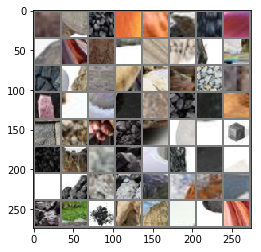

107
tensor([6, 0, 3, 2, 6, 0, 6, 0, 5, 0, 6, 4, 0, 3, 0, 2, 2, 0, 2, 6, 0, 0, 0, 6,
        0, 5, 0, 2, 1, 5, 4, 0, 4, 6, 6, 0, 4, 6, 4, 0, 0, 4, 0, 4, 6, 3, 4, 6,
        5, 0, 6, 5, 5, 6, 0, 2, 1, 4, 5, 0, 0, 6, 1, 2])
(64, 3, 32, 32)
('6_546.jpg', '0_3253.jpg', '3_371.jpg', '2_162.jpg', '6_2316.jpg', '0_1444.jpg', '6_3008.jpg', '0_1450.jpg', '5_491.jpg', '0_2159.jpg', '6_552.jpg', '4_682.jpg', '0_3247.jpg', '3_365.jpg', '0_4528.jpg', '2_176.jpg', '2_610.jpg', '0_3521.jpg', '2_2693.jpg', '6_234.jpg', '0_3275.jpeg', '0_1336.jpg', '0_92.jpg', '6_1145.jpg', '0_3509.jpg', '5_2392.jpg', '0_2617.jpg', '2_2863.jpg', '1_923.jpg', '5_1843.jpg', '4_3098.jpg', '0_1478.jpg', '4_2386.jpg', '6_3034.jpg', '6_1204.jpeg', '0_2171.jpg', '4_1857.jpg', '6_1623.jpg', '4_872.jpg', '0_4500.jpg', '0_2165.jpg', '4_1843.jpg', '0_4514.jpg', '4_866.jpg', '6_1637.jpg', '3_1167.png', '4_2392.jpg', '6_2458.jpg', '5_1857.jpg', '0_4272.jpg', '6_1151.jpg', '5_3098.jpg', '5_2386.jpg', '6_208.jpg', '0_2603.jpg', '2_287

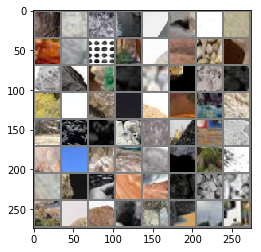

108
tensor([5, 0, 5, 5, 0, 4, 4, 0, 2, 0, 4, 3, 5, 6, 6, 0, 2, 0, 6, 4, 4, 5, 6, 6,
        4, 5, 3, 0, 1, 4, 6, 2, 0, 5, 4, 4, 2, 5, 0, 0, 1, 5, 2, 2, 5, 4, 5, 5,
        6, 2, 1, 4, 5, 4, 6, 4, 2, 4, 3, 2, 4, 2, 3, 6])
(64, 3, 32, 32)
('5_3073.jpg', '0_45.jpg', '5_1664.jpg', '5_1102.jpg', '0_1487.jpg', '4_2379.jpg', '4_3067.jpg', '0_3290.jpg', '2_2122.jpg', '0_271.jpg', '4_1670.jpg', '3_1421.JPEG', '5_446.jpg', '6_585.jpg', '6_1804.jpg', '0_3284.jpg', '2_2136.jpg', '0_265.jpg', '6_518.jpeg', '4_899.jpg', '4_1664.jpg', '5_452.jpg', '6_591.jpg', '6_1810.jpg', '4_641.jpg', '5_1116.jpg', '3_85.JPEG', '0_1493.jpg', '1_1134.png', '4_3073.jpg', '6_148.jpeg', '2_1359.jpg', '0_51.jpg', '5_1670.jpg', '4_127.jpg', '4_1102.jpg', '2_2888.jpg', '5_334.jpg', '0_503.jpg', '0_2824.jpg', '1_710.jpg', '5_3067.jpg', '2_2650.jpg', '2_1371.jpg', '5_1880.jpg', '4_2423.jpg', '5_1658.jpg', '5_2351.jpg', '6_2644.jpeg', '2_2678.jpg', '1_738.jpg', '4_1894.jpg', '5_2437.jpg', '4_669.jpg', '6_1838.jpg', '4_2345.j

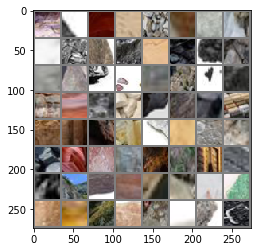

109
tensor([0, 5, 2, 5, 5, 6, 3, 0, 2, 5, 4, 2, 0, 6, 5, 2, 3, 0, 4, 6, 5, 0, 3, 2,
        0, 0, 6, 4, 0, 0, 4, 0, 2, 3, 0, 2, 5, 6, 3, 0, 4, 6, 1, 5, 2, 0, 3, 6,
        6, 5, 0, 6, 1, 4, 6, 6, 5, 0, 0, 5, 0, 6, 0, 0])
(64, 3, 32, 32)
('0_259.jpg', '5_2423.jpg', '2_837.jpg', '5_2345.jpg', '5_308.jpg', '6_1192.jpg', '3_1417.jpg', '0_2818.jpg', '2_1365.jpg', '5_1894.jpg', '4_2437.jpg', '2_1832.jpg', '0_1646.jpg', '6_2114.jpg', '5_2812.jpg', '2_360.jpg', '3_1198.jpg', '0_3051.jpg', '4_494.jpg', '6_744.jpg', '5_687.jpg', '0_2429.jpg', '3_615.jpg', '2_2485.jpg', '0_3737.jpg', '0_4058.jpg', '6_2672.jpg', '4_2806.jpg', '0_1120.jpg', '0_3672.jpeg', '4_2812.jpg', '0_1134.jpg', '2_2491.jpg', '3_601.jpg', '0_3723.jpg', '2_374.jpg', '5_2806.jpg', '6_988.jpg', '3_167.jpg', '0_3045.jpg', '4_480.jpg', '6_750.jpg', '1_1120.jpg', '5_693.jpg', '2_1826.jpg', '0_1652.jpg', '3_1359.png', '6_2100.jpg', '6_1421.jpg', '5_863.jpg', '0_2373.jpg', '6_778.jpg', '1_1108.jpg', '4_2184.jpg', '6_2128.jpg', '6_2896.

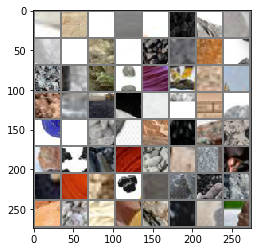

110
tensor([1, 5, 0, 6, 0, 6, 4, 2, 6, 0, 5, 0, 3, 4, 4, 5, 6, 5, 4, 2, 5, 0, 2, 0,
        5, 5, 6, 5, 2, 1, 4, 0, 5, 4, 4, 2, 5, 4, 1, 0, 3, 5, 4, 0, 4, 5, 4, 3,
        0, 5, 4, 6, 0, 5, 4, 5, 5, 2, 0, 1, 2, 0, 4, 2])
(64, 3, 32, 32)
('1_8.jpg', '5_2184.jpg', '0_4070.jpg', '6_2882.jpg', '0_1108.jpg', '6_1253.jpeg', '4_2190.jpg', '2_348.jpg', '6_1435.jpg', '0_3079.jpg', '5_877.jpg', '0_2367.jpg', '3_582.JPEG', '4_1499.jpg', '4_457.jpg', '5_2609.jpg', '6_787.jpg', '5_644.jpg', '4_1472.jpg', '2_2320.jpg', '5_3517.jpg', '0_3092.jpg', '2_1629.jpg', '0_1685.jpg', '5_1300.jpg', '5_1466.jpg', '6_2869.jpg', '5_3271.jpg', '2_2446.jpg', '1_506.jpg', '4_21.jpg', '0_715.jpg', '5_122.jpg', '4_1314.jpg', '4_331.jpg', '2_2452.jpg', '5_3265.jpg', '4_35.jpg', '1_512.jpg', '0_701.jpg', '3_1629.jpg', '5_136.jpg', '4_1300.jpg', '0_3938.jpg', '4_325.jpg', '5_1472.jpg', '4_2609.jpg', '3_701.JPEG', '0_1691.jpg', '5_1314.jpg', '4_443.jpg', '6_793.jpg', '0_2398.jpg', '5_650.jpg', '4_1466.jpg', '5_888.jpg', '

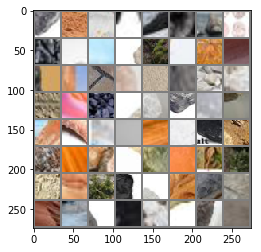

111
tensor([5, 5, 6, 3, 3, 0, 6, 0, 4, 3, 0, 5, 6, 4, 4, 2, 6, 4, 6, 2, 5, 6, 0, 5,
        4, 5, 2, 6, 1, 2, 2, 0, 4, 5, 6, 0, 2, 1, 6, 2, 0, 6, 2, 5, 2, 0, 4, 6,
        0, 4, 6, 6, 0, 4, 6, 0, 0, 4, 6, 0, 1, 6, 2, 0])
(64, 3, 32, 32)
('5_2635.jpg', '5_678.jpg', '6_963.jpg', '3_14.jpg', '3_214.JPEG', '0_729.jpg', '6_1384.jpg', '0_3910.jpg', '4_1328.jpg', '3_832.jpg', '0_4334.jpeg', '5_2153.jpg', '6_2855.jpg', '4_2621.jpg', '4_1874.webp', '2_1173.jpg', '6_2841.jpg', '4_2635.jpg', '6_2699.jpg', '2_1167.jpg', '5_3259.jpg', '6_1390.jpg', '0_3904.jpg', '5_2147.jpg', '4_319.jpg', '5_2621.jpg', '2_3016.jpg', '6_977.jpg', '1_248.jpg', '2_2308.jpg', '2_1601.jpg', '0_1875.jpg', '4_2153.jpg', '5_1328.jpg', '6_2060.jpg', '0_1732.jpg', '2_1946.jpg', '1_1040.jpg', '6_630.jpg', '2_2297.jpg', '0_3125.jpg', '6_1569.jpg', '2_214.jpg', '5_2966.jpg', '2_572.jpg', '0_3643.jpg', '4_286.jpg', '6_156.jpg', '0_1054.jpg', '4_2972.jpg', '6_2706.jpg', '6_397.png', '0_1040.jpg', '4_2966.jpg', '6_2712.jpg', '0_41

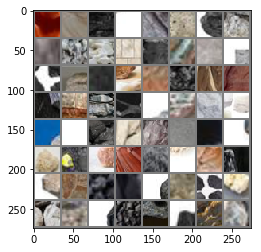

112
tensor([5, 2, 6, 0, 2, 0, 5, 3, 0, 5, 2, 3, 4, 6, 0, 0, 0, 3, 0, 6, 1, 0, 0, 4,
        6, 1, 0, 6, 5, 5, 5, 6, 2, 5, 1, 0, 1, 5, 4, 4, 6, 5, 2, 0, 3, 4, 0, 5,
        4, 6, 4, 0, 5, 2, 1, 0, 4, 6, 4, 0, 2, 5, 0, 1])
(64, 3, 32, 32)
('5_2972.jpg', '2_200.jpg', '6_2074.jpg', '0_1726.jpg', '2_1952.jpg', '0_2207.jpg', '5_2782.jpg', '3_594.JPEG', '0_3119.jpg', '5_917.jpg', '2_228.jpg', '3_1749.JPEG', '4_2796.jpg', '6_1233.jpg', '0_4110.jpg', '0_846.jpg', '0_2561.jpg', '3_985.jpg', '0_4104.jpg', '6_1227.jpg', '1_499.jpg', '0_2575.jpg', '0_852.jpg', '4_2782.jpg', '6_2048.jpg', '1_1068.jpg', '0_2213.jpg', '6_618.jpg', '5_2796.jpg', '5_903.jpg', '5_3488.jpg', '6_1541.jpg', '2_2254.jpg', '5_3463.jpg', '1_314.jpg', '0_107.jpg', '1_1083.jpg', '5_730.jpg', '4_1506.jpg', '4_523.jpg', '6_24.jpg', '5_1274.jpg', '2_1985.jpg', '0_1929.jpg', '3_211.png', '4_2769.jpg', '0_1097.jpg', '5_1512.jpg', '4_245.jpg', '6_195.jpg', '4_1260.jpg', '0_3858.jpg', '5_3305.jpg', '2_2532.jpg', '1_472.jpg', '0_3680.jp

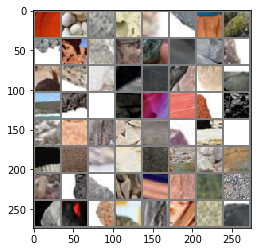

113
tensor([3, 1, 0, 5, 6, 6, 5, 2, 6, 2, 5, 2, 1, 0, 1, 5, 4, 4, 5, 5, 4, 2, 2, 6,
        3, 5, 0, 5, 4, 0, 3, 5, 2, 1, 4, 6, 2, 4, 4, 0, 5, 0, 4, 3, 0, 6, 6, 5,
        5, 4, 0, 2, 6, 0, 5, 6, 0, 3, 0, 0, 0, 3, 2, 0])
(64, 3, 32, 32)
('3_1588.png', '1_39.jpg', '0_1083.jpg', '5_1506.jpg', '6_2909.jpg', '6_30.jpg', '5_1260.jpg', '2_1991.jpg', '6_2310.jpeg', '2_1749.jpg', '5_3477.jpg', '2_2240.jpg', '1_300.jpg', '0_113.jpg', '1_1097.jpg', '5_724.jpg', '4_1512.jpg', '4_537.jpg', '5_2769.jpg', '5_1248.jpg', '4_2033.jpg', '2_1761.jpg', '2_2268.jpg', '6_817.jpg', '3_1013.jpg', '5_2741.jpg', '0_885.jpg', '5_2027.jpg', '4_279.jpg', '0_3864.jpg', '3_946.jpg', '5_3339.jpg', '2_1007.jpg', '1_11.jpg', '4_2755.jpg', '6_2921.jpg', '2_1013.jpg', '4_2999.jpg', '4_2741.jpg', '0_891.jpg', '5_2033.jpg', '0_3870.jpg', '4_1248.jpg', '3_952.jpg', '0_649.jpg', '6_803.jpg', '6_1582.jpg', '5_718.jpg', '5_2755.jpg', '4_2027.jpg', '0_1901.jpg', '2_1775.jpg', '6_2504.jpg', '0_1256.jpg', '5_297.jpg', '6_354.jpg'

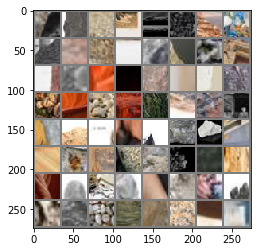

114
tensor([6, 2, 0, 6, 0, 2, 6, 2, 6, 2, 5, 6, 0, 0, 2, 6, 6, 0, 2, 1, 2, 0, 0, 6,
        6, 5, 4, 6, 5, 4, 6, 4, 5, 0, 6, 0, 4, 5, 6, 0, 3, 0, 5, 4, 2, 1, 4, 2,
        0, 0, 6, 2, 0, 0, 0, 1, 2, 5, 0, 0, 4, 5, 5, 5])
(64, 3, 32, 32)
('6_432.jpg', '2_83.jpg', '0_1530.jpg', '6_2262.jpg', '0_1524.jpg', '2_1588.jpg', '6_2276.jpg', '2_2081.jpg', '6_426.jpg', '2_97.jpg', '5_283.jpg', '6_340.jpg', '0_3455.jpg', '0_2993.jpg', '2_764.jpg', '6_1019.jpg', '6_2510.jpg', '0_1242.jpg', '2_2917.jpg', '1_857.jpg', '2_994.jpg', '0_2763.jpg', '0_4312.jpg', '6_1031.jpg', '6_2538.jpg', '5_1937.jpg', '4_2594.jpg', '6_3140.jpg', '5_1089.jpg', '4_906.jpg', '6_1757.jpg', '4_1923.jpg', '5_2580.jpg', '0_2005.jpg', '6_1743.jpg', '0_4460.jpg', '4_1937.jpg', '5_2594.jpg', '6_18.png', '0_2011.jpg', '3_193.JPEG', '0_1518.jpg', '5_1923.jpg', '4_2580.jpg', '2_2903.jpg', '1_843.jpg', '4_1089.jpg', '2_980.jpg', '0_2777.jpg', '0_3469.jpg', '6_1025.jpg', '2_758.jpg', '0_4306.jpg', '0_488.jpg', '0_3482.jpg', '1_670.jpg

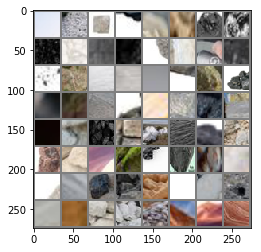

115
tensor([5, 2, 5, 6, 4, 4, 2, 5, 0, 1, 2, 4, 6, 4, 3, 5, 0, 1, 2, 4, 5, 5, 0, 3,
        1, 0, 5, 2, 0, 0, 4, 5, 0, 6, 4, 2, 3, 3, 0, 5, 1, 2, 5, 5, 0, 5, 6, 6,
        3, 2, 4, 2, 6, 4, 5, 4, 6, 2, 6, 3, 2, 1, 3, 1])
(64, 3, 32, 32)
('5_1710.jpg', '2_1239.jpg', '5_1076.jpg', '6_1970.jpg', '4_721.jpg', '4_1704.jpg', '2_40.jpg', '5_532.jpg', '0_305.jpg', '1_116.jpg', '2_2056.jpg', '4_735.jpg', '6_1964.jpg', '4_1710.jpg', '3_1437.JPEG', '5_526.jpg', '0_311.jpg', '1_102.jpg', '2_2042.jpg', '4_2219.jpg', '5_1062.jpg', '5_1704.jpg', '0_1281.jpg', '3_761.png', '1_664.jpg', '0_3496.jpg', '5_3113.jpg', '2_2724.jpg', '0_2950.jpg', '0_477.jpg', '4_1076.jpg', '5_240.jpg', '0_2788.jpg', '6_383.jpg', '4_2557.jpg', '2_1205.jpg', '3_749.png', '3_1577.jpg', '0_2978.jpg', '5_268.jpg', '1_894.jpg', '2_957.jpg', '5_2225.jpg', '5_75.jpg', '0_4375.jpeg', '5_2543.jpg', '6_1794.jpg', '6_3043.jpeg', '3_1211.jpg', '2_1563.jpg', '4_2231.jpg', '2_1577.jpg', '6_2289.jpg', '4_2225.jpg', '5_2557.jpg', '4_709.jpg

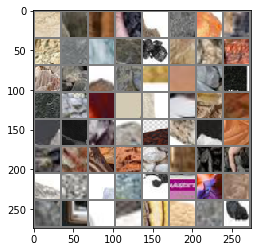

116
tensor([5, 2, 5, 5, 4, 5, 4, 5, 5, 6, 5, 2, 0, 1, 0, 0, 6, 2, 0, 5, 5, 0, 4, 6,
        0, 2, 1, 6, 4, 2, 4, 3, 2, 4, 6, 3, 5, 2, 4, 4, 6, 5, 0, 5, 5, 0, 2, 5,
        1, 0, 0, 0, 2, 3, 3, 4, 1, 5, 5, 2, 5, 3, 0, 3])
(64, 3, 32, 32)
('5_2231.jpg', '2_943.jpg', '5_61.jpg', '5_1738.jpg', '4_2543.jpg', '5_244.jpg', '4_1072.jpg', '5_2209.jpg', '5_59.jpg', '6_387.jpg', '5_3117.jpg', '2_2720.jpg', '0_3492.jpg', '1_660.jpg', '0_2954.jpg', '0_473.jpg', '6_2346.jpeg', '2_1229.jpg', '0_1285.jpg', '5_1700.jpg', '5_1066.jpg', '0_3121.png', '4_3103.jpg', '6_2716.jpeg', '0_315.jpg', '2_2046.jpg', '1_106.jpg', '6_1960.jpg', '4_731.jpg', '2_50.jpg', '4_1714.jpg', '3_1229.jpg', '2_2052.jpg', '4_725.jpg', '6_1974.jpg', '3_1436.jpeg', '5_536.jpg', '2_44.jpg', '4_1700.jpg', '4_2209.jpg', '6_620.png', '5_1072.jpg', '0_1291.jpg', '5_1714.jpg', '5_250.jpg', '0_2798.jpg', '2_2734.jpg', '5_3103.jpg', '1_674.jpg', '0_3486.jpg', '0_467.jpg', '0_2940.jpg', '2_1215.jpg', '3_759.png', '3_981.png', '4_2547.jpg',

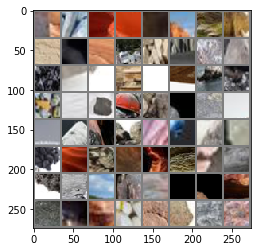

117
tensor([0, 6, 5, 4, 4, 4, 2, 6, 3, 6, 5, 4, 6, 2, 1, 5, 5, 2, 1, 3, 2, 0, 0, 2,
        5, 4, 6, 0, 2, 0, 5, 0, 6, 6, 2, 0, 2, 0, 6, 0, 2, 6, 0, 2, 2, 0, 3, 0,
        6, 0, 5, 6, 0, 0, 2, 6, 2, 4, 5, 5, 0, 5, 0, 4])
(64, 3, 32, 32)
('0_329.jpg', '6_1784.jpg', '5_2553.jpg', '4_1728.jpg', '4_2221.jpg', '4_2235.jpg', '2_1567.jpg', '6_2299.jpg', '3_1215.jpg', '6_1790.jpg', '5_2547.jpg', '4_719.jpg', '6_1948.jpg', '2_78.jpg', '1_890.jpg', '5_71.jpg', '5_2221.jpg', '2_953.jpg', '1_648.jpg', '3_598.jpg', '2_2708.jpg', '0_4100.png', '0_3848.jpeg', '2_1201.jpg', '5_1728.jpg', '4_2553.jpg', '6_2514.jpg', '0_3451.jpg', '2_760.jpg', '0_2997.jpg', '5_287.jpg', '0_3262.jpeg', '6_344.jpg', '6_422.jpg', '2_93.jpg', '0_4458.jpg', '2_2085.jpg', '0_3337.jpg', '6_2272.jpg', '0_1520.jpg', '2_1598.jpg', '6_2266.jpg', '0_1534.jpg', '2_87.jpg', '2_2091.jpg', '0_3323.jpg', '3_567.jpg', '0_3445.jpg', '6_1009.jpg', '0_2983.jpg', '5_293.jpg', '6_350.jpg', '0_1252.jpg', '0_4302.jpg', '2_2907.jpg', '6_378.jpg'

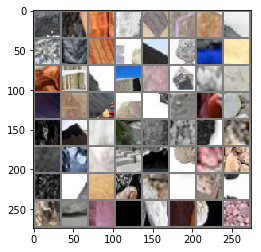

118
tensor([6, 4, 5, 0, 5, 6, 4, 0, 4, 6, 0, 4, 5, 0, 0, 2, 6, 0, 1, 4, 2, 0, 2, 4,
        5, 1, 1, 0, 5, 2, 0, 0, 3, 5, 2, 4, 5, 1, 0, 5, 6, 4, 4, 1, 5, 2, 6, 4,
        4, 1, 5, 6, 0, 3, 2, 3, 5, 6, 2, 4, 5, 1, 4, 5])
(64, 3, 32, 32)
('6_1747.jpg', '4_1933.jpg', '5_8.jpg', '0_2001.jpg', '5_2584.jpg', '6_1753.jpg', '4_902.jpg', '0_4470.jpg', '4_1927.jpg', '6_3144.jpg', '0_1508.jpg', '4_2590.jpg', '5_1933.jpg', '0_3479.jpg', '0_498.jpg', '2_748.jpg', '6_1035.jpg', '0_4316.jpg', '1_853.jpg', '4_1099.jpg', '2_2913.jpg', '0_2767.jpg', '2_990.jpg', '4_1516.jpg', '5_720.jpg', '1_1093.jpg', '1_304.jpg', '0_4266.jpeg', '5_3473.jpg', '2_2244.jpg', '0_117.jpg', '0_1939.jpg', '3_201.png', '5_1264.jpg', '2_1995.jpg', '4_2779.jpg', '5_1502.jpg', '1_462.jpg', '0_3690.jpg', '5_3315.jpg', '6_185.jpg', '4_255.jpg', '4_1270.jpg', '1_476.jpg', '5_3301.jpg', '2_2536.jpg', '6_191.jpg', '4_241.jpg', '4_1264.jpg', '1_29.jpg', '5_1516.jpg', '6_2919.jpg', '0_1093.jpg', '3_1598.png', '2_1759.jpg', '3_215.png'

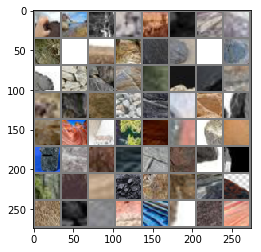

119
tensor([1, 2, 5, 0, 2, 5, 4, 6, 5, 2, 1, 5, 6, 6, 5, 5, 4, 0, 3, 0, 4, 6, 2, 1,
        4, 1, 6, 4, 2, 2, 6, 0, 5, 0, 2, 3, 0, 4, 5, 5, 6, 3, 6, 2, 4, 0, 2, 6,
        0, 2, 2, 6, 5, 1, 6, 4, 2, 0, 4, 0, 4, 6, 0, 6])
(64, 3, 32, 32)
('1_310.jpg', '2_2250.jpg', '5_3467.jpg', '0_1905.jpg', '2_1771.jpg', '5_1258.jpg', '4_2023.jpg', '6_2604.jpeg', '5_2751.jpg', '2_2278.jpg', '1_338.jpg', '5_2989.jpg', '6_1586.jpg', '6_807.jpg', '5_3329.jpg', '5_2037.jpg', '4_269.jpg', '0_895.jpg', '3_956.jpg', '0_3874.jpg', '4_2745.jpg', '6_2931.jpg', '2_1017.jpg', '1_847.png', '4_2751.jpg', '1_15.jpg', '6_2925.jpg', '4_2989.jpg', '2_1003.jpg', '2_589.jpg', '6_2528.png', '0_659.jpg', '5_2023.jpg', '0_881.jpg', '2_2645.webp', '3_942.jpg', '0_3860.jpg', '4_1258.jpg', '5_708.jpg', '5_2745.jpg', '6_1592.jpg', '3_1017.jpg', '6_813.jpg', '2_1765.jpg', '4_2037.jpg', '0_1722.jpg', '2_1956.jpg', '6_2070.jpg', '0_3135.jpg', '2_2287.jpg', '2_204.jpg', '6_1579.jpg', '5_2976.jpg', '1_1050.jpg', '6_146.jpg', '4_296.

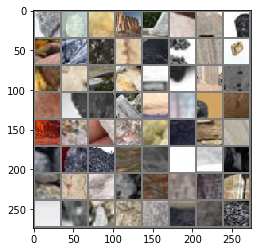

120
tensor([0, 4, 0, 0, 2, 5, 2, 1, 6, 0, 2, 6, 5, 0, 6, 2, 5, 0, 3, 4, 0, 0, 0, 3,
        0, 0, 0, 6, 1, 4, 6, 5, 5, 6, 1, 5, 0, 6, 1, 0, 5, 2, 6, 4, 5, 4, 5, 5,
        0, 2, 5, 5, 6, 4, 5, 4, 1, 4, 2, 5, 0, 4, 0, 5])
(64, 3, 32, 32)
('0_2559.jpg', '4_282.jpg', '0_4128.jpg', '0_3647.jpg', '2_2293.jpg', '5_2962.jpg', '2_210.jpg', '1_1044.jpg', '6_634.jpg', '0_1736.jpg', '2_1942.jpg', '6_2064.jpg', '5_907.jpg', '0_3109.jpg', '6_1545.jpg', '2_238.jpg', '5_2792.jpg', '0_2217.jpg', '3_1573.png', '4_2786.jpg', '0_1078.jpg', '0_2571.jpg', '0_856.jpg', '3_995.jpg', '0_842.jpg', '0_2565.jpg', '0_4114.jpg', '6_1237.jpg', '1_489.jpg', '4_2792.jpg', '6_2058.jpg', '5_913.jpg', '5_3498.jpg', '6_1551.jpg', '1_1078.jpg', '5_2786.jpg', '0_2203.jpg', '6_608.jpg', '1_270.jpg', '0_3082.jpg', '5_3507.jpg', '2_2330.jpg', '6_797.jpg', '4_447.jpg', '5_2619.jpg', '4_1462.jpg', '5_654.jpg', '5_1310.jpg', '0_1695.jpg', '2_1639.jpg', '5_2984.webp', '5_1476.jpg', '6_2879.jpg', '4_1304.jpg', '5_132.jpg', '4_321.

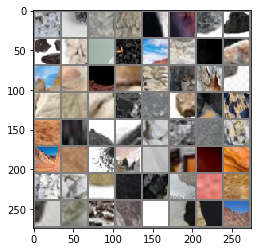

121
tensor([0, 4, 4, 1, 5, 2, 5, 4, 6, 5, 0, 0, 0, 5, 2, 5, 6, 0, 4, 4, 6, 5, 4, 2,
        0, 3, 6, 2, 5, 0, 4, 5, 6, 0, 0, 2, 6, 4, 6, 2, 6, 4, 3, 0, 5, 4, 5, 4,
        6, 6, 3, 2, 1, 2, 5, 4, 5, 2, 6, 2, 0, 6, 0, 4])
(64, 3, 32, 32)
('0_1332.png', '4_335.jpg', '4_25.jpg', '1_502.jpg', '5_3275.jpg', '2_2442.jpg', '5_1462.jpg', '4_2619.jpg', '6_1481.jpeg', '5_1304.jpg', '0_1681.jpg', '0_1859.jpg', '0_3096.jpg', '5_898.jpg', '2_2324.jpg', '5_3513.jpg', '6_783.jpg', '0_2388.jpg', '4_453.jpg', '4_1476.jpg', '6_3146.jpeg', '5_640.jpg', '4_2157.jpg', '2_1605.jpg', '0_1871.jpg', '3_1177.jpg', '6_973.jpg', '2_3012.jpg', '5_668.jpg', '0_3900.jpg', '4_1338.jpg', '5_2143.jpg', '6_3003.jpeg', '0_739.jpg', '0_4262.png', '2_1163.jpg', '6_2845.jpg', '4_2631.jpg', '6_2689.jpg', '2_1177.jpg', '6_2851.jpg', '4_2625.jpg', '3_836.jpg', '0_3914.jpg', '5_2157.jpg', '4_309.jpg', '5_3249.jpg', '4_19.jpg', '6_1380.jpg', '6_967.jpg', '3_1163.jpg', '2_2318.jpg', '1_258.jpg', '2_3006.jpg', '5_2631.jpg', '4_214

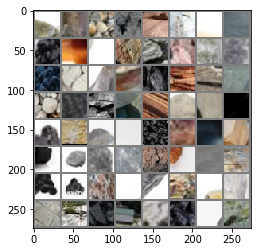

122
tensor([5, 1, 3, 5, 2, 0, 3, 2, 0, 6, 4, 0, 6, 2, 4, 0, 2, 2, 6, 4, 5, 1, 6, 2,
        6, 5, 0, 6, 2, 6, 0, 6, 1, 6, 5, 6, 4, 5, 6, 0, 6, 5, 0, 6, 0, 5, 0, 6,
        6, 3, 4, 3, 0, 4, 2, 5, 0, 0, 0, 0, 5, 2, 1, 4])
(64, 3, 32, 32)
('5_697.jpg', '1_1124.jpg', '3_1188.jpg', '5_2802.jpg', '2_370.jpg', '0_3727.jpg', '3_605.jpg', '2_2495.jpg', '0_1130.jpg', '6_2662.jpg', '4_2816.jpg', '0_1124.jpg', '6_2676.jpg', '2_1188.jpg', '4_2802.jpg', '0_3733.jpg', '2_2481.jpg', '2_402.jpg', '6_740.jpg', '4_490.jpg', '5_683.jpg', '1_1130.jpg', '6_998.jpg', '2_364.jpg', '6_1419.jpg', '5_2816.jpg', '0_3055.jpg', '6_2110.jpg', '2_1836.jpg', '6_2491.jpeg', '0_1642.jpg', '6_768.jpg', '1_1118.jpg', '6_1431.jpg', '5_873.jpg', '6_2138.jpg', '4_2194.jpg', '5_1489.jpg', '6_52.jpeg', '0_4074.jpg', '6_1357.jpg', '5_2180.jpg', '0_2405.jpg', '6_1343.jpg', '0_4060.jpg', '5_2194.jpg', '0_2411.jpg', '6_2887.jpeg', '6_2892.jpg', '3_1413.png', '4_2180.jpg', '3_583.jpeg', '0_2377.jpg', '4_1489.jpg', '2_358.jpg', '5_

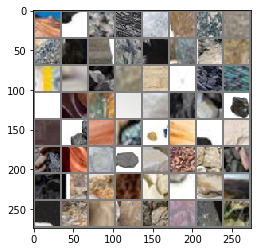

123
tensor([5, 4, 5, 4, 0, 5, 4, 3, 5, 4, 4, 3, 6, 2, 0, 0, 0, 5, 4, 6, 4, 6, 2, 0,
        4, 0, 4, 0, 3, 5, 5, 2, 0, 0, 2, 5, 1, 4, 5, 2, 5, 4, 4, 5, 2, 0, 5, 0,
        6, 1, 2, 5, 2, 5, 4, 6, 4, 3, 2, 4, 2, 4, 4, 5])
(64, 3, 32, 32)
('5_330.jpg', '4_1106.jpg', '5_1674.jpg', '4_3077.jpg', '0_1497.jpg', '5_1112.jpg', '4_2369.jpg', '3_1420.JPEG', '5_456.jpg', '4_1660.jpg', '4_645.jpg', '3_307.JPEG', '6_595.jpg', '2_2132.jpg', '0_3280.jpg', '0_1475.jpeg', '0_261.jpg', '5_442.jpg', '4_1674.jpg', '6_1800.jpg', '4_651.jpg', '6_581.jpg', '2_2126.jpg', '0_3294.jpg', '4_889.jpg', '0_275.jpg', '4_3063.jpg', '0_3041.png', '3_84.JPEG', '5_1106.jpg', '5_1660.jpg', '2_1349.jpg', '0_41.jpg', '0_2834.jpg', '2_2640.jpg', '5_3077.jpg', '1_700.jpg', '4_137.jpg', '5_2369.jpg', '2_2898.jpg', '5_324.jpg', '4_1112.jpg', '4_2433.jpg', '5_1648.jpg', '2_1361.jpg', '0_69.jpg', '5_1890.jpg', '0_1863.jpeg', '6_1196.jpg', '1_728.jpg', '2_2668.jpg', '5_2341.jpg', '2_833.jpg', '5_2427.jpg', '4_679.jpg', '6_1828.jp

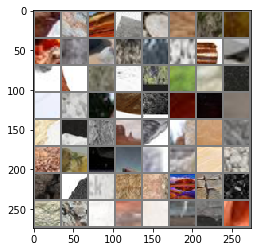

124
tensor([4, 0, 0, 6, 2, 6, 5, 5, 4, 0, 2, 5, 3, 0, 6, 6, 2, 2, 3, 0, 3, 0, 2, 5,
        4, 6, 0, 6, 6, 1, 0, 6, 3, 0, 0, 5, 4, 0, 6, 6, 2, 2, 0, 0, 0, 0, 5, 1,
        2, 6, 0, 5, 3, 6, 4, 3, 4, 4, 0, 6, 4, 0, 0, 4])
(64, 3, 32, 32)
('4_1890.jpg', '0_249.jpg', '0_2808.jpg', '6_1182.jpg', '2_827.jpg', '6_2886.png', '5_2355.jpg', '5_318.jpg', '4_2427.jpg', '0_922.png', '2_1375.jpg', '5_1884.jpg', '3_1639.png', '0_96.jpg', '6_230.jpg', '6_1169.jpg', '2_614.jpg', '2_2697.jpg', '3_407.jpg', '0_3525.jpg', '3_361.jpg', '0_3243.jpg', '2_172.jpg', '5_495.jpg', '4_686.jpg', '6_556.jpg', '0_1454.jpg', '6_3018.jpg', '6_2306.jpg', '1_264.png', '0_1440.jpg', '6_2312.jpg', '3_375.jpg', '0_3257.jpg', '0_4538.jpg', '5_481.jpg', '4_692.jpg', '0_2149.jpg', '6_542.jpg', '6_224.jpg', '2_600.jpg', '2_2683.jpg', '0_3531.jpg', '0_82.jpg', '0_1326.jpg', '0_2607.jpg', '5_2382.jpg', '1_933.jpg', '2_2873.jpg', '6_1155.jpg', '0_3519.jpg', '5_1853.jpg', '3_1605.png', '6_3024.jpg', '4_2396.jpg', '3_184.JPEG', '4

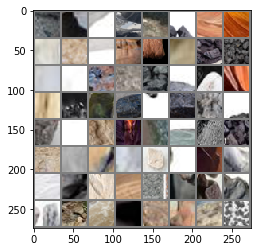

125
tensor([3, 0, 4, 6, 0, 6, 4, 6, 5, 3, 3, 6, 0, 5, 1, 2, 6, 5, 4, 6, 0, 0, 6, 4,
        4, 5, 0, 6, 2, 1, 5, 0, 6, 6, 5, 5, 0, 6, 2, 0, 2, 1, 5, 0, 0, 4, 6, 0,
        3, 4, 4, 4, 0, 6, 0, 4, 5, 2, 0, 6, 0, 3, 0, 6])
(64, 3, 32, 32)
('3_349.jpg', '0_4504.jpg', '4_876.jpg', '6_1627.jpg', '0_2175.jpg', '6_3030.jpg', '4_2382.jpg', '6_2448.jpg', '5_1847.jpg', '3_1611.png', '3_822.png', '6_218.jpg', '0_2613.jpg', '5_2396.jpg', '1_927.jpg', '2_2867.jpg', '6_1141.jpg', '5_3088.jpg', '4_2383.jpg', '6_3031.jpg', '0_2174.jpg', '0_4505.jpg', '6_1626.jpg', '4_877.jpg', '4_1852.jpg', '5_3089.jpg', '0_4263.jpg', '6_1140.jpg', '2_2866.jpg', '1_926.jpg', '5_2397.jpg', '0_2612.jpg', '6_219.jpg', '6_2449.jpg', '5_1846.jpg', '5_1852.jpg', '0_3518.jpg', '6_1154.jpg', '2_629.jpg', '0_4277.jpg', '2_2872.jpg', '1_932.jpg', '5_2383.jpg', '0_2606.jpg', '0_2160.jpg', '4_863.jpg', '6_1632.jpg', '0_4511.jpg', '3_239.JPEG', '4_1846.jpg', '4_3089.jpg', '4_2397.jpg', '0_1469.jpg', '6_543.jpg', '0_2148.jpg', '4_6

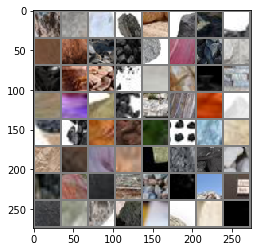

126
tensor([0, 2, 6, 0, 2, 3, 6, 6, 0, 6, 0, 1, 6, 6, 2, 4, 5, 2, 0, 3, 0, 4, 5, 3,
        4, 4, 2, 5, 2, 4, 5, 2, 5, 6, 0, 5, 2, 2, 1, 0, 5, 2, 5, 4, 2, 3, 4, 5,
        6, 4, 1, 5, 5, 0, 4, 0, 4, 0, 2, 6, 4, 4, 5, 4])
(64, 3, 32, 32)
('0_3530.jpg', '2_2682.jpg', '6_225.jpg', '0_3524.jpg', '2_2696.jpg', '3_406.jpg', '6_1168.jpg', '6_231.jpg', '0_1333.jpg', '6_2461.jpg', '0_97.jpg', '1_503.png', '6_2307.jpg', '6_3019.jpg', '2_3081.webp', '4_687.jpg', '5_494.jpg', '2_173.jpg', '0_3242.jpg', '3_1360.jpg', '0_248.jpg', '4_1891.jpg', '5_2432.jpg', '3_1288.JPEG', '4_1649.jpg', '4_2340.jpg', '2_1412.jpg', '5_1885.jpg', '2_1374.jpg', '4_2426.jpg', '5_319.jpg', '2_826.jpg', '5_2354.jpg', '6_1183.jpg', '0_2809.jpg', '5_2340.jpg', '2_832.jpg', '2_2669.jpg', '1_729.jpg', '0_68.jpg', '5_1891.jpg', '2_1360.jpg', '5_1649.jpg', '4_2432.jpg', '2_1406.jpg', '3_1374.jpg', '4_1885.jpg', '5_2426.jpg', '6_1829.jpg', '4_678.jpg', '1_1125.png', '5_3086.webp', '5_1107.jpg', '0_1482.jpg', '4_3062.jpg', '0_274

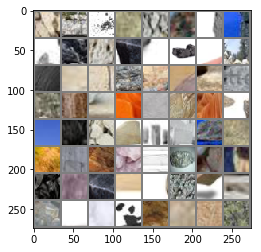

127
tensor([2, 5, 5, 1, 2, 5, 0, 0, 0, 2, 5, 3, 0, 5, 4, 5, 4, 1, 5, 2, 0, 0, 0, 0,
        0, 2, 6, 4, 4, 5, 2, 4, 5, 4, 0, 0, 5, 3, 0, 0, 5, 2, 6, 4, 0, 0, 4, 4,
        5, 1, 6, 0, 0, 5, 0, 3, 3, 5, 2, 2, 0, 4, 2, 0])
(64, 3, 32, 32)
('2_2899.jpg', '5_325.jpg', '5_2368.jpg', '1_701.jpg', '2_2641.jpg', '5_3076.jpg', '0_512.jpg', '0_2835.jpg', '0_40.jpg', '2_1348.jpg', '5_1661.jpg', '3_1637.JPEG', '0_54.jpg', '5_1675.jpg', '4_1107.jpg', '5_331.jpg', '4_122.jpg', '1_715.jpg', '5_3062.jpg', '2_2655.jpg', '0_2821.jpg', '0_506.jpg', '0_4288.jpg', '0_260.jpg', '0_3281.jpg', '2_2133.jpg', '6_594.jpg', '4_644.jpg', '4_1661.jpg', '5_457.jpg', '2_2556.webp', '4_2368.jpg', '5_1113.jpg', '4_3076.jpg', '0_1119.jpg', '0_2410.jpg', '5_2195.jpg', '3_1549.JPEG', '0_4061.jpg', '0_3068.jpg', '5_866.jpg', '2_359.jpg', '6_1424.jpg', '4_1488.jpg', '0_2376.jpg', '0_3171.jpeg', '4_2181.jpg', '4_2195.jpg', '5_872.jpg', '1_1119.jpg', '6_769.jpg', '0_2362.jpg', '0_2404.jpg', '5_2181.jpg', '0_4075.jpg', '3_638.

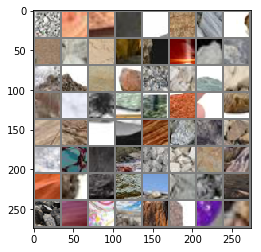

128
tensor([0, 2, 6, 3, 0, 6, 5, 6, 1, 5, 4, 6, 3, 0, 5, 2, 3, 5, 4, 0, 2, 6, 4, 6,
        0, 0, 2, 3, 2, 0, 3, 6, 4, 5, 5, 4, 0, 4, 6, 2, 6, 3, 0, 2, 5, 4, 6, 2,
        5, 1, 2, 3, 3, 5, 5, 3, 0, 4, 4, 6, 2, 3, 0, 5])
(64, 3, 32, 32)
('0_1643.jpg', '2_1837.jpg', '6_2111.jpg', '3_176.jpg', '0_3054.jpg', '6_1418.jpg', '5_2817.jpg', '6_999.jpg', '1_1131.jpg', '5_682.jpg', '4_491.jpg', '6_741.jpg', '3_162.jpg', '0_3040.jpg', '5_2803.jpg', '2_371.jpg', '3_1189.jpg', '5_696.jpg', '4_485.jpg', '0_1657.jpg', '2_1823.jpg', '6_2105.jpg', '4_2817.jpg', '6_2663.jpg', '0_1131.jpg', '0_4049.jpg', '2_417.jpg', '3_604.jpg', '2_2494.jpg', '0_3726.jpg', '3_1604.jpg', '6_1381.jpg', '4_18.jpg', '5_3248.jpg', '5_2156.jpg', '4_308.jpg', '0_3915.jpg', '4_2624.jpg', '6_2850.jpg', '2_1176.jpg', '6_2688.jpg', '3_901.JPEG', '0_1864.jpg', '2_1610.jpg', '5_1339.jpg', '4_2142.jpg', '6_3025.png', '2_3007.jpg', '5_2630.jpg', '1_259.jpg', '2_2319.jpg', '3_1162.jpg', '3_11.jpg', '5_669.jpg', '5_2624.jpg', '3_1176.jp

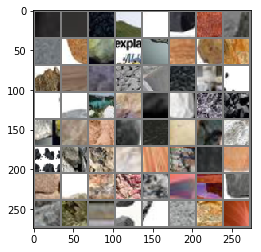

129
tensor([0, 4, 4, 5, 3, 5, 2, 4, 4, 5, 4, 0, 5, 4, 4, 6, 5, 2, 5, 0, 0, 3, 6, 0,
        5, 0, 2, 0, 5, 5, 4, 5, 6, 5, 2, 0, 2, 5, 1, 4, 4, 0, 5, 4, 3, 5, 4, 3,
        1, 0, 6, 3, 0, 0, 0, 1, 6, 5, 5, 3, 3, 0, 5, 2])
(64, 3, 32, 32)
('0_3901.jpg', '4_1339.jpg', '4_2618.jpg', '5_1463.jpg', '3_1638.jpg', '5_3274.jpg', '2_2443.jpg', '4_24.jpg', '4_334.jpg', '5_127.jpg', '4_1311.jpg', '0_3929.jpg', '5_641.jpg', '4_1477.jpg', '4_452.jpg', '6_782.jpg', '5_899.jpg', '2_2325.jpg', '5_3512.jpg', '0_3097.jpg', '0_1858.jpg', '3_147.JPEG', '6_557.png', '0_1680.jpg', '5_1305.jpg', '0_4539.png', '2_1638.jpg', '0_1694.jpg', '5_1311.jpg', '5_655.jpg', '4_1463.jpg', '5_2618.jpg', '6_796.jpg', '5_3506.jpg', '2_2331.jpg', '0_3083.jpg', '2_2457.jpg', '5_3260.jpg', '1_517.jpg', '4_30.jpg', '4_320.jpg', '0_1327.png', '5_133.jpg', '4_1305.jpg', '3_844.jpeg', '5_1477.jpg', '4_2793.jpg', '3_1566.png', '1_488.jpg', '0_4115.jpg', '6_1236.jpg', '3_980.jpg', '0_2564.jpg', '0_843.jpg', '0_2202.jpg', '1_1079.jpg

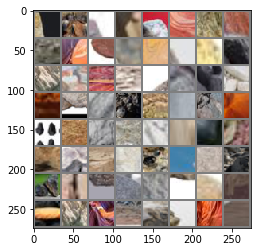

130
tensor([6, 5, 6, 0, 3, 0, 0, 0, 4, 3, 0, 0, 2, 4, 6, 0, 6, 4, 6, 2, 6, 5, 2, 0,
        6, 1, 6, 2, 5, 2, 6, 0, 6, 2, 0, 0, 6, 4, 0, 0, 2, 4, 6, 6, 0, 4, 0, 0,
        5, 0, 2, 2, 4, 6, 4, 4, 0, 2, 0, 6, 6, 5, 5, 6])
(64, 3, 32, 32)
('6_1544.jpg', '5_906.jpg', '6_1222.jpg', '0_4101.jpg', '3_994.jpg', '0_857.jpg', '0_2570.jpg', '0_1079.jpg', '4_2787.jpg', '3_764.jpg', '0_3646.jpg', '0_4129.jpg', '2_577.jpg', '4_283.jpg', '6_153.jpg', '0_1051.jpg', '6_2703.jpg', '4_2977.jpg', '6_2065.jpg', '2_1943.jpg', '6_635.jpg', '5_2963.jpg', '2_2292.jpg', '0_3120.jpg', '6_621.jpg', '1_1051.jpg', '6_1578.jpg', '2_205.jpg', '5_2977.jpg', '2_2286.jpg', '6_1815.jpeg', '0_3134.jpg', '6_2071.jpg', '2_1957.jpg', '0_1045.jpg', '0_2799.jpeg', '6_2717.jpg', '4_2963.jpg', '0_4432.webp', '0_3652.jpg', '2_563.jpg', '4_297.jpg', '6_147.jpg', '6_2940.jpeg', '0_3861.jpg', '4_1259.jpg', '0_158.jpeg', '0_880.jpg', '5_2022.jpg', '0_658.jpg', '2_588.jpg', '2_1002.jpg', '4_2988.jpg', '6_2924.jpg', '4_2750.jpg', '4_2

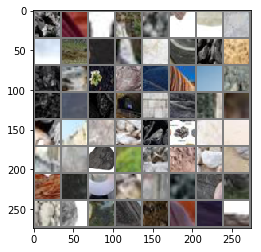

131
tensor([3, 5, 6, 1, 2, 5, 4, 5, 2, 0, 2, 6, 4, 0, 0, 5, 4, 5, 0, 5, 6, 4, 4, 6,
        5, 2, 1, 0, 0, 0, 2, 5, 1, 4, 5, 1, 5, 6, 2, 6, 5, 2, 2, 6, 5, 3, 0, 0,
        5, 2, 1, 4, 1, 5, 4, 4, 0, 6, 2, 5, 5, 0, 1, 0])
(64, 3, 32, 32)
('3_1002.jpg', '5_2988.jpg', '6_1587.jpg', '1_339.jpg', '2_2279.jpg', '5_2750.jpg', '4_2022.jpg', '5_1259.jpg', '2_1770.jpg', '0_1904.jpg', '2_1016.jpg', '6_2930.jpg', '4_2744.jpg', '0_3875.jpg', '0_894.jpg', '5_2036.jpg', '4_268.jpg', '5_3328.jpg', '0_1092.jpg', '5_1517.jpg', '6_2918.jpg', '4_1265.jpg', '4_240.jpg', '6_190.jpg', '5_3300.jpg', '2_2537.jpg', '1_477.jpg', '0_3685.jpg', '0_664.jpg', '0_102.jpg', '2_2251.jpg', '5_3466.jpg', '1_311.jpg', '4_526.jpg', '5_2778.jpg', '1_1086.jpg', '5_735.jpg', '6_2556.jpeg', '2_1980.jpg', '6_21.jpg', '5_1271.jpg', '2_1758.jpg', '2_1994.jpg', '6_35.jpg', '5_1265.jpg', '3_151.JPEG', '0_1938.jpg', '0_116.jpg', '5_3472.jpg', '2_2245.jpg', '1_305.jpg', '4_532.jpg', '1_1092.jpg', '5_721.jpg', '4_1517.jpg', '4_1271.jp

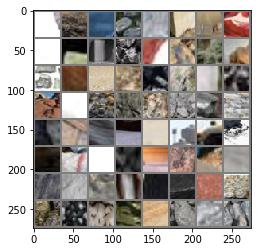

132
tensor([5, 4, 6, 4, 3, 6, 0, 5, 0, 5, 2, 0, 2, 1, 6, 2, 0, 0, 0, 5, 4, 6, 5, 4,
        2, 0, 6, 2, 1, 0, 6, 4, 0, 6, 4, 5, 0, 5, 0, 2, 3, 6, 0, 2, 6, 6, 0, 6,
        5, 0, 6, 0, 6, 5, 0, 3, 2, 6, 0, 6, 0, 2, 0, 2])
(64, 3, 32, 32)
('5_1503.jpg', '4_2778.jpg', '6_3145.jpg', '4_1926.jpg', '3_1508.JPEG', '6_1752.jpg', '0_4471.jpg', '5_2585.jpg', '0_2000.jpg', '5_9.jpg', '2_991.jpg', '0_2766.jpg', '2_2912.jpg', '1_852.jpg', '6_1034.jpg', '2_749.jpg', '0_4317.jpg', '0_499.jpg', '0_3478.jpg', '5_1932.jpg', '4_2591.jpg', '6_2529.jpg', '5_1926.jpg', '4_2585.jpg', '2_985.jpg', '0_2772.jpg', '6_379.jpg', '2_2906.jpg', '1_846.jpg', '0_4303.jpg', '6_1020.jpg', '4_1932.jpg', '0_4465.jpg', '6_1746.jpg', '4_917.jpg', '5_2591.jpg', '0_2014.jpg', '5_1098.jpg', '0_3322.jpg', '2_2090.jpg', '3_200.jpg', '6_437.jpg', '0_1535.jpg', '2_1599.jpg', '6_2501.jpg', '6_2297.jpeg', '0_1253.jpg', '6_351.jpg', '5_292.jpg', '0_2982.jpg', '6_1008.jpg', '0_3444.jpg', '6_345.jpg', '5_286.jpg', '0_2996.jpg', '3_1599

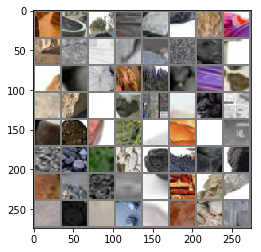

133
tensor([6, 2, 5, 4, 6, 6, 6, 0, 2, 4, 4, 5, 2, 3, 3, 2, 1, 5, 2, 5, 1, 2, 5, 5,
        3, 5, 1, 4, 2, 2, 4, 4, 5, 6, 3, 0, 5, 4, 4, 5, 6, 4, 1, 2, 0, 0, 0, 0,
        1, 2, 5, 6, 4, 5, 5, 0, 3, 5, 0, 2, 0, 0, 1, 0])
(64, 3, 32, 32)
('6_423.jpg', '2_79.jpg', '5_2546.jpg', '4_718.jpg', '6_1791.jpg', '6_2298.jpg', '6_2444.jpeg', '0_3108.png', '2_1566.jpg', '4_2234.jpg', '4_2552.jpg', '5_1729.jpg', '2_1200.jpg', '3_1572.jpg', '3_599.jpg', '2_2709.jpg', '1_649.jpg', '5_2220.jpg', '2_952.jpg', '5_70.jpg', '1_891.jpg', '2_946.jpg', '5_2234.jpg', '5_64.jpg', '3_413.JPEG', '5_279.jpg', '1_885.jpg', '4_2546.jpg', '2_1214.jpg', '2_1572.jpg', '4_2220.jpg', '4_1729.jpg', '5_2552.jpg', '6_1785.jpg', '3_1200.jpg', '0_328.jpg', '5_1073.jpg', '4_2208.jpg', '4_1701.jpg', '5_537.jpg', '6_1975.jpg', '4_724.jpg', '1_113.jpg', '2_2053.jpg', '0_300.jpg', '0_2941.jpg', '0_466.jpg', '0_3487.jpg', '1_675.jpg', '2_2735.jpg', '5_3102.jpg', '6_392.jpg', '4_1067.jpg', '5_251.jpg', '5_1715.jpg', '0_1290.jpg', '

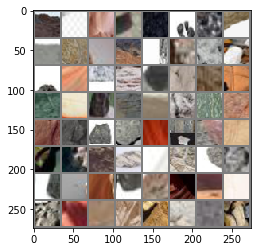

134
tensor([5, 2, 5, 6, 5, 4, 5, 2, 4, 6, 1, 2, 0, 4, 5, 1, 5, 0, 4, 6, 5, 2, 0, 0,
        6, 0, 1, 2, 4, 6, 5, 4, 5, 2, 5, 2, 5, 4, 0, 1, 2, 6, 4, 4, 2, 4, 5, 6,
        2, 0, 2, 5, 0, 3, 6, 5, 0, 4, 1, 4, 2, 5, 5, 2])
(64, 3, 32, 32)
('5_3116.jpg', '2_2721.jpg', '5_58.jpg', '6_386.jpg', '5_245.jpg', '4_1715.jpg', '5_523.jpg', '2_51.jpg', '4_730.jpg', '6_1961.jpg', '1_107.jpg', '2_2047.jpg', '0_314.jpg', '4_3102.jpg', '5_1067.jpg', '1_1045.png', '5_1717.jpg', '0_1292.jpg', '4_1065.jpg', '6_390.jpg', '5_3100.jpg', '2_2737.jpg', '0_464.jpg', '0_2943.jpg', '6_2715.png', '0_302.jpg', '1_111.jpg', '2_2051.jpg', '4_726.jpg', '6_1977.jpg', '5_2578.jpg', '4_1703.jpg', '5_535.jpg', '2_47.jpg', '5_1071.jpg', '2_1558.jpg', '5_1065.jpg', '4_3100.jpg', '0_4498.jpg', '1_105.jpg', '2_2045.jpg', '6_1963.jpg', '4_732.jpg', '4_1717.jpg', '2_53.jpg', '4_1071.jpg', '5_247.jpg', '6_384.jpg', '2_978.jpg', '0_3491.jpg', '2_2723.jpg', '5_3114.jpg', '0_2957.jpg', '3_1558.jpg', '6_2701.png', '5_1703.jpg', '0_

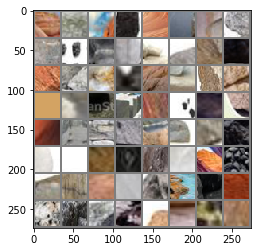

135
tensor([0, 2, 4, 3, 4, 2, 6, 5, 5, 6, 2, 1, 5, 4, 5, 2, 0, 2, 4, 1, 5, 2, 5, 5,
        3, 0, 0, 0, 5, 0, 6, 3, 6, 6, 0, 6, 2, 4, 0, 3, 2, 6, 2, 4, 6, 0, 2, 6,
        0, 0, 5, 6, 0, 3, 0, 2, 1, 2, 5, 5, 6, 4, 0, 5])
(64, 3, 32, 32)
('0_458.jpg', '2_1202.jpg', '4_2550.jpg', '3_1713.JPEG', '4_2236.jpg', '2_1564.jpg', '6_1793.jpg', '5_2544.jpg', '5_509.jpg', '6_1787.jpg', '2_2079.jpg', '1_139.jpg', '5_2550.jpg', '4_2222.jpg', '5_1059.jpg', '2_1570.jpg', '0_4117.png', '2_1216.jpg', '4_2544.jpg', '1_887.jpg', '5_2236.jpg', '2_944.jpg', '5_66.jpg', '5_3128.jpg', '3_1564.jpg', '0_3446.jpg', '0_2980.jpg', '0_4329.jpg', '5_290.jpg', '0_2758.jpg', '6_353.jpg', '3_1590.JPEG', '6_2503.jpg', '6_2265.jpg', '0_1537.jpg', '6_435.jpg', '2_84.jpg', '4_1918.jpg', '0_3320.jpg', '3_202.jpg', '2_2092.jpg', '6_421.jpg', '2_90.jpg', '4_929.jpg', '6_1778.jpg', '0_3334.jpg', '2_2086.jpg', '6_2271.jpg', '0_1523.jpg', '0_1245.jpg', '5_1918.jpg', '6_2517.jpg', '0_3452.jpg', '3_570.jpg', '0_2994.jpg', '2_763.j

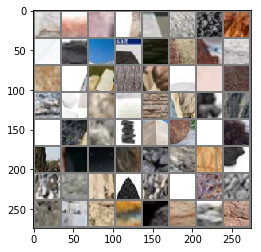

136
tensor([3, 1, 0, 6, 2, 6, 1, 2, 0, 5, 6, 6, 0, 0, 6, 4, 4, 6, 5, 0, 4, 6, 0, 6,
        0, 4, 6, 2, 1, 2, 0, 0, 4, 5, 6, 5, 4, 2, 1, 5, 4, 4, 5, 2, 3, 1, 0, 3,
        0, 2, 5, 0, 1, 4, 6, 0, 4, 0, 5, 3, 0, 5, 2, 0])
(64, 3, 32, 32)
('3_558.jpg', '1_688.jpg', '0_4315.jpg', '6_1036.jpg', '2_2910.jpg', '6_446.jpeg', '1_850.jpg', '2_993.jpg', '0_2764.jpg', '5_2587.jpg', '6_1988.jpg', '6_409.jpg', '0_2002.jpg', '0_4473.jpg', '6_1750.jpg', '4_901.jpg', '4_1924.jpg', '6_2259.jpg', '5_2593.jpg', '0_2016.jpg', '4_915.jpg', '6_1744.jpg', '0_4467.jpg', '6_1073.jpeg', '0_3308.jpg', '4_1930.jpg', '6_1022.jpg', '2_2904.jpg', '1_844.jpg', '2_987.jpg', '0_2770.jpg', '0_1279.jpg', '4_2587.jpg', '5_1924.jpg', '6_23.jpg', '5_1273.jpg', '4_2008.jpg', '2_1982.jpg', '1_1084.jpg', '5_737.jpg', '4_1501.jpg', '4_524.jpg', '5_3464.jpg', '2_2253.jpg', '3_1251.JPEG', '1_313.jpg', '0_100.jpg', '3_1028.jpg', '0_666.jpg', '2_2535.jpg', '5_3302.jpg', '0_3687.jpg', '1_475.jpg', '4_242.jpg', '6_192.jpg', '0_2599.j

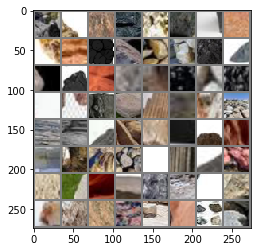

137
tensor([5, 2, 0, 4, 5, 6, 3, 4, 1, 5, 4, 4, 6, 2, 5, 1, 6, 6, 5, 2, 5, 4, 5, 3,
        6, 6, 6, 0, 2, 4, 1, 4, 5, 2, 0, 2, 5, 0, 3, 0, 5, 0, 3, 4, 6, 2, 0, 2,
        3, 4, 4, 5, 3, 0, 6, 6, 2, 0, 2, 5, 1, 6, 0, 2])
(64, 3, 32, 32)
('5_3316.jpg', '2_2521.jpg', '0_3693.jpg', '4_256.jpg', '5_2008.jpg', '6_186.jpg', '3_969.jpg', '4_1273.jpg', '1_1090.jpg', '5_723.jpg', '4_1515.jpg', '4_530.jpg', '6_368.jpeg', '2_2247.jpg', '5_3470.jpg', '1_307.jpg', '6_838.jpg', '6_37.jpg', '5_1267.jpg', '2_1996.jpg', '5_2746.jpg', '4_518.jpg', '5_3458.jpg', '3_1014.jpg', '6_1591.jpg', '6_2464.jpeg', '6_31 2.jpg', '0_1912.jpg', '2_1766.jpg', '4_2034.jpg', '1_16.jpg', '4_2752.jpg', '5_1529.jpg', '2_1000.jpg', '0_4301.png', '2_2509.jpg', '5_2020.jpg', '0_3863.jpg', '3_941.jpg', '0_896.jpg', '5_2034.jpg', '0_3877.jpg', '3_955.jpg', '4_2746.jpg', '6_2932.jpg', '2_1014.jpg', '0_1906.jpg', '2_1772.jpg', '3_1744.JPEG', '4_2020.jpg', '4_1529.jpg', '5_2752.jpg', '3_1000.jpg', '0_128.jpg', '6_804.jpg', '6_1585

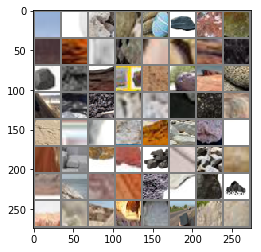

138
tensor([6, 2, 6, 4, 0, 4, 6, 6, 3, 0, 4, 0, 6, 0, 0, 4, 0, 0, 2, 6, 5, 2, 0, 5,
        1, 0, 0, 5, 6, 0, 5, 0, 0, 4, 3, 0, 2, 6, 0, 4, 4, 6, 3, 4, 0, 6, 6, 5,
        5, 6, 0, 5, 5, 2, 3, 0, 5, 6, 5, 2, 0, 1, 4, 2])
(64, 3, 32, 32)
('6_2067.jpg', '2_1799.jpg', '6_104.jpeg', '4_2975.jpg', '0_1053.jpg', '4_281.jpg', '6_151.jpg', '6_1208.jpg', '3_766.jpg', '0_3644.jpg', '4_295.jpg', '0_869.jpg', '6_145.jpg', '0_3888.jpg', '0_3650.jpg', '4_2961.jpg', '0_1047.jpg', '0_1721.jpg', '2_1955.jpg', '6_2073.jpg', '5_938.jpg', '2_2284.jpg', '0_3136.jpg', '5_2975.jpg', '1_1053.jpg', '0_2228.jpg', '0_1709.jpg', '5_910.jpg', '6_1552.jpg', '0_2200.jpg', '5_2785.jpg', '0_841.jpg', '0_2566.jpg', '4_1298.jpg', '3_982.jpg', '0_699.jpg', '2_549.jpg', '6_1234.jpg', '0_3678.jpg', '4_2949.jpg', '4_2791.jpg', '6_2729.jpg', '3_1570.png', '4_2785.jpg', '0_855.jpg', '6_179.jpg', '6_1220.jpg', '5_904.jpg', '5_2949.jpg', '6_1546.jpg', '0_2214.jpg', '5_2791.jpg', '5_1298.jpg', '2_1969.jpg', '3_833.JPEG', '0_1682

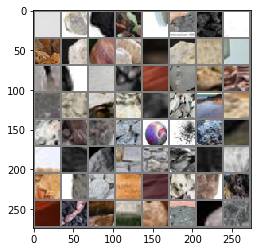

139
tensor([6, 5, 4, 5, 4, 4, 5, 2, 5, 1, 4, 0, 2, 5, 3, 5, 5, 4, 4, 5, 2, 4, 1, 0,
        6, 0, 2, 5, 1, 0, 4, 6, 5, 4, 4, 0, 5, 3, 2, 5, 2, 5, 4, 4, 2, 0, 2, 6,
        0, 4, 1, 0, 5, 5, 3, 6, 0, 5, 1, 2, 6, 2, 6, 5])
(64, 3, 32, 32)
('6_780.jpg', '5_643.jpg', '4_1475.jpg', '5_125.jpg', '4_1313.jpg', '4_336.jpg', '5_2168.jpg', '2_2441.jpg', '5_3276.jpg', '1_501.jpg', '4_26.jpg', '0_712.jpg', '2_1148.jpg', '5_1461.jpg', '3_1617.JPEG', '5_1475.jpg', '5_131.jpg', '4_1307.jpg', '4_322.jpg', '5_3262.jpg', '2_2455.jpg', '4_32.jpg', '1_515.jpg', '0_4088.jpg', '6_2864.jpeg', '0_706.jpg', '2_2333.jpg', '5_3504.jpg', '1_273.jpg', '0_3081.jpg', '4_444.jpg', '6_794.jpg', '5_657.jpg', '4_1461.jpg', '4_2168.jpg', '0_1696.jpg', '5_1313.jpg', '3_1160.jpg', '2_398.jpg', '5_2632.jpg', '2_3005.jpg', '5_2208.webp', '4_1449.jpg', '4_2140.jpg', '2_1612.jpg', '0_1866.jpg', '2_1174.jpg', '6_2852.jpg', '0_569.jpeg', '4_2626.jpg', '1_930.png', '0_3917.jpg', '5_119.jpg', '5_2154.jpg', '3_1606.jpg', '6_1383.jp

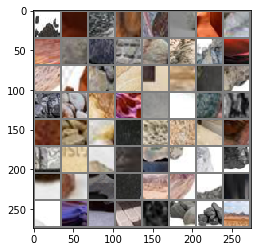

140
tensor([4, 4, 2, 0, 3, 5, 2, 5, 4, 0, 1, 5, 5, 2, 5, 3, 0, 0, 6, 2, 0, 6, 4, 2,
        0, 2, 0, 2, 0, 6, 2, 0, 3, 6, 4, 6, 2, 4, 6, 5, 2, 5, 0, 4, 5, 6, 5, 3,
        5, 0, 6, 0, 0, 5, 6, 6, 6, 4, 0, 2, 6, 0, 0, 0])
(64, 3, 32, 32)
('4_2632.jpg', '4_2154.jpg', '2_1606.jpg', '0_1872.jpg', '3_1174.jpg', '5_3538.jpg', '2_3011.jpg', '5_2626.jpg', '4_493.jpg', '0_2348.jpg', '1_1133.jpg', '5_680.jpg', '5_2815.jpg', '2_367.jpg', '5_858.jpg', '3_174.jpg', '0_3056.jpg', '0_1899.jpg', '6_2113.jpg', '2_1835.jpg', '0_1127.jpg', '6_2675.jpg', '4_2801.jpg', '2_2482.jpg', '0_3730.jpg', '2_401.jpg', '0_909.jpg', '2_2496.jpg', '0_3724.jpg', '6_1368.jpg', '2_415.jpg', '0_1133.jpg', '3_1438.png', '6_2661.jpg', '4_2815.jpg', '6_2107.jpg', '2_1821.jpg', '4_487.jpg', '6_757.jpg', '5_694.jpg', '2_373.jpg', '5_2801.jpg', '0_3042.jpg', '4_2183.jpg', '5_2829.jpg', '6_1426.jpg', '5_864.jpg', '3_148.jpg', '5_3289.jpg', '0_4063.jpg', '6_1340.jpg', '0_2412.jpg', '0_935.jpg', '5_2197.jpg', '6_2891.jpg', '6_2649

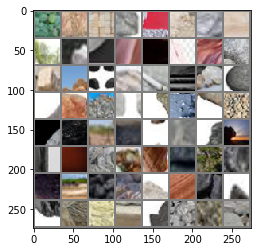

141
tensor([5, 6, 5, 4, 0, 4, 5, 3, 0, 0, 1, 5, 2, 4, 2, 4, 5, 5, 6, 6, 4, 0, 2, 4,
        5, 0, 1, 4, 2, 5, 0, 6, 4, 5, 0, 6, 4, 6, 5, 0, 2, 0, 0, 0, 1, 2, 5, 4,
        4, 5, 5, 3, 6, 3, 5, 5, 4, 2, 4, 6, 5, 2, 5, 4])
(64, 3, 32, 32)
('5_2183.jpg', '6_1432.jpg', '5_870.jpg', '4_2197.jpg', '0_1669.jpg', '4_2418.jpg', '5_1663.jpg', '3_606.png', '0_2837.jpg', '0_510.jpg', '1_703.jpg', '5_3074.jpg', '2_2643.jpg', '4_134.jpg', '2_818.jpg', '4_1111.jpg', '5_327.jpg', '5_441.jpg', '6_582.jpg', '6_1803.jpg', '4_652.jpg', '0_3297.jpg', '2_2125.jpg', '4_3060.jpg', '5_1105.jpg', '0_1480.jpg', '1_1127.png', '4_3074.jpg', '2_1438.jpg', '5_1111.jpg', '0_1494.jpg', '6_779.jpeg', '4_1663.jpg', '5_455.jpg', '0_1641.png', '6_596.jpg', '4_646.jpg', '6_1817.jpg', '5_2418.jpg', '0_3283.jpg', '2_2131.jpg', '0_262.jpg', '0_504.jpg', '0_2823.jpg', '1_717.jpg', '2_2657.jpg', '5_3060.jpg', '4_120.jpg', '4_1105.jpg', '5_333.jpg', '5_1677.jpg', '3_612.png', '6_1181.jpg', '3_1404.jpg', '5_3048.jpg', '5_2356.jpg

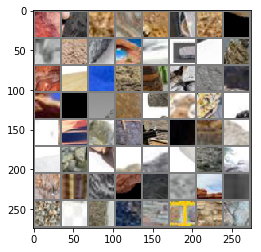

142
tensor([5, 3, 2, 4, 3, 5, 5, 3, 4, 2, 4, 6, 4, 2, 5, 3, 0, 2, 5, 4, 6, 1, 2, 2,
        0, 2, 2, 5, 6, 0, 0, 0, 6, 3, 0, 4, 6, 5, 4, 4, 0, 3, 2, 5, 6, 4, 6, 0,
        6, 0, 0, 6, 3, 0, 2, 0, 2, 3, 5, 0, 5, 0, 2, 1])
(64, 3, 32, 32)
('5_2430.jpg', '3_389.jpg', '2_2119.jpg', '4_1893.jpg', '3_1362.jpg', '5_469.jpg', '5_2424.jpg', '3_1376.jpg', '4_3048.jpg', '2_1404.jpg', '4_2356.jpg', '6_1209.jpeg', '4_2430.jpg', '2_1362.jpg', '5_1893.jpg', '3_1410.jpg', '0_538.jpg', '2_830.jpg', '5_2342.jpg', '4_1139.jpg', '6_227.jpg', '1_918.jpg', '2_2858.jpg', '2_603.jpg', '0_3532.jpg', '2_2680.jpg', '2_1389.jpg', '5_1878.jpg', '6_2477.jpg', '0_81.jpg', '0_1325.jpg', '0_1443.jpg', '6_2311.jpg', '3_1148.png', '0_3254.jpg', '4_849.jpg', '6_1618.jpg', '5_482.jpg', '4_691.jpg', '4_1878.jpg', '0_3240.jpg', '3_1389.jpg', '2_171.jpg', '5_496.jpg', '6_555.jpg', '4_685.jpg', '6_2305.jpg', '0_95.jpg', '6_2463.jpg', '0_1331.jpg', '0_2638.jpg', '6_233.jpg', '3_1586.JPEG', '0_4249.jpg', '2_617.jpg', '0_3526.jp

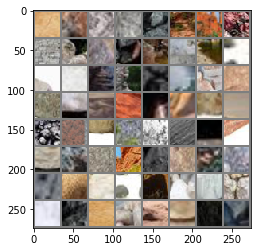

143
tensor([6, 0, 0, 4, 4, 6, 2, 6, 0, 4, 0, 4, 6, 4, 6, 4, 0, 6, 4, 0, 5, 0, 2, 0,
        6, 3, 5, 5, 0, 0, 4, 6, 5, 6, 4, 5, 5, 0, 6, 1, 2, 5, 6, 0, 1, 3, 2, 5,
        6, 0, 5, 4, 0, 4, 0, 2, 4, 0, 0, 4, 6, 6, 0, 4])
(64, 3, 32, 32)
('6_1142.jpg', '0_4261.jpg', '0_3268.jpg', '4_1850.jpg', '4_875.jpg', '6_1624.jpg', '2_159.jpg', '6_3058.jpeg', '0_289.jpg', '4_1688.jpg', '0_2176.jpg', '4_2381.jpg', '6_3033.jpg', '4_2395.jpg', '6_2339.jpg', '4_1844.jpg', '0_4513.jpg', '6_1630.jpg', '4_861.jpg', '0_2162.jpg', '5_2381.jpg', '0_2604.jpg', '2_2870.jpg', '0_4275.jpg', '6_1156.jpg', '3_438.jpg', '5_1850.jpg', '5_1688.jpg', '0_2163.jpg', '0_4512.jpg', '4_860.jpg', '6_1631.jpg', '5_1058.webp', '6_2338.jpg', '4_2394.jpg', '5_1689.jpg', '5_1851.jpg', '0_4274.jpg', '6_1157.jpg', '1_931.jpg', '2_2871.jpg', '5_2380.jpg', '6_1143.jpg', '0_4260.jpg', '1_925.jpg', '3_409.jpeg', '2_2865.jpg', '5_2394.jpg', '6_2847.png', '0_1318.jpg', '5_1845.jpg', '4_2380.jpg', '0_2177.jpg', '4_1689.jpg', '0_288.jpg',

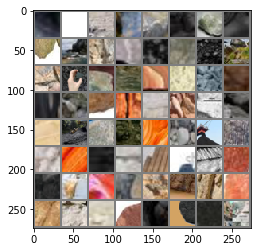

144
tensor([6, 5, 3, 3, 4, 0, 3, 2, 0, 0, 2, 6, 0, 6, 0, 6, 5, 0, 6, 2, 2, 0, 2, 2,
        1, 6, 4, 5, 2, 4, 0, 0, 4, 2, 3, 4, 3, 4, 5, 5, 4, 2, 5, 3, 0, 6, 5, 2,
        3, 4, 6, 5, 2, 0, 4, 5, 2, 4, 5, 3, 6, 3, 4, 2])
(64, 3, 32, 32)
('6_554.jpg', '5_497.jpg', '3_1388.jpg', '3_363.jpg', '4_1879.jpg', '0_3241.jpg', '3_405.jpg', '2_2695.jpg', '0_3527.jpg', '0_4248.jpg', '2_616.jpg', '6_232.jpg', '0_1330.jpg', '6_2462.jpg', '0_94.jpg', '6_702.jpeg', '5_1879.jpg', '0_80.jpg', '6_2476.jpg', '2_1388.jpg', '2_2681.jpg', '0_3533.jpg', '2_602.jpg', '2_2859.jpg', '1_919.jpg', '6_226.jpg', '4_690.jpg', '5_483.jpg', '2_164.jpg', '4_848.jpg', '0_3255.jpg', '0_1442.jpg', '4_2357.jpg', '2_1405.jpg', '3_149.png', '4_3049.jpg', '3_1377.jpg', '4_1886.jpg', '5_2425.jpg', '5_468.jpg', '4_1138.jpg', '2_831.jpg', '5_2343.jpg', '3_1411.jpg', '0_539.jpg', '6_1194.jpg', '5_1892.jpg', '2_1363.jpg', '3_1142.JPEG', '4_2431.jpg', '6_2489.jpg', '5_1886.jpg', '2_1377.jpg', '0_3719.png', '4_2425.jpg', '5_2357.jpg'

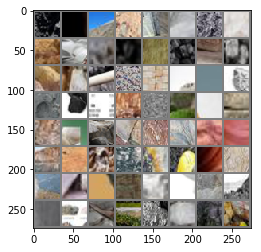

145
tensor([6, 4, 5, 2, 0, 2, 0, 6, 4, 5, 6, 5, 4, 5, 4, 5, 5, 4, 4, 2, 5, 0, 0, 5,
        4, 2, 5, 2, 0, 3, 0, 5, 4, 3, 0, 5, 4, 0, 2, 0, 4, 6, 6, 0, 5, 4, 5, 0,
        0, 6, 0, 4, 6, 0, 3, 4, 3, 5, 0, 5, 6, 5, 6, 0])
(64, 3, 32, 32)
('6_2632.jpeg', '4_2343.jpg', '5_1138.jpg', '2_1411.jpg', '0_263.jpg', '2_2130.jpg', '0_3282.jpg', '6_1816.jpg', '4_647.jpg', '5_2419.jpg', '6_597.jpg', '5_454.jpg', '4_1662.jpg', '5_1110.jpg', '4_3075.jpg', '5_1676.jpg', '5_332.jpg', '4_1104.jpg', '4_121.jpg', '2_2656.jpg', '5_3061.jpg', '0_2822.jpg', '0_505.jpg', '5_326.jpg', '4_1110.jpg', '2_819.jpg', '5_3075.jpg', '2_2642.jpg', '0_2836.jpg', '3_1439.jpg', '0_43.jpg', '5_1662.jpg', '4_2419.jpg', '3_1007.JPEG', '0_1481.jpg', '5_1104.jpg', '4_3061.jpg', '0_277.jpg', '2_2124.jpg', '0_3296.jpg', '4_653.jpg', '6_1802.jpg', '6_583.jpg', '0_2188.jpg', '5_440.jpg', '4_1676.jpg', '5_2182.jpg', '0_2407.jpg', '0_920.jpg', '6_1355.jpg', '0_4076.jpg', '4_2828.jpg', '6_2884.jpg', '0_1668.jpg', '3_1683.jpeg', '4_21

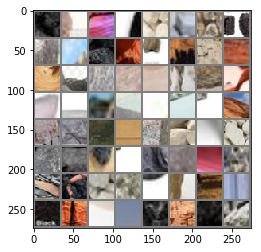

146
tensor([4, 2, 6, 6, 5, 0, 0, 0, 6, 5, 1, 4, 6, 3, 0, 2, 6, 0, 2, 3, 0, 2, 5, 5,
        1, 6, 4, 0, 5, 2, 6, 0, 2, 0, 0, 3, 5, 5, 2, 5, 1, 6, 4, 0, 2, 0, 3, 2,
        0, 4, 6, 0, 4, 5, 2, 6, 2, 1, 5, 2, 5, 4, 5, 3])
(64, 3, 32, 32)
('4_2182.jpg', '2_1808.jpg', '6_2648.jpg', '6_2890.jpg', '5_2196.jpg', '0_934.jpg', '0_2413.jpg', '0_4062.jpg', '6_1341.jpg', '5_3288.jpg', '1_702.png', '4_2814.jpg', '6_2660.jpg', '3_848.JPEG', '0_1132.jpg', '2_414.jpg', '6_1369.jpg', '0_3725.jpg', '2_2497.jpg', '3_607.jpg', '0_3043.jpg', '2_372.jpg', '5_2800.jpg', '5_695.jpg', '1_1126.jpg', '6_756.jpg', '4_486.jpg', '0_1654.jpg', '5_3177.webp', '2_1820.jpg', '6_2106.jpg', '0_1640.jpg', '2_1834.jpg', '0_1898.jpg', '0_3057.jpg', '3_175.jpg', '5_859.jpg', '5_2814.jpg', '2_366.jpg', '5_681.jpg', '1_1132.jpg', '6_742.jpg', '4_492.jpg', '0_908.jpg', '2_400.jpg', '0_3731.jpg', '3_613.jpg', '2_2483.jpg', '0_457.jpeg', '4_2800.jpg', '6_2674.jpg', '0_1126.jpg', '4_2633.jpg', '5_1448.jpg', '2_1161.jpg', '6_1396.

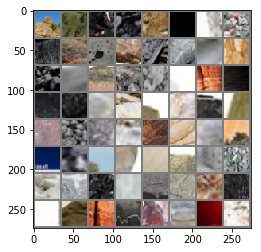

147
tensor([0, 2, 4, 0, 3, 2, 4, 5, 2, 3, 3, 5, 3, 5, 0, 4, 2, 0, 4, 1, 5, 2, 4, 4,
        5, 5, 5, 0, 4, 4, 5, 4, 0, 1, 2, 5, 3, 4, 5, 4, 2, 1, 0, 5, 2, 6, 5, 0,
        5, 0, 1, 4, 2, 5, 4, 5, 4, 5, 0, 6, 3, 6, 0, 4])
(64, 3, 32, 32)
('0_1873.jpg', '2_1607.jpg', '4_2155.jpg', '0_1867.jpg', '3_632.JPEG', '2_1613.jpg', '4_1448.jpg', '5_2633.jpg', '2_3004.jpg', '3_12.jpg', '3_1161.jpg', '5_2155.jpg', '3_834.jpg', '5_118.jpg', '0_3916.jpg', '4_2627.jpg', '2_1175.jpg', '0_4089.jpg', '4_33.jpg', '1_514.jpg', '5_3263.jpg', '2_2454.jpg', '4_323.jpg', '4_1306.jpg', '5_130.jpg', '5_1474.jpg', '5_1312.jpg', '0_1697.jpg', '4_2169.jpg', '4_1460.jpg', '5_656.jpg', '4_445.jpg', '0_3080.jpg', '1_272.jpg', '2_2332.jpg', '5_3505.jpg', '3_1149.jpg', '4_1474.jpg', '5_642.jpg', '4_451.jpg', '2_3038.jpg', '1_266.jpg', '0_3094.jpg', '5_3511.jpg', '2_2326.jpg', '6_959.jpg', '5_1306.jpg', '0_1683.jpg', '5_1460.jpg', '0_713.jpg', '1_500.jpg', '4_27.jpg', '2_2440.jpg', '5_3277.jpg', '4_337.jpg', '5_2169.jpg',

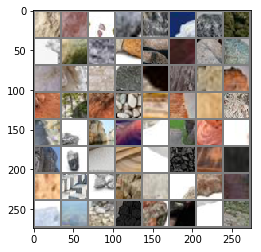

148
tensor([4, 2, 5, 5, 0, 5, 6, 5, 5, 0, 3, 5, 0, 0, 3, 4, 4, 0, 6, 2, 0, 3, 4, 0,
        0, 6, 4, 0, 0, 4, 0, 6, 1, 3, 5, 2, 0, 5, 6, 2, 0, 2, 6, 2, 6, 0, 6, 1,
        2, 5, 0, 2, 0, 2, 4, 0, 6, 3, 4, 2, 6, 4, 0, 5])
(64, 3, 32, 32)
('4_2804.webp', '2_1968.jpg', '5_1299.jpg', '5_2790.jpg', '0_2215.jpg', '5_2948.jpg', '6_1547.jpg', '5_905.jpg', '5_2784.jpg', '0_2201.jpg', '3_448.JPEG', '5_911.jpg', '0_3307.jpeg', '0_1708.jpg', '3_1695.JPEG', '4_2790.jpg', '4_2948.jpg', '0_3679.jpg', '6_1235.jpg', '2_548.jpg', '0_4116.jpg', '3_983.jpg', '4_1299.jpg', '0_2567.jpg', '0_840.jpg', '6_2714.jpg', '4_2960.jpg', '0_3651.jpg', '0_3889.jpg', '4_294.jpg', '0_2229.jpg', '6_622.jpg', '1_1052.jpg', '3_1380.JPEG', '5_2974.jpg', '2_206.jpg', '0_3137.jpg', '5_939.jpg', '6_2072.jpg', '2_1954.jpg', '0_1720.jpg', '2_1798.jpg', '6_2066.jpg', '2_1940.jpg', '6_743.jpeg', '0_1734.jpg', '6_636.jpg', '1_1046.jpg', '2_212.jpg', '5_2960.jpg', '0_3123.jpg', '2_2291.jpg', '0_3645.jpg', '2_574.jpg', '4_280.jpg', '

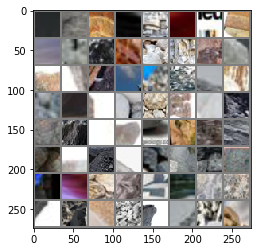

149
tensor([0, 6, 3, 6, 6, 0, 4, 4, 0, 2, 0, 4, 2, 0, 6, 6, 6, 5, 5, 4, 0, 5, 0, 3,
        2, 1, 2, 6, 5, 4, 1, 4, 3, 6, 5, 0, 1, 5, 2, 2, 5, 0, 5, 6, 6, 0, 1, 2,
        5, 0, 4, 4, 5, 1, 0, 3, 1, 5, 2, 4, 4, 5, 1, 2])
(64, 3, 32, 32)
('0_897.jpg', '6_1584.jpg', '3_1001.jpg', '6_3062.jpeg', '6_805.jpg', '0_129.jpg', '4_1528.jpg', '4_2021.jpg', '0_292.jpeg', '2_1773.jpg', '0_1907.jpg', '4_2035.jpg', '2_1767.jpg', '0_1913.jpg', '6_2099.jpg', '6_1590.jpg', '6_811.jpg', '5_3459.jpg', '5_2747.jpg', '4_519.jpg', '0_3862.jpg', '5_2021.jpg', '0_883.jpg', '3_798.jpg', '2_2508.jpg', '1_448.jpg', '2_1001.jpg', '6_2927.jpg', '5_1528.jpg', '4_2753.jpg', '1_17.jpg', '4_1272.jpg', '3_968.jpg', '6_187.jpg', '5_2009.jpg', '0_3692.jpg', '1_460.jpg', '5_3317.jpg', '2_2520.jpg', '2_1029.jpg', '5_1500.jpg', '0_1085.jpg', '5_1266.jpg', '6_36.jpg', '6_839.jpg', '0_115.jpg', '1_306.jpg', '2_2246.jpg', '5_3471.jpg', '0_1536.png', '4_531.jpg', '4_1514.jpg', '5_722.jpg', '1_1091.jpg', '0_101.jpg', '3_1029.jpg'

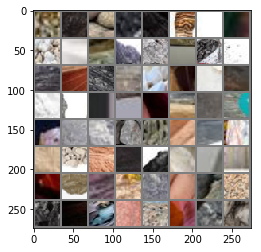

150
tensor([4, 5, 6, 3, 5, 0, 4, 6, 1, 0, 2, 5, 0, 0, 4, 6, 4, 3, 6, 0, 5, 3, 5, 3,
        4, 0, 2, 1, 2, 6, 0, 0, 2, 1, 2, 0, 6, 6, 3, 5, 4, 6, 4, 4, 6, 6, 5, 6,
        0, 6, 2, 0, 6, 4, 2, 6, 5, 6, 2, 5, 1, 2, 0, 0])
(64, 3, 32, 32)
('4_2009.jpg', '5_1272.jpg', '6_22.jpg', '3_571.png', '5_1514.jpg', '0_1091.jpg', '4_1266.jpg', '6_193.jpg', '1_474.jpg', '0_3686.jpg', '2_2534.jpg', '5_3303.jpg', '0_667.jpg', '0_3309.jpg', '4_1931.jpg', '6_1745.jpg', '4_914.jpg', '3_1292.jpeg', '6_1634.jpeg', '0_2017.jpg', '5_2592.jpg', '3_1015.png', '5_1925.jpg', '3_940.png', '4_2586.jpg', '0_2771.jpg', '2_986.jpg', '1_845.jpg', '2_2905.jpg', '6_1023.jpg', '0_4300.jpg', '0_2765.jpg', '2_992.jpg', '1_851.jpg', '2_2911.jpg', '0_4314.jpg', '6_1037.jpg', '6_2018.jpeg', '3_559.jpg', '5_1931.jpg', '4_2592.jpg', '6_2258.jpg', '4_1925.jpg', '4_900.jpg', '6_1751.jpg', '6_408.jpg', '5_2586.jpg', '6_1989.jpg', '0_2054.jpeg', '6_2270.jpg', '2_2087.jpg', '0_3335.jpg', '6_1779.jpg', '4_928.jpg', '2_91.jpg', '6_420

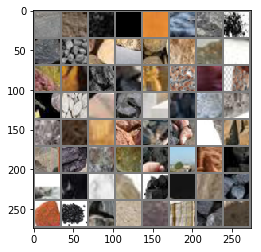

151
tensor([5, 6, 0, 0, 6, 5, 0, 2, 0, 3, 0, 4, 0, 2, 6, 6, 2, 4, 5, 1, 2, 3, 6, 3,
        5, 5, 5, 2, 6, 1, 4, 2, 4, 2, 6, 3, 0, 2, 5, 2, 1, 5, 5, 3, 3, 6, 2, 4,
        5, 2, 4, 6, 2, 1, 0, 0, 4, 0, 5, 4, 4, 0, 5, 0])
(64, 3, 32, 32)
('5_1919.jpg', '6_2516.jpg', '0_1244.jpg', '0_1250.jpg', '6_352.jpg', '5_291.jpg', '0_4328.jpg', '2_776.jpg', '0_2981.jpg', '3_565.jpg', '0_3447.jpg', '4_1919.jpg', '0_3321.jpg', '2_85.jpg', '6_434.jpg', '6_2264.jpg', '2_1571.jpg', '4_2223.jpg', '5_2551.jpg', '1_138.jpg', '2_3074.webp', '3_1203.jpg', '6_1786.jpg', '3_1565.jpg', '5_3129.jpg', '5_67.jpg', '5_2237.jpg', '2_945.jpg', '6_4.jpeg', '1_886.jpg', '4_2545.jpg', '2_1217.jpg', '4_2551.jpg', '2_1203.jpg', '6_3035.jpeg', '3_1571.jpg', '0_459.jpg', '2_789.jpg', '5_73.jpg', '2_951.jpg', '1_892.jpg', '5_508.jpg', '5_2545.jpg', '3_1217.jpg', '3_1504.JPEG', '6_1792.jpg', '2_1565.jpg', '4_2237.jpg', '5_520.jpg', '2_52.jpg', '4_733.jpg', '6_1962.jpg', '2_2044.jpg', '1_104.jpg', '0_4499.jpg', '0_317.jpg', '4

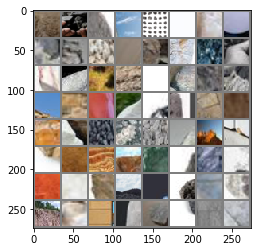

152
tensor([2, 5, 1, 0, 6, 5, 4, 0, 0, 5, 2, 0, 1, 6, 5, 4, 0, 5, 2, 5, 2, 5, 4, 6,
        4, 5, 2, 0, 2, 0, 1, 5, 5, 4, 3, 2, 4, 2, 5, 5, 0, 6, 5, 5, 2, 0, 5, 4,
        6, 0, 0, 2, 4, 3, 2, 0, 3, 5, 3, 5, 5, 1, 2, 0])
(64, 3, 32, 32)
('2_2722.jpg', '5_3115.jpg', '1_662.jpg', '0_3490.jpg', '6_385.jpg', '5_246.jpg', '4_1070.jpg', '0_2942.jpg', '0_465.jpg', '5_3101.jpg', '2_2736.jpg', '0_3484.jpg', '1_676.jpg', '6_391.jpg', '5_252.jpg', '4_1064.jpg', '0_1293.jpg', '5_1716.jpg', '2_1559.jpg', '5_1070.jpg', '2_46.jpg', '5_534.jpg', '4_1702.jpg', '6_1976.jpg', '4_727.jpg', '5_2579.jpg', '2_2050.jpg', '0_303.jpg', '2_2049.jpg', '0_878.jpeg', '1_109.jpg', '5_2560.jpg', '5_1069.jpg', '4_2212.jpg', '3_934.JPEG', '2_1226.jpg', '4_2574.jpg', '2_974.jpg', '5_2206.jpg', '5_56.jpg', '0_2783.jpg', '6_388.jpg', '5_3118.jpg', '5_2212.jpg', '2_960.jpg', '0_2797.jpg', '5_42.jpg', '4_1069.jpg', '6_2719.png', '0_468.jpg', '0_3489.jpg', '2_1232.jpg', '4_2560.jpg', '3_1710.JPEG', '2_1554.jpg', '0_4480.jpg'

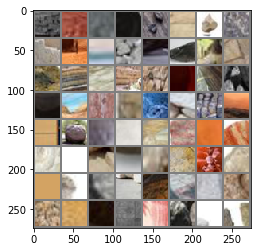

153
tensor([4, 2, 5, 4, 6, 2, 4, 5, 3, 0, 0, 2, 1, 5, 2, 4, 5, 4, 5, 4, 5, 0, 0, 2,
        1, 3, 2, 5, 1, 2, 4, 5, 2, 5, 4, 5, 1, 6, 2, 2, 0, 4, 0, 0, 6, 4, 0, 6,
        0, 3, 0, 5, 5, 2, 0, 0, 5, 5, 6, 0, 6, 5, 0, 2])
(64, 3, 32, 32)
('4_1727.jpg', '2_63.jpg', '5_511.jpg', '4_702.jpg', '6_1953.jpg', '2_948.jpg', '4_1041.jpg', '5_277.jpg', '3_1568.jpg', '0_2967.jpg', '0_440.jpg', '2_790.jpg', '1_653.jpg', '5_3124.jpg', '2_2713.jpg', '4_2548.jpg', '5_1733.jpg', '4_1641.webp', '5_1727.jpg', '4_1055.jpg', '5_263.jpg', '0_454.jpg', '0_2973.jpg', '2_784.jpg', '1_647.jpg', '3_597.jpg', '2_2707.jpg', '5_3130.jpg', '1_121.jpg', '2_2061.jpg', '4_1733.jpg', '5_505.jpg', '2_77.jpg', '5_2548.jpg', '4_716.jpg', '5_1041.jpg', '1_1063.png', '6_2296.jpg', '2_1568.jpg', '2_1583.jpg', '0_2026.jpg', '4_1900.jpg', '0_3338.jpg', '0_4457.jpg', '6_1774.jpg', '4_925.jpg', '0_4331.jpg', '6_1012.jpg', '0_2998.jpg', '3_1597.jpg', '0_2740.jpg', '5_95.jpg', '5_288.jpg', '2_2934.jpg', '0_3853.png', '0_1249.jpg', 

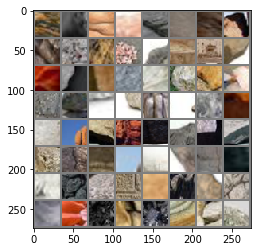

154
tensor([1, 2, 0, 6, 4, 4, 6, 0, 6, 2, 6, 6, 0, 3, 6, 4, 6, 5, 0, 0, 0, 6, 5, 0,
        2, 0, 6, 4, 1, 2, 0, 2, 0, 0, 1, 3, 6, 0, 3, 4, 0, 6, 6, 5, 0, 5, 6, 6,
        0, 4, 3, 3, 0, 3, 0, 5, 6, 0, 1, 4, 2, 2, 0, 4])
(64, 3, 32, 32)
('1_860.jpg', '2_88.jpg', '0_2032.jpg', '6_439.jpg', '4_1914.jpg', '4_931.jpg', '6_1760.jpg', '0_4443.jpg', '6_2269.jpg', '2_1597.jpg', '6_411.jpg', '6_1990.jpg', '0_3304.jpg', '3_226.jpg', '6_1748.jpg', '4_919.jpg', '6_2241.jpg', '5_1096.jpg', '0_1513.jpg', '0_3902.jpeg', '0_1275.jpg', '6_2527.jpg', '5_1928.jpg', '0_483.jpg', '2_753.jpg', '0_3462.jpg', '6_377.jpg', '4_1082.jpg', '1_848.jpg', '2_2908.jpg', '0_497.jpg', '2_747.jpg', '0_4319.jpg', '0_3476.jpg', '1_684.jpg', '3_554.jpg', '6_363.jpg', '0_2768.jpg', '3_1593.JPEG', '4_1096.jpg', '0_1261.jpg', '6_2533.jpg', '6_2255.jpg', '5_1082.jpg', '0_1507.jpg', '5_7.jpg', '6_405.jpg', '6_1984.jpg', '0_3310.jpg', '4_1928.jpg', '3_232.jpg', '3_1756.jpg', '0_3847.jpg', '3_965.jpg', '0_2581.jpg', '5_2004.jpg',

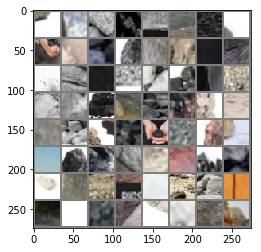

155
tensor([5, 4, 6, 0, 3, 4, 5, 1, 6, 5, 2, 6, 0, 4, 5, 6, 4, 1, 2, 1, 2, 3, 3, 0,
        5, 4, 5, 4, 2, 3, 2, 5, 1, 2, 0, 3, 4, 5, 4, 4, 5, 4, 5, 6, 6, 0, 5, 2,
        1, 6, 3, 6, 5, 6, 4, 6, 5, 4, 5, 4, 5, 3, 0, 2])
(64, 3, 32, 32)
('5_2762.jpg', '4_1519.jpg', '6_834.jpg', '0_118.jpg', '3_1030.jpg', '4_528.jpg', '5_2776.jpg', '1_1088.jpg', '6_820.jpg', '5_3468.jpg', '2_1756.jpg', '6_2467.jpeg', '0_1922.jpg', '4_2004.jpg', '5_1519.jpg', '6_2916.jpg', '4_2762.jpg', '1_874.png', '2_1030.jpg', '1_479.jpg', '2_2539.jpg', '3_1742.jpg', '3_971.jpg', '0_2595.jpg', '5_2010.jpg', '4_408.webp', '5_1531.jpg', '4_2992.jpg', '2_1018.jpg', '3_781.jpg', '2_2511.jpg', '5_3326.jpg', '1_451.jpg', '2_592.jpg', '0_642.jpg', '3_959.jpg', '4_1243.jpg', '5_2038.jpg', '4_266.jpg', '4_500.jpg', '5_713.jpg', '4_1525.jpg', '5_2986.jpg', '6_1589.jpg', '6_808.jpg', '0_124.jpg', '5_3440.jpg', '2_2277.jpg', '1_337.jpg', '6_2080.jpg', '3_826.JPEG', '6_691.jpeg', '5_1257.jpg', '6_2094.jpg', '4_2038.jpg', '6_13.jpg

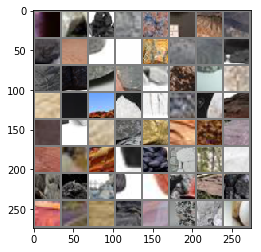

156
tensor([5, 1, 5, 2, 1, 0, 4, 4, 5, 4, 0, 6, 0, 0, 0, 6, 5, 2, 5, 2, 2, 0, 3, 6,
        5, 0, 0, 0, 0, 0, 0, 0, 2, 4, 4, 6, 0, 0, 1, 0, 6, 4, 0, 6, 4, 2, 3, 0,
        5, 6, 5, 5, 5, 0, 5, 5, 5, 6, 1, 2, 5, 6, 6, 4])
(64, 3, 32, 32)
('5_3454.jpg', '1_323.jpg', '5_3332.jpg', '2_2505.jpg', '1_445.jpg', '0_656.jpg', '4_1257.jpg', '4_272.jpg', '5_1525.jpg', '4_2986.jpg', '0_3884.jpg', '6_149.jpg', '0_2542.jpg', '0_865.jpg', '0_4133.jpg', '6_1576.jpg', '5_2979.jpg', '2_2288.jpg', '5_934.jpg', '2_1959.jpg', '2_1781.jpg', '0_1739.jpg', '3_1232.png', '6_1562.jpg', '5_920.jpg', '0_2230.jpg', '0_4286.jpeg', '0_3890.jpg', '0_871.jpg', '0_2556.jpg', '0_3648.jpg', '0_4127.jpg', '2_579.jpg', '4_2979.jpg', '4_1280.jpg', '6_175.jpg', '0_859.jpg', '0_3660.jpg', '1_492.jpg', '0_681.jpg', '6_2725.jpg', '4_2951.jpg', '0_1077.jpg', '6_1532.jpeg', '4_2789.jpg', '2_1965.jpg', '3_719.JPEG', '0_1711.jpg', '5_1294.jpg', '6_2043.jpg', '5_2945.jpg', '5_3483.jpg', '5_908.jpg', '0_2218.jpg', '5_2951.jpg', '5_34

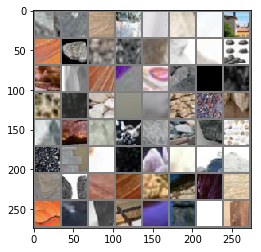

157
tensor([6, 3, 1, 0, 6, 0, 5, 0, 3, 0, 1, 2, 2, 4, 5, 6, 4, 3, 2, 5, 5, 3, 6, 3,
        6, 0, 4, 5, 2, 0, 5, 6, 3, 4, 0, 2, 5, 3, 4, 0, 3, 2, 2, 4, 6, 5, 0, 5,
        3, 0, 6, 5, 4, 5, 4, 0, 2, 5, 1, 5, 2, 1, 2, 3])
(64, 3, 32, 32)
('6_161.jpg', '3_756.jpg', '1_486.jpg', '0_3674.jpg', '6_1238.jpg', '0_695.jpg', '5_2170.jpg', '0_3933.jpg', '3_811.jpg', '0_4084.jpg', '1_519.jpg', '2_2459.jpg', '2_1150.jpg', '4_2602.jpg', '5_1479.jpg', '6_2876.jpg', '4_2164.jpg', '3_1391.png', '2_1636.jpg', '5_3508.jpg', '5_883.jpg', '3_1144.jpg', '6_940.jpg', '3_37.jpg', '6_798.jpg', '0_2393.jpg', '4_448.jpg', '5_2616.jpg', '2_3021.jpg', '0_3099.jpg', '5_897.jpg', '6_954.jpg', '3_23.jpg', '4_1479.jpg', '0_2387.jpg', '2_3035.jpg', '5_2602.jpg', '3_1751.jpeg', '4_2170.jpg', '0_1856.jpg', '3_1385.png', '2_1622.jpg', '2_1144.jpg', '4_2616.jpg', '6_2862.jpg', '5_2164.jpg', '0_3927.jpg', '5_129.jpg', '3_1636.jpg', '0_4090.jpg', '6_2692.jpg', '5_1445.jpg', '4_312.jpg', '5_101.jpg', '4_1337.jpg', '0_736.jpg

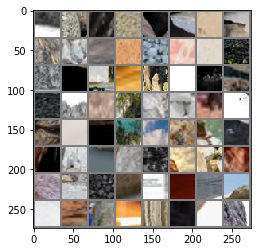

158
tensor([5, 4, 4, 5, 4, 5, 0, 2, 5, 1, 2, 6, 5, 4, 2, 4, 5, 4, 5, 4, 0, 5, 2, 4,
        1, 2, 6, 5, 2, 4, 0, 6, 0, 0, 0, 5, 5, 3, 6, 0, 0, 2, 6, 6, 5, 0, 0, 0,
        2, 6, 6, 6, 2, 3, 5, 0, 1, 0, 6, 5, 4, 6, 0, 2])
(64, 3, 32, 32)
('5_667.jpg', '4_1451.jpg', '4_474.jpg', '5_1323.jpg', '4_2158.jpg', '5_1337.jpg', '0_291.png', '2_2317.jpg', '5_3520.jpg', '1_257.jpg', '2_394.jpg', '6_968.jpg', '5_673.jpg', '4_1445.jpg', '2_3009.jpg', '4_460.jpg', '5_2158.jpg', '4_306.jpg', '5_115.jpg', '4_1323.jpg', '0_722.jpg', '5_3246.jpg', '2_2471.jpg', '4_16.jpg', '1_531.jpg', '2_1178.jpg', '6_2686.jpg', '5_1451.jpg', '2_1193.jpg', '4_2819.jpg', '0_4047.jpg', '6_1364.jpg', '0_3728.jpg', '0_911.jpg', '0_2436.jpg', '5_698.jpg', '5_840.jpg', '3_1187.jpg', '6_1402.jpg', '0_1881.jpg', '0_1659.jpg', '2_1839.jpg', '6_997.jpg', '6_1416.jpg', '5_2819.jpg', '0_4053.jpg', '0_2422.jpg', '0_905.jpg', '2_1187.jpg', '6_2679.jpg', '6_2484.png', '6_1358.jpg', '2_425.jpg', '3_636.jpg', '5_3291.jpg', '0_3714.jpg',

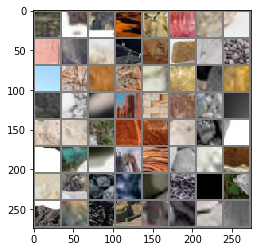

159
tensor([1, 4, 3, 0, 1, 5, 2, 1, 4, 0, 6, 3, 5, 1, 2, 5, 6, 0, 5, 0, 5, 4, 6, 2,
        5, 3, 0, 0, 5, 0, 5, 3, 2, 4, 3, 4, 0, 4, 2, 0, 2, 4, 5, 2, 5, 0, 3, 2,
        2, 4, 5, 4, 2, 2, 4, 5, 5, 0, 4, 2, 2, 4, 5, 5])
(64, 3, 32, 32)
('1_1117.jpg', '4_1492.jpg', '3_150.jpg', '0_3072.jpg', '1_280.jpg', '5_2831.jpg', '2_343.jpg', '1_1103.jpg', '4_1486.jpg', '0_2378.jpg', '6_773.jpg', '3_144.jpg', '5_868.jpg', '1_294.jpg', '2_357.jpg', '5_2825.jpg', '6_2123.jpg', '0_1671.jpg', '5_2088.webp', '0_1117.jpg', '5_1492.jpg', '4_2831.jpg', '6_2645.jpg', '2_431.jpg', '5_3285.jpg', '3_622.jpg', '0_3700.jpg', '0_939.jpg', '5_2414.jpg', '0_2191.jpg', '5_459.jpg', '3_1346.jpg', '2_1434.jpg', '4_3078.jpg', '3_1193.png', '4_2366.jpg', '0_1498.jpg', '4_2400.jpg', '2_1352.jpg', '0_508.jpg', '2_2883.jpg', '4_1109.jpg', '5_2372.jpg', '2_800.jpg', '5_3078.jpg', '0_4292.jpg', '3_1434.jpg', '2_2897.jpg', '2_814.jpg', '4_138.jpg', '5_2366.jpg', '4_2414.jpg', '2_1346.jpg', '2_1420.jpg', '4_2372.jpg', '5_1109

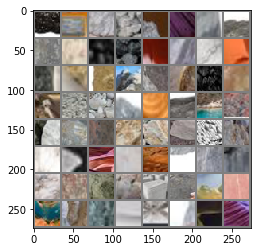

160
tensor([4, 5, 2, 3, 2, 1, 5, 2, 0, 4, 5, 4, 5, 6, 5, 2, 4, 1, 2, 5, 3, 0, 0, 4,
        5, 2, 4, 4, 6, 4, 5, 2, 2, 4, 5, 6, 3, 6, 4, 6, 0, 4, 0, 6, 2, 1, 0, 2,
        3, 6, 0, 5, 2, 3, 5, 6, 2, 0, 2, 1, 0, 0, 0, 6])
(64, 3, 32, 32)
('4_676.jpg', '5_465.jpg', '2_182.jpg', '3_391.jpg', '2_2101.jpg', '1_727.jpg', '5_3050.jpg', '2_2667.jpg', '0_534.jpg', '4_1135.jpg', '5_303.jpg', '4_110.jpg', '5_1647.jpg', '6_2490.jpg', '5_1653.jpg', '2_2522.webp', '4_2428.jpg', '1_733.jpg', '2_2673.jpg', '5_3044.jpg', '3_1408.jpg', '0_2807.jpg', '0_520.jpg', '4_1121.jpg', '5_317.jpg', '2_828.jpg', '4_104.jpg', '4_662.jpg', '6_1833.jpg', '4_1647.jpg', '5_471.jpg', '2_196.jpg', '2_2115.jpg', '4_3050.jpg', '5_1135.jpg', '6_3017.jpg', '3_1150.png', '6_2309.jpg', '4_851.jpg', '6_1600.jpg', '0_4523.jpg', '4_689.jpg', '0_2152.jpg', '6_559.jpg', '2_2840.jpg', '1_900.jpg', '0_2634.jpg', '2_2698.jpg', '3_408.jpg', '6_1166.jpg', '0_4245.jpg', '5_1860.jpg', '2_1391.jpg', '3_1622.png', '5_1874.jpg', '6_1436.jpeg

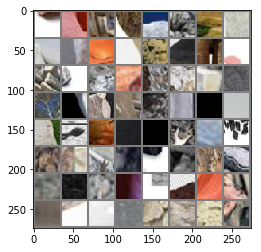

161
tensor([2, 4, 4, 0, 0, 2, 0, 4, 3, 6, 4, 4, 0, 6, 4, 6, 5, 0, 6, 3, 6, 0, 3, 0,
        5, 2, 0, 1, 2, 6, 5, 0, 3, 5, 2, 6, 5, 5, 0, 0, 6, 4, 0, 2, 6, 4, 0, 3,
        6, 4, 0, 5, 6, 5, 3, 0, 5, 6, 2, 1, 4, 6, 0, 4])
(64, 3, 32, 32)
('2_169.jpg', '4_845.jpg', '4_1860.jpg', '0_3258.jpg', '0_2146.jpg', '2_141.jpg', '0_3270.jpg', '4_1848.jpg', '3_352.jpg', '6_565.jpg', '4_1690.jpg', '4_2399.jpg', '0_1467.jpg', '6_2335.jpg', '4_3087.jpg', '6_2453.jpg', '5_1684.jpg', '0_1301.jpg', '6_1123.jpeg', '3_1.jpg', '6_203.jpg', '0_2608.jpg', '3_1585.JPEG', '0_3516.jpg', '5_3093.jpg', '2_627.jpg', '0_4279.jpg', '1_928.jpg', '2_2868.jpg', '6_217.jpg', '5_2399.jpg', '0_3502.jpg', '3_420.jpg', '5_3087.jpg', '2_633.jpg', '6_2447.jpg', '5_1848.jpg', '5_1690.jpg', '0_1315.jpg', '0_1473.jpg', '6_2321.jpg', '4_3093.jpg', '0_285.jpg', '2_155.jpg', '6_1628.jpg', '4_879.jpg', '0_3264.jpg', '3_346.jpg', '6_571.jpg', '4_1684.jpg', '0_1314.jpg', '5_1691.jpg', '6_2446.jpg', '5_1849.jpg', '3_421.jpg', '0_3503.jp

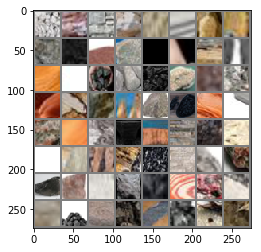

162
tensor([6, 2, 4, 6, 0, 4, 6, 6, 0, 4, 4, 0, 4, 2, 0, 2, 0, 5, 3, 0, 0, 6, 0, 5,
        6, 5, 0, 6, 0, 6, 2, 6, 0, 2, 5, 6, 0, 4, 0, 3, 0, 4, 2, 6, 6, 0, 4, 4,
        3, 6, 4, 6, 6, 2, 5, 0, 6, 0, 2, 0, 1, 2, 4, 5])
(64, 3, 32, 32)
('6_1629.jpg', '2_154.jpg', '4_3092.jpg', '6_2320.jpg', '0_1472.jpg', '4_3086.jpg', '6_1334.jpeg', '6_2334.jpg', '0_1466.jpg', '4_2398.jpg', '4_1691.jpg', '0_3271.jpg', '4_1849.jpg', '2_140.jpg', '0_290.jpg', '2_626.jpg', '0_4278.jpg', '5_3092.jpg', '3_435.jpg', '0_3517.jpg', '0_2609.jpg', '6_202.jpg', '0_1300.jpg', '5_1685.jpg', '6_2452.jpg', '5_577.webp', '0_4250.jpg', '6_1173.jpg', '0_2621.jpg', '6_2877.png', '2_2855.jpg', '6_1271.jpeg', '0_1328.jpg', '2_1384.jpg', '5_1875.jpg', '6_3002.jpg', '0_2147.jpg', '4_1861.jpg', '0_3259.jpg', '3_1390.jpg', '0_4536.jpg', '4_844.jpg', '2_168.jpg', '6_1615.jpg', '6_558.jpg', '0_2153.jpg', '4_688.jpg', '4_1875.jpg', '3_1384.jpg', '6_1601.jpg', '4_850.jpg', '6_2308.jpg', '6_3016.jpg', '2_1390.jpg', '5_1861.jpg', '

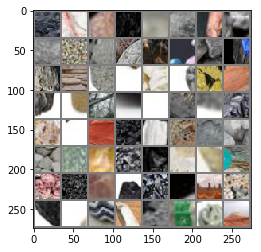

163
tensor([4, 0, 0, 2, 5, 6, 0, 4, 1, 5, 3, 5, 6, 3, 4, 2, 2, 0, 5, 4, 6, 4, 3, 2,
        2, 5, 4, 5, 4, 6, 5, 4, 2, 0, 5, 4, 5, 4, 0, 0, 5, 2, 2, 4, 4, 2, 5, 2,
        3, 0, 5, 2, 4, 0, 5, 5, 4, 2, 4, 4, 2, 3, 4, 3])
(64, 3, 32, 32)
('4_1120.jpg', '0_521.jpg', '0_2806.jpg', '2_2672.jpg', '5_3045.jpg', '6_2485.jpg', '0_73.jpg', '4_2429.jpg', '1_2.png', '5_1652.jpg', '3_1004.JPEG', '5_1134.jpg', '6_994.jpeg', '3_723.JPEG', '4_3051.jpg', '2_2114.jpg', '2_197.jpg', '0_247.jpg', '5_470.jpg', '4_1646.jpg', '6_1832.jpg', '4_663.jpg', '3_390.jpg', '2_2100.jpg', '2_183.jpg', '5_464.jpg', '4_1652.jpg', '5_2429.jpg', '4_677.jpg', '6_1826.jpg', '5_1120.jpg', '4_3045.jpg', '2_1409.jpg', '0_67.jpg', '5_1646.jpg', '4_111.jpg', '5_302.jpg', '4_1134.jpg', '0_2812.jpg', '0_535.jpg', '5_3051.jpg', '2_2666.jpg', '2_1347.jpg', '4_2415.jpg', '4_139.jpg', '2_815.jpg', '5_2367.jpg', '2_2896.jpg', '3_1435.jpg', '0_4293.jpg', '5_3079.jpg', '2_2128.jpg', '4_887.jpg', '0_2184.jpg', '5_2401.jpg', '5_1108.jpg',

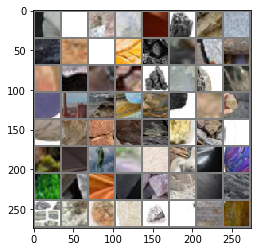

164
tensor([5, 0, 5, 5, 2, 4, 2, 2, 0, 6, 0, 2, 4, 2, 6, 2, 5, 0, 1, 5, 3, 0, 4, 1,
        0, 0, 5, 3, 2, 6, 4, 5, 0, 6, 3, 1, 4, 6, 5, 0, 0, 5, 2, 6, 5, 1, 0, 6,
        4, 1, 2, 0, 6, 5, 6, 5, 2, 0, 6, 6, 2, 0, 0, 6])
(64, 3, 32, 32)
('5_458.jpg', '0_2190.jpg', '5_2415.jpg', '5_2373.jpg', '2_801.jpg', '4_1108.jpg', '2_2882.jpg', '2_2670.webp', '0_509.jpg', '6_3020.jpeg', '0_4287.jpg', '2_1353.jpg', '4_2401.jpg', '2_1804.jpg', '6_2122.jpg', '2_356.jpg', '5_2824.jpg', '0_3067.jpg', '1_295.jpg', '5_869.jpg', '3_145.jpg', '0_2379.jpg', '4_1487.jpg', '1_1102.jpg', '0_938.jpg', '0_3701.jpg', '5_3284.jpg', '3_623.jpg', '2_430.jpg', '6_1198.png', '4_2830.jpg', '5_1493.jpg', '0_1116.jpg', '6_2650.jpg', '3_1409.png', '1_732.png', '4_2824.jpg', '6_2888.jpg', '5_1487.jpg', '0_1102.jpg', '0_3715.jpg', '5_3290.jpg', '2_424.jpg', '6_1359.jpg', '5_2830.jpg', '1_281.jpg', '0_3073.jpg', '6_766.jpg', '4_1493.jpg', '1_1116.jpg', '2_1810.jpg', '0_1664.jpg', '6_2136.jpg', '5_2818.jpg', '6_996.jpg', '5_85

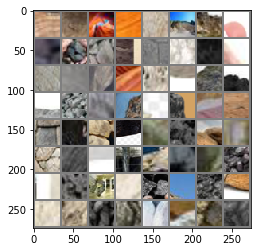

165
tensor([0, 0, 0, 0, 0, 6, 2, 4, 2, 0, 3, 0, 6, 6, 3, 5, 5, 2, 4, 4, 5, 6, 2, 1,
        2, 5, 5, 5, 6, 2, 4, 5, 2, 0, 4, 5, 5, 4, 1, 2, 5, 0, 4, 6, 5, 4, 5, 6,
        4, 5, 6, 4, 4, 5, 3, 3, 2, 5, 2, 3, 2, 0, 2, 5])
(64, 3, 32, 32)
('0_4052.jpg', '0_2437.jpg', '0_910.jpg', '0_3729.jpg', '0_4046.jpg', '6_1365.jpg', '2_418.jpg', '4_2818.jpg', '2_1192.jpg', '0_1658.jpg', '3_1680.JPEG', '0_1880.jpg', '6_1403.jpg', '6_982.jpg', '3_1186.jpg', '5_841.jpg', '5_699.jpg', '2_3008.jpg', '4_461.jpg', '4_1444.jpg', '5_672.jpg', '6_969.jpg', '2_395.jpg', '1_256.jpg', '2_2316.jpg', '5_3521.jpg', '5_1336.jpg', '5_1450.jpg', '6_2687.jpg', '2_1179.jpg', '4_17.jpg', '5_3247.jpg', '2_2470.jpg', '0_723.jpg', '4_1322.jpg', '5_114.jpg', '5_2159.jpg', '4_307.jpg', '1_524.jpg', '2_2464.jpg', '5_3253.jpg', '0_737.jpg', '4_1336.jpg', '6_3132.jpeg', '5_100.jpg', '4_313.jpg', '5_1444.jpg', '6_2693.jpg', '4_2159.jpg', '5_1322.jpg', '6_3098.jpeg', '4_475.jpg', '4_1450.jpg', '5_666.jpg', '3_1403.JPEG', '3_1179.j

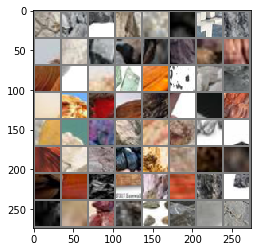

166
tensor([0, 4, 3, 6, 3, 5, 0, 0, 5, 0, 5, 6, 4, 2, 5, 1, 4, 2, 2, 1, 0, 3, 0, 6,
        5, 4, 5, 2, 6, 5, 5, 2, 4, 6, 5, 0, 2, 1, 6, 5, 0, 5, 5, 2, 0, 6, 0, 1,
        3, 6, 4, 4, 6, 3, 4, 0, 4, 6, 6, 0, 2, 1, 0, 3])
(64, 3, 32, 32)
('0_2386.jpg', '4_1478.jpg', '3_22.jpg', '6_955.jpg', '3_1151.jpg', '5_896.jpg', '0_3098.jpg', '0_4091.jpg', '5_128.jpg', '0_3926.jpg', '5_2165.jpg', '6_2863.jpg', '4_2617.jpg', '2_1145.jpg', '5_1478.jpg', '1_915.png', '4_2603.jpg', '2_1151.jpg', '2_2458.jpg', '1_518.jpg', '0_4085.jpg', '3_1623.jpg', '0_3932.jpg', '6_1949.jpeg', '5_2171.jpg', '4_449.jpg', '5_2617.jpg', '2_3020.jpg', '6_799.jpg', '5_3509.jpg', '5_882.jpg', '2_1637.jpg', '4_2165.jpg', '6_2056.jpg', '5_1281.jpg', '0_1704.jpg', '2_1970.jpg', '1_1076.jpg', '6_606.jpg', '5_2788.jpg', '0_3113.jpg', '5_3496.jpg', '5_2950.jpg', '2_222.jpg', '0_694.jpg', '6_1239.jpg', '0_3675.jpg', '1_487.jpg', '3_757.jpg', '6_160.jpg', '4_1295.jpg', '4_2944.jpg', '6_2730.jpg', '3_1569.png', '4_2788.jpg', '0_1076

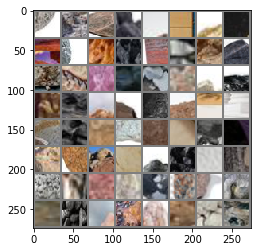

167
tensor([0, 6, 4, 6, 0, 0, 5, 5, 2, 5, 6, 5, 0, 2, 0, 0, 5, 6, 2, 4, 0, 6, 2, 0,
        0, 0, 0, 6, 0, 4, 0, 6, 2, 2, 0, 5, 0, 5, 5, 3, 0, 5, 4, 5, 3, 4, 5, 6,
        4, 4, 5, 4, 4, 0, 2, 5, 2, 5, 4, 4, 3, 0, 2, 5])
(64, 3, 32, 32)
('0_858.jpg', '6_174.jpg', '4_1281.jpg', '6_612.jpg', '0_2219.jpg', '0_3107.jpg', '5_3482.jpg', '5_909.jpg', '2_236.jpg', '5_2944.jpg', '6_2042.jpg', '5_1295.jpg', '0_1710.jpg', '2_1964.jpg', '0_3611.jpeg', '0_2231.jpg', '5_921.jpg', '6_1563.jpg', '2_1794.jpg', '4_2978.jpg', '0_4126.jpg', '6_1205.jpg', '2_578.jpg', '0_3649.jpg', '0_2557.jpg', '0_870.jpg', '0_3891.jpg', '6_1211.jpg', '0_4132.jpg', '4_298.jpg', '0_3885.jpg', '6_2718.jpg', '2_1780.jpg', '2_1958.jpg', '0_2225.jpg', '5_935.jpg', '0_854.jpeg', '5_2978.jpg', '5_3455.jpg', '3_1019.jpg', '0_131.jpg', '5_2993.jpg', '4_1530.jpg', '5_706.jpg', '3_1415.JPEG', '4_515.jpg', '5_1242.jpg', '6_12.jpg', '4_2039.jpg', '4_2987.jpg', '5_1524.jpg', '4_273.jpg', '4_1256.jpg', '0_657.jpg', '2_587.jpg', '5_3333.

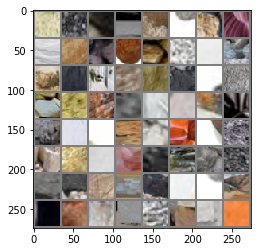

168
tensor([2, 4, 0, 0, 5, 5, 6, 1, 5, 2, 0, 6, 5, 6, 4, 5, 4, 4, 2, 5, 3, 6, 1, 4,
        5, 5, 0, 0, 6, 3, 2, 1, 2, 3, 4, 1, 5, 6, 2, 4, 0, 6, 5, 0, 0, 0, 6, 3,
        4, 5, 4, 0, 0, 2, 6, 1, 4, 0, 6, 3, 1, 0, 2, 0])
(64, 3, 32, 32)
('2_1019.jpg', '4_2993.jpg', '0_4318.png', '0_2796.jpeg', '5_1530.jpg', '5_1256.jpg', '6_2081.jpg', '1_336.jpg', '5_3441.jpg', '2_2276.jpg', '0_125.jpg', '6_809.jpg', '5_2987.jpg', '6_1588.jpg', '4_1524.jpg', '5_712.jpg', '4_501.jpg', '4_2005.jpg', '2_1757.jpg', '5_3469.jpg', '3_1025.jpg', '6_821.jpg', '1_1089.jpg', '4_529.jpg', '5_2777.jpg', '5_2011.jpg', '0_2594.jpg', '0_3852.jpg', '6_469.jpeg', '3_1743.jpg', '2_2538.jpg', '1_478.jpg', '2_1031.jpg', '3_1596.png', '4_2763.jpg', '1_27.jpg', '5_1518.jpg', '6_2917.jpg', '2_1025.jpg', '4_2777.jpg', '0_1089.jpg', '6_2903.jpg', '5_2005.jpg', '0_2580.jpg', '0_3846.jpg', '0_119.jpg', '6_835.jpg', '3_1031.jpg', '4_1518.jpg', '5_2763.jpg', '4_2011.jpg', '0_1937.jpg', '0_4442.png', '2_1743.jpg', '6_2532.jpg', '1_

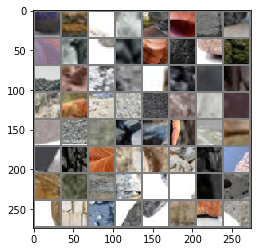

169
tensor([4, 6, 6, 5, 0, 5, 6, 0, 5, 6, 4, 6, 3, 0, 6, 2, 4, 1, 6, 3, 0, 1, 2, 6,
        5, 0, 1, 2, 5, 6, 0, 5, 3, 2, 6, 4, 4, 6, 0, 2, 0, 0, 6, 4, 0, 3, 2, 5,
        1, 5, 2, 4, 0, 5, 0, 6, 2, 5, 1, 2, 0, 5, 4, 5])
(64, 3, 32, 32)
('4_1929.jpg', '6_1985.jpg', '6_404.jpg', '5_6.jpg', '0_1506.jpg', '5_1083.jpg', '6_2254.jpg', '0_1512.jpg', '5_1097.jpg', '6_2240.jpg', '4_918.jpg', '6_1749.jpg', '3_227.jpg', '0_3305.jpg', '6_1991.jpg', '2_2909.jpg', '4_1083.jpg', '1_849.jpg', '6_376.jpg', '3_541.jpg', '0_3463.jpg', '1_691.jpg', '2_752.jpg', '6_2526.jpg', '5_1929.jpg', '0_1274.jpg', '1_861.jpg', '2_2921.jpg', '5_80.jpg', '6_1007.jpg', '0_4324.jpg', '5_1901.jpg', '3_964.png', '2_1596.jpg', '6_1761.jpg', '4_930.jpg', '4_1915.jpg', '6_438.jpg', '0_2033.jpg', '2_89.jpg', '0_1923.png', '0_4456.jpg', '6_1775.jpg', '4_1901.jpg', '0_2027.jpg', '3_1291.JPEG', '2_1582.jpg', '5_1915.jpg', '1_875.jpg', '5_289.jpg', '2_2935.jpg', '4_2503.webp', '0_2741.jpg', '5_94.jpg', '0_4330.jpg', '6_1013.jpg',

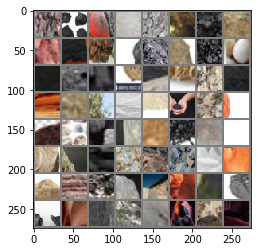

170
tensor([2, 1, 5, 5, 4, 6, 2, 5, 4, 0, 2, 1, 6, 4, 5, 2, 4, 0, 2, 1, 6, 5, 5, 4,
        5, 2, 1, 2, 0, 0, 5, 4, 2, 4, 2, 0, 0, 3, 4, 5, 5, 2, 5, 5, 3, 0, 3, 3,
        2, 4, 2, 4, 5, 5, 3, 0, 1, 2, 5, 3, 5, 6, 0, 2])
(64, 3, 32, 32)
('2_1569.jpg', '1_1062.png', '5_1040.jpg', '5_2549.jpg', '4_717.jpg', '6_1946.jpg', '2_76.jpg', '5_504.jpg', '4_1732.jpg', '0_333.jpg', '2_2060.jpg', '1_120.jpg', '6_1952.jpg', '4_703.jpg', '5_510.jpg', '2_62.jpg', '4_1726.jpg', '0_327.jpg', '2_2074.jpg', '1_134.jpg', '6_2283.jpg', '5_1054.jpg', '5_1732.jpg', '4_2549.jpg', '5_3125.jpg', '2_2712.jpg', '1_652.jpg', '2_791.jpg', '0_441.jpg', '0_2966.jpg', '5_276.jpg', '4_1040.jpg', '2_949.jpg', '4_2561.jpg', '2_1233.jpg', '0_3488.jpg', '0_469.jpg', '3_1541.jpg', '4_1068.jpg', '5_43.jpg', '5_2213.jpg', '2_961.jpg', '5_2575.jpg', '5_538.jpg', '3_1227.jpg', '0_4481.jpg', '3_1507.JPEG', '3_220.JPEG', '2_1555.jpg', '4_2207.jpg', '2_1541.jpg', '4_2213.jpg', '5_1068.jpg', '5_2561.jpg', '3_1233.jpg', '0_4495.jpg',

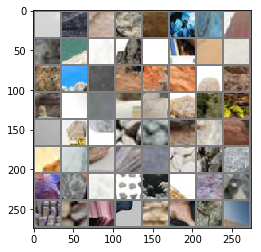

171
tensor([5, 4, 2, 4, 2, 3, 0, 4, 5, 5, 0, 2, 5, 2, 2, 4, 5, 2, 4, 0, 5, 5, 5, 0,
        3, 0, 4, 5, 4, 2, 3, 2, 1, 3, 0, 5, 2, 4, 6, 4, 5, 4, 1, 6, 3, 5, 5, 4,
        2, 0, 5, 2, 1, 5, 5, 5, 4, 1, 2, 0, 0, 3, 2, 5])
(64, 3, 32, 32)
('5_2207.jpg', '4_2575.jpg', '2_1227.jpg', '4_2205.jpg', '2_1557.jpg', '3_1225.jpg', '0_4483.jpg', '4_729.jpg', '5_2577.jpg', '5_41.jpg', '0_2794.jpg', '2_963.jpg', '5_2211.jpg', '2_2738.jpg', '2_1231.jpg', '4_2563.jpg', '5_1718.jpg', '2_1225.jpg', '4_2577.jpg', '0_2780.jpg', '5_55.jpg', '5_2205.jpg', '5_248.jpg', '0_2958.jpg', '3_1231.jpg', '0_4497.jpg', '4_1718.jpg', '5_2563.jpg', '4_2211.jpg', '2_1543.jpg', '3_1120.JPEG', '2_2062.jpg', '1_122.jpg', '3_1219.jpg', '0_331.jpg', '5_506.jpg', '2_74.jpg', '4_1730.jpg', '6_1944.jpg', '4_715.jpg', '5_1042.jpg', '4_2239.jpg', '1_1060.png', '6_2295.jpg', '3_741.png', '5_1724.jpg', '5_260.jpg', '4_1056.jpg', '2_787.jpg', '0_2970.jpg', '5_3133.jpg', '2_2704.jpg', '1_644.jpg', '5_2239.jpg', '5_69.jpg', '5_274.jpg

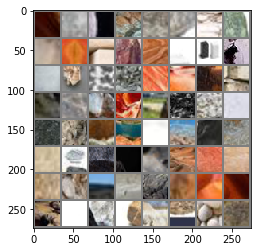

172
tensor([1, 2, 5, 5, 6, 2, 1, 6, 0, 2, 5, 4, 4, 6, 0, 4, 0, 4, 6, 2, 5, 2, 6, 0,
        0, 5, 6, 1, 2, 6, 0, 5, 0, 6, 1, 2, 1, 5, 6, 3, 2, 4, 2, 3, 6, 4, 6, 0,
        5, 5, 6, 5, 0, 6, 2, 0, 3, 0, 6, 4, 3, 6, 4, 0])
(64, 3, 32, 32)
('1_650.jpg', '2_1219.jpg', '5_1730.jpg', '5_1056.jpg', '6_2281.jpg', '2_2076.jpg', '1_136.jpg', '6_1788.jpg', '0_325.jpg', '2_60.jpg', '5_512.jpg', '4_1724.jpg', '4_701.jpg', '6_1950.jpg', '0_2031.jpg', '4_1917.jpg', '0_4440.jpg', '4_932.jpg', '6_1763.jpg', '2_1594.jpg', '5_1903.jpg', '2_778.jpg', '6_1005.jpg', '0_3449.jpg', '0_2757.jpg', '5_82.jpg', '6_2901.png', '1_863.jpg', '2_2923.jpg', '6_1011.jpg', '0_4332.jpg', '5_96.jpg', '0_2743.jpg', '6_348.jpg', '1_877.jpg', '2_2937.jpg', '1_25.png', '5_1917.jpg', '6_2518.jpg', '3_938.jpeg', '2_1580.jpg', '4_1903.jpg', '2_2089.jpg', '3_219.jpg', '6_1777.jpg', '4_926.jpg', '6_2256.jpg', '0_1504.jpg', '5_1081.jpg', '5_2588.jpg', '6_1987.jpg', '5_4.jpg', '0_3313.jpg', '6_1039.jpg', '2_744.jpg', '0_494.jpg', '3_

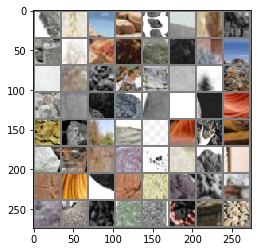

173
tensor([5, 6, 2, 0, 1, 0, 2, 6, 4, 6, 6, 0, 3, 0, 6, 0, 5, 6, 4, 3, 2, 0, 0, 3,
        4, 0, 5, 0, 5, 5, 6, 3, 2, 0, 4, 0, 4, 2, 6, 5, 5, 6, 2, 1, 5, 3, 3, 0,
        4, 5, 6, 0, 4, 2, 3, 2, 5, 0, 2, 4, 4, 6, 5, 1])
(64, 3, 32, 32)
('5_2753.webp', '6_2524.jpg', '2_750.jpg', '0_480.jpg', '1_693.jpg', '0_3461.jpg', '2_988.jpg', '6_374.jpg', '4_1081.jpg', '6_1993.jpg', '6_412.jpg', '0_2019.jpg', '3_225.jpg', '0_4468.jpg', '6_2242.jpg', '0_1510.jpg', '5_1095.jpg', '6_2915.jpg', '4_2761.jpg', '3_650.jpeg', '2_1033.jpg', '0_3688.jpg', '0_669.jpg', '3_1741.jpg', '4_1268.jpg', '0_3850.jpg', '5_2013.jpg', '0_2596.jpg', '5_2775.jpg', '5_738.jpg', '6_823.jpg', '3_1027.jpg', '2_1755.jpg', '0_4454.png', '4_2007.jpg', '0_1935.jpg', '4_2013.jpg', '2_1999.jpg', '6_38.jpg', '5_1268.jpg', '5_2761.jpg', '6_837.jpg', '2_2248.jpg', '1_308.jpg', '5_3319.jpg', '3_1755.jpg', '3_966.jpg', '0_3844.jpg', '4_259.jpg', '5_2007.jpg', '6_189.jpg', '0_2582.jpg', '4_2775.jpg', '2_1027.jpg', '3_796.jpg', '2_2506.j

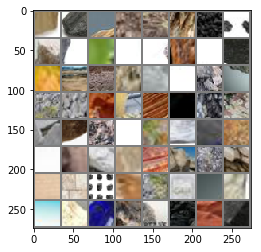

174
tensor([3, 4, 2, 5, 6, 5, 4, 4, 5, 0, 5, 1, 5, 2, 4, 5, 5, 1, 2, 5, 0, 3, 6, 3,
        5, 5, 4, 1, 4, 5, 2, 0, 2, 0, 4, 4, 0, 0, 0, 6, 0, 3, 2, 6, 6, 5, 6, 1,
        6, 2, 5, 0, 0, 6, 0, 3, 1, 0, 0, 0, 0, 0, 6, 6])
(64, 3, 32, 32)
('3_543.png', '4_2985.jpg', '2_1769.jpg', '5_1240.jpg', '6_10.jpg', '5_2749.jpg', '4_517.jpg', '4_1532.jpg', '5_704.jpg', '0_133.jpg', '5_2991.jpg', '1_320.jpg', '5_3457.jpg', '2_2260.jpg', '4_1526.jpg', '5_710.jpg', '5_2985.jpg', '1_334.jpg', '2_2274.jpg', '5_3443.jpg', '0_4265.jpeg', '3_231.png', '6_2083.jpg', '3_715.JPEG', '5_1254.jpg', '5_1532.jpg', '4_2749.jpg', '1_687.png', '4_2991.jpg', '5_3325.jpg', '2_2512.jpg', '0_641.jpg', '2_591.jpg', '0_3878.jpg', '4_1240.jpg', '4_265.jpg', '0_3893.jpg', '0_872.jpg', '0_2555.jpg', '6_1207.jpg', '0_4124.jpg', '3_1557.png', '2_1796.jpg', '6_2068.jpg', '6_1561.jpg', '5_923.jpg', '6_638.jpg', '1_1048.jpg', '6_1575.jpg', '2_208.jpg', '5_937.jpg', '0_3139.jpg', '0_2227.jpg', '6_1978.png', '0_2831.jpeg', '3_1543.p

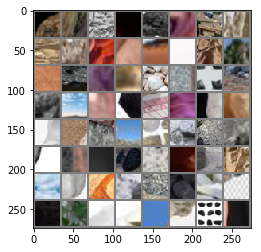

175
tensor([4, 0, 4, 0, 6, 1, 0, 3, 0, 2, 0, 2, 5, 0, 5, 6, 1, 2, 5, 0, 6, 6, 2, 5,
        0, 6, 5, 6, 0, 5, 6, 4, 3, 6, 0, 0, 2, 6, 4, 0, 0, 2, 4, 6, 4, 5, 3, 0,
        0, 3, 5, 4, 2, 5, 6, 5, 2, 0, 5, 4, 0, 2, 0, 4])
(64, 3, 32, 32)
('4_2946.jpg', '0_1060.jpg', '4_1297.jpg', '0_2569.jpg', '6_162.jpg', '1_485.jpg', '0_3677.jpg', '3_755.jpg', '0_696.jpg', '2_546.jpg', '0_4118.jpg', '2_220.jpg', '5_2952.jpg', '0_3111.jpg', '5_3494.jpg', '6_604.jpg', '1_1074.jpg', '2_1972.jpg', '5_1283.jpg', '0_1706.jpg', '6_1302.jpeg', '6_2054.jpg', '2_1966.jpg', '5_1297.jpg', '0_1712.jpg', '6_2040.jpg', '5_2946.jpg', '6_1549.jpg', '0_3105.jpg', '5_3480.jpg', '6_610.jpg', '4_1283.jpg', '3_999.jpg', '6_176.jpg', '0_3663.jpg', '0_682.jpg', '2_552.jpg', '6_2726.jpg', '4_2952.jpg', '0_1074.jpg', '0_4276.webp', '2_1147.jpg', '4_2615.jpg', '6_2861.jpg', '4_339.jpg', '5_2167.jpg', '3_806.jpg', '0_3924.jpg', '0_4093.jpg', '3_1635.jpg', '5_3279.jpg', '4_29.jpg', '2_2328.jpg', '5_894.jpg', '6_957.jpg', '5_2601.

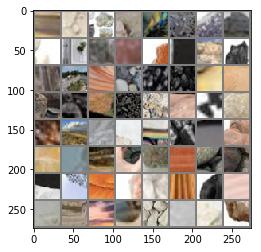

176
tensor([0, 2, 5, 6, 3, 6, 5, 2, 5, 0, 5, 4, 0, 0, 0, 2, 3, 4, 6, 4, 0, 4, 5, 3,
        0, 1, 4, 2, 5, 6, 4, 5, 6, 5, 3, 3, 0, 3, 1, 5, 2, 2, 4, 5, 4, 1, 3, 5,
        2, 4, 5, 5, 4, 5, 2, 6, 6, 5, 4, 5, 0, 5, 2, 0])
(64, 3, 32, 32)
('0_1841.jpg', '2_1635.jpg', '5_880.jpg', '6_1197.jpeg', '3_216.JPEG', '6_943.jpg', '5_658.jpg', '2_3022.jpg', '5_2615.jpg', '0_2390.jpg', '5_2173.jpg', '4_1308.jpg', '0_3930.jpg', '0_4087.jpg', '0_709.jpg', '2_1153.jpg', '3_646.JPEG', '4_2601.jpg', '6_2875.jpg', '4_305.jpg', '0_3918.jpg', '4_1320.jpg', '5_116.jpg', '3_1609.jpg', '0_721.jpg', '1_532.jpg', '4_15.jpg', '2_2472.jpg', '5_3245.jpg', '6_2685.jpg', '4_2629.jpg', '5_1452.jpg', '6_1528.jpeg', '5_1334.jpg', '3_1024.JPEG', '3_703.JPEG', '0_1869.jpg', '3_351.png', '1_254.jpg', '5_3523.jpg', '2_2314.jpg', '2_397.jpg', '4_1446.jpg', '5_670.jpg', '4_463.jpg', '1_240.jpg', '3_190.jpg', '5_3537.jpg', '2_383.jpg', '4_1452.jpg', '5_664.jpg', '5_2629.jpg', '4_477.jpg', '5_1320.jpg', '2_1609.jpg', '6_2691.j

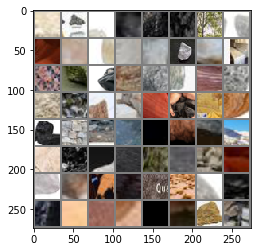

177
tensor([6, 0, 0, 0, 1, 2, 0, 2, 0, 5, 0, 6, 3, 1, 4, 6, 5, 6, 6, 3, 0, 6, 2, 6,
        2, 3, 0, 0, 5, 3, 0, 4, 6, 2, 0, 3, 5, 5, 4, 1, 0, 5, 2, 6, 3, 0, 2, 6,
        0, 2, 4, 4, 1, 6, 0, 2, 5, 0, 0, 5, 0, 1, 0, 5])
(64, 3, 32, 32)
('6_1373.jpg', '0_2421.jpg', '0_906.jpg', '0_1128.jpg', '1_718.png', '2_1184.jpg', '0_1896.jpg', '2_2596.webp', '0_2347.jpg', '5_857.jpg', '0_3059.jpg', '6_1415.jpg', '3_1190.jpg', '1_1128.jpg', '4_488.jpg', '6_758.jpg', '5_843.jpg', '6_1401.jpg', '6_980.jpg', '3_1351.png', '0_1882.jpg', '6_2108.jpg', '2_1190.jpg', '6_1367.jpg', '2_2499.jpg', '3_609.jpg', '0_912.jpg', '0_2435.jpg', '5_1491.jpg', '3_996.JPEG', '0_1114.jpg', '4_2832.jpg', '6_2646.jpg', '2_432.jpg', '0_3703.jpg', '3_621.jpg', '5_3286.jpg', '5_2198.jpg', '4_1485.jpg', '1_297.jpg', '0_3065.jpg', '5_2826.jpg', '2_354.jpg', '6_1429.jpg', '3_1379.png', '0_1672.jpg', '2_1806.jpg', '6_2134.jpg', '0_1666.jpg', '2_1812.jpg', '4_2198.jpg', '4_1491.jpg', '1_1114.jpg', '6_764.jpg', '0_3071.jpg', '2_34

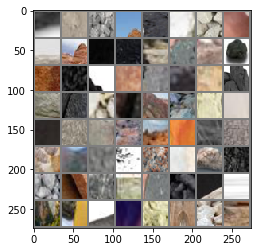

178
tensor([0, 4, 6, 2, 3, 3, 4, 0, 5, 4, 4, 0, 0, 5, 2, 5, 2, 4, 2, 5, 4, 2, 2, 3,
        0, 2, 2, 5, 0, 6, 6, 4, 5, 3, 4, 2, 4, 4, 6, 5, 4, 2, 0, 3, 2, 4, 5, 5,
        0, 6, 5, 6, 2, 5, 1, 0, 0, 5, 4, 5, 4, 2, 5, 0])
(64, 3, 32, 32)
('0_1100.jpg', '4_2826.jpg', '6_2652.jpg', '2_1423.jpg', '3_1136.JPEG', '3_1184.png', '4_2371.jpg', '0_2186.jpg', '5_2403.jpg', '4_1678.jpg', '4_885.jpg', '0_2838.jpg', '0_4291.jpg', '5_328.jpg', '2_2894.jpg', '5_2365.jpg', '2_817.jpg', '4_2417.jpg', '2_1345.jpg', '5_1678.jpg', '4_2403.jpg', '2_1351.jpg', '2_2658.jpg', '3_1423.jpg', '0_4285.jpg', '2_2880.jpg', '2_803.jpg', '5_2371.jpg', '0_2192.jpg', '6_599.jpg', '6_1818.jpg', '4_649.jpg', '5_2417.jpg', '3_1345.jpg', '4_891.jpg', '2_1437.jpg', '4_2365.jpg', '4_661.jpg', '6_1830.jpg', '5_472.jpg', '4_1644.jpg', '2_195.jpg', '0_245.jpg', '3_386.jpg', '2_2116.jpg', '4_3053.jpg', '5_1136.jpg', '5_1650.jpg', '0_71.jpg', '6_2487.jpg', '5_1888.jpg', '6_2353.jpeg', '2_1379.jpg', '5_3047.jpg', '1_730.jpg', '0_28

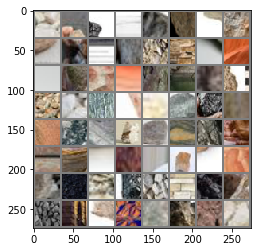

179
tensor([0, 5, 4, 4, 5, 6, 0, 4, 4, 1, 5, 6, 4, 5, 4, 2, 0, 2, 4, 6, 4, 0, 4, 3,
        0, 6, 5, 6, 2, 1, 2, 0, 6, 0, 1, 2, 0, 0, 0, 2, 6, 5, 2, 6, 3, 0, 3, 0,
        4, 6, 4, 0, 5, 0, 4, 6, 2, 0, 0, 3, 0, 6, 0, 4])
(64, 3, 32, 32)
('0_2810.jpg', '5_300.jpg', '4_1136.jpg', '4_113.jpg', '5_1644.jpg', '6_2493.jpg', '0_65.jpg', '4_3047.jpg', '4_2359.jpg', '1_1100.png', '5_1122.jpg', '6_1824.jpg', '4_675.jpg', '5_466.jpg', '4_1650.jpg', '2_181.jpg', '0_251.jpg', '2_2102.jpg', '4_1888.jpg', '6_1617.jpg', '4_846.jpg', '0_4534.jpg', '4_1863.jpg', '3_379.jpg', '0_2145.jpg', '6_3000.jpg', '5_1877.jpg', '6_2478.jpg', '2_1386.jpg', '1_917.jpg', '2_2857.jpg', '0_2623.jpg', '6_228.jpg', '0_4252.jpg', '1_903.jpg', '2_2843.jpg', '0_2637.jpg', '0_3529.jpg', '0_4246.jpg', '2_618.jpg', '6_1165.jpg', '5_1863.jpg', '2_1392.jpg', '6_3014.jpg', '3_187.JPEG', '0_1458.jpg', '3_1386.jpg', '0_4520.jpg', '4_852.jpg', '6_1603.jpg', '4_1877.jpg', '0_2151.jpg', '5_499.jpg', '0_1470.jpg', '4_3090.jpg', '6_2322.

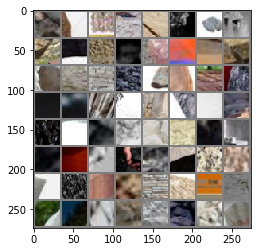

180
tensor([6, 5, 3, 6, 0, 2, 0, 5, 0, 0, 5, 6, 3, 6, 3, 5, 0, 6, 2, 2, 0, 4, 6, 6,
        5, 0, 4, 2, 6, 5, 6, 3, 5, 0, 6, 6, 3, 6, 4, 0, 6, 4, 6, 0, 0, 2, 4, 0,
        0, 3, 2, 0, 6, 4, 0, 5, 0, 6, 5, 6, 2, 3, 5, 0])
(64, 3, 32, 32)
('6_214.jpg', '5_3084.jpg', '3_423.jpg', '6_2996.jpeg', '0_3501.jpg', '2_630.jpg', '0_1316.jpg', '5_1693.jpg', '0_4048.jpeg', '0_1302.jpg', '5_1687.jpg', '6_326.jpeg', '3_2.jpg', '6_200.jpg', '3_437.jpg', '5_3090.jpg', '0_3515.jpg', '6_1159.jpg', '2_624.jpg', '2_142.jpg', '0_3273.jpg', '4_1693.jpg', '6_2095.jpeg', '6_3028.jpg', '5_3154.webp', '0_1464.jpg', '4_3084.jpg', '2_625.jpg', '6_1158.jpg', '5_3091.jpg', '6_201.jpg', '3_3.jpg', '5_1686.jpg', '0_1303.jpg', '6_2451.jpg', '6_2282.jpeg', '3_1608.png', '6_2337.jpg', '4_3085.jpg', '0_1465.jpg', '6_3029.jpg', '4_1692.jpg', '6_567.jpg', '0_3272.jpg', '0_293.jpg', '2_143.jpg', '4_1686.jpg', '0_2178.jpg', '0_3266.jpg', '3_344.jpg', '2_157.jpg', '0_4509.jpg', '6_2323.jpg', '4_3091.jpg', '0_1471.jpg', '5_1692

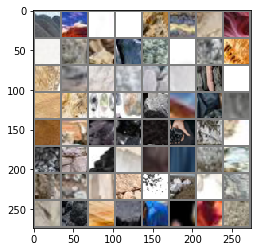

181
tensor([6, 0, 0, 2, 1, 5, 0, 6, 4, 6, 0, 6, 0, 4, 4, 6, 0, 3, 6, 0, 6, 0, 2, 1,
        2, 3, 5, 6, 0, 6, 5, 4, 4, 5, 0, 1, 2, 5, 4, 3, 3, 0, 2, 4, 5, 4, 6, 5,
        4, 4, 5, 3, 4, 3, 2, 0, 2, 4, 5, 6, 4, 5, 4, 4])
(64, 3, 32, 32)
('6_1164.jpg', '0_3528.jpg', '0_2636.jpg', '2_2842.jpg', '1_902.jpg', '5_498.jpg', '0_4521.jpg', '6_1602.jpg', '4_853.jpg', '6_1441.jpeg', '0_1459.jpg', '6_3015.jpg', '0_2144.jpg', '4_1862.jpg', '4_847.jpg', '6_1616.jpg', '0_4535.jpg', '3_1393.jpg', '6_1170.jpg', '0_4253.jpg', '6_229.jpg', '0_2622.jpg', '2_2856.jpg', '1_916.jpg', '2_1387.jpg', '3_13.jpeg', '5_1876.jpg', '6_2479.jpg', '0_64.jpg', '6_2492.jpg', '5_1645.jpg', '4_112.jpg', '4_1137.jpg', '5_301.jpg', '0_2811.jpg', '1_725.jpg', '2_2665.jpg', '5_3052.jpg', '4_1889.jpg', '3_393.jpg', '3_1378.jpg', '0_250.jpg', '2_180.jpg', '4_1651.jpg', '5_467.jpg', '4_674.jpg', '6_1825.jpg', '5_1123.jpg', '4_2358.jpg', '4_3046.jpg', '5_1137.jpg', '3_810.JPEG', '4_3052.jpg', '3_387.jpg', '2_2117.jpg', '0_244.jp

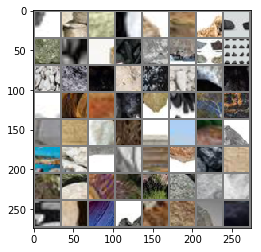

182
tensor([5, 0, 0, 1, 5, 2, 2, 6, 5, 5, 2, 5, 2, 0, 3, 2, 1, 2, 0, 4, 5, 4, 2, 4,
        3, 4, 6, 5, 6, 0, 0, 4, 0, 4, 5, 0, 4, 1, 2, 2, 4, 5, 2, 5, 2, 0, 0, 2,
        5, 3, 1, 0, 6, 1, 4, 0, 6, 6, 4, 0, 5, 1, 0, 5])
(64, 3, 32, 32)
('5_315.jpg', '0_522.jpg', '0_2805.jpg', '1_731.jpg', '5_3046.jpg', '2_2671.jpg', '2_1378.jpg', '6_2486.jpg', '5_1889.jpg', '5_1651.jpg', '2_802.jpg', '5_2370.jpg', '2_2881.jpg', '0_4284.jpg', '3_1422.jpg', '2_2659.jpg', '1_719.jpg', '2_1350.jpg', '0_58.jpg', '4_2402.jpg', '5_1679.jpg', '4_2364.jpg', '2_1436.jpg', '4_890.jpg', '3_1344.jpg', '4_648.jpg', '6_1819.jpg', '5_2416.jpg', '6_598.jpg', '0_2193.jpg', '0_3299.jpg', '4_884.jpg', '0_278.jpg', '4_1679.jpg', '5_2402.jpg', '0_2187.jpg', '4_2370.jpg', '1_1129.png', '2_1422.jpg', '2_1344.jpg', '4_2416.jpg', '5_2364.jpg', '2_816.jpg', '5_329.jpg', '2_2895.jpg', '0_4290.jpg', '0_2839.jpg', '2_341.jpg', '5_2833.jpg', '3_152.jpg', '1_282.jpg', '0_3070.jpg', '6_765.jpg', '1_1115.jpg', '4_1490.jpg', '0_1667.jp

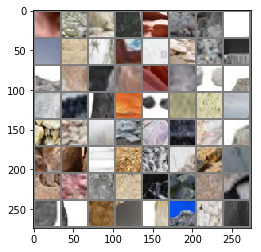

183
tensor([3, 0, 0, 5, 5, 0, 2, 4, 5, 2, 6, 5, 6, 2, 3, 0, 1, 6, 1, 4, 6, 0, 3, 6,
        5, 0, 6, 4, 0, 0, 2, 6, 0, 2, 6, 2, 0, 0, 0, 6, 2, 6, 3, 2, 6, 5, 0, 2,
        0, 5, 5, 4, 5, 4, 2, 2, 5, 5, 2, 6, 0, 5, 4, 4])
(64, 3, 32, 32)
('3_634.jpg', '0_3716.jpg', '0_4079.jpg', '5_2199.jpg', '5_3287.jpg', '0_3702.jpg', '2_433.jpg', '4_2833.jpg', '5_1490.jpg', '2_1807.jpg', '6_2121.jpg', '5_2827.jpg', '6_1428.jpg', '2_355.jpg', '3_146.jpg', '0_3064.jpg', '1_296.jpg', '6_771.jpg', '1_1101.jpg', '4_1484.jpg', '6_2109.jpg', '0_1883.jpg', '3_1185.jpg', '6_1400.jpg', '5_842.jpg', '0_2352.jpg', '6_759.jpg', '4_489.jpg', '0_2434.jpg', '0_913.jpg', '2_2498.jpg', '6_1366.jpg', '0_4045.jpg', '2_1191.jpg', '6_2390.jpeg', '2_1185.jpg', '0_907.jpg', '0_2420.jpg', '0_4051.jpg', '6_1372.jpg', '2_442.webp', '6_995.jpg', '3_1191.jpg', '2_369.jpg', '6_1414.jpg', '5_856.jpg', '0_2346.jpg', '2_1608.jpg', '0_287.png', '5_1321.jpg', '5_2628.jpg', '4_476.jpg', '5_665.jpg', '4_1453.jpg', '2_382.jpg', '2_2301.j

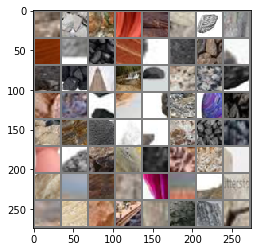

184
tensor([6, 5, 6, 3, 5, 4, 6, 3, 2, 5, 1, 4, 5, 0, 4, 4, 4, 5, 4, 2, 5, 2, 3, 1,
        3, 0, 3, 5, 0, 2, 5, 5, 6, 6, 5, 2, 0, 4, 0, 6, 4, 2, 0, 0, 4, 6, 0, 3,
        5, 4, 5, 0, 0, 4, 5, 6, 0, 4, 6, 2, 2, 3, 0, 5])
(64, 3, 32, 32)
('6_2848.jpg', '5_1447.jpg', '6_2690.jpg', '3_422.png', '5_1453.jpg', '4_2628.jpg', '6_2684.jpg', '3_436.png', '2_2473.jpg', '5_3244.jpg', '1_533.jpg', '4_14.jpg', '5_117.jpg', '0_3919.jpg', '4_1321.jpg', '4_304.jpg', '4_462.jpg', '5_671.jpg', '4_1447.jpg', '2_396.jpg', '5_3522.jpg', '2_2315.jpg', '3_185.jpg', '1_255.jpg', '3_350.png', '0_1868.jpg', '3_1663.JPEG', '5_1335.jpg', '0_2391.jpg', '2_3023.jpg', '5_2614.jpg', '5_659.jpg', '6_3001.png', '6_942.jpg', '5_881.jpg', '2_1634.jpg', '0_1840.jpg', '4_2166.jpg', '0_1698.jpg', '6_2874.jpg', '4_2600.jpg', '2_1152.jpg', '0_708.jpg', '0_4086.jpg', '4_1309.jpg', '6_2955.jpeg', '0_3931.jpg', '3_813.jpg', '5_2172.jpg', '4_28.jpg', '5_3278.jpg', '0_4092.jpg', '0_3925.jpg', '4_338.jpg', '5_2166.jpg', '6_2860.jpg

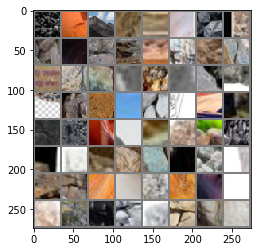

185
tensor([0, 5, 2, 3, 6, 3, 1, 2, 5, 1, 6, 5, 0, 5, 2, 6, 0, 5, 2, 0, 4, 6, 2, 0,
        3, 1, 0, 6, 3, 4, 2, 0, 0, 3, 0, 1, 6, 0, 4, 0, 4, 1, 6, 6, 0, 5, 2, 1,
        6, 5, 0, 5, 0, 2, 0, 0, 5, 6, 0, 6, 0, 0, 0, 0])
(64, 3, 32, 32)
('0_2385.jpg', '5_2600.jpg', '2_3037.jpg', '3_1152.jpg', '6_956.jpg', '3_21.jpg', '1_269.jpg', '2_2329.jpg', '5_895.jpg', '1_1061.jpg', '6_611.jpg', '5_3481.jpg', '0_3104.jpg', '5_2947.jpg', '2_235.jpg', '6_2041.jpg', '0_1713.jpg', '5_1296.jpg', '2_1967.jpg', '0_1075.jpg', '4_2953.jpg', '6_2727.jpg', '2_553.jpg', '0_683.jpg', '3_740.jpg', '1_490.jpg', '0_3662.jpg', '6_177.jpg', '3_998.jpg', '4_1282.jpg', '2_547.jpg', '0_4119.jpg', '0_697.jpg', '3_754.jpg', '0_3676.jpg', '1_484.jpg', '6_163.jpg', '0_2568.jpg', '4_1296.jpg', '0_1061.jpg', '4_2947.jpg', '1_651.png', '6_2733.jpg', '6_2055.jpg', '0_1707.jpg', '5_1282.jpg', '2_1973.jpg', '1_1075.jpg', '6_605.jpg', '5_3495.jpg', '0_3110.jpg', '5_2953.jpg', '0_4482.png', '2_1783.jpg', '0_2226.jpg', '0_3138.jpg'

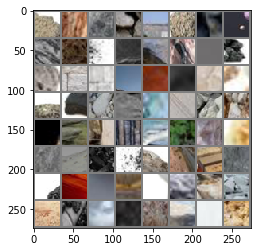

186
tensor([0, 0, 0, 0, 1, 0, 6, 5, 6, 6, 2, 5, 0, 2, 5, 1, 0, 5, 4, 4, 4, 0, 4, 2,
        6, 0, 5, 2, 4, 4, 5, 4, 1, 5, 4, 4, 2, 5, 1, 5, 2, 5, 5, 4, 5, 4, 6, 5,
        6, 2, 1, 2, 3, 6, 5, 5, 6, 2, 4, 0, 2, 2, 6, 4])
(64, 3, 32, 32)
('0_2959.png', '0_2554.jpg', '0_873.jpg', '0_3892.jpg', '1_1049.jpg', '0_2232.jpg', '6_639.jpg', '5_922.jpg', '6_1560.jpg', '6_2069.jpg', '2_1797.jpg', '5_1255.jpg', '0_1908.jpg', '2_2275.jpg', '5_3442.jpg', '1_335.jpg', '0_126.jpg', '5_711.jpg', '4_1527.jpg', '4_502.jpg', '4_264.jpg', '0_898.jpg', '4_1241.jpg', '2_590.jpg', '6_1683.jpeg', '0_640.jpg', '5_3324.jpg', '2_2513.jpg', '4_2990.jpg', '4_2748.jpg', '5_1533.jpg', '4_2984.jpg', '1_18.jpg', '5_1527.jpg', '4_270.jpg', '4_1255.jpg', '2_2507.jpg', '5_3330.jpg', '1_447.jpg', '5_3456.jpg', '2_2261.jpg', '5_2990.jpg', '5_705.jpg', '4_1533.jpg', '5_2748.jpg', '4_516.jpg', '6_11.jpg', '5_1241.jpg', '6_2096.jpg', '2_1768.jpg', '1_309.jpg', '2_2249.jpg', '3_1032.jpg', '6_836.jpg', '5_2760.jpg', '5_1269.jpg'

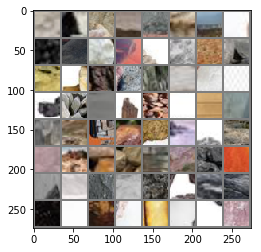

187
tensor([6, 6, 4, 5, 0, 3, 5, 0, 5, 4, 0, 0, 3, 0, 0, 2, 1, 4, 6, 4, 2, 0, 2, 3,
        5, 5, 4, 6, 2, 6, 0, 3, 2, 6, 3, 0, 4, 3, 5, 0, 6, 0, 0, 0, 6, 6, 0, 3,
        6, 5, 5, 5, 0, 6, 6, 0, 4, 6, 1, 0, 0, 2, 6, 5])
(64, 3, 32, 32)
('6_2900.jpg', '6_188.jpg', '4_258.jpg', '5_2006.jpg', '0_3845.jpg', '3_1754.jpg', '5_3318.jpg', '0_2597.jpg', '5_2012.jpg', '4_1269.jpg', '0_3851.jpg', '0_668.jpg', '3_1740.jpg', '0_4567.jpeg', '0_3689.jpg', '2_1032.jpg', '1_24.jpg', '4_2760.jpg', '6_2914.jpg', '4_2006.jpg', '2_2451.webp', '0_1920.jpg', '2_1754.jpg', '3_1026.jpg', '5_739.jpg', '5_2774.jpg', '4_1080.jpg', '6_375.jpg', '2_989.jpg', '6_2928.png', '0_3460.jpg', '3_542.jpg', '2_751.jpg', '6_2525.jpg', '3_797.png', '0_1277.jpg', '4_2589.jpg', '3_739.JPEG', '5_1094.jpg', '0_1511.jpg', '6_2243.jpg', '0_4469.jpg', '0_3306.jpg', '0_2018.jpg', '6_413.jpg', '6_1992.jpg', '0_3312.jpg', '3_230.jpg', '6_407.jpg', '5_5.jpg', '5_2589.jpg', '5_1080.jpg', '0_1505.jpg', '6_2257.jpg', '6_2531.jpg', '0_1263

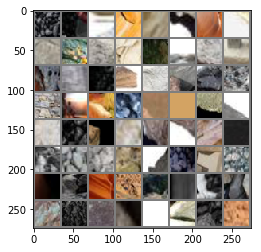

188
tensor([6, 2, 1, 6, 5, 6, 6, 0, 4, 6, 0, 2, 3, 4, 6, 0, 2, 0, 2, 0, 6, 4, 0, 2,
        1, 0, 5, 0, 0, 6, 2, 3, 5, 0, 5, 6, 2, 3, 2, 5, 0, 0, 2, 4, 1, 5, 5, 5,
        6, 6, 4, 4, 2, 0, 6, 1, 2, 5, 0, 6, 4, 5, 4, 6])
(64, 3, 32, 32)
('6_2519.jpg', '2_2936.jpg', '1_876.jpg', '6_2781.jpeg', '5_97.jpg', '6_349.jpg', '6_1010.jpg', '0_4333.jpg', '4_927.jpg', '6_1776.jpg', '0_4455.jpg', '2_2088.jpg', '3_218.jpg', '4_1902.jpg', '6_1904.jpeg', '0_2024.jpg', '2_1581.jpg', '0_1539.jpg', '2_1595.jpg', '0_4441.jpg', '6_1762.jpg', '4_1916.jpg', '0_2030.jpg', '2_2922.jpg', '1_862.jpg', '0_2756.jpg', '5_83.jpg', '0_3448.jpg', '0_4327.jpg', '6_1004.jpg', '2_779.jpg', '3_1581.jpg', '5_1902.jpg', '0_2583.png', '5_1731.jpg', '6_2502.jpeg', '2_1218.jpg', '3_581.jpg', '2_2711.jpg', '5_3126.jpg', '0_442.jpg', '0_2965.jpg', '2_792.jpg', '4_1043.jpg', '1_889.jpg', '5_275.jpg', '5_68.jpg', '5_2238.jpg', '6_2152.jpeg', '6_1951.jpg', '4_700.jpg', '4_1725.jpg', '2_61.jpg', '0_324.jpg', '6_1789.jpg', '1_137.jp

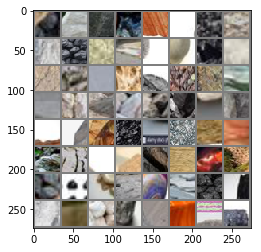

189
tensor([4, 2, 5, 0, 1, 3, 1, 5, 2, 0, 0, 2, 4, 5, 5, 3, 5, 3, 5, 2, 0, 5, 3, 0,
        4, 0, 2, 2, 4, 5, 4, 0, 0, 3, 4, 6, 5, 2, 3, 4, 5, 4, 3, 2, 1, 3, 2, 5,
        5, 0, 2, 3, 5, 5, 4, 1, 5, 5, 5, 2, 1, 2, 0, 0])
(64, 3, 32, 32)
('4_1731.jpg', '2_75.jpg', '5_507.jpg', '0_330.jpg', '1_123.jpg', '3_1272.JPEG', '1_645.jpg', '5_3132.jpg', '2_2705.jpg', '0_2971.jpg', '0_456.jpg', '2_786.jpg', '4_1057.jpg', '5_261.jpg', '5_1725.jpg', '3_1556.jpg', '5_249.jpg', '3_410.JPEG', '5_2204.jpg', '2_976.jpg', '0_2781.jpg', '5_54.jpg', '3_1337.JPEG', '0_1288.jpg', '4_2576.jpg', '0_4125.png', '2_1224.jpg', '2_1542.jpg', '4_2210.jpg', '5_2562.jpg', '4_1719.jpg', '0_4496.jpg', '0_318.jpg', '3_1230.jpg', '4_728.jpg', '6_1979.jpg', '5_2576.jpg', '2_49.jpg', '3_1224.jpg', '4_2204.jpg', '5_1719.jpg', '4_2562.jpg', '3_943.JPEG', '2_2739.jpg', '1_679.jpg', '3_1542.jpg', '2_962.jpg', '5_2210.jpg', '5_40.jpg', '0_2795.jpg', '2_1208.jpg', '3_744.png', '5_1721.jpg', '5_265.jpg', '4_1053.jpg', '1_899.jpg', 

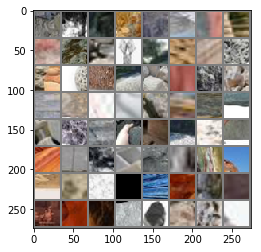

190
tensor([2, 1, 6, 4, 5, 2, 4, 5, 4, 5, 6, 3, 0, 2, 4, 2, 5, 4, 5, 0, 4, 2, 5, 1,
        5, 0, 5, 5, 0, 5, 3, 5, 2, 3, 2, 3, 0, 4, 4, 2, 0, 3, 5, 0, 4, 6, 5, 2,
        4, 2, 5, 0, 5, 0, 2, 5, 1, 2, 3, 0, 1, 2, 0, 4])
(64, 3, 32, 32)
('2_2067.jpg', '1_127.jpg', '6_1941.jpg', '4_710.jpg', '5_503.jpg', '2_71.jpg', '4_1735.jpg', '5_1047.jpg', '4_2228.jpg', '5_1053.jpg', '6_2284.jpg', '3_1208.jpg', '0_320.jpg', '2_2073.jpg', '4_704.jpg', '2_65.jpg', '5_517.jpg', '4_1721.jpg', '5_271.jpg', '0_4474.jpeg', '4_1047.jpg', '2_2715.jpg', '5_3122.jpg', '1_655.jpg', '5_2379.webp', '0_446.jpg', '5_1735.jpg', '5_259.jpg', '0_2791.jpg', '5_44.jpg', '3_1336.JPEG', '5_2214.jpg', '2_966.jpg', '3_1546.jpg', '2_1234.jpg', '3_778.png', '0_1298.jpg', '4_2566.jpg', '4_2200.jpg', '2_1552.jpg', '0_1733.jpeg', '3_1220.jpg', '5_2572.jpg', '0_4492.jpg', '4_738.jpg', '6_1969.jpg', '5_2566.jpg', '2_59.jpg', '4_2214.jpg', '2_1546.jpg', '5_1709.jpg', '0_2550.png', '5_50.jpg', '0_2785.jpg', '2_972.jpg', '5_2200.jpg'

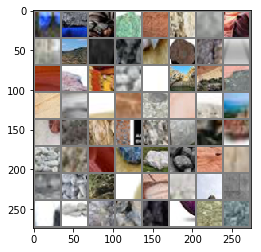

191
tensor([2, 6, 0, 3, 4, 6, 0, 6, 0, 5, 6, 0, 5, 6, 0, 3, 0, 5, 6, 6, 0, 6, 5, 0,
        6, 3, 0, 6, 2, 0, 4, 6, 3, 5, 6, 0, 2, 5, 6, 0, 0, 4, 6, 0, 4, 2, 3, 2,
        2, 0, 0, 6, 4, 0, 3, 0, 2, 6, 2, 5, 5, 3, 6, 3])
(64, 3, 32, 32)
('2_999.jpg', '6_365.jpg', '0_1267.jpg', '3_692.JPEG', '4_2599.jpg', '6_2535.jpg', '0_3077.jpeg', '6_2253.jpg', '0_1501.jpg', '5_1084.jpg', '6_1982.jpg', '0_2008.jpg', '5_1.jpg', '6_403.jpg', '0_4479.jpg', '3_234.jpg', '0_3316.jpg', '5_2599.jpg', '6_1996.jpg', '6_417.jpg', '0_3302.jpg', '6_2247.jpg', '5_1090.jpg', '0_1273.jpg', '6_2521.jpg', '3_546.jpg', '0_3464.jpg', '6_1028.jpg', '2_755.jpg', '0_485.jpg', '4_1084.jpg', '6_371.jpg', '3_963.png', '5_1906.jpg', '6_1000.jpg', '0_4323.jpg', '2_2926.jpg', '5_87.jpg', '6_359.jpg', '0_2752.jpg', '0_2034.jpg', '4_937.jpg', '6_1766.jpg', '0_4445.jpg', '4_1912.jpg', '2_2098.jpg', '3_208.jpg', '2_1591.jpg', '2_1585.jpg', '0_2020.jpg', '0_4451.jpg', '6_1772.jpg', '4_923.jpg', '0_3458.jpg', '3_1591.jpg', '0_4337.jp

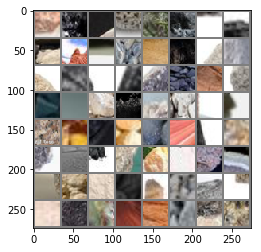

192
tensor([5, 6, 4, 5, 4, 1, 5, 2, 0, 5, 0, 2, 1, 2, 5, 0, 4, 0, 4, 4, 5, 4, 6, 5,
        4, 0, 2, 1, 3, 5, 2, 4, 4, 5, 5, 4, 2, 5, 0, 5, 6, 2, 5, 5, 2, 1, 6, 0,
        2, 6, 5, 4, 2, 4, 1, 6, 2, 6, 5, 4, 5, 0, 6, 0])
(64, 3, 32, 32)
('5_1245.jpg', '6_15.jpg', '4_1537.jpg', '5_701.jpg', '4_512.jpg', '1_325.jpg', '5_3452.jpg', '2_2265.jpg', '0_136.jpg', '5_2994.jpg', '0_650.jpg', '2_580.jpg', '1_443.jpg', '2_2503.jpg', '5_3334.jpg', '0_888.jpg', '4_274.jpg', '0_3869.jpg', '4_1251.jpg', '4_2758.jpg', '5_1523.jpg', '4_2980.jpg', '6_2938.jpg', '5_1537.jpg', '4_2994.jpg', '0_644.jpg', '2_594.jpg', '1_457.jpg', '3_787.jpg', '5_3320.jpg', '2_2517.jpg', '4_1245.jpg', '4_1523.jpg', '5_715.jpg', '5_2758.jpg', '4_506.jpg', '2_2271.jpg', '5_3446.jpg', '0_122.jpg', '5_2980.jpg', '6_2086.jpg', '2_1778.jpg', '5_1251.jpg', '5_2770.jpg', '2_2259.jpg', '1_319.jpg', '6_826.jpg', '0_1924.jpg', '2_1750.jpg', '6_29.jpg', '5_1279.jpg', '4_2002.jpg', '2_1988.jpg', '4_2764.jpg', '1_20.jpg', '6_2910.jpg', '2

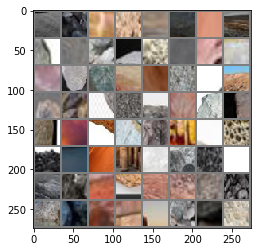

193
tensor([0, 0, 5, 0, 4, 0, 1, 4, 1, 6, 2, 0, 4, 5, 5, 3, 6, 3, 0, 5, 6, 5, 2, 6,
        1, 6, 5, 0, 2, 6, 4, 6, 0, 6, 4, 0, 2, 1, 3, 6, 0, 5, 3, 4, 0, 2, 0, 0,
        1, 4, 6, 0, 5, 0, 2, 6, 0, 5, 2, 5, 1, 6, 2, 5])
(64, 3, 32, 32)
('0_678.jpg', '0_3699.jpg', '5_2002.jpg', '0_2587.jpg', '4_1279.jpg', '0_3841.jpg', '1_866.png', '4_2770.jpg', '1_34.jpg', '6_2904.jpg', '2_1022.jpg', '0_1930.jpg', '4_2016.jpg', '5_729.jpg', '5_2764.jpg', '3_1361.JPEG', '6_832.jpg', '3_1036.jpg', '0_3114.jpg', '5_3491.jpg', '6_521.jpeg', '5_2957.jpg', '2_225.jpg', '6_1558.jpg', '1_1071.jpg', '6_601.jpg', '5_1286.jpg', '0_1703.jpg', '2_1977.jpg', '6_2051.jpg', '4_2943.jpg', '6_2737.jpg', '0_1065.jpg', '6_167.jpg', '4_1292.jpg', '0_693.jpg', '2_543.jpg', '1_480.jpg', '3_750.jpg', '6_173.jpg', '0_2578.jpg', '5_2512.webp', '3_295.JPEG', '4_1286.jpg', '0_687.jpg', '2_557.jpg', '0_4109.jpg', '0_3666.jpg', '1_494.jpg', '4_2957.jpg', '6_2723.jpg', '0_1071.jpg', '5_1292.jpg', '0_1717.jpg', '2_1963.jpg', '6_2045

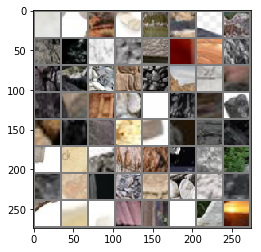

194
tensor([0, 6, 2, 0, 0, 0, 0, 6, 3, 0, 0, 0, 0, 6, 0, 5, 1, 0, 6, 6, 0, 2, 5, 2,
        2, 1, 3, 5, 2, 5, 5, 4, 5, 4, 4, 0, 2, 5, 0, 6, 6, 6, 5, 3, 6, 5, 6, 4,
        0, 4, 5, 4, 1, 5, 2, 3, 0, 6, 1, 2, 5, 4, 4, 5])
(64, 3, 32, 32)
('0_3128.jpg', '6_1564.jpg', '2_219.jpg', '0_2236.jpg', '0_877.jpg', '0_3896.jpg', '0_4121.jpg', '6_1202.jpg', '3_780.JPEG', '0_1059.jpg', '0_863.jpg', '0_2544.jpg', '0_3882.jpg', '6_1216.jpg', '0_4135.jpg', '5_932.jpg', '1_1059.jpg', '0_2222.jpg', '6_629.jpg', '6_2079.jpg', '0_4486.png', '2_1787.jpg', '5_1331.jpg', '2_1618.jpg', '2_392.jpg', '1_251.jpg', '3_181.jpg', '5_3526.jpg', '2_2311.jpg', '5_2638.jpg', '5_675.jpg', '4_1325.jpg', '5_113.jpg', '4_300.jpg', '4_10.jpg', '0_276.webp', '2_2477.jpg', '5_3240.jpg', '0_724.jpg', '6_1389.jpg', '6_2680.jpg', '6_2858.jpg', '5_1457.jpg', '3_7.png', '6_2694.jpg', '5_1443.jpg', '6_211.png', '4_2638.jpg', '0_3909.jpg', '4_1331.jpg', '5_107.jpg', '4_314.jpg', '1_523.jpg', '5_3254.jpg', '2_2463.jpg', '3_1618.jpg',

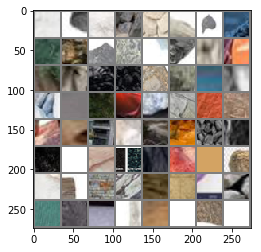

195
tensor([5, 3, 0, 6, 3, 5, 5, 2, 5, 4, 0, 2, 0, 3, 2, 4, 5, 3, 3, 4, 6, 0, 5, 0,
        0, 3, 0, 4, 5, 5, 4, 0, 3, 2, 6, 4, 4, 5, 2, 0, 2, 5, 1, 2, 5, 6, 1, 2,
        5, 1, 0, 6, 2, 4, 0, 5, 0, 6, 4, 0, 5, 3, 2, 0])
(64, 3, 32, 32)
('5_1325.jpg', '3_1662.JPEG', '0_1878.jpg', '6_952.jpg', '3_1156.jpg', '5_891.jpg', '5_2604.jpg', '2_3033.jpg', '5_649.jpg', '4_2176.jpg', '0_1688.jpg', '2_1624.jpg', '0_1850.jpg', '3_1383.png', '2_1142.jpg', '4_2610.jpg', '5_2787.webp', '3_1727.JPEG', '3_803.jpg', '4_1319.jpg', '6_2954.jpeg', '0_3921.jpg', '5_2162.jpg', '0_4096.jpg', '0_718.jpg', '3_1630.jpg', '0_3935.jpg', '4_328.jpg', '5_2176.jpg', '5_3268.jpg', '4_38.jpg', '0_4082.jpg', '3_1624.jpg', '2_1156.jpg', '6_2870.jpg', '4_2604.jpg', '4_2162.jpg', '5_1319.jpg', '2_1630.jpg', '0_1844.jpg', '2_2339.jpg', '5_885.jpg', '1_279.jpg', '2_3027.jpg', '5_2610.jpg', '6_775.jpg', '1_1105.jpg', '2_351.jpg', '5_2823.jpg', '1_292.jpg', '0_3060.jpg', '6_2125.jpg', '2_1803.jpg', '4_2189.jpg', '0_1677.jpg', '

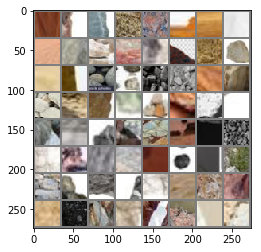

196
tensor([0, 3, 5, 1, 5, 5, 0, 6, 4, 6, 2, 0, 6, 4, 1, 5, 2, 6, 0, 1, 6, 0, 3, 6,
        5, 4, 0, 6, 6, 3, 6, 5, 2, 0, 0, 2, 0, 2, 0, 6, 0, 0, 6, 6, 2, 3, 5, 0,
        0, 5, 0, 0, 5, 2, 1, 4, 5, 4, 5, 4, 6, 2, 3, 4])
(64, 3, 32, 32)
('0_2418.jpg', '3_630.jpg', '5_3297.jpg', '1_5.jpg', '5_2189.jpg', '5_1480.jpg', '0_1105.jpg', '6_2657.jpg', '4_2823.jpg', '6_2131.jpg', '2_1817.jpg', '0_1663.jpg', '6_761.jpg', '4_1494.jpg', '1_1111.jpg', '5_2837.jpg', '2_345.jpg', '6_1438.jpg', '0_3074.jpg', '1_286.jpg', '6_1801.jpeg', '0_1893.jpg', '3_1340.png', '6_2119.jpg', '5_2912.webp', '4_499.jpg', '0_2342.jpg', '6_749.jpg', '6_1410.jpg', '3_1195.jpg', '6_991.jpg', '5_852.jpg', '2_2488.jpg', '0_903.jpg', '0_2424.jpg', '2_1181.jpg', '0_1139.jpg', '2_1195.jpg', '0_4041.jpg', '6_1362.jpg', '0_917.jpg', '0_2356.jpg', '6_1047.jpeg', '6_1404.jpg', '2_379.jpg', '3_1181.jpg', '5_846.jpg', '0_3048.jpg', '0_1887.jpg', '5_1655.jpg', '0_74.jpg', '0_2801.jpg', '5_3042.jpg', '2_2675.jpg', '1_735.jpg', '4_102.

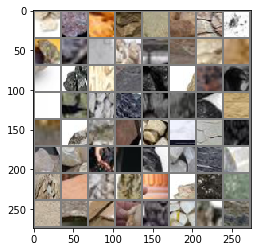

197
tensor([2, 0, 4, 3, 5, 4, 4, 3, 5, 5, 4, 6, 4, 3, 2, 0, 2, 0, 0, 2, 5, 5, 4, 5,
        4, 5, 2, 6, 0, 5, 0, 2, 2, 5, 2, 5, 2, 0, 3, 6, 6, 2, 4, 6, 4, 6, 5, 3,
        4, 4, 0, 4, 4, 0, 0, 0, 5, 2, 5, 2, 6, 2, 6, 3])
(64, 3, 32, 32)
('2_190.jpg', '0_240.jpg', '4_3056.jpg', '3_156.png', '5_1133.jpg', '4_2348.jpg', '4_3042.jpg', '3_142.png', '5_1127.jpg', '5_463.jpg', '4_1655.jpg', '6_1821.jpg', '4_670.jpg', '3_397.jpg', '2_2107.jpg', '0_254.jpg', '2_2807.webp', '0_2815.jpg', '0_532.jpg', '2_2661.jpg', '5_3056.jpg', '5_2348.jpg', '4_116.jpg', '5_305.jpg', '4_1133.jpg', '5_1641.jpg', '2_1368.jpg', '6_2496.jpg', '0_60.jpg', '5_1899.jpg', '0_4294.jpg', '2_2649.jpg', '2_812.jpg', '5_2360.jpg', '2_2891.jpg', '5_1669.jpg', '2_1340.jpg', '0_48.jpg', '3_954.JPEG', '6_2450.jpeg', '6_985.png', '2_1426.jpg', '4_2374.jpg', '6_588.jpg', '4_658.jpg', '6_1809.jpg', '5_2406.jpg', '3_1354.jpg', '4_880.jpg', '4_1669.jpg', '0_2197.jpg', '4_894.jpg', '4_2360.jpg', '0_4055.png', '0_2829.jpg', '0_4280.jpg

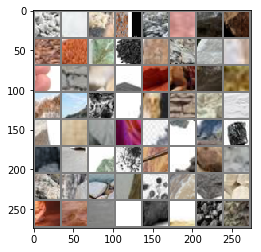

198
tensor([5, 0, 3, 6, 0, 5, 6, 4, 6, 2, 6, 3, 0, 2, 0, 0, 4, 0, 6, 0, 4, 6, 6, 0,
        6, 5, 6, 3, 2, 5, 0, 2, 5, 1, 2, 0, 2, 6, 0, 4, 0, 6, 4, 5, 0, 6, 6, 4,
        3, 4, 0, 0, 6, 0, 1, 2, 6, 0, 2, 5, 6, 0, 6, 4])
(64, 3, 32, 32)
('5_3081.jpg', '0_3504.jpg', '3_9.JPEG', '6_2441.jpg', '0_1313.jpg', '5_1696.jpg', '6_3039.jpg', '4_3095.jpg', '6_2327.jpg', '2_153.jpg', '6_577.jpg', '3_354.jpg', '0_3276.jpg', '2_147.jpg', '0_4519.jpg', '0_297.jpg', '4_1696.jpg', '0_2168.jpg', '6_563.jpg', '0_1461.jpg', '4_3081.jpg', '6_2333.jpg', '6_2455.jpg', '0_1307.jpg', '6_1505.jpeg', '5_1682.jpg', '6_205.jpg', '3_1459.JPEG', '2_621.jpg', '5_3095.jpg', '0_3510.jpg', '2_1383.jpg', '5_1872.jpg', '1_912.jpg', '2_2852.jpg', '0_4257.jpg', '2_609.jpg', '6_1174.jpg', '0_3538.jpg', '4_1866.jpg', '0_4531.jpg', '6_1612.jpg', '4_843.jpg', '5_488.jpg', '0_2140.jpg', '6_3005.jpg', '6_3011.jpg', '4_1872.jpg', '3_368.jpg', '4_857.jpg', '0_4525.jpg', '0_2154.jpg', '6_239.jpg', '0_2632.jpg', '1_906.jpg', '2_2846.

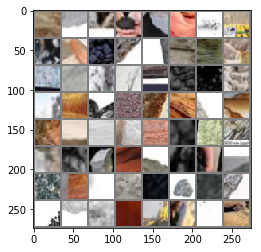

199
tensor([0, 3, 3, 4, 3, 6, 5, 6, 2, 6, 0, 2, 1, 0, 6, 0, 6, 2, 2, 0, 5, 2, 3, 3,
        6, 0, 5, 0, 4, 6, 3, 0, 4, 4, 0, 0, 6, 0, 4, 0, 2, 0, 0, 6, 0, 5, 3, 2,
        6, 3, 5, 0, 5, 0, 6, 0, 5, 2, 6, 6, 4, 0, 2, 0])
(64, 3, 32, 32)
('0_4524.jpg', '3_1382.jpg', '3_369.jpg', '4_1873.jpg', '3_24.png', '6_3010.jpg', '5_1867.jpg', '6_2468.jpg', '2_1396.jpg', '6_1161.jpg', '0_4242.jpg', '2_2847.jpg', '1_907.jpg', '0_2633.jpg', '6_238.jpg', '0_4256.jpg', '6_1175.jpg', '2_608.jpg', '2_2853.jpg', '0_2627.jpg', '5_1873.jpg', '2_1382.jpg', '3_1143.png', '3_186.JPEG', '6_3004.jpg', '0_1448.jpg', '5_489.jpg', '0_4530.jpg', '4_842.jpg', '6_1613.jpg', '3_1396.jpg', '0_3333.jpeg', '4_1867.jpg', '4_3080.jpg', '0_3626.jpeg', '0_1460.jpg', '6_562.jpg', '0_2169.jpg', '4_1697.jpg', '0_296.jpg', '2_146.jpg', '0_4518.jpg', '0_3277.jpg', '6_2997.jpeg', '0_3511.jpg', '5_3094.jpg', '3_433.jpg', '2_620.jpg', '6_204.jpg', '3_6.jpg', '5_1683.jpg', '0_1306.jpg', '5_1697.jpg', '0_1312.jpg', '6_2440.jpg', '0_350

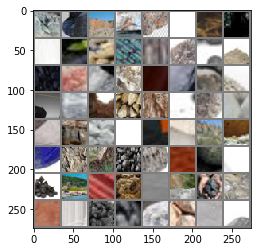

200
tensor([3, 6, 4, 0, 4, 2, 3, 4, 0, 3, 0, 5, 5, 2, 5, 2, 0, 0, 3, 2, 4, 0, 2, 5,
        4, 2, 6, 5, 2, 0, 3, 4, 3, 6, 4, 5, 0, 6, 4, 6, 2, 0, 2, 3, 2, 4, 6, 4,
        5, 1, 5, 1, 4, 0, 6, 5, 2, 5, 4, 5, 5, 4, 1, 2])
(64, 3, 32, 32)
('3_341.jpg', '6_2326.jpg', '4_3094.jpg', '0_1474.jpg', '4_2361.jpg', '2_1433.jpg', '3_610.JPEG', '4_895.jpg', '0_269.jpg', '3_1341.jpg', '0_3288.jpg', '5_2413.jpg', '5_338.jpg', '2_2884.jpg', '5_2375.jpg', '2_807.jpg', '0_4281.jpg', '0_2828.jpg', '3_1427.jpg', '2_1355.jpg', '4_2407.jpg', '0_49.jpg', '2_1341.jpg', '5_1668.jpg', '4_2413.jpg', '2_2890.jpg', '6_2647.jpeg', '5_2361.jpg', '2_2648.jpg', '0_4295.jpg', '3_1433.jpg', '4_881.jpg', '3_1355.jpg', '6_1808.jpg', '4_659.jpg', '5_2407.jpg', '0_2182.jpg', '6_589.jpg', '4_2375.jpg', '6_2217.jpeg', '2_1427.jpg', '0_255.jpg', '2_185.jpg', '3_396.jpg', '2_2106.jpg', '4_671.jpg', '6_1820.jpg', '4_1654.jpg', '5_462.jpg', '1_1104.png', '5_1126.jpg', '1_293.png', '4_3043.jpg', '0_61.jpg', '6_2497.jpg', '5_1898.

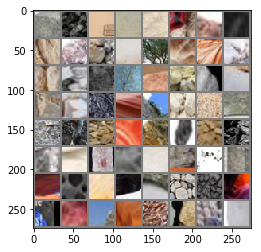

201
tensor([5, 0, 0, 4, 5, 4, 1, 5, 2, 0, 0, 6, 2, 6, 0, 5, 3, 4, 5, 4, 3, 0, 2, 4,
        2, 3, 3, 6, 4, 4, 5, 0, 0, 6, 2, 0, 0, 0, 5, 3, 2, 0, 5, 3, 6, 1, 6, 0,
        4, 6, 0, 2, 0, 0, 6, 0, 2, 4, 5, 5, 2, 3, 5, 0])
(64, 3, 32, 32)
('5_3057.jpg', '0_533.jpg', '0_2814.jpg', '4_1126.jpg', '5_310.jpg', '4_103.jpg', '1_734.jpg', '5_3043.jpg', '2_2674.jpg', '0_2800.jpg', '0_527.jpg', '6_2656.png', '2_2743.webp', '6_2483.jpg', '0_75.jpg', '5_1654.jpg', '3_1072.JPEG', '4_2349.jpg', '5_1132.jpg', '4_3057.jpg', '3_1369.jpg', '0_241.jpg', '2_191.jpg', '4_1898.jpg', '2_2112.jpg', '3_382.jpg', '3_305.jpeg', '6_1834.jpg', '4_665.jpg', '4_1640.jpg', '5_476.jpg', '0_916.jpg', '0_4040.jpg', '6_1363.jpg', '2_1194.jpg', '0_1138.jpg', '0_1886.jpg', '0_3049.jpg', '5_847.jpg', '3_1180.jpg', '2_378.jpg', '0_2357.jpg', '5_853.jpg', '3_1194.jpg', '6_1411.jpg', '1_1138.jpg', '6_748.jpg', '0_2343.jpg', '4_498.jpg', '6_2118.jpg', '0_1892.jpg', '2_1180.jpg', '0_2425.jpg', '0_902.jpg', '6_1377.jpg', '0_4054.j

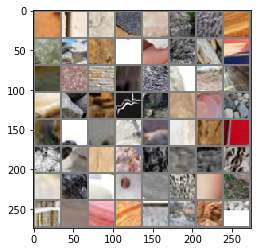

202
tensor([0, 0, 5, 6, 1, 4, 2, 6, 0, 4, 2, 2, 6, 0, 3, 5, 4, 6, 0, 0, 5, 3, 0, 4,
        6, 3, 0, 5, 4, 1, 6, 3, 0, 4, 5, 4, 5, 0, 3, 0, 2, 5, 1, 2, 5, 6, 3, 0,
        2, 5, 4, 2, 0, 4, 5, 0, 5, 2, 5, 6, 3, 3, 0, 5])
(64, 3, 32, 32)
('0_3713.jpg', '0_3075.jpg', '5_2836.jpg', '6_1439.jpg', '1_1110.jpg', '4_1495.jpg', '2_1816.jpg', '6_2130.jpg', '0_1676.jpg', '4_2188.jpg', '2_1802.jpg', '2_2578.webp', '6_2124.jpg', '0_3061.jpg', '3_1249.JPEG', '5_2822.jpg', '4_1481.jpg', '6_774.jpg', '0_2419.jpg', '0_4068.jpg', '5_3282.jpg', '3_625.jpg', '0_3707.jpg', '4_2836.jpg', '6_2642.jpg', '3_1619.JPEG', '0_1110.jpg', '5_1495.jpg', '4_2605.jpg', '1_913.png', '6_2871.jpg', '3_1625.jpg', '0_4083.jpg', '4_39.jpg', '5_3269.jpg', '4_329.jpg', '5_2177.jpg', '0_3934.jpg', '3_816.jpg', '0_2394.jpg', '2_3026.jpg', '5_2611.jpg', '1_278.jpg', '2_2338.jpg', '5_884.jpg', '6_947.jpg', '3_30.jpg', '0_1845.jpg', '2_1631.jpg', '5_1318.jpg', '4_2163.jpg', '2_1625.jpg', '0_1689.jpg', '4_2177.jpg', '5_648.jpg', '0

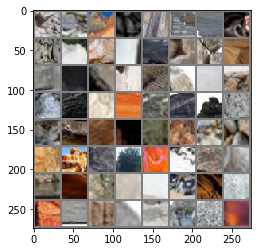

203
tensor([4, 0, 4, 6, 2, 3, 0, 5, 2, 4, 3, 5, 0, 4, 4, 5, 6, 5, 3, 5, 4, 4, 2, 5,
        1, 5, 4, 5, 4, 3, 5, 2, 2, 2, 3, 5, 6, 5, 6, 6, 0, 5, 4, 1, 4, 5, 4, 3,
        6, 0, 0, 0, 2, 6, 6, 1, 6, 5, 0, 6, 2, 6, 0, 5])
(64, 3, 32, 32)
('4_1318.jpg', '0_3920.jpg', '4_2611.jpg', '6_2865.jpg', '2_1143.jpg', '3_647.JPEG', '0_731.jpg', '5_3255.jpg', '2_2462.jpg', '4_315.jpg', '3_1475.JPEG', '5_106.jpg', '0_3908.jpg', '4_1330.jpg', '4_2639.jpg', '5_1442.jpg', '6_2695.jpg', '5_1324.jpg', '3_702.JPEG', '5_660.jpg', '4_1456.jpg', '4_473.jpg', '2_2304.jpg', '5_3533.jpg', '1_244.jpg', '5_674.jpg', '4_1442.jpg', '5_2639.jpg', '4_467.jpg', '3_180.jpg', '5_3527.jpg', '2_2310.jpg', '2_393.jpg', '2_1619.jpg', '3_355.png', '5_1330.jpg', '6_2859.jpg', '5_1456.jpg', '6_2681.jpg', '6_1388.jpg', '0_725.jpg', '5_3241.jpg', '4_11.jpg', '1_536.jpg', '4_301.jpg', '5_112.jpg', '4_1324.jpg', '3_779.jpg', '6_1217.jpg', '0_3883.jpg', '0_2545.jpg', '0_862.jpg', '2_1786.jpg', '6_2078.jpg', '6_628.jpg', '1_1058.jpg

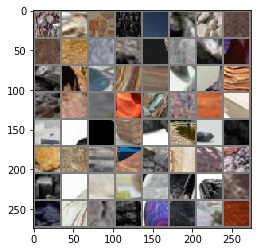

204
tensor([2, 0, 3, 0, 6, 0, 0, 6, 0, 6, 4, 3, 3, 0, 2, 0, 0, 4, 6, 6, 1, 2, 5, 5,
        6, 2, 0, 5, 2, 0, 5, 1, 5, 6, 2, 5, 0, 0, 1, 0, 4, 6, 0, 6, 4, 3, 3, 2,
        6, 4, 4, 0, 0, 5, 0, 6, 5, 5, 4, 0, 2, 4, 5, 6])
(64, 3, 32, 32)
('2_1792.jpg', '0_1058.jpg', '3_1553.png', '0_4120.jpg', '6_1203.jpg', '0_876.jpg', '0_2551.jpg', '6_2893.jpeg', '0_1070.jpg', '6_2722.jpg', '4_2956.jpg', '3_590.png', '3_745.jpg', '0_3667.jpg', '2_556.jpg', '0_4108.jpg', '0_686.jpg', '4_1287.jpg', '6_172.jpg', '6_614.jpg', '1_1064.jpg', '2_230.jpg', '5_2942.jpg', '5_3484.jpg', '6_2044.jpg', '2_1962.jpg', '0_1716.jpg', '5_1293.jpg', '2_1976.jpg', '0_1702.jpg', '5_1287.jpg', '1_1070.jpg', '5_2956.jpg', '6_1559.jpg', '2_224.jpg', '5_3490.jpg', '0_3115.jpg', '0_3673.jpg', '1_481.jpg', '0_692.jpg', '4_1293.jpg', '6_166.jpg', '0_1064.jpg', '6_2736.jpg', '4_2942.jpg', '3_651.JPEG', '3_1584.png', '2_1023.jpg', '6_2905.jpg', '4_2771.jpg', '4_1278.jpg', '0_3840.jpg', '0_2586.jpg', '5_2003.jpg', '0_3698.jpg', '6_

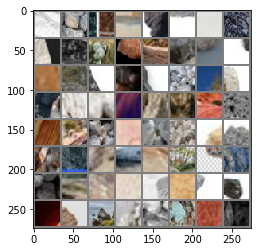

205
tensor([0, 3, 6, 1, 2, 5, 3, 0, 5, 5, 2, 6, 1, 4, 1, 4, 4, 5, 2, 1, 0, 4, 5, 5,
        2, 5, 0, 2, 5, 1, 5, 4, 5, 4, 5, 5, 2, 5, 4, 3, 6, 3, 5, 0, 6, 4, 5, 4,
        0, 4, 4, 0, 2, 5, 3, 1, 2, 4, 0, 4, 6, 0, 2, 5])
(64, 3, 32, 32)
('0_1925.jpg', '3_1023.jpg', '6_827.jpg', '1_318.jpg', '2_2258.jpg', '5_2771.jpg', '3_976.jpg', '0_2592.jpg', '5_2017.jpg', '5_3309.jpg', '2_1037.jpg', '6_2911.jpg', '1_21.jpg', '4_2765.jpg', '1_873.png', '4_1244.jpg', '4_261.jpg', '5_3321.jpg', '2_2516.jpg', '1_456.jpg', '0_645.jpg', '4_2995.jpg', '5_1536.jpg', '5_1250.jpg', '2_1779.jpg', '5_2981.jpg', '0_123.jpg', '2_2270.jpg', '5_3447.jpg', '1_330.jpg', '5_2759.jpg', '4_507.jpg', '5_714.jpg', '4_1522.jpg', '5_2995.jpg', '5_3453.jpg', '2_2264.jpg', '5_700.jpg', '4_1536.jpg', '3_714.JPEG', '6_14.jpg', '3_1033.JPEG', '5_1244.jpg', '0_1919.jpg', '6_2093.jpg', '4_2981.jpg', '5_1522.jpg', '4_2759.jpg', '0_3868.jpg', '4_1250.jpg', '4_275.jpg', '0_889.jpg', '2_2502.jpg', '5_3335.jpg', '3_792.jpg', '1_442.jpg

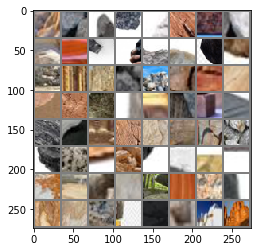

206
tensor([0, 0, 5, 2, 0, 6, 2, 5, 0, 0, 6, 2, 6, 0, 5, 6, 3, 2, 2, 4, 6, 4, 0, 0,
        5, 0, 6, 3, 5, 6, 6, 4, 2, 6, 1, 0, 6, 0, 6, 4, 0, 6, 2, 4, 0, 2, 1, 6,
        0, 3, 3, 0, 6, 5, 0, 6, 5, 0, 6, 2, 4, 2, 6, 4])
(64, 3, 32, 32)
('0_3854.png', '0_2747.jpg', '5_92.jpg', '2_2933.jpg', '0_4336.jpg', '6_1015.jpg', '2_768.jpg', '5_86.jpg', '0_2534.jpeg', '0_2753.jpg', '6_358.jpg', '2_2927.jpg', '6_1001.jpg', '0_4322.jpg', '5_1907.jpg', '6_2508.jpg', '3_939.JPEG', '2_1590.jpg', '2_2099.jpg', '4_1913.jpg', '6_1767.jpg', '4_936.jpg', '0_4444.jpg', '0_2035.jpg', '5_1091.jpg', '0_1514.jpg', '6_2246.jpg', '3_221.jpg', '5_2598.jpg', '6_1997.jpg', '6_370.jpg', '4_1085.jpg', '2_754.jpg', '6_1029.jpg', '1_697.jpg', '0_2021.jpeg', '6_2520.jpg', '0_1272.jpg', '6_2534.jpg', '4_2598.jpg', '0_1266.jpg', '6_364.jpg', '2_998.jpg', '4_1091.jpg', '0_490.jpg', '2_740.jpg', '1_683.jpg', '6_2981.jpeg', '0_3471.jpg', '3_553.jpg', '3_235.jpg', '0_4478.jpg', '6_402.jpg', '5_0.jpg', '0_2009.jpg', '6_1983.jpg

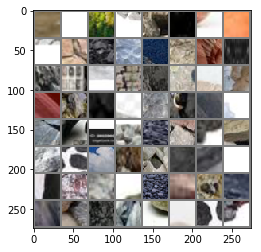

207
tensor([5, 0, 3, 2, 1, 2, 5, 5, 4, 5, 2, 0, 2, 0, 3, 5, 2, 0, 5, 5, 4, 5, 0, 0,
        2, 0, 4, 5, 2, 6, 1, 2, 3, 0, 6, 6, 5, 6, 4, 5, 0, 0, 2, 1, 2, 5, 3, 4,
        5, 0, 0, 2, 1, 5, 2, 5, 5, 4, 1, 5, 5, 2, 6, 5])
(64, 3, 32, 32)
('5_2567.jpg', '0_4493.jpg', '3_1235.jpg', '2_2728.jpg', '1_668.jpg', '2_973.jpg', '5_2201.jpg', '5_51.jpg', '4_2573.jpg', '5_1708.jpg', '2_1221.jpg', '0_1299.jpg', '2_1235.jpg', '0_2948.jpg', '3_256.JPEG', '5_2215.jpg', '2_967.jpg', '0_2790.jpg', '5_45.jpg', '5_258.jpg', '4_1708.jpg', '5_2573.jpg', '0_4487.jpg', '0_309.jpg', '2_1553.jpg', '0_2223.png', '4_2201.jpg', '5_516.jpg', '2_64.jpg', '6_1954.jpg', '1_132.jpg', '2_2072.jpg', '3_1209.jpg', '0_321.jpg', '6_2050.png', '6_2285.jpg', '5_1052.jpg', '6_1568.jpeg', '4_2229.jpg', '5_1734.jpg', '0_2960.jpg', '0_447.jpg', '2_797.jpg', '1_654.jpg', '2_2714.jpg', '5_3123.jpg', '3_584.jpg', '4_1046.jpg', '5_270.jpg', '0_453.jpg', '0_2974.jpg', '2_783.jpg', '1_640.jpg', '5_3137.jpg', '2_2700.jpg', '5_79.jpg', '

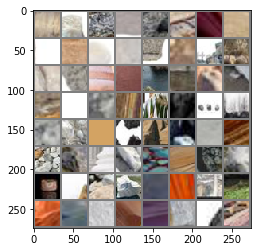

208
tensor([3, 4, 2, 5, 4, 6, 1, 2, 0, 6, 4, 5, 1, 3, 5, 2, 0, 2, 5, 5, 2, 6, 0, 1,
        2, 5, 4, 6, 4, 2, 5, 1, 2, 6, 4, 4, 5, 3, 5, 6, 1, 5, 4, 4, 5, 3, 2, 2,
        5, 0, 0, 2, 4, 4, 5, 2, 0, 5, 0, 0, 6, 0, 5, 5])
(64, 3, 32, 32)
('3_90.JPEG', '4_1734.jpg', '2_70.jpg', '5_502.jpg', '4_711.jpg', '6_1940.jpg', '1_126.jpg', '2_2066.jpg', '0_335.jpg', '6_1798.jpg', '4_1044.jpg', '5_272.jpg', '1_656.jpg', '3_586.jpg', '5_3121.jpg', '2_2716.jpg', '0_445.jpg', '2_795.jpg', '5_1736.jpg', '5_1050.jpg', '2_1579.jpg', '6_2287.jpg', '0_323.jpg', '1_130.jpg', '2_2070.jpg', '5_2559.jpg', '4_707.jpg', '6_1956.jpg', '4_1722.jpg', '2_66.jpg', '5_514.jpg', '1_124.jpg', '2_2064.jpg', '6_1942.jpg', '4_713.jpg', '4_1736.jpg', '5_500.jpg', '3_734.JPEG', '5_1044.jpg', '6_2293.jpg', '1_497.png', '5_1722.jpg', '4_2559.jpg', '4_1050.jpg', '5_266.jpg', '3_364.JPEG', '2_959.jpg', '2_2702.jpg', '5_3135.jpg', '0_2976.jpg', '0_451.jpg', '2_1223.jpg', '4_2571.jpg', '4_1078.jpg', '5_2203.jpg', '2_971.jpg', '0_2

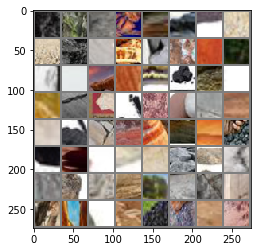

209
tensor([4, 2, 5, 2, 0, 3, 2, 5, 6, 2, 5, 5, 6, 0, 5, 3, 2, 4, 0, 6, 3, 1, 0, 0,
        2, 0, 4, 0, 6, 6, 6, 0, 4, 6, 5, 6, 5, 0, 5, 6, 6, 4, 6, 0, 0, 1, 0, 2,
        4, 1, 2, 6, 0, 6, 5, 6, 2, 1, 5, 0, 5, 2, 6, 6])
(64, 3, 32, 32)
('4_2217.jpg', '2_1545.jpg', '5_1078.jpg', '2_1551.jpg', '0_4485.jpg', '3_1223.jpg', '2_2058.jpg', '5_2571.jpg', '6_6.jpeg', '2_965.jpg', '5_2217.jpg', '5_47.jpg', '6_399.jpg', '0_2792.jpg', '5_3109.jpg', '3_1545.jpg', '2_1237.jpg', '4_2565.jpg', '0_1270.jpg', '6_2522.jpg', '3_108.JPEG', '1_695.jpg', '0_3467.jpg', '0_486.jpg', '2_756.jpg', '0_4308.jpg', '4_1087.jpg', '0_2779.jpg', '6_372.jpg', '6_414.jpg', '6_1995.jpg', '0_3301.jpg', '4_1939.jpg', '6_2244.jpg', '5_1093.jpg', '6_2250.jpg', '5_1087.jpg', '0_1502.jpg', '5_2.jpg', '6_400.jpg', '6_1981.jpg', '4_908.jpg', '6_1759.jpg', '0_3315.jpg', '0_3473.jpg', '1_681.jpg', '0_492.jpg', '2_742.jpg', '4_1093.jpg', '1_859.jpg', '2_2919.jpg', '6_366.jpg', '0_1264.jpg', '6_2536.jpg', '5_1939.jpg', '6_1017.jpg',

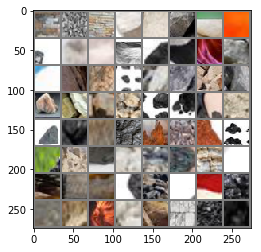

210
tensor([0, 2, 6, 4, 0, 4, 0, 0, 4, 6, 4, 0, 2, 0, 5, 0, 6, 0, 5, 2, 0, 5, 5, 0,
        4, 4, 5, 2, 1, 5, 6, 6, 5, 4, 5, 4, 3, 2, 0, 2, 5, 3, 1, 4, 3, 4, 6, 2,
        0, 3, 5, 2, 1, 5, 3, 4, 5, 4, 2, 6, 3, 6, 5, 5])
(64, 3, 32, 32)
('0_2023.jpg', '2_99.jpg', '6_1771.jpg', '4_920.jpg', '0_4452.jpg', '4_1905.jpg', '0_2037.jpg', '0_4446.jpg', '4_934.jpg', '6_1765.jpg', '4_1911.jpg', '0_3329.jpg', '2_1592.jpg', '0_1258.jpg', '5_1905.jpg', '0_4320.jpg', '6_1003.jpg', '0_2989.jpg', '5_299.jpg', '2_2925.jpg', '0_2751.jpg', '5_84.jpg', '5_716.jpg', '0_785.jpeg', '4_1520.jpg', '4_505.jpg', '5_3445.jpg', '2_2272.jpg', '1_332.jpg', '5_2983.jpg', '6_2085.jpg', '6_1548.jpeg', '5_1252.jpg', '4_2029.jpg', '5_1534.jpg', '4_2997.jpg', '3_551.png', '2_597.jpg', '0_647.jpg', '2_2514.jpg', '5_3323.jpg', '3_784.jpg', '1_454.jpg', '4_263.jpg', '3_299.JPEG', '4_1246.jpg', '6_3125.jpeg', '2_583.jpg', '0_653.jpg', '3_790.jpg', '5_3337.jpg', '2_2500.jpg', '1_440.jpg', '5_2029.jpg', '3_948.jpg', '4_1252.jpg

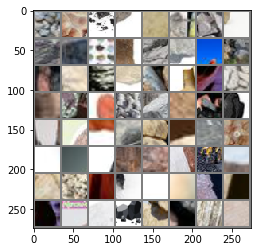

211
tensor([4, 4, 2, 5, 5, 6, 6, 0, 2, 4, 1, 4, 5, 5, 3, 6, 3, 1, 2, 0, 5, 0, 3, 4,
        1, 5, 6, 2, 1, 4, 6, 0, 2, 3, 3, 0, 5, 0, 3, 4, 5, 0, 6, 2, 0, 4, 5, 2,
        6, 5, 0, 5, 2, 1, 5, 6, 6, 6, 4, 6, 2, 0, 0, 4])
(64, 3, 32, 32)
('4_1534.jpg', '4_511.jpg', '2_2266.jpg', '5_3451.jpg', '5_2997.jpg', '6_1598.jpg', '6_819.jpg', '0_1933.jpg', '2_1747.jpg', '4_2015.jpg', '1_1099.jpg', '4_539.jpg', '5_2767.jpg', '5_3479.jpg', '3_1035.jpg', '6_831.jpg', '3_1753.jpg', '1_468.jpg', '2_2528.jpg', '0_2584.jpg', '5_2001.jpg', '0_3842.jpg', '3_960.jpg', '4_2773.jpg', '1_865.png', '5_1508.jpg', '6_2907.jpg', '2_1021.jpg', '1_23.jpg', '4_2767.jpg', '6_2913.jpg', '0_1099.jpg', '2_1035.jpg', '3_1747.jpg', '3_1551.JPEG', '0_2590.jpg', '5_2015.jpg', '0_3856.jpg', '3_974.jpg', '4_1508.jpg', '5_2773.jpg', '0_109.jpg', '6_825.jpg', '2_1753.jpg', '0_1154.jpeg', '4_2001.jpg', '5_1291.jpg', '2_1960.jpg', '6_2046.jpg', '5_3486.jpg', '0_3103.jpg', '5_2940.jpg', '2_232.jpg', '1_1066.jpg', '5_2798.jpg', '6_

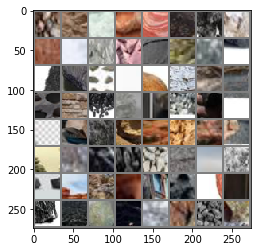

212
tensor([6, 0, 4, 6, 4, 0, 6, 4, 2, 0, 1, 0, 3, 5, 5, 0, 5, 1, 6, 0, 5, 2, 3, 6,
        5, 6, 0, 3, 0, 2, 4, 0, 0, 0, 0, 2, 6, 0, 0, 0, 4, 0, 6, 0, 6, 2, 2, 2,
        5, 5, 0, 2, 6, 3, 5, 2, 1, 2, 4, 5, 4, 5, 6, 2])
(64, 3, 32, 32)
('6_2720.jpg', '0_1072.jpg', '4_2940.jpg', '6_2734.jpg', '4_2798.jpg', '0_848.jpg', '6_164.jpg', '4_1291.jpg', '2_540.jpg', '0_690.jpg', '1_483.jpg', '0_3671.jpg', '3_1228.JPEG', '5_3492.jpg', '5_919.jpg', '0_3117.jpg', '5_2954.jpg', '1_1072.jpg', '6_602.jpg', '0_1700.jpg', '5_1285.jpg', '2_1974.jpg', '3_1678.JPEG', '6_2052.jpg', '5_931.jpg', '6_1573.jpg', '0_2221.jpg', '3_1697.JPEG', '0_1728.jpg', '2_1784.jpg', '4_2968.jpg', '0_860.jpg', '0_2547.jpg', '0_3881.jpg', '0_4136.jpg', '2_568.jpg', '6_1215.jpg', '0_3659.jpg', '0_2553.jpg', '0_874.jpg', '4_288.jpg', '0_3895.jpg', '6_1201.jpg', '0_4122.jpg', '6_2708.jpg', '2_1948.jpg', '2_1790.jpg', '2_2299.jpg', '5_925.jpg', '5_2968.jpg', '0_2235.jpg', '2_385.jpg', '6_979.jpg', '3_196.jpg', '5_3531.jpg', '2_23

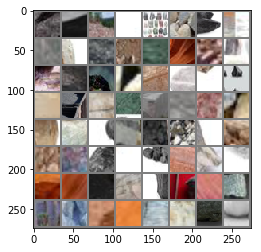

213
tensor([5, 5, 3, 4, 5, 4, 2, 5, 1, 0, 5, 6, 4, 4, 5, 2, 1, 4, 0, 3, 5, 3, 4, 5,
        2, 2, 5, 1, 4, 6, 5, 4, 4, 2, 0, 0, 3, 6, 0, 5, 0, 0, 5, 2, 4, 0, 5, 5,
        3, 0, 3, 2, 6, 2, 5, 6, 4, 0, 5, 1, 2, 0, 3, 3])
(64, 3, 32, 32)
('5_1440.jpg', '5_104.jpg', '3_828.jpg', '4_1332.jpg', '5_2149.jpg', '4_317.jpg', '2_2460.jpg', '5_3257.jpg', '1_520.jpg', '0_733.jpg', '5_110.jpg', '6_3133.jpeg', '4_1326.jpg', '4_303.jpg', '5_3243.jpg', '2_2474.jpg', '1_534.jpg', '4_13.jpg', '0_727.jpg', '3_1052.JPEG', '5_1454.jpg', '3_775.JPEG', '4_2149.jpg', '5_1332.jpg', '2_391.jpg', '2_2312.jpg', '5_3525.jpg', '1_252.jpg', '4_465.jpg', '6_3099.jpeg', '5_676.jpg', '4_1440.jpg', '4_2161.jpg', '2_1633.jpg', '0_4532.png', '0_1847.jpg', '3_1141.jpg', '6_3076.jpeg', '0_3088.jpg', '5_886.jpg', '0_2396.jpg', '0_3485.jpeg', '5_2613.jpg', '2_3024.jpg', '4_1468.jpg', '0_3936.jpg', '5_138.jpg', '5_2175.jpg', '3_1627.jpg', '0_4081.jpg', '3_1547.JPEG', '2_1155.jpg', '6_2873.jpg', '2_1141.jpg', '5_1468.jpg', '6_

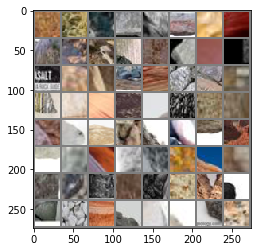

214
tensor([5, 5, 0, 6, 4, 2, 5, 4, 2, 0, 6, 6, 0, 1, 4, 2, 5, 5, 3, 1, 5, 0, 2, 0,
        1, 0, 5, 4, 0, 5, 6, 4, 3, 5, 0, 2, 6, 4, 5, 2, 3, 1, 0, 6, 2, 0, 0, 3,
        5, 5, 3, 0, 2, 2, 3, 2, 6, 0, 0, 0, 0, 2, 0, 0])
(64, 3, 32, 32)
('5_3519.jpg', '5_892.jpg', '0_2382.jpg', '6_789.jpg', '4_459.jpg', '2_3030.jpg', '5_2607.jpg', '4_2175.jpg', '2_1627.jpg', '0_1853.jpg', '6_2132.jpg', '6_762.jpg', '0_2369.jpg', '1_1112.jpg', '4_1497.jpg', '2_346.jpg', '5_2834.jpg', '5_879.jpg', '3_155.jpg', '1_285.jpg', '5_3294.jpg', '0_3711.jpg', '2_420.jpg', '0_928.jpg', '1_6.jpg', '0_1106.jpg', '5_1483.jpg', '4_2820.jpg', '0_1112.jpg', '5_1497.jpg', '6_2640.jpg', '4_2834.jpg', '3_627.jpg', '5_3280.jpg', '0_3705.jpg', '2_434.jpg', '6_776.jpg', '4_1483.jpg', '5_2820.jpg', '2_352.jpg', '3_141.jpg', '1_291.jpg', '0_3063.jpg', '6_2126.jpg', '2_1800.jpg', '0_1674.jpg', '0_2355.jpg', '3_1182.jpg', '5_2808.jpg', '5_845.jpg', '3_1357.png', '0_1884.jpg', '2_1828.jpg', '2_1266.webp', '3_1431.png', '2_1196.jpg

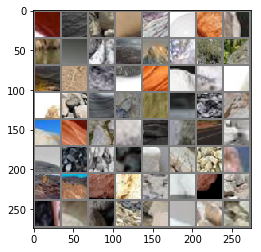

215
tensor([4, 0, 0, 0, 5, 6, 5, 3, 0, 0, 1, 5, 2, 4, 2, 6, 4, 3, 5, 4, 5, 6, 0, 4,
        5, 1, 4, 5, 6, 4, 2, 3, 0, 2, 4, 5, 5, 4, 3, 2, 0, 2, 4, 2, 5, 5, 3, 0,
        6, 0, 0, 6, 2, 5, 4, 4, 5, 4, 0, 2, 0, 3, 5, 4])
(64, 3, 32, 32)
('4_2808.jpg', '0_1890.jpg', '0_1648.jpg', '0_2341.jpg', '5_689.jpg', '6_1413.jpg', '5_851.jpg', '3_1419.jpg', '0_2816.jpg', '0_531.jpg', '1_722.jpg', '5_3055.jpg', '2_2662.jpg', '4_115.jpg', '2_839.jpg', '6_2898.png', '4_1130.jpg', '3_1455.jpeg', '5_306.jpg', '4_2439.jpg', '5_1642.jpg', '6_2495.jpg', '0_63.jpg', '4_3041.jpg', '5_1124.jpg', '1_1106.png', '4_1656.jpg', '5_460.jpg', '6_1822.jpg', '4_673.jpg', '2_2104.jpg', '3_394.jpg', '0_257.jpg', '2_187.jpg', '4_1642.jpg', '5_474.jpg', '5_2439.jpg', '4_667.jpg', '3_380.jpg', '2_2110.jpg', '0_243.jpg', '2_193.jpg', '4_3055.jpg', '2_1419.jpg', '5_1130.jpg', '5_1656.jpg', '3_5.JPEG', '0_77.jpg', '6_2481.jpg', '0_525.jpg', '0_2802.jpg', '6_1188.jpg', '2_2676.jpg', '5_3041.jpg', '4_101.jpg', '4_1124.jpg', '5

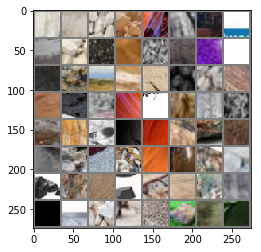

216
tensor([2, 5, 2, 5, 0, 2, 4, 3, 6, 2, 5, 4, 4, 2, 0, 4, 5, 5, 3, 4, 6, 0, 0, 6,
        5, 2, 2, 4, 4, 2, 0, 6, 5, 5, 0, 3, 6, 5, 1, 2, 2, 0, 5, 3, 0, 4, 2, 6,
        4, 6, 6, 0, 0, 6, 4, 0, 4, 6, 4, 0, 3, 0, 2, 4])
(64, 3, 32, 32)
('2_805.jpg', '5_2377.jpg', '2_2886.jpg', '5_2411.jpg', '0_2194.jpg', '2_2138.jpg', '4_897.jpg', '3_1343.jpg', '6_992.png', '2_1431.jpg', '5_1118.jpg', '4_2363.jpg', '4_3069.jpg', '2_1425.jpg', '0_1489.jpg', '4_2377.jpg', '5_448.jpg', '5_2405.jpg', '3_237.JPEG', '4_883.jpg', '6_2668.png', '0_4297.jpg', '0_519.jpg', '6_3021.jpeg', '5_2363.jpg', '2_811.jpg', '2_2892.jpg', '4_1118.jpg', '4_2411.jpg', '2_1343.jpg', '0_4042.png', '6_2456.jpg', '5_1859.jpg', '5_1681.jpg', '0_1304.jpg', '3_4.jpg', '6_206.jpg', '5_2388.jpg', '1_939.jpg', '2_2879.jpg', '2_622.jpg', '0_3513.jpg', '5_3096.jpg', '3_357.jpg', '0_294.jpg', '4_868.jpg', '2_144.jpg', '6_1639.jpg', '4_1695.jpg', '6_560.jpg', '6_2149.jpeg', '0_1462.jpg', '0_2040.jpeg', '6_2330.jpg', '4_3082.jpg', '0_1476

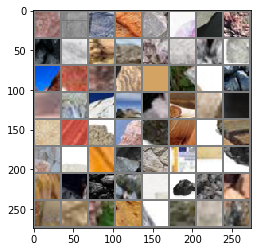

217
tensor([6, 0, 6, 2, 0, 5, 3, 6, 5, 0, 0, 2, 1, 0, 6, 2, 5, 0, 6, 4, 0, 0, 4, 2,
        4, 6, 4, 3, 4, 2, 5, 0, 2, 1, 6, 0, 2, 3, 6, 0, 4, 3, 4, 6, 0, 4, 2, 3,
        6, 0, 1, 2, 0, 5, 0, 2, 0, 3, 5, 2, 0, 6, 1, 2])
(64, 3, 32, 32)
('6_574.jpg', '0_2619.jpg', '6_212.jpg', '2_636.jpg', '0_4268.jpg', '5_3082.jpg', '3_425.jpg', '6_2442.jpg', '5_1695.jpg', '0_1310.jpg', '0_2631.jpg', '2_2845.jpg', '1_905.jpg', '0_4240.jpg', '6_1163.jpg', '2_1394.jpg', '5_1865.jpg', '0_1338.jpg', '6_3012.jpg', '4_1871.jpg', '0_3249.jpg', '0_4526.jpg', '4_854.jpg', '2_178.jpg', '4_1865.jpg', '6_1611.jpg', '4_840.jpg', '3_1394.jpg', '4_698.jpg', '2_1380.jpg', '5_1871.jpg', '0_2625.jpg', '2_2851.jpg', '1_911.jpg', '6_1177.jpg', '0_4254.jpg', '2_2689.jpg', '3_419.jpg', '6_2319.jpg', '0_2142.jpg', '4_699.jpg', '3_1395.jpg', '4_841.jpg', '6_1610.jpg', '0_4533.jpg', '4_1864.jpg', '2_2688.jpg', '3_418.jpg', '6_1176.jpg', '0_4255.jpg', '1_910.jpg', '2_2850.jpg', '0_2624.jpg', '5_1870.jpg', '0_89.jpg', '2_1381.j

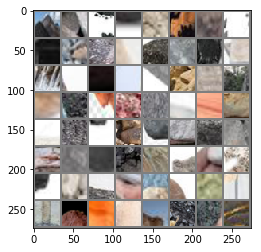

218
tensor([0, 0, 3, 0, 2, 6, 4, 4, 0, 3, 6, 6, 4, 2, 0, 0, 4, 3, 4, 6, 4, 0, 0, 5,
        6, 5, 3, 0, 2, 0, 0, 3, 5, 0, 6, 2, 2, 1, 5, 6, 5, 5, 4, 6, 0, 6, 4, 6,
        2, 4, 0, 0, 4, 0, 5, 5, 3, 4, 4, 2, 3, 4, 4, 6])
(64, 3, 32, 32)
('0_2630.jpg', '0_2156.jpg', '3_1381.jpg', '0_4527.jpg', '2_179.jpg', '6_1604.jpg', '4_855.jpg', '4_1870.jpg', '0_3248.jpg', '3_1154.png', '6_3013.jpg', '6_575.jpg', '4_1680.jpg', '2_151.jpg', '0_281.jpg', '0_3260.jpg', '4_1858.jpg', '3_197.png', '4_3097.jpg', '6_2325.jpg', '4_2389.jpg', '0_1477.jpg', '0_1311.jpg', '5_1694.jpg', '6_2443.jpg', '5_3083.jpg', '3_424.jpg', '0_3506.jpg', '2_637.jpg', '0_4269.jpg', '0_2618.jpg', '3_430.jpg', '5_3097.jpg', '0_3512.jpg', '6_2682.png', '2_623.jpg', '2_2878.jpg', '1_938.jpg', '5_2389.jpg', '6_207.jpg', '5_1680.jpg', '5_1858.jpg', '4_3083.jpg', '6_2331.jpg', '0_1463.jpg', '6_561.jpg', '4_1694.jpg', '6_1638.jpg', '2_145.jpg', '4_869.jpg', '0_295.jpg', '0_3274.jpg', '4_882.jpg', '0_2181.jpg', '5_2404.jpg', '5_449.jp

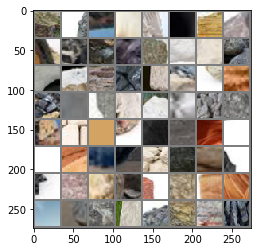

219
tensor([2, 5, 2, 0, 3, 0, 2, 2, 4, 5, 5, 3, 0, 2, 3, 4, 4, 5, 2, 3, 4, 2, 0, 5,
        5, 2, 4, 2, 3, 2, 5, 6, 4, 5, 4, 6, 5, 4, 4, 2, 5, 6, 0, 6, 0, 5, 3, 0,
        6, 5, 5, 4, 2, 4, 5, 2, 1, 3, 0, 0, 2, 0, 2, 4])
(64, 3, 32, 32)
('2_2893.jpg', '5_2362.jpg', '2_810.jpg', '0_518.jpg', '3_1430.jpg', '0_4296.jpg', '2_2887.jpg', '2_804.jpg', '4_128.jpg', '5_2376.jpg', '5_3068.jpg', '3_1424.jpg', '0_4282.jpg', '2_1356.jpg', '3_889.jpeg', '4_2404.jpg', '4_2362.jpg', '5_1119.jpg', '2_1430.jpg', '3_1197.png', '4_896.jpg', '2_2139.jpg', '0_2195.jpg', '5_2410.jpg', '5_1131.jpg', '2_1418.jpg', '4_3054.jpg', '2_192.jpg', '3_381.jpg', '2_2111.jpg', '5_2438.jpg', '6_1837.jpg', '4_666.jpg', '5_475.jpg', '4_1643.jpg', '6_2098.jpeg', '5_313.jpg', '4_1125.jpg', '4_100.jpg', '2_2677.jpg', '5_3040.jpg', '6_1189.jpg', '0_2803.jpg', '6_2480.jpg', '0_76.jpg', '5_1657.jpg', '3_866.jpeg', '0_62.jpg', '6_2494.jpg', '5_1643.jpg', '5_307.jpg', '4_1131.jpg', '2_838.jpg', '4_114.jpg', '5_3054.jpg', '2_2663.j

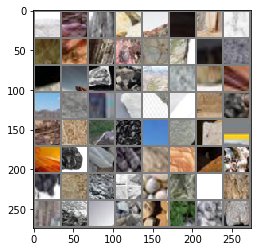

220
tensor([6, 5, 4, 5, 4, 4, 0, 0, 0, 6, 2, 3, 5, 6, 5, 0, 0, 0, 2, 3, 0, 5, 5, 3,
        6, 0, 0, 0, 0, 6, 0, 6, 6, 6, 0, 3, 5, 4, 6, 6, 5, 0, 2, 6, 0, 1, 0, 3,
        5, 2, 4, 1, 6, 0, 3, 5, 2, 5, 4, 1, 0, 6, 0, 6])
(64, 3, 32, 32)
('6_1823.jpg', '5_461.jpg', '4_1657.jpg', '5_1125.jpg', '4_3040.jpg', '4_2809.jpg', '0_2426.jpg', '0_901.jpg', '0_4057.jpg', '6_1374.jpg', '2_409.jpg', '3_1496.JPEG', '5_850.jpg', '6_993.jpg', '5_688.jpg', '0_2340.jpg', '0_1649.jpg', '0_1891.jpg', '2_1829.jpg', '3_1356.png', '0_3807.jpeg', '5_844.jpg', '5_2809.jpg', '3_1183.jpg', '6_987.jpg', '0_2354.jpg', '0_915.jpg', '0_2432.jpg', '0_2345.jpeg', '6_1360.jpg', '0_4043.jpg', '6_2669.jpg', '6_1348.jpg', '6_2759.jpeg', '0_3704.jpg', '3_626.jpg', '5_3281.jpg', '4_2835.jpg', '6_2641.jpg', '6_2899.jpg', '5_1496.jpg', '0_1113.jpg', '2_1801.jpg', '6_2127.jpg', '0_3062.jpg', '1_290.jpg', '0_1653.webp', '3_140.jpg', '5_2821.jpg', '2_353.jpg', '4_1482.jpg', '1_1107.jpg', '6_777.jpg', '0_3076.jpg', '3_154.jpg', '5

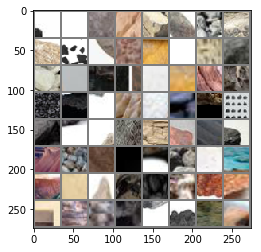

221
tensor([4, 6, 5, 0, 1, 2, 0, 5, 0, 3, 2, 5, 0, 4, 5, 6, 2, 0, 2, 4, 4, 2, 5, 6,
        0, 5, 5, 3, 6, 6, 4, 6, 5, 2, 5, 0, 3, 6, 0, 0, 2, 4, 3, 4, 6, 2, 0, 3,
        5, 5, 0, 5, 3, 0, 1, 4, 5, 2, 4, 4, 5, 4, 5, 4])
(64, 3, 32, 32)
('4_2821.jpg', '6_2655.jpg', '5_1482.jpg', '0_1107.jpg', '1_7.jpg', '2_421.jpg', '0_3710.jpg', '5_3295.jpg', '0_4094.jpg', '3_1632.jpg', '2_2449.jpg', '5_2160.jpg', '0_3923.jpg', '4_2612.jpg', '5_1469.jpg', '6_2866.jpg', '2_1140.jpg', '0_1852.jpg', '2_1626.jpg', '4_2174.jpg', '4_458.jpg', '2_3031.jpg', '5_2606.jpg', '6_788.jpg', '0_2383.jpg', '5_3518.jpg', '5_893.jpg', '3_27.jpg', '6_393.jpeg', '6_950.jpg', '4_1469.jpg', '6_2923.jpeg', '5_2612.jpg', '2_3025.jpg', '5_887.jpg', '0_3089.jpg', '3_33.jpg', '6_944.jpg', '0_4507.jpeg', '0_1846.jpg', '2_1632.jpg', '4_2160.jpg', '3_1750.JPEG', '4_2606.jpg', '6_2872.jpg', '2_1154.jpg', '0_4080.jpg', '3_1626.jpg', '5_2174.jpg', '5_139.jpg', '0_3937.jpg', '5_1455.jpg', '3_1615.JPEG', '0_726.jpg', '1_535.jpg', '4_12

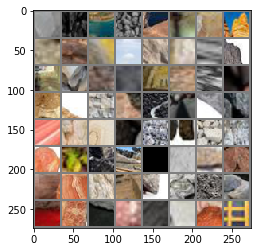

222
tensor([1, 3, 5, 3, 2, 3, 5, 4, 5, 4, 5, 2, 4, 5, 2, 6, 2, 0, 2, 5, 5, 4, 4, 3,
        5, 5, 6, 2, 6, 0, 0, 6, 0, 4, 6, 0, 0, 6, 2, 5, 2, 2, 0, 0, 0, 6, 5, 0,
        0, 6, 2, 0, 0, 0, 4, 0, 1, 2, 4, 6, 0, 0, 4, 6])
(64, 3, 32, 32)
('1_253.jpg', '3_1245.jpeg', '5_3524.jpg', '3_183.jpg', '2_390.jpg', '3_356.png', '5_1333.jpg', '4_2148.jpg', '5_1327.jpg', '4_1455.jpg', '5_663.jpg', '2_3019.jpg', '4_470.jpg', '5_3530.jpg', '2_2307.jpg', '6_978.jpg', '2_384.jpg', '0_732.jpg', '2_2461.jpg', '5_3256.jpg', '5_2148.jpg', '4_316.jpg', '4_1333.jpg', '3_829.jpg', '5_105.jpg', '5_1441.jpg', '6_213.png', '2_1168.jpg', '6_2696.jpg', '0_4502.webp', '0_2353.jpeg', '6_1200.jpg', '0_3894.jpg', '4_289.jpg', '6_159.jpg', '0_2552.jpg', '0_2234.jpg', '6_1566.jpg', '2_2298.jpg', '5_924.jpg', '2_1791.jpg', '2_1949.jpg', '0_341.jpeg', '0_1729.jpg', '0_2220.jpg', '6_1572.jpg', '5_930.jpg', '0_3658.jpg', '0_4137.jpg', '6_1214.jpg', '2_569.jpg', '0_3880.jpg', '0_2546.jpg', '0_861.jpg', '4_2969.jpg', '0_3670.

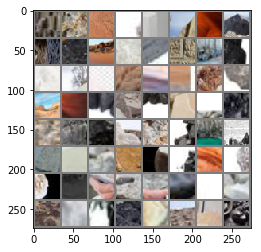

223
tensor([4, 6, 2, 5, 0, 0, 6, 0, 1, 5, 0, 5, 5, 6, 5, 1, 5, 2, 0, 5, 6, 2, 5, 6,
        3, 4, 1, 0, 0, 2, 6, 4, 6, 3, 5, 3, 0, 2, 0, 6, 4, 1, 4, 2, 0, 6, 0, 5,
        4, 6, 6, 5, 5, 1, 4, 0, 2, 5, 6, 4, 1, 3, 0, 5])
(64, 3, 32, 32)
('4_2941.jpg', '6_2053.jpg', '2_1975.jpg', '5_1284.jpg', '0_1701.jpg', '0_2208.jpg', '6_603.jpg', '0_654.jpeg', '1_1073.jpg', '5_2955.jpg', '0_3116.jpg', '5_3493.jpg', '5_918.jpg', '6_617.jpg', '5_2799.jpg', '1_1067.jpg', '5_2941.jpg', '2_233.jpg', '0_3102.jpg', '5_3487.jpg', '6_2047.jpg', '2_1961.jpg', '5_1290.jpg', '6_2721.jpg', '3_1578.png', '4_2955.jpg', '1_496.jpg', '0_3664.jpg', '0_685.jpg', '2_555.jpg', '6_1228.jpg', '4_1284.jpg', '6_171.jpg', '3_975.jpg', '5_2014.jpg', '3_1316.JPEG', '0_3684.jpeg', '2_1034.jpg', '0_1098.jpg', '6_2912.jpg', '4_2766.jpg', '1_22.jpg', '4_2000.jpg', '2_1752.jpg', '0_1926.jpg', '6_824.jpg', '0_108.jpg', '5_2772.jpg', '4_1509.jpg', '6_2935.jpeg', '6_830.jpg', '5_3478.jpg', '5_2766.jpg', '1_1098.jpg', '4_2014.jpg', '0_

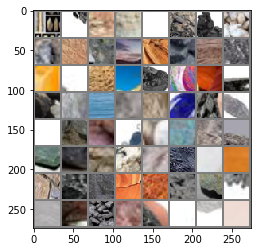

224
tensor([0, 2, 1, 3, 2, 4, 5, 4, 3, 5, 4, 1, 3, 5, 2, 0, 2, 6, 0, 5, 6, 1, 5, 4,
        4, 5, 5, 6, 6, 4, 5, 6, 3, 0, 5, 1, 5, 2, 4, 4, 5, 4, 4, 1, 2, 5, 2, 4,
        3, 5, 1, 2, 4, 0, 6, 4, 0, 0, 5, 5, 2, 0, 0, 6])
(64, 3, 32, 32)
('0_2585.jpg', '2_2529.jpg', '1_469.jpg', '3_1752.jpg', '2_1008.jpg', '4_2982.jpg', '5_1521.jpg', '4_1253.jpg', '3_949.jpg', '5_2028.jpg', '4_276.jpg', '1_441.jpg', '3_791.jpg', '5_3336.jpg', '2_2501.jpg', '0_652.jpg', '2_582.jpg', '6_818.jpg', '0_134.jpg', '5_2996.jpg', '6_1599.jpg', '1_327.jpg', '5_3450.jpg', '4_510.jpg', '4_1535.jpg', '5_703.jpg', '5_1247.jpg', '6_17.jpg', '6_2090.jpg', '4_2028.jpg', '5_1253.jpg', '6_2084.jpg', '3_1008.jpg', '0_120.jpg', '5_2982.jpg', '1_333.jpg', '5_3444.jpg', '2_2273.jpg', '4_504.jpg', '4_1521.jpg', '5_717.jpg', '4_1247.jpg', '4_262.jpg', '1_455.jpg', '2_2515.jpg', '5_3322.jpg', '2_596.jpg', '4_2996.jpg', '3_124.JPEG', '5_1535.jpg', '1_858.png', '2_1593.jpg', '4_1910.jpg', '0_3328.jpg', '6_1764.jpg', '4_935.jpg', '

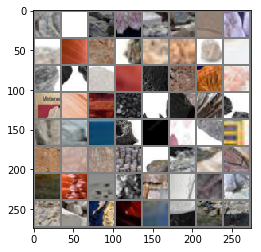

225
tensor([5, 0, 5, 3, 5, 0, 1, 2, 6, 0, 3, 4, 6, 0, 2, 0, 6, 3, 6, 2, 0, 6, 4, 6,
        6, 5, 0, 5, 6, 6, 5, 0, 6, 2, 4, 2, 0, 3, 1, 3, 6, 0, 4, 2, 0, 0, 1, 6,
        0, 5, 0, 6, 3, 0, 4, 6, 6, 5, 1, 6, 2, 3, 0, 5])
(64, 3, 32, 32)
('5_1904.jpg', '0_1259.jpg', '5_1910.jpg', '3_1746.png', '5_91.jpg', '0_2744.jpg', '1_870.jpg', '2_2930.jpg', '6_1016.jpg', '0_4335.jpg', '3_578.jpg', '4_1904.jpg', '6_1770.jpg', '0_4453.jpg', '2_98.jpg', '0_2022.jpg', '6_429.jpg', '3_73.JPEG', '6_2279.jpg', '2_1587.jpg', '0_3314.jpg', '6_1758.jpg', '4_909.jpg', '6_1980.jpg', '6_401.jpg', '5_3.jpg', '0_1503.jpg', '5_1086.jpg', '6_2251.jpg', '6_2537.jpg', '5_1938.jpg', '0_1265.jpg', '6_367.jpg', '2_2918.jpg', '4_1092.jpg', '2_743.jpg', '0_493.jpg', '3_550.jpg', '1_680.jpg', '3_1592.JPEG', '6_373.jpg', '0_2778.jpg', '4_1086.jpg', '2_757.jpg', '0_4309.jpg', '0_3466.jpg', '1_694.jpg', '6_2523.jpg', '0_1271.jpg', '5_1092.jpg', '0_1197.jpeg', '6_2245.jpg', '3_222.jpg', '0_3300.jpg', '4_1938.jpg', '6_1994.jpg'

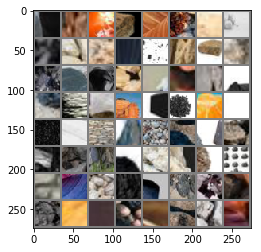

226
tensor([4, 4, 2, 5, 5, 0, 2, 5, 0, 3, 0, 5, 5, 4, 3, 4, 2, 2, 4, 5, 5, 0, 3, 5,
        2, 5, 4, 6, 0, 2, 1, 0, 2, 0, 2, 5, 3, 1, 2, 5, 4, 4, 5, 3, 5, 2, 0, 0,
        5, 2, 1, 5, 4, 5, 2, 4, 5, 6, 4, 2, 1, 0, 2, 5])
(64, 3, 32, 32)
('4_2202.jpg', '4_2564.jpg', '2_1236.jpg', '5_3108.jpg', '5_46.jpg', '0_2793.jpg', '2_964.jpg', '5_2216.jpg', '0_478.jpg', '3_1550.jpg', '0_2787.jpg', '5_52.jpg', '5_2202.jpg', '4_1079.jpg', '3_1711.JPEG', '4_2570.jpg', '2_1222.jpg', '2_1544.jpg', '4_2216.jpg', '5_529.jpg', '5_2564.jpg', '0_4490.jpg', '3_173.JPEG', '5_1045.jpg', '2_73.jpg', '5_501.jpg', '4_1737.jpg', '6_1943.jpg', '0_1715.png', '2_2065.jpg', '1_125.jpg', '0_336.jpg', '2_780.jpg', '0_450.jpg', '2_2703.jpg', '5_3134.jpg', '3_593.jpg', '1_643.jpg', '2_958.jpg', '5_267.jpg', '4_1051.jpg', '4_2558.jpg', '5_1723.jpg', '3_870.JPEG', '5_1737.jpg', '2_794.jpg', '0_2963.jpg', '0_444.jpg', '5_3120.jpg', '2_2717.jpg', '1_657.jpg', '5_273.jpg', '4_1045.jpg', '5_515.jpg', '2_67.jpg', '4_1723.jpg', '5

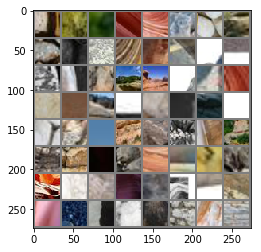

227
tensor([5, 5, 2, 5, 1, 2, 0, 3, 0, 2, 4, 4, 2, 0, 0, 4, 4, 0, 5, 5, 0, 4, 2, 6,
        4, 6, 5, 4, 2, 5, 5, 2, 2, 0, 2, 2, 6, 5, 5, 5, 5, 4, 0, 0, 0, 5, 2, 1,
        2, 5, 1, 0, 5, 4, 6, 4, 6, 5, 5, 4, 1, 2, 1, 4])
(64, 3, 32, 32)
('5_35.jpg', '5_2265.jpg', '2_917.jpg', '5_228.jpg', '1_86.png', '2_2994.jpg', '0_2938.jpg', '3_1537.jpg', '0_4391.jpg', '2_1245.jpg', '4_2517.jpg', '4_2271.jpg', '2_1523.jpg', '0_3398.jpg', '0_379.jpg', '4_985.jpg', '4_1778.jpg', '0_2086.jpg', '5_2503.jpg', '5_3609.jpg', '0_1996.png', '4_991.jpg', '2_28.jpg', '6_499.jpg', '4_749.jpg', '6_1918.jpg', '5_2517.jpg', '4_2265.jpg', '2_1251.jpg', '5_1778.jpg', '5_21.jpg', '2_903.jpg', '2_2980.jpg', '0_4385.jpg', '2_2758.jpg', '2_1279.jpg', '6_2587.jpg', '5_1988.jpg', '5_1750.jpg', '5_2259.jpg', '5_214.jpg', '4_1022.jpg', '0_2936.webp', '0_2904.jpg', '0_423.jpg', '5_3147.jpg', '2_2770.jpg', '1_630.jpg', '2_2016.jpg', '5_3621.jpg', '1_156.jpg', '0_345.jpg', '5_572.jpg', '4_1744.jpg', '6_1930.jpg', '4_761.jpg', 

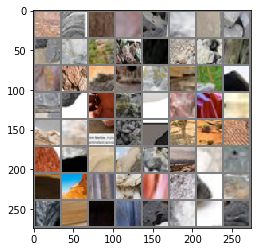

228
tensor([0, 2, 5, 4, 4, 6, 5, 4, 0, 0, 2, 5, 1, 6, 5, 2, 5, 6, 3, 6, 0, 6, 0, 2,
        0, 4, 4, 6, 0, 3, 6, 6, 5, 0, 4, 3, 0, 4, 0, 2, 6, 0, 0, 1, 2, 5, 2, 3,
        5, 3, 0, 6, 6, 5, 6, 6, 3, 0, 4, 0, 6, 3, 1, 0])
(64, 3, 32, 32)
('0_351.jpg', '2_14.jpg', '5_566.jpg', '4_1750.jpg', '4_775.jpg', '6_1924.jpg', '5_200.jpg', '4_1036.jpg', '0_437.jpg', '0_2910.jpg', '2_2764.jpg', '5_3153.jpg', '1_624.jpg', '6_2593.jpg', '5_1744.jpg', '2_1286.jpg', '5_1977.jpg', '6_2578.jpg', '3_1721.png', '6_1071.jpg', '0_4352.jpg', '6_328.jpg', '0_2723.jpg', '2_2957.jpg', '0_2045.jpg', '4_1963.jpg', '4_946.jpg', '6_1717.jpg', '0_4434.jpg', '3_1047.png', '6_3100.jpg', '6_3114.jpg', '5_599.jpg', '0_2051.jpg', '4_1977.jpg', '3_1286.jpg', '0_4420.jpg', '4_952.jpg', '0_4346.jpg', '2_718.jpg', '6_1065.jpg', '0_3429.jpg', '0_2737.jpg', '1_803.jpg', '2_2943.jpg', '5_1963.jpg', '2_730.jpg', '3_528.JPEG', '5_3184.jpg', '3_523.jpg', '0_3401.jpg', '6_2986.jpeg', '6_314.jpg', '5_1793.jpg', '6_2544.jpg', '6_2222.

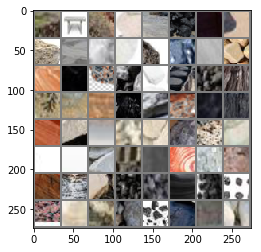

229
tensor([0, 0, 4, 6, 0, 1, 0, 6, 0, 6, 0, 5, 6, 2, 3, 5, 0, 6, 2, 5, 0, 6, 3, 6,
        2, 5, 1, 2, 0, 4, 6, 5, 6, 4, 1, 2, 5, 0, 3, 0, 4, 5, 0, 0, 4, 0, 5, 0,
        6, 1, 2, 2, 0, 4, 0, 2, 5, 0, 5, 6, 5, 3, 0, 5])
(64, 3, 32, 32)
('0_4408.jpg', '0_386.jpg', '4_1793.jpg', '6_466.jpg', '0_3373.jpg', '1_181.jpg', '0_392.jpg', '6_2236.jpg', '0_1564.jpg', '6_3128.jpg', '0_1202.jpg', '5_1787.jpg', '6_2550.jpg', '2_724.jpg', '3_537.jpg', '5_3190.jpg', '0_3415.jpg', '6_300.jpg', '2_2.jpg', '5_2701.jpg', '0_2284.jpg', '6_2601.jpeg', '3_1053.jpg', '6_857.jpg', '2_2228.jpg', '5_994.jpg', '1_368.jpg', '2_1721.jpg', '0_1955.jpg', '4_2073.jpg', '6_58.jpg', '5_1208.jpg', '6_2961.jpg', '4_2715.jpg', '1_51.jpg', '2_1047.jpg', '5_3379.jpg', '0_4193.jpg', '3_906.jpg', '0_3824.jpg', '4_239.jpg', '5_2067.jpg', '0_4187.jpg', '0_609.jpg', '4_1208.jpg', '0_3830.jpg', '5_2073.jpg', '0_4326.jpeg', '6_2975.jpg', '1_45.jpg', '2_1053.jpg', '2_1735.jpg', '0_1941.jpg', '4_2067.jpg', '0_1799.jpg', '2_3122.jpg'

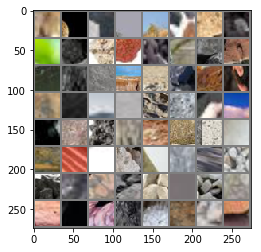

230
tensor([6, 4, 4, 5, 0, 1, 5, 2, 1, 2, 5, 3, 0, 0, 4, 4, 5, 4, 6, 6, 5, 1, 6, 5,
        2, 0, 6, 4, 4, 5, 4, 4, 5, 0, 1, 5, 2, 5, 6, 6, 2, 6, 3, 5, 0, 0, 0, 0,
        0, 6, 3, 2, 0, 2, 2, 3, 6, 0, 6, 5, 0, 6, 1, 6])
(64, 3, 32, 32)
('6_64.jpg', '4_563.jpg', '4_1546.jpg', '5_770.jpg', '0_147.jpg', '1_354.jpg', '5_3423.jpg', '2_2214.jpg', '1_432.jpg', '2_2572.jpg', '5_3345.jpg', '3_1709.jpg', '0_621.jpg', '0_3818.jpg', '4_1220.jpg', '4_205.jpg', '5_1552.jpg', '4_2729.jpg', '6_2785.jpg', '6_2949.jpg', '5_1546.jpg', '1_79.jpg', '6_2791.jpg', '5_3351.jpg', '2_2566.jpg', '0_635.jpg', '6_1298.jpg', '4_1234.jpg', '4_211.jpg', '5_2729.jpg', '4_577.jpg', '4_1552.jpg', '5_764.jpg', '0_153.jpg', '1_340.jpg', '5_3437.jpg', '2_1709.jpg', '5_1220.jpg', '6_70.jpg', '6_1515.jpg', '2_268.jpg', '6_894.jpg', '3_1090.jpg', '5_957.jpg', '0_3159.jpg', '0_2247.jpg', '0_2521.jpg', '0_806.jpg', '0_4150.jpg', '6_1273.jpg', '3_1523.png', '2_1084.jpg', '0_1028.jpg', '2_1090.jpg', '2_2599.jpg', '3_709.jpg', '6

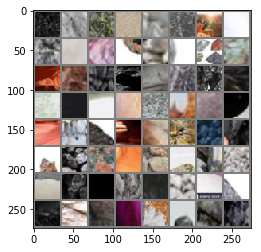

231
tensor([0, 5, 2, 6, 1, 6, 4, 2, 6, 0, 6, 4, 5, 6, 5, 5, 2, 6, 0, 0, 0, 5, 3, 0,
        6, 4, 5, 0, 2, 4, 0, 6, 0, 5, 1, 4, 1, 3, 6, 3, 5, 5, 2, 4, 0, 2, 3, 2,
        4, 6, 5, 0, 3, 4, 6, 4, 5, 0, 0, 3, 5, 4, 2, 3])
(64, 3, 32, 32)
('0_184.jpg', '5_2926.jpg', '2_254.jpg', '6_1529.jpg', '1_397.jpg', '6_670.jpg', '4_1585.jpg', '2_1906.jpg', '6_2482.jpeg', '0_1772.jpg', '6_2746.jpg', '4_2932.jpg', '5_1591.jpg', '6_116.jpg', '5_2098.jpg', '5_3386.jpg', '2_532.jpg', '6_102.jpg', '0_0.jpg', '0_2509.jpg', '0_3617.jpg', '5_3392.jpg', '3_735.jpg', '0_4178.jpg', '6_2752.jpg', '4_2926.jpg', '5_1585.jpg', '0_1000.jpg', '2_1912.jpg', '4_2098.jpg', '0_1766.jpg', '6_2034.jpg', '0_190.jpg', '5_2932.jpg', '1_383.jpg', '4_1591.jpg', '1_1014.jpg', '3_54.jpg', '6_923.jpg', '3_1127.jpg', '5_638.jpg', '5_2675.jpg', '2_3042.jpg', '4_2107.jpg', '0_1821.jpg', '2_1655.jpg', '3_319.png', '2_1133.jpg', '4_2661.jpg', '6_2815.jpg', '5_2113.jpg', '0_2496.jpg', '3_872.jpg', '4_1368.jpg', '6_3006.jpeg', '4_359.jp

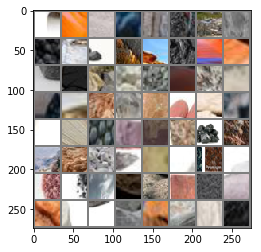

232
tensor([4, 6, 5, 4, 2, 0, 2, 2, 1, 3, 6, 2, 5, 5, 2, 6, 1, 5, 2, 5, 3, 4, 5, 5,
        4, 4, 4, 0, 2, 4, 2, 5, 0, 4, 5, 3, 4, 4, 5, 0, 4, 0, 4, 5, 2, 1, 4, 5,
        2, 1, 2, 5, 5, 5, 4, 5, 6, 0, 6, 2, 0, 5, 3, 6])
(64, 3, 32, 32)
('4_2675.jpg', '6_2801.jpg', '5_1368.jpg', '4_2113.jpg', '2_1899.jpg', '0_1835.jpg', '2_1641.jpg', '2_2348.jpg', '1_208.jpg', '3_40.jpg', '6_937.jpg', '2_3056.jpg', '5_2661.jpg', '5_1340.jpg', '2_1669.jpg', '6_2302.jpeg', '1_220.jpg', '5_3557.jpg', '2_2360.jpg', '5_2891.jpg', '3_68.jpg', '4_1432.jpg', '5_604.jpg', '5_2649.jpg', '4_417.jpg', '4_371.jpg', '4_1354.jpg', '0_755.jpg', '2_485.jpg', '4_61.jpg', '2_2406.jpg', '5_3231.jpg', '0_3561.png', '4_2885.jpg', '5_1426.jpg', '3_457.png', '4_2891.jpg', '4_2649.jpg', '5_1432.jpg', '0_999.jpg', '4_365.jpg', '0_3978.jpg', '4_1340.jpg', '5_176.jpg', '2_491.jpg', '1_552.jpg', '4_75.jpg', '5_3225.jpg', '2_2412.jpg', '1_234.jpg', '2_2374.jpg', '5_3543.jpg', '5_2885.jpg', '5_610.jpg', '4_403.jpg', '5_1354.jpg', '6

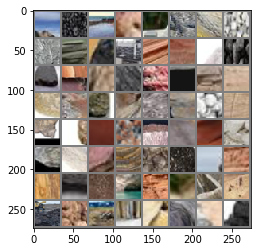

233
tensor([6, 0, 3, 0, 0, 3, 0, 0, 6, 3, 0, 0, 5, 0, 2, 5, 0, 6, 2, 3, 2, 6, 0, 5,
        2, 3, 5, 6, 5, 0, 2, 0, 4, 3, 0, 2, 1, 0, 4, 0, 2, 1, 0, 3, 4, 0, 4, 1,
        6, 6, 3, 5, 0, 2, 6, 0, 5, 5, 6, 2, 6, 1, 2, 3])
(64, 3, 32, 32)
('6_2181.jpeg', '0_4024.jpg', '3_669.jpg', '0_972.jpg', '0_3993.jpg', '3_1457.png', '0_1148.jpg', '0_4030.jpg', '6_1313.jpg', '3_1696.jpg', '0_2441.jpg', '0_966.jpg', '5_189.jpg', '0_3987.jpg', '2_3095.jpg', '5_837.jpg', '0_3039.jpg', '6_1475.jpg', '2_308.jpg', '3_83.jpg', '2_1682.jpg', '6_704.jpg', '0_3011.jpg', '5_3594.jpg', '2_320.jpg', '3_569.JPEG', '5_2852.jpg', '6_2154.jpg', '5_1383.jpg', '0_1606.jpg', '2_1872.jpg', '0_1160.jpg', '4_2846.jpg', '3_139.jpeg', '0_796.jpg', '2_446.jpg', '1_585.jpg', '0_2469.jpg', '4_1397.jpg', '0_782.jpg', '2_452.jpg', '1_591.jpg', '0_3763.jpg', '3_641.jpg', '4_1383.jpg', '0_1174.jpg', '4_2852.jpg', '1_744.png', '6_2626.jpg', '6_2140.jpg', '3_1319.png', '5_1397.jpg', '0_1612.jpg', '2_1866.jpg', '6_710.jpg', '0_3005.jp

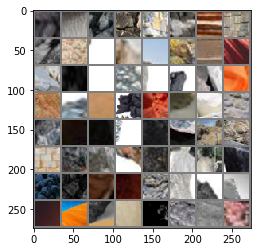

234
tensor([2, 5, 5, 4, 0, 2, 2, 4, 4, 6, 5, 3, 0, 5, 4, 0, 3, 2, 6, 4, 0, 4, 2, 0,
        3, 5, 5, 2, 5, 5, 2, 3, 2, 0, 0, 5, 4, 6, 5, 4, 0, 2, 4, 4, 5, 3, 4, 6,
        5, 4, 5, 4, 6, 2, 3, 2, 5, 2, 0, 0, 5, 4, 1, 5])
(64, 3, 32, 32)
('2_863.jpg', '5_2311.jpg', '5_1618.jpg', '4_2463.jpg', '0_39.jpg', '2_1331.jpg', '2_1457.jpg', '4_2305.jpg', '4_629.jpg', '6_1878.jpg', '5_2477.jpg', '3_1325.jpg', '0_4583.jpg', '5_2463.jpg', '4_1618.jpg', '0_219.jpg', '3_1331.jpg', '2_1443.jpg', '6_1596.jpeg', '4_2311.jpg', '0_1389.jpg', '4_2477.jpg', '2_1325.jpg', '0_2858.jpg', '3_1560.JPEG', '5_348.jpg', '5_2305.jpg', '2_877.jpg', '5_1624.jpg', '5_3033.jpg', '2_2604.jpg', '3_494.jpg', '2_687.jpg', '0_557.jpg', '0_2870.jpg', '5_360.jpg', '4_173.jpg', '6_1844.jpg', '5_406.jpg', '4_1630.jpg', '0_231.jpg', '2_2162.jpg', '4_3027.jpg', '4_2339.jpg', '5_1142.jpg', '3_133.png', '4_3033.jpg', '6_2381.jpg', '5_1156.jpg', '4_601.jpg', '5_412.jpg', '4_1624.jpg', '6_1688.jpg', '2_2176.jpg', '3_480.jpg', '2_2610.

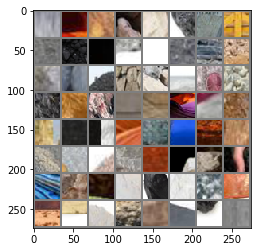

235
tensor([4, 5, 0, 0, 6, 5, 1, 2, 0, 0, 3, 0, 2, 6, 0, 6, 4, 4, 0, 6, 2, 6, 2, 4,
        6, 0, 0, 4, 0, 1, 2, 6, 0, 4, 3, 6, 0, 5, 6, 0, 4, 6, 6, 1, 0, 6, 2, 0,
        3, 6, 0, 6, 0, 5, 6, 2, 3, 0, 5, 6, 6, 4, 2, 0])
(64, 3, 32, 32)
('4_167.jpg', '5_1630.jpg', '0_4018.png', '0_11.jpg', '6_2355.jpeg', '5_1803.jpg', '1_963.jpg', '2_2823.jpg', '0_2657.jpg', '0_3549.jpg', '3_1480.jpg', '0_4226.jpg', '2_678.jpg', '6_1105.jpg', '0_4540.jpg', '6_1663.jpg', '4_832.jpg', '4_1817.jpg', '0_2131.jpg', '6_3074.jpg', '2_1494.jpg', '6_3060.jpg', '2_1480.jpg', '4_826.jpg', '6_1677.jpg', '0_4554.jpg', '0_864.jpeg', '4_1803.jpg', '0_2125.jpg', '1_977.jpg', '2_2837.jpg', '6_248.jpg', '0_2643.jpg', '4_198.jpg', '3_1494.jpg', '6_1111.jpg', '0_4232.jpg', '5_1817.jpg', '6_2418.jpg', '0_3950.png', '4_1195.jpg', '6_260.jpg', '6_2139.jpeg', '1_787.jpg', '0_3575.jpg', '6_1139.jpg', '2_644.jpg', '0_741.png', '3_1669.png', '6_2430.jpg', '0_1362.jpg', '6_3048.jpg', '0_1404.jpg', '5_1181.jpg', '6_2356.jpg', '2_1

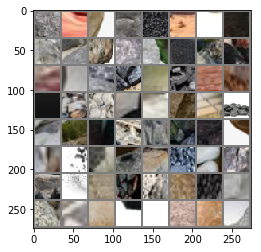

236
tensor([6, 3, 0, 0, 6, 0, 5, 6, 0, 4, 4, 2, 6, 2, 0, 6, 0, 5, 0, 6, 0, 6, 0, 3,
        0, 0, 1, 0, 6, 2, 4, 4, 0, 6, 0, 6, 2, 0, 1, 3, 6, 4, 4, 6, 5, 6, 0, 2,
        6, 5, 0, 0, 2, 4, 4, 0, 2, 5, 6, 3, 4, 0, 6, 2])
(64, 3, 32, 32)
('6_2197.png', '3_325.jpg', '0_3207.jpg', '0_2119.jpg', '6_512.jpg', '0_1410.jpg', '5_1195.jpg', '6_2342.jpg', '0_1376.jpg', '4_2488.jpg', '4_1181.jpg', '2_888.jpg', '6_274.jpg', '2_650.jpg', '0_580.jpg', '6_2343.jpg', '0_3066.jpeg', '5_1194.jpg', '0_1411.jpg', '6_513.jpg', '0_2118.jpg', '6_1892.jpg', '0_3206.jpg', '3_324.jpg', '0_4569.jpg', '0_581.jpg', '1_792.jpg', '0_3560.jpg', '6_275.jpg', '2_889.jpg', '4_1180.jpg', '4_2489.jpg', '0_1377.jpg', '6_2425.jpg', '0_1363.jpg', '6_2431.jpg', '2_645.jpg', '0_3574.jpg', '1_786.jpg', '3_456.jpg', '6_261.jpg', '4_1194.jpg', '4_5.jpg', '6_507.jpg', '5_2489.jpg', '6_1886.jpg', '0_3212.jpg', '2_123.jpg', '6_2357.jpg', '5_1180.jpg', '0_1405.jpg', '0_2124.jpg', '2_2188.jpg', '4_1802.jpg', '4_827.jpg', '0_4555.jpg',

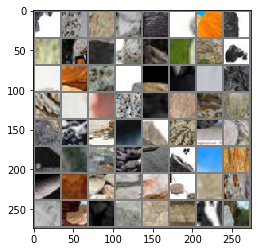

237
tensor([1, 0, 6, 2, 3, 0, 0, 2, 5, 6, 1, 2, 0, 4, 0, 4, 6, 2, 0, 4, 5, 4, 6, 5,
        6, 4, 2, 0, 5, 5, 4, 4, 1, 5, 0, 0, 2, 1, 2, 5, 4, 4, 5, 0, 0, 2, 1, 5,
        2, 3, 3, 5, 5, 4, 6, 4, 2, 0, 3, 5, 6, 4, 4, 2])
(64, 3, 32, 32)
('1_976.jpg', '0_4227.jpg', '6_1104.jpg', '2_679.jpg', '3_1481.jpg', '0_3548.jpg', '0_2656.jpg', '2_2822.jpg', '5_1802.jpg', '6_971.jpeg', '1_209.png', '2_1495.jpg', '0_2130.jpg', '4_1816.jpg', '0_4541.jpg', '4_833.jpg', '6_1662.jpg', '2_2177.jpg', '0_224.jpg', '4_1625.jpg', '5_413.jpg', '4_600.jpg', '6_1851.jpg', '5_1157.jpg', '6_2380.jpg', '4_3032.jpg', '2_1318.jpg', '0_10.jpg', '5_1631.jpg', '5_2338.jpg', '4_166.jpg', '4_1143.jpg', '1_989.jpg', '5_375.jpg', '0_542.jpg', '0_2865.jpg', '2_692.jpg', '1_751.jpg', '2_2611.jpg', '5_3026.jpg', '4_172.jpg', '4_1157.jpg', '5_361.jpg', '0_2871.jpg', '0_556.jpg', '2_686.jpg', '1_745.jpg', '5_3032.jpg', '2_2605.jpg', '3_115.JPEG', '3_898.png', '5_1625.jpg', '5_1143.jpg', '4_2338.jpg', '6_2394.jpg', '4_3026.jpg',

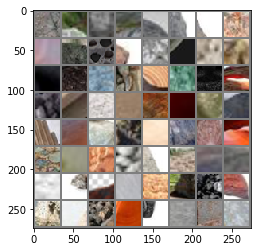

238
tensor([4, 5, 5, 0, 3, 5, 0, 3, 2, 4, 0, 2, 3, 0, 5, 2, 5, 0, 3, 2, 1, 0, 6, 4,
        5, 4, 6, 2, 6, 4, 3, 0, 4, 6, 2, 0, 5, 6, 2, 5, 0, 6, 2, 0, 5, 6, 2, 0,
        6, 5, 6, 5, 5, 3, 0, 6, 6, 6, 4, 0, 3, 1, 0, 2])
(64, 3, 32, 32)
('4_1619.jpg', '5_2462.jpg', '5_2304.jpg', '0_2681.jpg', '3_1327.JPEG', '5_349.jpg', '0_2859.jpg', '3_1456.jpg', '2_1324.jpg', '4_2476.jpg', '0_1388.jpg', '2_1330.jpg', '3_953.jpeg', '0_38.jpg', '5_1619.jpg', '2_862.jpg', '5_2310.jpg', '0_2695.jpg', '3_1442.jpg', '2_2639.jpg', '1_779.jpg', '0_4582.jpg', '6_1879.jpg', '4_628.jpg', '5_2476.jpg', '4_2304.jpg', '6_2457.jpeg', '2_1456.jpg', '6_2627.jpg', '4_2853.jpg', '3_495.png', '0_1175.jpg', '4_1382.jpg', '6_2683.jpeg', '2_453.jpg', '0_783.jpg', '5_2847.jpg', '6_1448.jpg', '2_335.jpg', '5_3581.jpg', '0_3004.jpg', '6_711.jpg', '2_1867.jpg', '0_1613.jpg', '5_1396.jpg', '6_2141.jpg', '2_1873.jpg', '0_1607.jpg', '6_1555.jpeg', '5_1382.jpg', '6_2155.jpg', '5_2853.jpg', '5_3595.jpg', '3_132.jpg', '0_3010.jpg', 

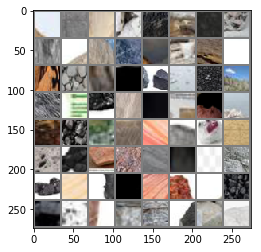

239
tensor([0, 6, 4, 3, 3, 0, 5, 0, 0, 0, 6, 0, 2, 6, 0, 5, 0, 2, 6, 3, 5, 6, 0, 2,
        2, 6, 3, 0, 0, 0, 3, 0, 5, 3, 1, 4, 2, 3, 0, 5, 0, 4, 4, 0, 5, 4, 4, 0,
        6, 5, 4, 5, 4, 5, 2, 5, 1, 5, 4, 5, 5, 5, 2, 1])
(64, 3, 32, 32)
('0_4019.jpg', '6_2633.jpg', '4_2847.jpg', '3_481.png', '3_1059.JPEG', '0_3986.jpg', '5_188.jpg', '0_967.jpg', '0_2440.jpg', '0_4031.jpg', '6_1312.jpg', '0_1149.jpg', '2_1683.jpg', '6_1474.jpg', '0_3038.jpg', '5_836.jpg', '0_2326.jpg', '2_3094.jpg', '6_1460.jpg', '3_96.jpg', '5_822.jpg', '6_739.jpg', '0_2332.jpg', '2_3080.jpg', '2_1697.jpg', '6_2169.jpg', '3_1330.png', '0_3992.jpg', '0_2454.jpg', '0_973.jpg', '3_668.jpg', '0_4025.jpg', '5_3224.jpg', '3_683.jpg', '1_553.jpg', '4_74.jpg', '2_490.jpg', '3_1668.jpg', '0_740.jpg', '5_177.jpg', '0_3979.jpg', '4_1341.jpg', '4_364.jpg', '0_998.jpg', '5_1433.jpg', '4_2648.jpg', '4_2890.jpg', '0_1808.jpg', '6_2182.jpg', '5_1355.jpg', '4_402.jpg', '5_611.jpg', '4_1427.jpg', '5_2884.jpg', '2_2375.jpg', '5_3542.jpg'

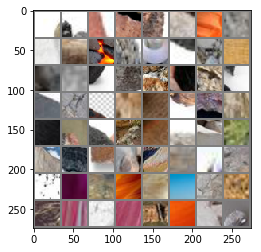

240
tensor([2, 6, 5, 6, 5, 4, 2, 5, 4, 1, 2, 0, 5, 4, 4, 6, 4, 6, 6, 2, 4, 5, 3, 0,
        3, 0, 4, 5, 2, 5, 3, 6, 3, 2, 0, 2, 4, 5, 2, 0, 2, 4, 5, 2, 5, 6, 6, 3,
        0, 0, 3, 0, 0, 0, 5, 6, 4, 0, 2, 3, 0, 5, 4, 6])
(64, 3, 32, 32)
('2_1668.jpg', '6_2196.jpg', '5_1341.jpg', '6_2828.jpg', '5_1427.jpg', '4_2884.jpg', '2_2407.jpg', '5_3230.jpg', '4_60.jpg', '1_547.jpg', '2_484.jpg', '0_754.jpg', '5_163.jpg', '4_1355.jpg', '4_370.jpg', '6_2800.jpg', '4_2674.jpg', '6_2400.jpeg', '6_619.jpeg', '2_1126.jpg', '4_48.jpg', '5_3218.jpg', '3_1654.jpg', '0_3945.jpg', '3_867.jpg', '0_2483.jpg', '4_358.jpg', '5_2106.jpg', '2_3057.jpg', '5_2660.jpg', '3_1132.jpg', '6_936.jpg', '3_41.jpg', '2_2349.jpg', '0_1834.jpg', '2_1898.jpg', '4_2112.jpg', '5_1369.jpg', '2_1654.jpg', '0_1820.jpg', '2_628.webp', '4_2106.jpg', '5_2674.jpg', '2_3043.jpg', '5_639.jpg', '6_3061.png', '6_922.jpg', '3_55.jpg', '0_3789.jpg', '0_768.jpg', '3_1640.jpg', '0_4577.jpeg', '0_3951.jpg', '0_2497.jpg', '5_2112.jpg', '6_2814.j

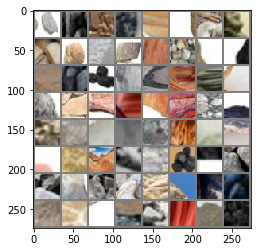

241
tensor([2, 0, 5, 0, 0, 6, 3, 1, 4, 6, 6, 0, 2, 5, 0, 6, 0, 4, 2, 6, 2, 1, 4, 6,
        0, 5, 2, 0, 2, 3, 5, 5, 5, 4, 6, 0, 2, 3, 0, 1, 2, 0, 6, 2, 0, 6, 0, 4,
        5, 6, 0, 5, 6, 3, 2, 6, 0, 1, 0, 2, 6, 0, 0, 4])
(64, 3, 32, 32)
('2_527.jpg', '0_4179.jpg', '5_3393.jpg', '0_2508.jpg', '0_1.jpg', '6_103.jpg', '3_292.JPEG', '1_1015.jpg', '4_1590.jpg', '6_3084.jpeg', '6_665.jpg', '0_3170.jpg', '2_241.jpg', '5_2933.jpg', '0_191.jpg', '6_2035.jpg', '0_1767.jpg', '4_2099.jpg', '2_1913.jpg', '6_2021.jpg', '2_1907.jpg', '1_1001.jpg', '4_1584.jpg', '6_671.jpg', '0_3164.jpg', '5_2927.jpg', '2_255.jpg', '0_185.jpg', '2_533.jpg', '3_720.jpg', '5_3387.jpg', '5_2099.jpg', '5_1590.jpg', '4_2933.jpg', '6_1266.jpg', '0_4145.jpg', '2_2598.jpg', '3_708.jpg', '0_813.jpg', '1_87.jpg', '2_1091.jpg', '0_2773.jpeg', '6_2009.jpg', '2_1447.webp', '0_2087.png', '6_659.jpg', '0_2252.jpg', '4_589.jpg', '5_942.jpg', '6_881.jpg', '0_2246.jpg', '5_956.jpg', '6_895.jpg', '3_1091.jpg', '2_269.jpg', '6_1514.jpg',

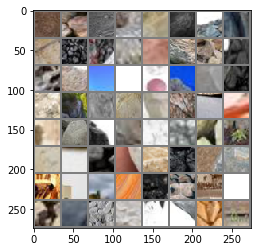

242
tensor([4, 6, 0, 5, 2, 6, 1, 6, 5, 6, 5, 6, 5, 2, 0, 5, 4, 4, 5, 2, 1, 2, 6, 0,
        5, 4, 6, 5, 0, 6, 4, 5, 4, 0, 4, 3, 0, 2, 5, 1, 2, 3, 1, 4, 5, 4, 6, 3,
        0, 5, 6, 5, 0, 5, 0, 4, 0, 0, 2, 5, 6, 4, 0, 5])
(64, 3, 32, 32)
('4_1235.jpg', '6_1299.jpg', '0_634.jpg', '5_3350.jpg', '2_2567.jpg', '6_2790.jpg', '1_78.jpg', '6_2948.jpg', '5_1547.jpg', '6_71.jpg', '5_1221.jpg', '6_2553.jpeg', '5_3436.jpg', '2_282.jpg', '0_152.jpg', '5_765.jpg', '4_1553.jpg', '4_576.jpg', '5_3422.jpg', '2_2215.jpg', '1_355.jpg', '2_296.jpg', '6_2237.png', '0_146.jpg', '5_771.jpg', '4_1547.jpg', '6_65.jpg', '5_1235.jpg', '0_1968.jpg', '6_2784.jpg', '4_2728.jpg', '5_1553.jpg', '4_204.jpg', '0_3819.jpg', '4_1221.jpg', '3_1708.jpg', '0_620.jpg', '2_2573.jpg', '5_3344.jpg', '1_433.jpg', '2_1052.jpg', '3_1736.JPEG', '1_44.jpg', '4_2700.jpg', '5_2072.jpg', '4_1209.jpg', '6_2945.jpeg', '3_1720.jpg', '0_4186.jpg', '5_981.jpg', '6_842.jpg', '5_759.jpg', '0_2291.jpg', '5_2714.jpg', '0_1798.jpg', '4_2066.jpg'

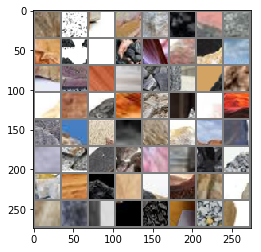

243
tensor([1, 5, 6, 0, 5, 4, 5, 0, 3, 0, 5, 2, 6, 1, 6, 6, 0, 0, 1, 0, 6, 4, 2, 6,
        0, 6, 5, 2, 6, 6, 6, 5, 0, 6, 5, 3, 0, 6, 6, 5, 2, 0, 0, 0, 1, 3, 6, 0,
        0, 4, 0, 1, 6, 0, 4, 6, 0, 5, 6, 0, 5, 2, 2, 1])
(64, 3, 32, 32)
('1_369.jpg', '5_995.jpg', '6_856.jpg', '0_2285.jpg', '5_2700.jpg', '4_238.jpg', '5_2066.jpg', '0_3825.jpg', '3_907.jpg', '0_4192.jpg', '5_3378.jpg', '2_1046.jpg', '6_2416.jpeg', '1_50.jpg', '6_2960.jpg', '6_3129.jpg', '0_1565.jpg', '0_393.jpg', '1_180.jpg', '0_3372.jpg', '6_467.jpg', '4_1792.jpg', '2_3.jpg', '6_301.jpg', '0_3414.jpg', '6_1847.jpeg', '5_3191.jpg', '2_725.jpg', '6_1058.jpg', '6_2551.jpg', '6_2292.jpeg', '5_1786.jpg', '0_1203.jpg', '6_2545.jpg', '5_1792.jpg', '3_695.JPEG', '0_1217.jpg', '6_822.jpeg', '6_315.jpg', '5_3185.jpg', '2_731.jpg', '0_387.jpg', '0_4409.jpg', '0_3366.jpg', '1_194.jpg', '3_244.jpg', '6_473.jpg', '0_2078.jpg', '0_673.jpeg', '4_1786.jpg', '0_1571.jpg', '1_341.png', '6_2223.jpg', '0_4421.jpg', '4_953.jpg', '6_1702.jpg'

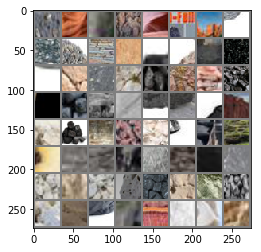

244
tensor([0, 6, 2, 2, 1, 0, 6, 6, 0, 5, 2, 6, 3, 6, 4, 0, 4, 4, 5, 2, 3, 0, 1, 4,
        5, 2, 3, 5, 4, 5, 5, 6, 3, 5, 0, 4, 5, 1, 5, 2, 0, 0, 4, 5, 5, 5, 5, 2,
        5, 4, 6, 4, 5, 1, 3, 2, 5, 4, 6, 4, 5, 0, 6, 2])
(64, 3, 32, 32)
('0_3428.jpg', '6_1064.jpg', '2_719.jpg', '2_2956.jpg', '1_816.jpg', '0_2722.jpg', '6_329.jpg', '6_1070.jpg', '0_4353.jpg', '5_1976.jpg', '2_1287.jpg', '6_3101.jpg', '3_1046.png', '6_1716.jpg', '4_947.jpg', '0_2044.jpg', '4_774.jpg', '4_1751.jpg', '5_567.jpg', '2_15.jpg', '3_1278.jpg', '0_350.jpg', '1_143.jpg', '4_1989.jpg', '5_3634.jpg', '2_2003.jpg', '3_293.jpg', '5_1801.webp', '4_2258.jpg', '5_1023.jpg', '5_1745.jpg', '6_2592.jpg', '3_103.JPEG', '5_3152.jpg', '0_2911.jpg', '4_1037.jpg', '5_201.jpg', '1_631.jpg', '5_3146.jpg', '2_2771.jpg', '0_422.jpg', '0_2905.jpg', '4_1023.jpg', '5_215.jpg', '5_2258.jpg', '5_1751.jpg', '5_1989.jpg', '2_1278.jpg', '5_1037.jpg', '4_760.jpg', '6_1931.jpg', '4_1745.jpg', '5_573.jpg', '1_157.jpg', '3_287.jpg', '2_2017.jp

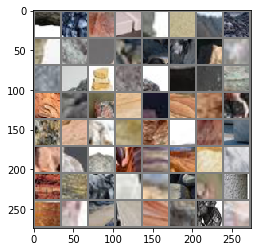

245
tensor([4, 3, 5, 1, 0, 3, 2, 2, 5, 5, 5, 4, 0, 2, 4, 2, 0, 5, 2, 3, 5, 2, 5, 5,
        4, 4, 0, 0, 2, 3, 4, 1, 2, 4, 3, 5, 2, 5, 2, 4, 0, 0, 4, 5, 5, 0, 0, 4,
        2, 5, 4, 2, 2, 1, 4, 3, 5, 0, 2, 5, 5, 2, 3, 5])
(64, 3, 32, 32)
('4_990.jpg', '3_1244.jpg', '5_3608.jpg', '1_619.jpg', '0_4384.jpg', '3_1522.jpg', '2_2981.jpg', '2_902.jpg', '5_2270.jpg', '5_20.jpg', '5_1779.jpg', '4_2502.jpg', '0_4151.png', '2_1250.jpg', '4_2516.jpg', '2_1244.jpg', '0_4390.jpg', '5_229.jpg', '2_2995.jpg', '3_416.JPEG', '5_2264.jpg', '2_916.jpg', '5_34.jpg', '5_2502.jpg', '4_1779.jpg', '4_984.jpg', '0_378.jpg', '0_3399.jpg', '2_1522.jpg', '3_1085.png', '4_2270.jpg', '1_1029.png', '2_1252.jpg', '4_2500.jpg', '3_1716.JPEG', '5_2272.jpg', '2_900.jpg', '5_22.jpg', '2_2983.jpg', '4_1009.jpg', '0_4386.jpg', '0_408.jpg', '4_992.jpg', '5_559.jpg', '5_2514.jpg', '0_2091.jpg', '0_1598.jpg', '4_2266.jpg', '2_1534.jpg', '5_1009.jpg', '4_2272.jpg', '2_1520.jpg', '2_2029.jpg', '1_169.jpg', '4_986.jpg', '3_1252.jp

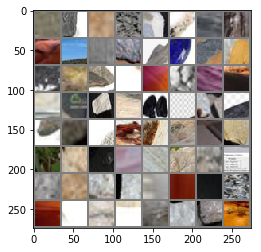

246
tensor([2, 4, 4, 5, 0, 0, 6, 1, 5, 2, 6, 5, 5, 5, 1, 2, 0, 4, 2, 5, 5, 4, 6, 1,
        5, 2, 0, 4, 5, 6, 5, 3, 6, 4, 5, 2, 4, 5, 0, 0, 2, 5, 0, 2, 3, 0, 2, 2,
        5, 6, 4, 6, 0, 4, 6, 0, 0, 4, 0, 4, 6, 6, 2, 5])
(64, 3, 32, 32)
('2_1246.jpg', '4_2514.jpg', '4_1035.jpg', '5_203.jpg', '0_434.jpg', '0_2913.jpg', '6_1099.jpg', '1_627.jpg', '5_3150.jpg', '2_2767.jpg', '6_2590.jpg', '5_1747.jpg', '5_1021.jpg', '5_3148.webp', '1_141.jpg', '2_2001.jpg', '0_352.jpg', '4_1753.jpg', '2_17.jpg', '5_565.jpg', '5_2528.jpg', '4_776.jpg', '6_1927.jpg', '1_155.jpg', '5_3622.jpg', '2_2015.jpg', '0_346.jpg', '4_1747.jpg', '5_571.jpg', '6_1933.jpg', '5_1035.jpg', '3_1653.JPEG', '6_2584.jpg', '4_2528.jpg', '5_1753.jpg', '2_928.jpg', '4_1021.jpg', '5_217.jpg', '0_2907.jpg', '0_420.jpg', '2_2773.jpg', '5_3144.jpg', '0_4345.jpg', '2_2798.jpg', '3_508.jpg', '0_2734.jpg', '2_2940.jpg', '2_1291.jpg', '5_1960.jpg', '6_2209.jpg', '4_789.jpg', '6_459.jpg', '0_2052.jpg', '4_1974.jpg', '6_1700.jpg', '0_4423.

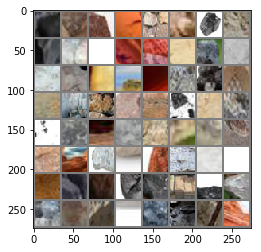

247
tensor([0, 6, 2, 5, 0, 5, 2, 0, 0, 5, 0, 6, 2, 3, 4, 6, 0, 1, 4, 0, 0, 6, 0, 4,
        6, 0, 4, 6, 1, 0, 3, 0, 4, 6, 2, 0, 3, 5, 2, 5, 0, 5, 2, 0, 4, 0, 6, 4,
        5, 2, 3, 6, 5, 5, 1, 2, 3, 0, 3, 5, 5, 6, 1, 4])
(64, 3, 32, 32)
('0_4351.jpg', '6_1072.jpg', '2_2954.jpg', '5_1784.jpg', '0_1201.jpg', '5_635.webp', '2_727.jpg', '0_4379.jpg', '0_3416.jpg', '5_3193.jpg', '0_2708.jpg', '6_303.jpg', '2_1.jpg', '3_1595.JPEG', '4_1790.jpg', '6_465.jpg', '0_3370.jpg', '1_182.jpg', '4_1948.jpg', '0_391.jpg', '0_4392.jpeg', '6_2235.jpg', '0_1567.jpg', '4_2299.jpg', '6_2221.jpg', '0_1573.jpg', '4_1784.jpg', '6_471.jpg', '1_196.jpg', '0_3364.jpg', '3_246.jpg', '0_385.jpg', '4_979.jpg', '6_1728.jpg', '2_733.jpg', '0_3402.jpg', '3_520.jpg', '5_2299.jpg', '2_2968.jpg', '5_1790.jpg', '0_1215.jpg', '5_1948.jpg', '2_1736.jpg', '0_1942.jpg', '4_2064.jpg', '0_2293.jpg', '6_698.jpg', '4_548.jpg', '5_2716.jpg', '2_3121.jpg', '3_1044.jpg', '6_840.jpg', '5_3408.jpg', '5_983.jpg', '1_419.jpg', '2_2559.jp

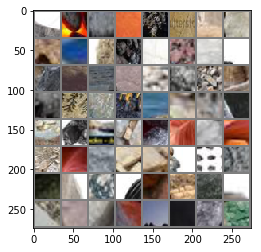

248
tensor([2, 6, 1, 4, 2, 0, 0, 5, 0, 5, 4, 0, 6, 3, 0, 5, 2, 4, 4, 5, 4, 2, 3, 0,
        5, 2, 1, 4, 5, 6, 5, 6, 2, 5, 1, 0, 4, 4, 5, 2, 1, 0, 4, 5, 4, 5, 6, 2,
        3, 6, 5, 2, 4, 5, 4, 6, 2, 5, 1, 6, 3, 6, 5, 0])
(64, 3, 32, 32)
('2_1050.jpg', '6_2962.jpg', '1_52.jpg', '4_2716.jpg', '2_1044.jpg', '0_4190.jpg', '0_3827.jpg', '5_2064.jpg', '0_2287.jpg', '5_2702.jpg', '4_1579.jpg', '0_178.jpg', '6_854.jpg', '3_1050.jpg', '0_3199.jpg', '5_997.jpg', '2_1722.jpg', '4_2070.jpg', '4_574.jpg', '5_767.jpg', '4_1551.jpg', '2_280.jpg', '3_573.JPEG', '0_150.jpg', '5_3434.jpg', '2_2203.jpg', '1_343.jpg', '4_2058.jpg', '5_1223.jpg', '6_317.png', '5_1545.jpg', '6_2792.jpg', '2_2565.jpg', '5_3352.jpg', '1_425.jpg', '0_636.jpg', '4_1237.jpg', '4_212.jpg', '5_3346.jpg', '2_2571.jpg', '1_431.jpg', '0_622.jpg', '4_1223.jpg', '5_2058.jpg', '4_206.jpg', '5_1551.jpg', '6_2786.jpg', '2_1078.jpg', '3_820.jpeg', '6_67.jpg', '5_1237.jpg', '2_3109.jpg', '4_560.jpg', '5_773.jpg', '4_1545.jpg', '6_868.jpg', 

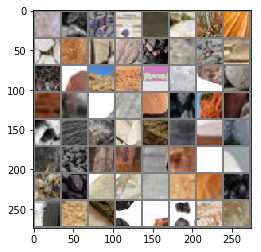

249
tensor([5, 0, 0, 2, 4, 0, 0, 0, 3, 0, 2, 6, 0, 6, 6, 6, 2, 1, 2, 6, 0, 6, 6, 5,
        5, 6, 2, 0, 6, 5, 0, 2, 0, 1, 0, 1, 6, 0, 5, 0, 6, 2, 6, 1, 4, 6, 5, 6,
        4, 0, 5, 3, 0, 6, 5, 3, 0, 2, 2, 5, 5, 0, 1, 6])
(64, 3, 32, 32)
('5_798.jpg', '0_1759.jpg', '0_1981.jpg', '2_1093.jpg', '4_2919.jpg', '0_811.jpg', '0_2536.jpg', '0_716.jpeg', '3_1487.JPEG', '0_4147.jpg', '2_519.jpg', '6_1264.jpg', '0_805.jpg', '6_129.jpg', '6_1270.jpg', '6_2779.jpg', '2_1087.jpg', '1_91.jpg', '2_1939.jpg', '6_98.jpg', '0_1995.jpg', '6_897.jpg', '6_1516.jpg', '5_2919.jpg', '5_954.jpg', '6_1922.jpeg', '2_1911.jpg', '0_1765.jpg', '6_2037.jpg', '5_2931.jpg', '0_4437.jfif', '2_243.jpg', '0_193.jpg', '1_380.jpg', '0_3172.jpg', '1_1017.jpg', '6_101.jpg', '0_3.jpg', '5_3391.jpg', '0_3614.jpg', '6_1258.jpg', '2_525.jpg', '6_2751.jpg', '1_633.png', '4_2925.jpg', '6_2989.jpg', '5_1586.jpg', '6_2745.jpg', '4_2931.jpg', '0_1017.jpg', '5_1592.jpg', '3_1192.JPEG', '0_839.jpg', '6_115.jpg', '5_3385.jpg', '3_722.jpg

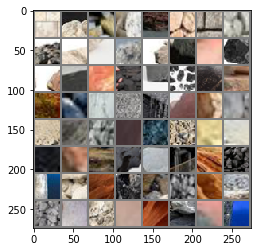

250
tensor([0, 4, 2, 0, 6, 3, 4, 0, 6, 4, 5, 2, 0, 5, 0, 5, 3, 2, 3, 4, 6, 0, 2, 0,
        4, 5, 6, 0, 5, 0, 3, 3, 1, 5, 6, 4, 2, 5, 4, 0, 2, 5, 2, 1, 5, 6, 6, 5,
        4, 2, 4, 6, 5, 6, 3, 4, 2, 3, 5, 5, 4, 5, 4, 2])
(64, 3, 32, 32)
('0_2278.jpg', '4_1586.jpg', '2_1905.jpg', '0_1771.jpg', '6_2023.jpg', '3_1757.JPEG', '4_2110.jpg', '0_1836.jpg', '6_934.jpg', '4_1419.jpg', '5_2662.jpg', '2_3055.jpg', '0_2481.jpg', '5_2104.jpg', '0_3947.jpg', '5_149.jpg', '3_865.jpg', '2_1124.jpg', '3_468.png', '4_2676.jpg', '6_2802.jpg', '0_1188.jpg', '2_1130.jpg', '0_4231.png', '4_2662.jpg', '5_1419.jpg', '6_2816.jpg', '0_2495.jpg', '5_2110.jpg', '0_3953.jpg', '3_871.jpg', '3_1642.jpg', '1_579.jpg', '5_3568.jpg', '6_920.jpg', '4_428.jpg', '2_3041.jpg', '5_2676.jpg', '4_2104.jpg', '0_1822.jpg', '2_1656.jpg', '5_3540.jpg', '2_2377.jpg', '1_237.jpg', '5_2886.jpg', '6_1489.jpg', '6_908.jpg', '5_613.jpg', '4_1425.jpg', '2_3069.jpg', '4_400.jpg', '6_2162.jpeg', '5_1357.jpg', '6_2180.jpg', '3_332.png', '4_

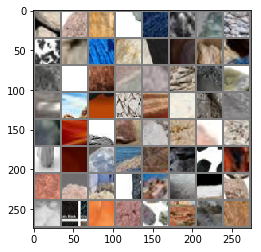

251
tensor([0, 3, 2, 5, 4, 1, 4, 5, 4, 2, 0, 5, 2, 4, 4, 3, 5, 5, 4, 6, 2, 5, 1, 3,
        5, 3, 5, 4, 4, 0, 2, 2, 5, 6, 5, 2, 2, 6, 0, 4, 0, 0, 4, 0, 3, 0, 2, 6,
        0, 5, 3, 0, 0, 4, 2, 0, 0, 2, 5, 6, 6, 0, 5, 0])
(64, 3, 32, 32)
('0_742.jpg', '3_681.jpg', '2_2411.jpg', '5_3226.jpg', '4_76.jpg', '1_551.jpg', '4_372.jpg', '5_161.jpg', '4_1357.jpg', '2_486.jpg', '0_756.jpg', '5_3232.jpg', '2_2405.jpg', '4_62.jpg', '4_2886.jpg', '3_1612.JPEG', '5_1425.jpg', '5_1343.jpg', '4_2138.jpg', '6_2194.jpg', '2_2363.jpg', '5_3554.jpg', '1_223.jpg', '3_1242.JPEG', '5_2892.jpg', '3_1118.jpg', '5_607.jpg', '4_1431.jpg', '4_414.jpg', '0_2324.jpg', '2_3096.jpg', '2_2388.jpg', '5_834.jpg', '6_1476.jpg', '5_2879.jpg', '2_1681.jpg', '2_1859.jpg', '6_1310.jpg', '0_4033.jpg', '4_89.jpg', '0_2442.jpg', '0_965.jpg', '4_399.jpg', '0_3984.jpg', '3_1681.jpg', '0_4027.jpg', '2_479.jpg', '6_1304.jpg', '0_3748.jpg', '5_2431.webp', '3_1491.JPEG', '0_971.jpg', '0_2456.jpg', '4_2879.jpg', '2_1695.jpg', '0_1639.j

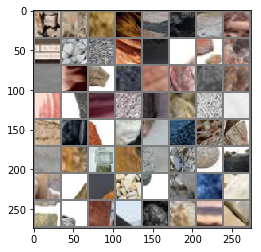

252
tensor([2, 6, 6, 0, 5, 5, 5, 2, 0, 3, 0, 0, 4, 4, 0, 4, 0, 4, 3, 6, 6, 2, 0, 6,
        3, 0, 4, 5, 6, 6, 5, 0, 5, 2, 6, 0, 5, 2, 4, 2, 5, 3, 4, 2, 5, 6, 0, 5,
        2, 2, 4, 5, 2, 3, 4, 4, 5, 3, 5, 0, 3, 0, 0, 0])
(64, 3, 32, 32)
('2_1865.jpg', '6_1172.jpeg', '6_713.jpg', '0_2318.jpg', '5_3583.jpg', '5_808.jpg', '5_2845.jpg', '2_451.jpg', '0_781.jpg', '3_642.jpg', '0_3760.jpg', '0_959.jpg', '4_1380.jpg', '4_2689.jpg', '0_1177.jpg', '4_2851.jpg', '0_1163.jpg', '4_2845.jpg', '3_1468.png', '6_2631.jpg', '6_1338.jpg', '2_445.jpg', '0_795.jpg', '6_547.jpeg', '3_656.jpg', '0_3774.jpg', '4_1394.jpg', '5_2689.jpg', '6_707.jpg', '6_5.jpg', '5_3597.jpg', '0_3012.jpg', '5_2851.jpg', '2_323.jpg', '6_2157.jpg', '0_1605.jpg', '5_1380.jpg', '2_1871.jpg', '4_2474.jpg', '2_1326.jpg', '5_3018.jpg', '3_1454.jpg', '4_158.jpg', '2_874.jpg', '5_2306.jpg', '6_288.jpg', '0_2683.jpg', '5_2460.jpg', '2_2149.jpg', '2_1440.jpg', '4_2312.jpg', '5_1169.jpg', '2_1454.jpg', '3_118.png', '4_3018.jpg', '4_2306.j

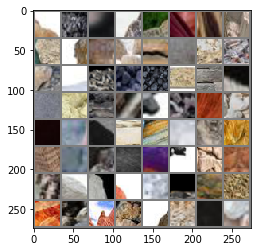

253
tensor([4, 5, 2, 4, 2, 1, 5, 2, 3, 0, 0, 2, 4, 5, 4, 2, 5, 0, 4, 1, 6, 4, 5, 4,
        4, 5, 0, 2, 5, 4, 4, 5, 0, 2, 2, 4, 6, 5, 5, 1, 3, 2, 5, 0, 2, 4, 5, 4,
        5, 2, 1, 0, 4, 6, 0, 3, 5, 6, 0, 6, 2, 4, 6, 2])
(64, 3, 32, 32)
('4_1169.jpg', '5_2312.jpg', '2_860.jpg', '4_2460.jpg', '2_1332.jpg', '1_753.jpg', '5_3024.jpg', '2_2613.jpg', '3_483.jpg', '0_2867.jpg', '0_540.jpg', '2_690.jpg', '4_1141.jpg', '5_377.jpg', '4_164.jpg', '2_848.jpg', '5_1633.jpg', '0_3787.jpeg', '4_2448.jpg', '1_586.png', '6_2382.jpg', '4_3030.jpg', '5_1155.jpg', '4_602.jpg', '4_1627.jpg', '5_411.jpg', '0_226.jpg', '2_2175.jpg', '5_2448.jpg', '4_616.jpg', '4_1633.jpg', '5_405.jpg', '0_232.jpg', '2_2161.jpg', '2_1468.jpg', '4_3024.jpg', '6_3088.jpg', '5_1141.jpg', '5_1627.jpg', '1_747.jpg', '3_497.jpg', '2_2607.jpg', '5_3030.jpg', '0_554.jpg', '2_684.jpg', '4_1155.jpg', '5_363.jpg', '4_170.jpg', '5_388.jpg', '2_2834.jpg', '1_974.jpg', '0_2640.jpg', '4_2354.webp', '6_1112.jpg', '0_2898.jpg', '3_1497.jpg',

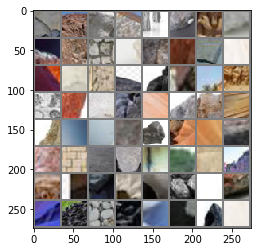

254
tensor([4, 0, 0, 6, 4, 0, 4, 6, 0, 6, 2, 6, 3, 5, 2, 1, 0, 6, 0, 6, 5, 0, 4, 1,
        2, 6, 0, 1, 3, 0, 2, 4, 2, 6, 6, 6, 6, 5, 0, 6, 5, 0, 2, 0, 4, 6, 4, 6,
        4, 0, 6, 3, 1, 0, 2, 0, 6, 0, 4, 6, 3, 0, 4, 2])
(64, 3, 32, 32)
('4_1800.jpg', '0_3238.jpg', '0_2126.jpg', '6_1660.jpg', '4_831.jpg', '0_4543.jpg', '4_1814.jpg', '6_539.jpg', '0_2132.jpg', '6_3077.jpg', '2_1497.jpg', '6_2369.jpg', '3_1656.png', '5_1800.jpg', '2_2820.jpg', '1_960.jpg', '0_2654.jpg', '6_1106.jpg', '0_4225.jpg', '6_2427.jpg', '5_1828.jpg', '0_1375.jpg', '4_1182.jpg', '1_948.jpg', '2_2808.jpg', '6_277.jpg', '0_3562.jpg', '1_790.jpg', '3_440.jpg', '0_583.jpg', '2_653.jpg', '4_819.jpg', '2_135.jpg', '6_1648.jpg', '6_2709.jpeg', '6_511.jpg', '6_1890.jpg', '5_1196.jpg', '0_1413.jpg', '6_2341.jpg', '5_1182.jpg', '0_1407.jpg', '2_121.jpg', '0_3210.jpg', '4_1828.jpg', '6_505.jpg', '4_7.jpg', '6_1884.jpg', '4_1196.jpg', '0_2668.jpg', '6_263.jpg', '3_1583.JPEG', '1_784.jpg', '0_3576.jpg', '2_647.jpg', '0_4219.jp

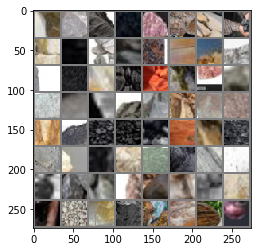

255
tensor([6, 0, 5, 0, 3, 6, 2, 0, 1, 6, 0, 4, 2, 0, 0, 6, 2, 4, 1, 6, 5, 6, 0, 5,
        6, 6, 3, 0, 6, 2, 6, 2, 0, 6, 4, 4, 6, 0, 6, 0, 0, 1, 2, 0, 5, 0, 0, 6,
        0, 6, 5, 0, 4, 0, 0, 2, 4, 5, 4, 6, 2, 2, 0, 5])
(64, 3, 32, 32)
('6_2354.jpg', '0_1406.jpg', '5_1183.jpg', '0_1360.jpg', '3_680.png', '6_2432.jpg', '2_646.jpg', '0_596.jpg', '1_785.jpg', '6_262.jpg', '0_2669.jpg', '4_1197.jpg', '2_652.jpg', '0_582.jpg', '0_3563.jpg', '6_276.jpg', '2_2809.jpg', '4_1183.jpg', '1_949.jpg', '6_2426.jpg', '5_1829.jpg', '6_2340.jpg', '0_1412.jpg', '5_1197.jpg', '6_1891.jpg', '6_510.jpg', '3_327.jpg', '0_3205.jpg', '6_1649.jpg', '2_134.jpg', '6_2368.jpg', '2_1496.jpg', '0_2133.jpg', '6_538.jpg', '4_1815.jpg', '4_830.jpg', '6_1661.jpg', '0_4542.jpg', '6_1107.jpg', '0_4224.jpg', '0_2655.jpg', '1_961.jpg', '2_2821.jpg', '0_1348.jpg', '5_1815.jpg', '0_2899.jpg', '0_4230.jpg', '6_1113.jpg', '0_2641.jpg', '6_2817.png', '5_389.jpg', '0_2127.jpg', '4_1801.jpg', '0_3239.jpg', '0_4556.jpg', '2_108.j

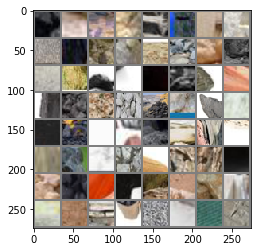

256
tensor([4, 5, 4, 4, 5, 4, 0, 2, 5, 1, 5, 0, 4, 5, 2, 4, 5, 3, 2, 0, 5, 2, 3, 1,
        2, 0, 5, 4, 6, 5, 4, 6, 5, 5, 4, 4, 2, 2, 3, 4, 0, 5, 2, 4, 3, 6, 0, 6,
        2, 4, 5, 5, 2, 3, 4, 6, 5, 4, 2, 2, 3, 5, 4, 0])
(64, 3, 32, 32)
('4_1632.jpg', '5_2449.jpg', '4_617.jpg', '4_171.jpg', '5_362.jpg', '4_1154.jpg', '0_555.jpg', '2_2606.jpg', '5_3031.jpg', '1_746.jpg', '5_1626.jpg', '0_13.jpg', '4_2449.jpg', '5_1632.jpg', '2_849.jpg', '4_165.jpg', '5_376.jpg', '3_1452.JPEG', '2_691.jpg', '0_541.jpg', '5_3025.jpg', '2_2612.jpg', '3_482.jpg', '1_752.jpg', '2_2174.jpg', '0_227.jpg', '5_410.jpg', '4_603.jpg', '6_1852.jpg', '5_1154.jpg', '4_3031.jpg', '6_2383.jpg', '5_438.jpg', '5_2475.jpg', '4_2307.jpg', '4_3019.jpg', '2_1455.jpg', '2_1333.jpg', '3_1147.JPEG', '4_2461.jpg', '0_2696.jpg', '5_2313.jpg', '2_861.jpg', '4_1168.jpg', '3_1441.jpg', '6_3026.jpeg', '0_2682.jpg', '6_289.jpg', '2_875.jpg', '4_159.jpg', '5_2307.jpg', '5_3019.jpg', '2_1327.jpg', '3_19.JPEG', '4_2475.jpg', '6_2267.jpeg

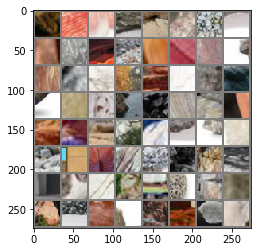

257
tensor([0, 6, 6, 4, 0, 2, 5, 0, 6, 5, 2, 0, 5, 6, 5, 2, 5, 0, 5, 3, 5, 0, 6, 6,
        2, 6, 5, 0, 6, 6, 0, 4, 0, 4, 0, 0, 3, 0, 2, 4, 0, 0, 0, 6, 2, 5, 2, 0,
        2, 2, 2, 0, 6, 5, 2, 3, 5, 2, 0, 4, 0, 0, 4, 6])
(64, 3, 32, 32)
('0_794.jpg', '6_1339.jpg', '6_2630.jpg', '4_2844.jpg', '0_1162.jpg', '2_1870.jpg', '5_1381.jpg', '0_1604.jpg', '6_2156.jpg', '5_2850.jpg', '2_322.jpg', '0_3013.jpg', '5_3596.jpg', '6_706.jpg', '5_2688.jpg', '2_336.jpg', '5_2844.jpg', '0_3007.jpg', '5_3582.jpg', '3_125.jpg', '5_809.jpg', '0_2319.jpg', '6_712.jpg', '6_3089.png', '2_1864.jpg', '6_1846.png', '5_1395.jpg', '0_1610.jpg', '6_2142.jpg', '6_2624.jpg', '0_2872.png', '4_2850.jpg', '0_1176.jpg', '4_2688.jpg', '0_958.jpg', '0_3761.jpg', '3_1239.JPEG', '0_780.jpg', '2_450.jpg', '4_2878.jpg', '0_2457.jpg', '0_970.jpg', '0_4026.jpg', '6_1305.jpg', '2_478.jpg', '5_821.jpg', '2_3083.jpg', '0_2331.jpg', '2_1694.jpg', '2_1858.jpg', '2_1680.jpg', '0_4581.png', '6_1477.jpg', '5_2878.jpg', '2_2389.jpg', '3_1

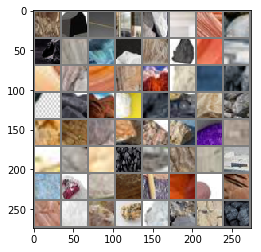

258
tensor([3, 6, 5, 3, 3, 3, 4, 1, 4, 5, 3, 0, 2, 4, 5, 4, 4, 4, 5, 5, 1, 5, 6, 4,
        5, 6, 5, 2, 4, 5, 6, 5, 6, 5, 2, 4, 1, 2, 5, 0, 2, 4, 3, 5, 5, 4, 5, 0,
        2, 4, 2, 1, 3, 0, 5, 5, 4, 2, 2, 0, 4, 4, 2, 5])
(64, 3, 32, 32)
('3_1694.jpg', '6_2618.jpg', '5_1424.jpg', '3_1055.JPEG', '3_772.JPEG', '3_441.png', '4_2887.jpg', '1_544.jpg', '4_63.jpg', '5_3233.jpg', '3_694.jpg', '0_757.jpg', '2_487.jpg', '4_1356.jpg', '5_160.jpg', '4_373.jpg', '4_415.jpg', '4_1430.jpg', '5_606.jpg', '5_2893.jpg', '1_222.jpg', '5_3555.jpg', '6_2195.jpg', '4_2139.jpg', '5_1342.jpg', '6_1885.png', '5_1356.jpg', '2_3068.jpg', '4_1424.jpg', '5_612.jpg', '6_909.jpg', '5_2887.jpg', '6_1488.jpg', '5_3541.jpg', '2_2376.jpg', '4_77.jpg', '1_550.jpg', '2_2410.jpg', '5_3227.jpg', '0_743.jpg', '2_493.jpg', '4_1342.jpg', '3_858.jpg', '5_174.jpg', '5_2139.jpg', '4_367.jpg', '5_1430.jpg', '0_4218.png', '2_1119.jpg', '4_2893.jpg', '2_2438.jpg', '1_578.jpg', '3_1643.jpg', '0_3952.jpg', '5_2111.jpg', '5_1418.jpg', 

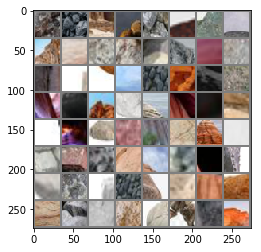

259
tensor([6, 5, 5, 2, 0, 4, 3, 6, 3, 2, 6, 4, 0, 6, 4, 3, 2, 3, 3, 3, 5, 0, 0, 5,
        0, 2, 5, 6, 0, 5, 0, 4, 6, 6, 0, 3, 0, 2, 4, 1, 0, 6, 1, 0, 5, 2, 5, 4,
        1, 6, 1, 0, 5, 2, 6, 0, 2, 6, 5, 0, 4, 6, 2, 6])
(64, 3, 32, 32)
('6_921.jpg', '5_3569.jpg', '5_2663.jpg', '2_3054.jpg', '0_4347.jpeg', '4_1418.jpg', '3_42.jpg', '6_935.jpg', '3_1131.jpg', '2_1643.jpg', '6_880.jpeg', '4_2111.jpg', '0_1189.jpg', '6_2803.jpg', '4_2677.jpg', '3_1482.png', '2_1125.jpg', '3_1540.jpeg', '3_1657.jpg', '3_864.jpg', '5_148.jpg', '0_1515.jpeg', '0_3946.jpg', '5_2105.jpg', '0_2480.jpg', '2_530.jpg', '5_3384.jpg', '6_114.jpg', '0_838.jpg', '5_1593.jpg', '0_1016.jpg', '4_2930.jpg', '6_2744.jpg', '6_2022.jpg', '0_353.png', '3_158.JPEG', '0_1770.jpg', '2_1904.jpg', '4_1587.jpg', '1_1002.jpg', '0_2279.jpg', '6_672.jpg', '1_395.jpg', '0_3167.jpg', '5_969.jpg', '2_256.jpg', '5_2924.jpg', '4_1593.jpg', '1_1016.jpg', '6_666.jpg', '1_381.jpg', '0_192.jpg', '5_2930.jpg', '2_242.jpg', '6_2036.jpg', '0_1764

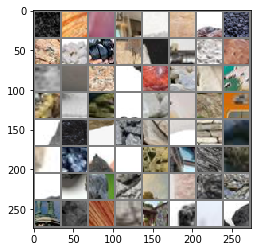

260
tensor([5, 6, 1, 2, 6, 0, 0, 6, 0, 0, 0, 5, 6, 5, 0, 3, 0, 6, 2, 3, 0, 5, 0, 5,
        6, 6, 6, 2, 0, 1, 4, 2, 2, 6, 5, 5, 4, 1, 5, 2, 1, 5, 6, 0, 2, 4, 5, 2,
        4, 5, 6, 5, 6, 4, 1, 5, 2, 3, 0, 4, 5, 4, 4, 4])
(64, 3, 32, 32)
('5_3390.jpg', '6_100.jpg', '1_90.jpg', '2_1086.jpg', '6_2778.jpg', '0_4152.jpg', '0_1140.webp', '6_128.jpg', '0_804.jpg', '0_2523.jpg', '0_2245.jpg', '5_955.jpg', '6_1517.jpg', '5_2918.jpg', '0_1994.jpg', '3_1247.png', '0_2090.png', '6_99.jpg', '2_1938.jpg', '3_1253.png', '0_1980.jpg', '5_799.jpg', '0_2251.jpg', '5_941.jpg', '6_1503.jpg', '6_882.jpg', '6_1265.jpg', '2_518.jpg', '0_2537.jpg', '1_84.jpg', '4_2918.jpg', '2_1092.jpg', '2_1079.jpg', '6_2787.jpg', '5_1550.jpg', '5_2059.jpg', '4_1222.jpg', '1_430.jpg', '5_3347.jpg', '2_2570.jpg', '1_356.jpg', '5_3421.jpg', '6_869.jpg', '0_145.jpg', '2_295.jpg', '4_1544.jpg', '5_772.jpg', '2_3108.jpg', '4_561.jpg', '5_1236.jpg', '6_66.jpg', '5_1222.jpg', '6_72.jpg', '4_2059.jpg', '1_342.jpg', '5_3435.jpg', '2_

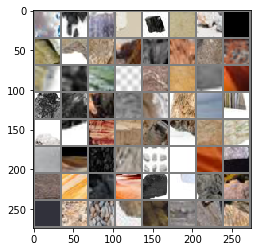

261
tensor([0, 1, 2, 6, 5, 5, 3, 0, 3, 2, 4, 1, 6, 0, 5, 0, 6, 6, 4, 0, 5, 5, 3, 6,
        4, 5, 2, 0, 4, 2, 2, 4, 1, 5, 5, 0, 0, 3, 2, 1, 6, 4, 0, 3, 0, 1, 6, 4,
        0, 6, 6, 5, 0, 5, 2, 1, 5, 3, 5, 0, 2, 0, 2, 6])
(64, 3, 32, 32)
('0_637.jpg', '1_424.jpg', '2_2564.jpg', '6_2793.jpg', '5_1544.jpg', '5_2065.jpg', '3_904.jpg', '0_3826.jpg', '3_1737.jpg', '2_1045.jpg', '4_2717.jpg', '1_53.jpg', '6_2963.jpg', '0_1957.jpg', '5_996.jpg', '0_3198.jpg', '6_855.jpg', '6_3067.jpeg', '4_1578.jpg', '0_2286.jpg', '5_3409.jpg', '5_982.jpg', '3_1045.jpg', '6_841.jpg', '4_549.jpg', '5_2717.jpg', '2_3120.jpg', '0_2292.jpg', '4_2065.jpg', '2_1737.jpg', '2_1051.jpg', '4_2703.jpg', '1_47.jpg', '5_1578.jpg', '5_2071.jpg', '0_3832.jpg', '0_4185.jpg', '3_1723.jpg', '2_2558.jpg', '1_418.jpg', '6_1729.jpg', '4_978.jpg', '0_384.jpg', '3_247.jpg', '0_3365.jpg', '1_197.jpg', '6_470.jpg', '4_1785.jpg', '0_1572.jpg', '6_2220.jpg', '6_2546.jpg', '5_1949.jpg', '0_1214.jpg', '5_1791.jpg', '2_2969.jpg', '1_829.jp

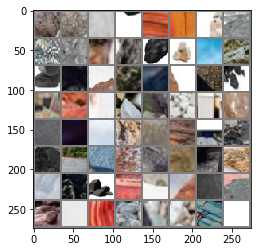

262
tensor([0, 5, 0, 0, 3, 0, 5, 4, 0, 6, 0, 1, 0, 4, 6, 4, 6, 3, 0, 6, 4, 4, 0, 0,
        2, 0, 0, 5, 2, 0, 5, 2, 1, 2, 0, 2, 6, 0, 3, 6, 0, 4, 0, 6, 4, 6, 6, 5,
        4, 6, 5, 4, 2, 3, 1, 2, 5, 1, 3, 0, 5, 4, 5, 4])
(64, 3, 32, 32)
('0_2709.jpg', '5_3192.jpg', '0_3417.jpg', '0_4378.jpg', '3_1628.JPEG', '0_1200.jpg', '5_1785.jpg', '4_2298.jpg', '0_1566.jpg', '6_2234.jpg', '0_390.jpg', '1_183.jpg', '0_3371.jpg', '4_1949.jpg', '6_464.jpg', '4_1791.jpg', '6_3102.jpg', '3_1290.jpg', '0_4436.jpg', '6_1715.jpg', '4_944.jpg', '4_1961.jpg', '0_3359.jpg', '0_2047.jpg', '2_2955.jpg', '0_2721.jpg', '0_4350.jpg', '5_1975.jpg', '2_1284.jpg', '0_1228.jpg', '5_1961.jpg', '2_1290.jpg', '1_801.jpg', '2_2941.jpg', '0_2735.jpg', '2_2799.jpg', '6_1067.jpg', '0_4344.jpg', '3_1284.jpg', '6_1701.jpg', '0_4422.jpg', '4_1975.jpg', '0_2053.jpg', '6_458.jpg', '4_788.jpg', '6_3116.jpg', '6_2208.jpg', '5_1034.jpg', '4_763.jpg', '6_1932.jpg', '5_570.jpg', '4_1746.jpg', '2_2014.jpg', '3_284.jpg', '1_154.jpg', '2

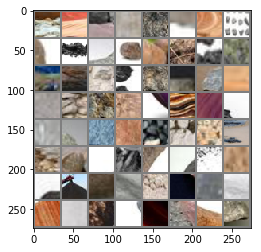

263
tensor([6, 5, 5, 2, 1, 6, 0, 0, 5, 4, 0, 5, 6, 4, 5, 2, 2, 2, 5, 5, 6, 4, 1, 2,
        4, 5, 4, 2, 5, 0, 2, 5, 2, 5, 3, 0, 4, 5, 5, 2, 4, 3, 2, 2, 4, 0, 5, 5,
        1, 5, 0, 1, 2, 5, 3, 4, 2, 5, 4, 5, 3, 2, 1, 5])
(64, 3, 32, 32)
('6_2585.jpg', '5_1746.jpg', '5_3151.jpg', '2_2766.jpg', '1_626.jpg', '6_1098.jpg', '0_2912.jpg', '0_435.jpg', '5_202.jpg', '4_1034.jpg', '0_2397.jpeg', '5_2529.jpg', '6_1926.jpg', '4_777.jpg', '5_564.jpg', '2_16.jpg', '2_2000.jpg', '2_1509.jpg', '5_1020.jpg', '5_2501.jpg', '6_2621.jpeg', '4_987.jpg', '1_168.jpg', '2_1521.jpg', '4_2273.jpg', '5_1008.jpg', '4_2515.jpg', '2_1247.jpg', '5_3179.jpg', '0_4393.jpg', '2_2996.jpg', '5_37.jpg', '2_915.jpg', '5_2267.jpg', '3_1521.jpg', '0_4387.jpg', '4_1008.jpg', '5_23.jpg', '5_2273.jpg', '2_901.jpg', '4_2501.jpg', '3_676.jpeg', '2_1253.jpg', '2_1535.jpg', '4_2267.jpg', '0_1599.jpg', '5_2515.jpg', '5_558.jpg', '1_1006.png', '5_1024.jpg', '0_357.jpg', '1_144.jpg', '2_2004.jpg', '5_3633.jpg', '3_294.jpg', '4_773.jp

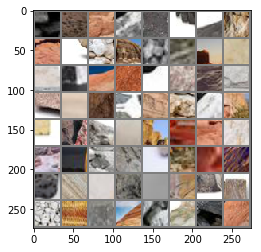

264
tensor([2, 3, 0, 6, 5, 4, 6, 5, 0, 4, 5, 1, 2, 5, 0, 3, 5, 2, 5, 6, 4, 4, 5, 5,
        2, 4, 3, 0, 2, 1, 5, 4, 5, 2, 2, 4, 2, 2, 5, 5, 5, 0, 2, 4, 5, 2, 5, 0,
        2, 4, 4, 0, 2, 4, 5, 0, 5, 0, 6, 4, 0, 6, 4, 0])
(64, 3, 32, 32)
('2_2762.jpg', '3_1519.jpg', '0_2916.jpg', '6_2595.jpg', '5_1742.jpg', '4_2539.jpg', '6_2581.jpg', '5_1756.jpg', '0_1943.jpeg', '4_1024.jpg', '5_212.jpg', '1_636.jpg', '2_2776.jpg', '5_3141.jpg', '0_343.jpg', '3_280.jpg', '5_3627.jpg', '2_2010.jpg', '5_2539.jpg', '6_1936.jpg', '4_767.jpg', '4_1742.jpg', '5_574.jpg', '5_1030.jpg', '2_1519.jpg', '4_997.jpg', '3_1243.jpg', '0_1990.png', '2_2038.jpg', '1_178.jpg', '5_2511.jpg', '4_2263.jpg', '5_1018.jpg', '2_1531.jpg', '2_1257.jpg', '4_2505.jpg', '2_2986.jpg', '2_905.jpg', '5_2277.jpg', '5_27.jpg', '5_3169.jpg', '0_4383.jpg', '2_2992.jpg', '4_1018.jpg', '5_2263.jpg', '2_911.jpg', '5_33.jpg', '0_4397.jpg', '2_1243.jpg', '4_2511.jpg', '4_2277.jpg', '0_1589.jpg', '2_1525.jpg', '4_983.jpg', '5_2505.jpg', '0_208

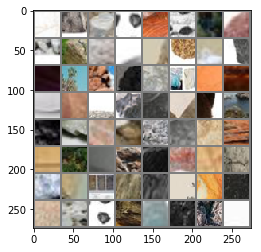

265
tensor([6, 0, 5, 0, 6, 5, 5, 2, 1, 2, 6, 2, 5, 5, 2, 0, 6, 0, 5, 0, 6, 6, 4, 0,
        6, 4, 1, 0, 4, 6, 0, 6, 4, 4, 0, 6, 2, 1, 0, 0, 5, 2, 5, 2, 2, 3, 6, 0,
        2, 1, 0, 0, 6, 4, 6, 3, 4, 6, 6, 5, 2, 6, 0, 2])
(64, 3, 32, 32)
('6_2230.jpg', '0_1562.jpg', '5_1781.jpg', '0_1204.jpg', '6_2509.jpeg', '5_1959.jpg', '5_3196.jpg', '2_722.jpg', '1_839.jpg', '2_2979.jpg', '6_306.jpg', '2_4.jpg', '5_2288.jpg', '5_3182.jpg', '2_736.jpg', '0_4368.jpg', '6_312.jpg', '0_2719.jpg', '5_1795.jpg', '0_1210.jpg', '6_2542.jpg', '6_2224.jpg', '4_2288.jpg', '0_1576.jpg', '6_474.jpg', '4_1781.jpg', '1_193.jpg', '0_3361.jpg', '4_1959.jpg', '6_3112.jpg', '0_2057.jpg', '6_1705.jpg', '4_954.jpg', '4_1971.jpg', '0_4340.jpg', '6_1063.jpg', '2_2945.jpg', '1_805.jpg', '0_2731.jpg', '0_1238.jpg', '5_1965.jpg', '2_1294.jpg', '5_1971.jpg', '2_1280.jpg', '2_2789.jpg', '3_519.jpg', '6_1077.jpg', '0_4354.jpg', '2_2951.jpg', '1_811.jpg', '0_2725.jpg', '0_2043.jpg', '6_448.jpg', '4_940.jpg', '6_1711.jpg', '3_1294

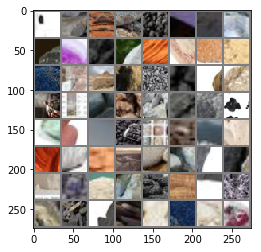

266
tensor([5, 1, 5, 4, 3, 4, 5, 4, 2, 4, 5, 2, 1, 2, 6, 0, 6, 5, 3, 6, 5, 3, 4, 4,
        2, 5, 1, 2, 3, 0, 0, 5, 2, 1, 6, 4, 3, 5, 0, 6, 0, 3, 5, 0, 1, 4, 2, 3,
        2, 4, 4, 0, 5, 0, 5, 6, 0, 6, 0, 4, 5, 5, 5, 0])
(64, 3, 32, 32)
('5_3357.jpg', '1_420.jpg', '5_2049.jpg', '4_217.jpg', '3_928.jpg', '4_1232.jpg', '5_762.jpg', '4_1554.jpg', '2_3118.jpg', '4_571.jpg', '5_3431.jpg', '2_2206.jpg', '1_346.jpg', '2_285.jpg', '6_879.jpg', '0_155.jpg', '6_76.jpg', '5_1226.jpg', '3_257.png', '6_62.jpg', '5_1232.jpg', '3_1412.JPEG', '4_1540.jpg', '4_565.jpg', '2_2212.jpg', '5_3425.jpg', '1_352.jpg', '2_291.jpg', '3_1069.jpg', '0_141.jpg', '0_627.jpg', '5_3343.jpg', '2_2574.jpg', '1_434.jpg', '6_3123.jpeg', '4_1226.jpg', '3_765.JPEG', '5_1554.jpg', '0_3413.png', '6_2783.jpg', '0_4181.jpg', '3_270.JPEG', '5_2075.jpg', '0_3836.jpg', '1_43.jpg', '4_2707.jpg', '2_1055.jpg', '3_620.jpeg', '2_1733.jpg', '4_2061.jpg', '4_1568.jpg', '0_2296.jpg', '5_2713.jpg', '0_3188.jpg', '5_986.jpg', '6_845.jpg', 

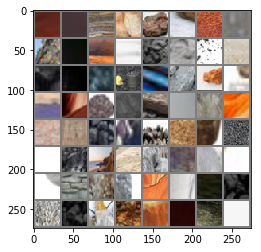

267
tensor([2, 4, 1, 4, 5, 6, 2, 3, 0, 1, 2, 5, 0, 6, 0, 0, 2, 5, 3, 4, 0, 6, 0, 5,
        0, 2, 6, 5, 1, 0, 2, 5, 0, 1, 4, 0, 0, 5, 2, 0, 6, 0, 2, 6, 4, 6, 6, 5,
        6, 6, 2, 3, 5, 2, 6, 1, 6, 0, 0, 6, 0, 5, 6, 5])
(64, 3, 32, 32)
('2_1727.jpg', '4_2075.jpg', '1_57.jpg', '4_2713.jpg', '5_1568.jpg', '6_2967.jpg', '2_1041.jpg', '3_1733.jpg', '0_4195.jpg', '1_408.jpg', '2_2548.jpg', '5_2061.jpg', '0_3822.jpg', '6_2677.jpeg', '0_6.jpg', '0_828.jpg', '2_520.jpg', '5_3394.jpg', '3_733.jpg', '4_2920.jpg', '0_425.png', '6_2754.jpg', '0_1006.jpg', '5_1583.jpg', '0_1760.jpg', '2_1914.jpg', '6_2032.jpg', '5_979.jpg', '1_385.jpg', '0_3177.jpg', '2_246.jpg', '5_2934.jpg', '0_196.jpg', '1_1012.jpg', '4_1597.jpg', '0_2269.jpg', '0_3163.jpg', '5_2920.jpg', '2_252.jpg', '0_182.jpg', '6_676.jpg', '0_1774.jpg', '2_1900.jpg', '6_2026.jpg', '4_2934.jpg', '6_2740.jpg', '6_2998.jpg', '5_1597.jpg', '6_110.jpg', '6_1249.jpg', '2_534.jpg', '3_727.jpg', '5_3380.jpg', '2_1096.jpg', '6_2768.jpg', '1_80.jpg',

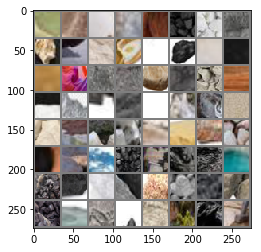

268
tensor([0, 6, 2, 3, 0, 5, 6, 3, 6, 5, 0, 0, 0, 0, 2, 0, 2, 1, 5, 1, 5, 4, 6, 4,
        2, 5, 4, 2, 5, 5, 2, 1, 4, 3, 5, 4, 5, 6, 5, 6, 5, 6, 6, 2, 5, 2, 4, 5,
        4, 5, 4, 5, 4, 3, 5, 2, 4, 1, 2, 0, 1, 4, 2, 5])
(64, 3, 32, 32)
('0_2255.jpg', '6_89.jpg', '2_1928.jpg', '3_1257.png', '0_1748.jpg', '5_951.jpg', '6_892.jpg', '3_1096.jpg', '6_1513.jpg', '5_789.jpg', '0_2241.jpg', '0_800.jpg', '0_2527.jpg', '0_4156.jpg', '2_508.jpg', '0_3639.jpg', '2_1082.jpg', '1_94.jpg', '5_1434.jpg', '1_959.png', '5_170.jpg', '4_1346.jpg', '6_3135.jpeg', '4_363.jpg', '2_2414.jpg', '5_3223.jpg', '4_73.jpg', '2_497.jpg', '5_2883.jpg', '5_3545.jpg', '2_2372.jpg', '1_232.jpg', '4_405.jpg', '3_323.JPEG', '5_616.jpg', '4_2129.jpg', '5_1352.jpg', '6_2185.jpg', '5_1346.jpg', '6_2191.jpg', '5_2897.jpg', '6_1498.jpg', '6_919.jpg', '2_2366.jpg', '5_3551.jpg', '2_3078.jpg', '4_411.jpg', '5_602.jpg', '4_1434.jpg', '5_164.jpg', '4_1352.jpg', '5_2129.jpg', '4_377.jpg', '3_690.jpg', '5_3237.jpg', '2_2400.jpg', '

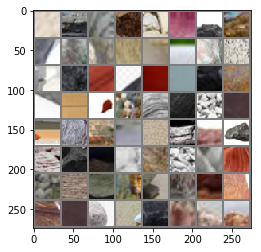

269
tensor([0, 3, 0, 5, 2, 2, 5, 1, 4, 4, 2, 0, 3, 6, 5, 4, 5, 2, 6, 6, 3, 2, 5, 4,
        4, 2, 0, 2, 6, 0, 4, 3, 5, 0, 5, 3, 1, 0, 6, 2, 0, 4, 0, 6, 4, 6, 2, 0,
        5, 5, 6, 5, 2, 3, 5, 0, 0, 6, 2, 5, 5, 3, 5, 0])
(64, 3, 32, 32)
('0_3942.jpg', '3_860.jpg', '0_2484.jpg', '5_2101.jpg', '2_2428.jpg', '2_1121.jpg', '5_1408.jpg', '1_965.png', '4_2673.jpg', '4_2115.jpg', '2_1647.jpg', '0_1833.jpg', '3_1135.jpg', '6_931.jpg', '5_3579.jpg', '4_439.jpg', '5_2667.jpg', '2_3050.jpg', '6_925.jpg', '6_3070.jpeg', '3_1121.jpg', '2_3044.jpg', '5_2673.jpg', '4_1408.jpg', '4_2101.jpg', '2_1653.jpg', '0_1827.jpg', '2_1135.jpg', '6_2813.jpg', '0_1199.jpg', '4_2667.jpg', '3_874.jpg', '5_158.jpg', '0_2490.jpg', '5_2115.jpg', '3_1647.jpg', '1_597.jpg', '0_3765.jpg', '6_1329.jpg', '2_454.jpg', '0_784.jpg', '4_1385.jpg', '0_1172.jpg', '6_2620.jpg', '4_2854.jpg', '6_2146.jpg', '2_1860.jpg', '0_1614.jpg', '5_1391.jpg', '5_2698.jpg', '6_716.jpg', '5_2840.jpg', '2_332.jpg', '3_121.jpg', '5_3586.jpg', '0_3

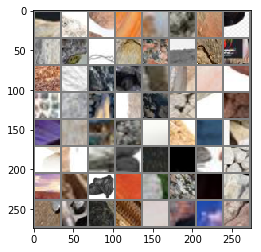

270
tensor([0, 5, 0, 4, 6, 4, 3, 0, 2, 0, 4, 4, 0, 3, 0, 2, 6, 0, 0, 0, 2, 5, 2, 3,
        0, 2, 0, 2, 3, 6, 5, 6, 2, 5, 4, 3, 6, 0, 0, 0, 0, 4, 6, 6, 4, 2, 5, 4,
        5, 5, 4, 2, 0, 0, 0, 2, 5, 1, 5, 2, 4, 4, 5, 5])
(64, 3, 32, 32)
('0_1600.jpg', '5_1385.jpg', '0_1166.jpg', '4_2698.jpg', '6_2634.jpg', '4_2840.jpg', '3_653.jpg', '0_3771.jpg', '2_440.jpg', '0_790.jpg', '4_1391.jpg', '4_2868.jpg', '0_3759.jpg', '3_1690.jpg', '0_4036.jpg', '2_468.jpg', '6_1315.jpg', '0_960.jpg', '0_2447.jpg', '0_2321.jpg', '2_3093.jpg', '5_831.jpg', '2_1684.jpg', '3_1687.JPEG', '0_1628.jpg', '2_1690.jpg', '0_2335.jpg', '2_3087.jpg', '3_91.jpg', '6_1467.jpg', '5_2868.jpg', '6_244.jpeg', '2_2399.jpg', '5_825.jpg', '4_98.jpg', '3_1684.jpg', '6_1301.jpg', '0_4022.jpg', '0_3995.jpg', '0_2453.jpg', '0_974.jpg', '4_388.jpg', '6_2608.jpg', '6_2387.jpg', '4_3035.jpg', '2_1479.jpg', '5_1150.jpg', '4_1622.jpg', '5_414.jpg', '5_2459.jpg', '4_607.jpg', '2_2170.jpg', '0_223.jpg', '0_545.jpg', '0_2862.jpg', '2_695.j

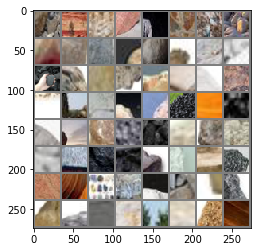

271
tensor([0, 4, 5, 3, 0, 0, 2, 1, 2, 5, 3, 2, 4, 4, 5, 3, 4, 5, 4, 2, 0, 6, 4, 5,
        5, 5, 0, 3, 4, 2, 4, 4, 2, 6, 0, 5, 2, 0, 4, 3, 5, 2, 4, 5, 0, 6, 4, 2,
        5, 4, 5, 2, 0, 3, 0, 4, 2, 6, 6, 5, 6, 6, 0, 6])
(64, 3, 32, 32)
('0_17.jpg', '4_2459.jpg', '5_1622.jpg', '3_1479.jpg', '0_2876.jpg', '0_551.jpg', '2_681.jpg', '1_742.jpg', '2_2602.jpg', '5_3035.jpg', '3_374.JPEG', '2_859.jpg', '4_175.jpg', '4_1150.jpg', '5_366.jpg', '3_1453.JPEG', '4_1636.jpg', '5_400.jpg', '4_613.jpg', '2_2164.jpg', '0_237.jpg', '6_2393.jpg', '4_3021.jpg', '5_1144.jpg', '5_428.jpg', '5_2465.jpg', '0_4591.jpg', '3_1516.JPEG', '4_3009.jpg', '2_1445.jpg', '4_2317.jpg', '4_2471.jpg', '2_1323.jpg', '6_3027.jpeg', '0_3598.jpg', '5_2303.jpg', '2_871.jpg', '0_2686.jpg', '4_1178.jpg', '3_1445.jpg', '5_3009.jpg', '2_865.jpg', '4_149.jpg', '5_2317.jpg', '0_2692.jpg', '6_299.jpg', '4_2465.jpg', '2_1337.jpg', '5_1178.jpg', '4_2303.jpg', '5_2471.jpg', '2_2158.jpg', '0_4585.jpg', '3_1323.jpg', '0_3201.jpg', '4_18

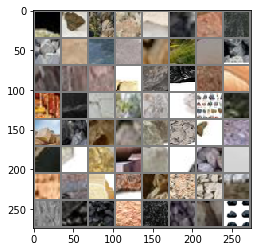

272
tensor([0, 4, 0, 2, 0, 0, 3, 6, 4, 2, 0, 2, 1, 0, 3, 6, 5, 5, 0, 6, 3, 3, 2, 6,
        4, 6, 4, 6, 6, 6, 2, 4, 4, 6, 0, 0, 0, 2, 1, 6, 0, 5, 5, 0, 0, 5, 2, 0,
        4, 0, 0, 6, 2, 3, 0, 6, 0, 3, 2, 0, 0, 6, 1, 5])
(64, 3, 32, 32)
('0_2679.jpg', '4_1187.jpg', '0_586.jpg', '2_656.jpg', '0_4208.jpg', '0_3567.jpg', '3_445.jpg', '6_266.jpg', '4_1193.jpg', '2_2819.jpg', '0_592.jpg', '2_642.jpg', '1_781.jpg', '0_3573.jpg', '3_451.jpg', '6_2436.jpg', '5_1839.jpg', '5_1187.jpg', '0_1402.jpg', '6_2350.jpg', '3_1109.png', '3_337.jpg', '2_124.jpg', '6_1659.jpg', '4_808.jpg', '6_500.jpg', '4_2.jpg', '6_1881.jpg', '6_3066.jpg', '6_2378.jpg', '2_1486.jpg', '4_1805.jpg', '4_820.jpg', '6_1671.jpg', '0_4552.jpg', '0_2123.jpg', '0_2645.jpg', '2_2831.jpg', '1_971.jpg', '6_1117.jpg', '0_4234.jpg', '5_1811.jpg', '5_1805.jpg', '0_1358.jpg', '0_2651.jpg', '5_399.jpg', '2_2825.jpg', '0_2889.jpg', '4_1811.jpg', '0_3229.jpg', '0_4546.jpg', '6_1665.jpg', '2_118.jpg', '3_1280.JPEG', '0_2137.jpg', '6_3072.jp

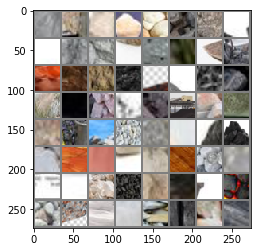

273
tensor([2, 5, 3, 2, 6, 0, 0, 4, 2, 6, 4, 0, 6, 0, 6, 4, 0, 4, 2, 3, 5, 3, 6, 0,
        0, 0, 6, 5, 0, 1, 2, 0, 2, 4, 1, 6, 6, 4, 6, 4, 6, 2, 3, 6, 0, 6, 0, 6,
        5, 6, 6, 2, 3, 4, 3, 1, 2, 0, 0, 4, 3, 0, 6, 0])
(64, 3, 32, 32)
('2_2824.jpg', '5_1804.jpg', '3_1097.JPEG', '2_1493.jpg', '6_3073.jpg', '0_2136.jpg', '0_4547.jpg', '4_835.jpg', '2_119.jpg', '6_1664.jpg', '4_1810.jpg', '0_3228.jpg', '6_529.jpg', '0_2122.jpg', '6_1670.jpg', '4_821.jpg', '0_4553.jpg', '4_1804.jpg', '2_1487.jpg', '3_875.png', '5_1810.jpg', '3_478.jpg', '6_1116.jpg', '0_4235.jpg', '0_2644.jpg', '0_1365.jpg', '6_2437.jpg', '5_1838.jpg', '0_3572.jpg', '1_780.jpg', '2_643.jpg', '0_593.jpg', '2_2818.jpg', '4_1192.jpg', '1_958.jpg', '6_267.jpg', '6_1880.jpg', '4_3.jpg', '6_501.jpg', '4_809.jpg', '6_1658.jpg', '2_125.jpg', '3_336.jpg', '6_1827.jpeg', '0_3214.jpg', '6_2351.jpg', '0_1403.jpg', '6_2345.jpg', '5_1192.jpg', '6_1894.jpg', '6_515.jpg', '2_131.jpg', '3_322.jpg', '4_1838.jpg', '3_444.jpg', '1_794.jpg',

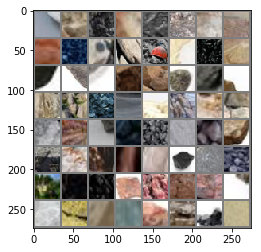

274
tensor([3, 6, 2, 4, 6, 0, 4, 2, 5, 5, 3, 3, 0, 5, 4, 5, 2, 4, 2, 4, 0, 0, 5, 5,
        4, 0, 5, 0, 3, 2, 4, 5, 4, 4, 2, 5, 1, 2, 0, 0, 5, 4, 5, 4, 6, 3, 6, 0,
        2, 6, 4, 5, 4, 0, 2, 5, 4, 6, 5, 4, 5, 2, 4, 6])
(64, 3, 32, 32)
('3_1078.JPEG', '6_2423.jpg', '2_1336.jpg', '4_2464.jpg', '6_298.jpg', '0_2693.jpg', '4_148.jpg', '2_864.jpg', '5_2316.jpg', '5_3008.jpg', '3_1444.jpg', '3_1322.jpg', '0_4584.jpg', '5_2470.jpg', '4_2302.jpg', '5_1179.jpg', '2_1450.jpg', '4_2316.jpg', '2_1444.jpg', '4_3008.jpg', '0_4590.jpg', '0_3339.jpeg', '5_2464.jpg', '5_429.jpg', '4_1179.jpg', '0_2687.jpg', '5_2302.jpg', '0_3599.jpg', '3_1450.jpg', '2_1322.jpg', '4_2470.jpg', '5_367.jpg', '4_1151.jpg', '4_174.jpg', '2_858.jpg', '5_3034.jpg', '1_743.jpg', '2_680.jpg', '0_550.jpg', '0_2877.jpg', '5_1623.jpg', '4_2458.jpg', '5_1145.jpg', '4_3020.jpg', '6_2392.jpg', '3_1644.JPEG', '6_2837.jpeg', '0_236.jpg', '2_2165.jpg', '6_1843.jpg', '4_612.jpg', '5_401.jpg', '4_1637.jpg', '0_222.jpg', '2_2171.jpg', '5

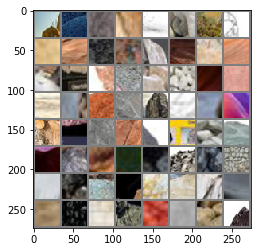

275
tensor([0, 0, 5, 5, 4, 4, 5, 2, 2, 0, 0, 2, 5, 6, 5, 2, 0, 2, 2, 6, 4, 0, 0, 6,
        0, 3, 4, 0, 0, 0, 6, 2, 3, 0, 4, 0, 2, 5, 6, 2, 0, 5, 0, 6, 0, 5, 5, 3,
        2, 5, 6, 6, 0, 0, 4, 2, 1, 3, 3, 4, 1, 6, 4, 0])
(64, 3, 32, 32)
('0_16.jpg', '0_3770.png', '5_1637.jpg', '5_373.jpg', '4_1145.jpg', '4_160.jpg', '5_3020.jpg', '2_2617.jpg', '2_694.jpg', '0_2863.jpg', '0_544.jpg', '2_2398.jpg', '5_824.jpg', '6_1466.jpg', '5_2869.jpg', '2_3086.jpg', '0_2334.jpg', '2_1849.jpg', '2_1691.jpg', '6_2609.jpg', '4_389.jpg', '0_975.jpg', '0_2452.jpg', '6_1300.jpg', '0_4023.jpg', '3_1685.jpg', '4_99.jpg', '0_2446.jpg', '0_3980.jpg', '0_4037.jpg', '6_1314.jpg', '2_469.jpg', '3_1691.jpg', '0_3758.jpg', '4_2869.jpg', '0_1629.jpg', '2_1685.jpg', '5_830.jpg', '6_1472.jpg', '2_3092.jpg', '0_2320.jpg', '5_1384.jpg', '0_1601.jpg', '6_2153.jpg', '0_3016.jpg', '5_3593.jpg', '5_818.jpg', '3_134.jpg', '2_327.jpg', '5_2855.jpg', '6_1.jpg', '6_703.jpg', '0_2308.jpg', '0_949.jpg', '4_1390.jpg', '2_441.jpg', 

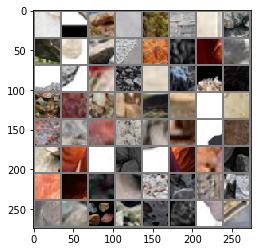

276
tensor([4, 0, 4, 2, 6, 5, 0, 1, 5, 5, 2, 0, 6, 5, 5, 0, 2, 6, 2, 4, 2, 5, 6, 3,
        3, 5, 3, 5, 0, 4, 0, 6, 2, 4, 0, 5, 6, 2, 3, 2, 1, 5, 3, 4, 5, 2, 5, 3,
        6, 0, 2, 4, 4, 5, 4, 2, 5, 6, 5, 6, 6, 0, 6, 5])
(64, 3, 32, 32)
('4_2855.jpg', '0_1173.jpg', '4_1384.jpg', '2_455.jpg', '6_1328.jpg', '5_3364.webp', '0_3764.jpg', '1_596.jpg', '5_3587.jpg', '5_2841.jpg', '2_333.jpg', '0_2206.jpeg', '6_717.jpg', '5_2699.jpg', '5_1390.jpg', '0_1615.jpg', '2_1861.jpg', '6_2147.jpg', '2_1652.jpg', '4_1409.jpg', '2_3045.jpg', '5_2672.jpg', '6_2379.png', '3_53.jpg', '3_1646.jpg', '5_2114.jpg', '3_1306.JPEG', '5_159.jpg', '0_3957.jpg', '4_2666.jpg', '0_1198.jpg', '6_2812.jpg', '2_1134.jpg', '4_2672.jpg', '0_2650.png', '5_1409.jpg', '6_2806.jpg', '2_1120.jpg', '3_1652.jpg', '2_2429.jpg', '1_569.jpg', '5_2100.jpg', '3_861.jpg', '4_438.jpg', '5_2666.jpg', '2_3051.jpg', '5_3578.jpg', '3_47.jpg', '6_930.jpg', '0_1832.jpg', '2_1646.jpg', '4_2114.jpg', '4_1435.jpg', '5_603.jpg', '4_410.jpg', '2_2

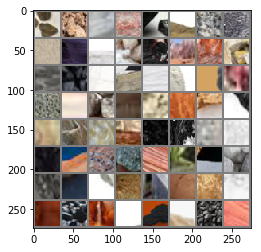

277
tensor([5, 4, 0, 2, 4, 1, 3, 5, 5, 4, 4, 5, 2, 1, 4, 2, 5, 3, 4, 4, 5, 5, 0, 4,
        3, 6, 5, 4, 4, 5, 4, 1, 5, 2, 3, 5, 5, 6, 6, 5, 0, 0, 1, 4, 2, 3, 0, 0,
        6, 2, 0, 6, 0, 6, 1, 0, 6, 2, 3, 2, 6, 0, 6, 5])
(64, 3, 32, 32)
('5_1421.jpg', '4_2882.jpg', '0_3566.png', '2_482.jpg', '4_66.jpg', '1_541.jpg', '3_691.jpg', '5_3236.jpg', '5_2128.jpg', '4_376.jpg', '4_1353.jpg', '5_165.jpg', '2_496.jpg', '1_555.jpg', '4_72.jpg', '2_2415.jpg', '5_3222.jpg', '3_685.jpg', '4_362.jpg', '4_1347.jpg', '5_171.jpg', '5_1435.jpg', '0_2969.jpeg', '4_2896.jpg', '3_1613.JPEG', '6_2184.jpg', '5_1353.jpg', '4_2128.jpg', '4_1421.jpg', '5_617.jpg', '4_404.jpg', '1_233.jpg', '5_3544.jpg', '2_2373.jpg', '3_564.JPEG', '5_2882.jpg', '5_788.jpg', '6_1512.jpg', '6_893.jpg', '5_950.jpg', '0_1991.jpg', '0_1749.jpg', '1_95.jpg', '4_2909.jpg', '2_1083.jpg', '3_1486.JPEG', '0_3638.jpg', '0_4157.jpg', '6_1274.jpg', '2_509.jpg', '0_801.jpg', '6_1260.jpg', '0_4143.jpg', '6_139.jpg', '1_81.jpg', '0_418.png', '6_

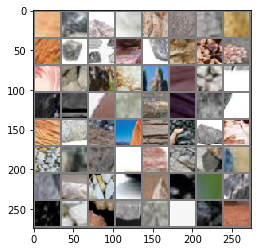

278
tensor([6, 5, 6, 2, 0, 4, 1, 0, 5, 2, 1, 0, 0, 3, 5, 2, 6, 5, 0, 6, 4, 5, 0, 6,
        0, 5, 3, 2, 3, 0, 0, 6, 6, 0, 4, 2, 5, 0, 5, 6, 2, 0, 3, 4, 2, 6, 6, 5,
        5, 4, 5, 0, 6, 0, 5, 2, 6, 2, 5, 6, 4, 1, 0, 2])
(64, 3, 32, 32)
('6_887.jpg', '5_944.jpg', '6_2027.jpg', '2_1901.jpg', '0_1775.jpg', '4_1582.jpg', '1_1007.jpg', '0_183.jpg', '5_2921.jpg', '2_253.jpg', '1_390.jpg', '0_3162.jpg', '0_3604.jpg', '3_726.jpg', '5_3381.jpg', '2_535.jpg', '6_111.jpg', '5_1596.jpg', '0_1013.jpg', '6_2741.jpg', '4_2935.jpg', '5_1582.jpg', '0_1007.jpg', '6_2755.jpg', '0_3610.jpg', '5_3395.jpg', '3_732.jpg', '2_521.jpg', '3_1469.jpeg', '0_829.jpg', '0_7.jpg', '6_105.jpg', '6_663.jpg', '0_2268.jpg', '4_1596.jpg', '2_247.jpg', '5_2935.jpg', '0_3176.jpg', '5_978.jpg', '6_2033.jpg', '2_1915.jpg', '0_1761.jpg', '3_1039.jpeg', '4_2074.jpg', '2_1726.jpg', '6_2460.jpeg', '6_850.jpg', '5_3418.jpg', '5_993.jpg', '4_558.jpg', '5_2706.jpg', '0_2283.jpg', '6_688.jpg', '0_3823.jpg', '5_2060.jpg', '2_2549.jpg

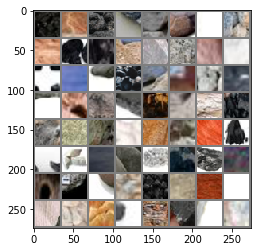

279
tensor([6, 4, 0, 5, 0, 3, 6, 3, 5, 0, 5, 0, 4, 4, 2, 0, 3, 0, 2, 1, 3, 2, 5, 4,
        5, 4, 5, 6, 6, 5, 4, 4, 1, 5, 2, 4, 3, 5, 4, 1, 2, 5, 0, 6, 2, 5, 5, 0,
        6, 2, 1, 5, 2, 2, 4, 4, 5, 0, 1, 2, 6, 2, 3, 2])
(64, 3, 32, 32)
('6_2972.jpg', '4_2706.jpg', '0_3837.jpg', '5_2074.jpg', '0_4180.jpg', '3_1726.jpg', '6_844.jpg', '3_1040.jpg', '5_987.jpg', '0_3189.jpg', '5_2712.jpg', '0_2297.jpg', '4_1569.jpg', '4_2060.jpg', '2_1732.jpg', '0_1946.jpg', '3_1068.jpg', '0_140.jpg', '2_290.jpg', '1_353.jpg', '3_1255.JPEG', '2_2213.jpg', '5_3424.jpg', '4_1541.jpg', '5_777.jpg', '4_2048.jpg', '5_1233.jpg', '6_63.jpg', '6_2782.jpg', '5_1555.jpg', '4_1227.jpg', '4_202.jpg', '1_435.jpg', '5_3342.jpg', '2_2575.jpg', '4_1233.jpg', '3_929.jpg', '5_2048.jpg', '4_216.jpg', '1_421.jpg', '2_2561.jpg', '5_3356.jpg', '0_632.jpg', '6_2796.jpg', '2_1068.jpg', '5_1541.jpg', '5_1227.jpg', '0_154.jpg', '6_878.jpg', '2_284.jpg', '1_347.jpg', '5_3430.jpg', '2_2207.jpg', '2_3119.jpg', '4_570.jpg', '4_1555.jp

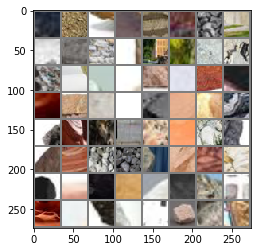

280
tensor([5, 6, 6, 4, 3, 6, 4, 0, 6, 0, 4, 4, 0, 3, 0, 4, 6, 0, 6, 2, 5, 0, 0, 1,
        2, 6, 0, 6, 0, 5, 3, 0, 6, 2, 0, 5, 3, 0, 0, 1, 4, 0, 4, 6, 0, 4, 6, 0,
        6, 0, 6, 0, 4, 6, 5, 2, 6, 2, 1, 2, 3, 5, 0, 6])
(64, 3, 32, 32)
('5_1970.jpg', '6_3107.jpg', '6_2219.jpg', '4_1964.jpg', '3_1295.jpg', '6_1710.jpg', '4_941.jpg', '0_4433.jpg', '6_449.jpg', '0_2042.jpg', '4_799.jpg', '4_1970.jpg', '0_3348.jpg', '3_1281.jpg', '0_4427.jpg', '4_955.jpg', '6_1704.jpg', '0_2056.jpg', '6_3113.jpg', '2_1295.jpg', '5_1964.jpg', '0_1239.jpg', '0_2730.jpg', '1_804.jpg', '2_2944.jpg', '6_1062.jpg', '0_3006.jpeg', '6_2543.jpg', '0_1211.jpg', '5_1794.jpg', '3_1594.JPEG', '0_2718.jpg', '6_313.jpg', '2_737.jpg', '0_4369.jpg', '5_3183.jpg', '3_524.jpg', '0_3406.jpg', '0_3360.jpg', '1_192.jpg', '4_1958.jpg', '0_381.jpg', '4_1780.jpg', '6_475.jpg', '0_1577.jpg', '4_2289.jpg', '6_2225.jpg', '0_1563.jpg', '6_2231.jpg', '0_3374.jpg', '6_1738.jpg', '0_395.jpg', '4_1794.jpg', '6_461.jpg', '5_2289.jpg', '2_

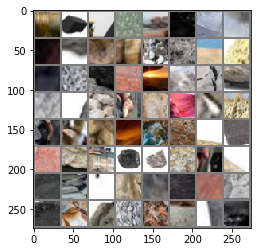

281
tensor([5, 0, 5, 4, 2, 0, 5, 5, 2, 4, 2, 5, 0, 3, 5, 4, 4, 2, 5, 4, 0, 5, 1, 2,
        4, 3, 0, 5, 5, 2, 5, 2, 4, 0, 2, 6, 0, 0, 2, 5, 1, 5, 4, 3, 5, 6, 2, 5,
        5, 4, 5, 4, 6, 3, 5, 2, 1, 0, 5, 2, 0, 4, 6, 4])
(64, 3, 32, 32)
('5_1958.jpg', '0_1205.jpg', '5_1780.jpg', '4_2510.jpg', '2_1242.jpg', '0_4396.jpg', '5_32.jpg', '5_2262.jpg', '2_910.jpg', '4_1019.jpg', '2_2993.jpg', '5_549.jpg', '0_2081.jpg', '3_1347.jpeg', '5_2504.jpg', '4_982.jpg', '4_2276.jpg', '2_1530.jpg', '5_1019.jpg', '4_2262.jpg', '0_2095.jpg', '5_2510.jpg', '1_179.jpg', '2_2039.jpg', '4_996.jpg', '3_1524.jpg', '0_4382.jpg', '5_3168.jpg', '5_26.jpg', '2_904.jpg', '5_2276.jpg', '2_2987.jpg', '4_2504.jpg', '0_2526.png', '2_1256.jpg', '6_1089.jpg', '0_2903.jpg', '0_424.jpg', '2_2777.jpg', '5_3140.jpg', '1_637.jpg', '5_213.jpg', '4_1025.jpg', '3_876.jpeg', '5_1757.jpg', '6_2580.jpg', '2_1518.jpg', '5_1031.jpg', '5_575.jpg', '4_1743.jpg', '5_2538.jpg', '4_766.jpg', '6_1937.jpg', '3_281.jpg', '5_3626.jpg', '2_2011

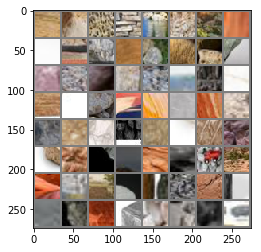

282
tensor([2, 5, 1, 0, 5, 4, 5, 3, 0, 0, 2, 1, 3, 2, 6, 5, 4, 3, 0, 2, 5, 1, 4, 6,
        4, 4, 5, 6, 5, 5, 0, 5, 2, 1, 0, 0, 5, 4, 5, 5, 2, 5, 1, 0, 6, 5, 2, 5,
        5, 6, 3, 5, 2, 1, 4, 6, 0, 5, 4, 4, 2, 5, 0, 6])
(64, 3, 32, 32)
('2_2005.jpg', '5_3632.jpg', '1_145.jpg', '0_356.jpg', '5_1025.jpg', '4_2538.jpg', '5_1743.jpg', '3_525.JPEG', '0_430.jpg', '0_2917.jpg', '2_2763.jpg', '1_623.jpg', '3_1202.jpeg', '2_938.jpg', '6_2999.png', '5_207.jpg', '4_1031.jpg', '3_552.JPEG', '0_340.jpg', '2_2013.jpg', '5_3624.jpg', '1_153.jpg', '4_1999.jpg', '6_1935.jpg', '4_764.jpg', '4_1741.jpg', '5_1033.jpg', '6_2582.jpg', '5_1755.jpg', '5_211.jpg', '0_4472.jpeg', '5_3142.jpg', '2_2775.jpg', '1_635.jpg', '0_426.jpg', '0_2901.jpg', '5_205.jpg', '4_1033.jpg', '5_2248.jpg', '5_18.jpg', '2_2761.jpg', '5_3156.jpg', '1_621.jpg', '0_2915.jpg', '6_2596.jpg', '5_1999.jpg', '2_1268.jpg', '5_1741.jpg', '5_1027.jpg', '6_2025.png', '3_297.jpg', '5_3630.jpg', '2_2007.jpg', '1_147.jpg', '4_770.jpg', '6_1921.j

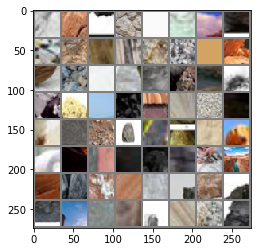

283
tensor([4, 5, 2, 2, 5, 5, 2, 0, 5, 4, 2, 4, 5, 2, 5, 5, 2, 0, 3, 0, 0, 3, 4, 0,
        4, 4, 2, 6, 6, 0, 6, 4, 0, 3, 5, 0, 6, 2, 0, 5, 3, 6, 0, 5, 6, 5, 0, 6,
        6, 2, 6, 0, 0, 0, 3, 0, 1, 0, 5, 3, 0, 4, 6, 4])
(64, 3, 32, 32)
('4_758.jpg', '5_2506.jpg', '2_39.jpg', '2_2991.jpg', '5_30.jpg', '5_2260.jpg', '2_2749.jpg', '0_4394.jpg', '5_1769.jpg', '4_2512.jpg', '2_1254.jpg', '4_2506.jpg', '5_239.jpg', '2_2985.jpg', '5_24.jpg', '5_2274.jpg', '2_906.jpg', '0_2929.jpg', '3_1526.jpg', '0_4380.jpg', '0_368.jpg', '3_1240.jpg', '4_994.jpg', '0_3389.jpg', '4_1769.jpg', '4_2260.jpg', '2_1532.jpg', '6_2227.jpg', '6_3139.jpg', '0_1575.jpg', '6_477.jpg', '4_1782.jpg', '0_383.jpg', '3_240.jpg', '5_3181.jpg', '0_3404.jpg', '6_1048.jpg', '2_735.jpg', '0_1213.jpg', '5_1796.jpg', '3_1718.png', '6_2541.jpg', '0_1207.jpg', '5_1782.jpg', '6_2555.jpg', '5_3195.jpg', '0_3410.jpg', '6_2780.png', '6_305.jpg', '2_7.jpg', '6_463.jpg', '0_2068.jpg', '0_4419.jpg', '0_397.jpg', '3_254.jpg', '0_3376.jpg', 

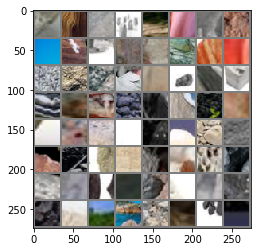

284
tensor([6, 6, 6, 0, 5, 2, 0, 2, 1, 2, 0, 6, 2, 0, 6, 5, 6, 2, 6, 6, 4, 0, 4, 0,
        6, 1, 2, 5, 4, 4, 1, 6, 5, 3, 2, 5, 6, 6, 4, 5, 5, 4, 1, 5, 2, 0, 2, 4,
        5, 4, 1, 2, 5, 2, 0, 5, 6, 4, 5, 6, 0, 1, 5, 2])
(64, 3, 32, 32)
('6_1450.jpeg', '6_966.jpeg', '6_3105.jpg', '0_1549.jpg', '5_1972.jpg', '2_1283.jpg', '0_3438.jpg', '2_709.jpg', '1_812.jpg', '2_2952.jpg', '0_2726.jpg', '6_1060.jpg', '2_2946.jpg', '0_2732.jpg', '6_339.jpg', '5_1966.jpg', '6_2569.jpg', '2_1297.jpg', '6_3111.jpg', '6_1706.jpg', '4_957.jpg', '0_4425.jpg', '4_1972.jpg', '0_624.jpg', '6_1289.jpg', '1_437.jpg', '2_2577.jpg', '5_3340.jpg', '4_200.jpg', '4_1225.jpg', '1_68.jpg', '6_2958.jpg', '5_1557.jpg', '3_532.png', '2_1718.jpg', '5_1231.jpg', '6_61.jpg', '6_2552.jpeg', '4_1543.jpg', '5_775.jpg', '5_2738.jpg', '4_566.jpg', '1_351.jpg', '5_3426.jpg', '2_2211.jpg', '0_142.jpg', '2_292.jpg', '4_1557.jpg', '5_761.jpg', '4_572.jpg', '1_345.jpg', '2_2205.jpg', '5_3432.jpg', '2_286.jpg', '0_1978.jpg', '5_1225.jpg

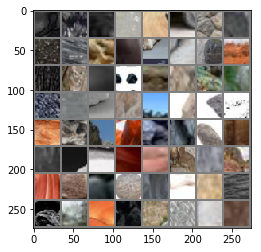

285
tensor([4, 4, 4, 1, 0, 0, 3, 5, 3, 4, 0, 5, 5, 0, 5, 6, 3, 2, 0, 0, 2, 6, 5, 4,
        5, 0, 2, 5, 3, 6, 0, 3, 5, 4, 5, 0, 4, 1, 6, 4, 6, 2, 3, 5, 0, 0, 6, 2,
        0, 5, 0, 1, 2, 5, 4, 1, 6, 2, 4, 0, 6, 1, 0, 0])
(64, 3, 32, 32)
('4_214.jpg', '4_1231.jpg', '4_2710.jpg', '1_54.jpg', '0_4196.jpg', '0_618.jpg', '3_1730.jpg', '5_2062.jpg', '3_903.jpg', '4_1219.jpg', '0_3821.jpg', '5_749.jpg', '5_2704.jpg', '0_2281.jpg', '5_991.jpg', '6_852.jpg', '3_1056.jpg', '2_1724.jpg', '0_1788.jpg', '0_1944.jpg', '2_1730.jpg', '6_49.jpg', '5_1219.jpg', '4_2062.jpg', '5_2710.jpg', '0_2295.jpg', '2_2239.jpg', '5_985.jpg', '3_1042.jpg', '6_846.jpg', '0_4182.jpg', '3_1724.jpg', '5_3368.jpg', '4_228.jpg', '5_2076.jpg', '0_3835.jpg', '4_2704.jpg', '1_40.jpg', '6_2970.jpg', '4_2937.jpg', '6_2743.jpg', '2_2285.webp', '3_769.JPEG', '5_1594.jpg', '0_1011.jpg', '0_2518.jpg', '6_113.jpg', '2_537.jpg', '0_3606.jpg', '5_3383.jpg', '0_3160.jpg', '1_392.jpg', '2_251.jpg', '5_2923.jpg', '4_1580.jpg', '1_1005.jp

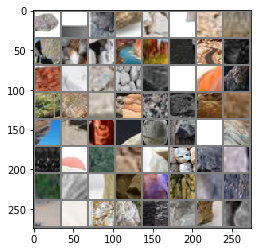

286
tensor([5, 2, 6, 4, 1, 6, 6, 5, 2, 5, 4, 6, 5, 0, 0, 6, 0, 2, 2, 1, 0, 0, 6, 5,
        6, 1, 4, 6, 5, 0, 6, 2, 6, 3, 0, 0, 3, 2, 3, 1, 0, 0, 0, 0, 6, 0, 4, 5,
        0, 4, 1, 4, 2, 5, 3, 2, 3, 4, 5, 4, 5, 6, 0, 5])
(64, 3, 32, 32)
('5_2937.jpg', '2_245.jpg', '6_1538.jpg', '4_1594.jpg', '1_1011.jpg', '6_661.jpg', '6_107.jpg', '5_2089.jpg', '2_523.jpg', '5_3397.jpg', '4_2923.jpg', '6_2757.jpg', '5_1580.jpg', '0_1005.jpg', '0_803.jpg', '6_1276.jpg', '0_4155.jpg', '2_2588.jpg', '2_1081.jpg', '1_97.jpg', '0_2097.png', '0_1993.jpg', '6_2019.jpg', '5_952.jpg', '6_891.jpg', '1_1039.jpg', '4_599.jpg', '6_649.jpg', '5_946.jpg', '0_3148.jpg', '6_1504.jpg', '2_279.jpg', '6_885.jpg', '3_1081.jpg', '0_2256.jpg', '0_1987.jpg', '3_1254.png', '2_1095.jpg', '3_1532.png', '1_83.jpg', '0_1039.jpg', '0_2530.jpg', '0_817.jpg', '0_4141.jpg', '6_1262.jpg', '0_3969.jpg', '4_1351.jpg', '5_167.jpg', '0_988.jpg', '4_374.jpg', '1_543.jpg', '4_64.jpg', '2_2403.jpg', '5_3234.jpg', '3_693.jpg', '2_480.jpg', '3_

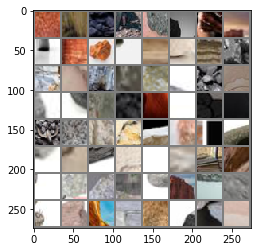

287
tensor([1, 2, 4, 4, 5, 5, 3, 2, 5, 5, 4, 4, 5, 5, 2, 6, 4, 6, 5, 4, 5, 4, 4, 3,
        5, 2, 0, 6, 4, 3, 0, 4, 5, 0, 5, 4, 3, 6, 2, 1, 5, 2, 4, 5, 2, 4, 2, 0,
        0, 3, 6, 2, 5, 5, 6, 3, 4, 0, 6, 5, 0, 0, 0, 2])
(64, 3, 32, 32)
('1_225.jpg', '2_2365.jpg', '4_412.jpg', '4_1437.jpg', '5_601.jpg', '5_2880.jpg', '3_79.jpg', '2_2371.jpg', '5_3546.jpg', '5_2658.jpg', '4_406.jpg', '4_1423.jpg', '5_615.jpg', '5_1351.jpg', '2_1678.jpg', '6_2186.jpg', '4_2894.jpg', '6_2838.jpg', '5_1437.jpg', '4_1345.jpg', '5_173.jpg', '4_360.jpg', '4_70.jpg', '3_687.jpg', '5_3220.jpg', '2_2417.jpg', '0_744.jpg', '6_2810.jpg', '4_2664.jpg', '3_877.jpg', '0_3955.jpg', '4_348.jpg', '5_2116.jpg', '0_2493.jpg', '5_3208.jpg', '4_58.jpg', '3_1122.jpg', '6_926.jpg', '2_2359.jpg', '1_219.jpg', '5_2670.jpg', '2_3047.jpg', '4_2102.jpg', '5_1379.jpg', '2_1650.jpg', '4_2116.jpg', '2_1644.jpg', '0_1830.jpg', '0_4545.png', '3_45.jpg', '6_932.jpg', '2_3053.jpg', '5_2664.jpg', '5_629.jpg', '6_3071.png', '3_863.jpg', '4

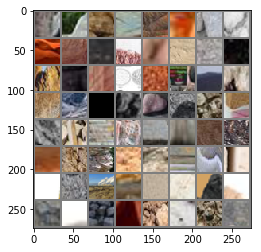

288
tensor([6, 0, 4, 0, 6, 4, 0, 0, 2, 4, 3, 6, 6, 5, 2, 6, 6, 0, 5, 6, 2, 5, 0, 6,
        2, 5, 0, 6, 2, 5, 0, 5, 3, 0, 2, 0, 4, 0, 6, 4, 0, 5, 0, 0, 0, 2, 2, 0,
        6, 2, 5, 0, 2, 6, 0, 6, 5, 3, 0, 3, 6, 3, 0, 5])
(64, 3, 32, 32)
('6_2804.jpg', '0_2327.webp', '4_2670.jpg', '0_1165.jpg', '6_2637.jpg', '4_2843.jpg', '0_3772.jpg', '0_793.jpg', '2_443.jpg', '4_1392.jpg', '3_888.jpg', '6_701.jpg', '6_3.jpg', '5_2857.jpg', '2_325.jpg', '6_1458.jpg', '6_2728.jpeg', '0_3014.jpg', '5_3591.jpg', '6_2151.jpg', '2_1877.jpg', '5_1386.jpg', '0_1603.jpg', '6_2145.jpg', '2_1863.jpg', '5_1392.jpg', '0_1617.jpg', '6_715.jpg', '2_331.jpg', '5_2843.jpg', '0_3000.jpg', '5_3585.jpg', '3_122.jpg', '0_787.jpg', '2_457.jpg', '0_4009.jpg', '4_1386.jpg', '0_2478.jpg', '6_2623.jpg', '4_2857.jpg', '0_4021.jpg', '5_198.jpg', '0_2450.jpg', '0_977.jpg', '0_1159.jpg', '2_1693.jpg', '2_3084.jpg', '0_2336.jpg', '6_1464.jpg', '2_319.jpg', '5_826.jpg', '0_3028.jpg', '2_3090.jpg', '6_729.jpg', '0_2322.jpg', '6_1470.

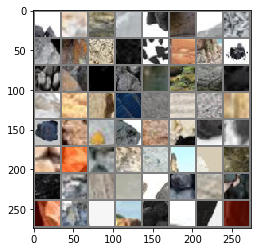

289
tensor([4, 4, 6, 2, 0, 4, 5, 5, 2, 2, 0, 0, 3, 5, 1, 5, 4, 0, 5, 4, 1, 2, 0, 0,
        5, 3, 1, 4, 5, 4, 5, 3, 0, 4, 3, 5, 4, 5, 4, 6, 4, 2, 3, 3, 2, 4, 4, 5,
        0, 3, 0, 0, 5, 2, 5, 3, 4, 0, 2, 4, 0, 5, 2, 0])
(64, 3, 32, 32)
('4_1635.jpg', '4_610.jpg', '6_1841.jpg', '2_2167.jpg', '0_234.jpg', '4_3022.jpg', '5_1147.jpg', '5_1621.jpg', '2_1308.jpg', '2_682.jpg', '0_2875.jpg', '0_552.jpg', '3_491.jpg', '5_3036.jpg', '1_741.jpg', '5_2328.jpg', '4_176.jpg', '0_1171.png', '5_365.jpg', '4_1153.jpg', '1_999.jpg', '2_696.jpg', '0_546.jpg', '0_2861.jpg', '5_3022.jpg', '3_485.jpg', '1_755.jpg', '4_162.jpg', '5_371.jpg', '4_1147.jpg', '5_1635.jpg', '3_1633.JPEG', '0_14.jpg', '4_3036.jpg', '3_136.png', '5_1153.jpg', '4_2328.jpg', '5_417.jpg', '4_1621.jpg', '6_1855.jpg', '4_604.jpg', '2_2173.jpg', '3_544.JPEG', '3_86.png', '2_1452.jpg', '4_2300.jpg', '4_1609.jpg', '5_2472.jpg', '0_208.jpg', '3_1320.jpg', '0_4586.jpg', '0_2691.jpg', '5_2314.jpg', '2_866.jpg', '5_359.jpg', '3_401.JPEG', '4

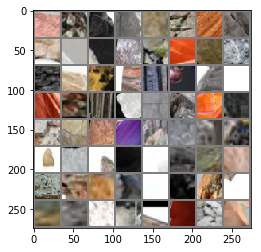

290
tensor([2, 5, 6, 4, 5, 0, 2, 4, 0, 5, 3, 3, 0, 0, 6, 6, 4, 0, 2, 6, 4, 2, 0, 3,
        1, 0, 6, 4, 0, 0, 0, 6, 0, 6, 4, 2, 0, 6, 6, 0, 1, 3, 0, 2, 5, 6, 6, 0,
        5, 6, 6, 4, 2, 3, 6, 4, 0, 2, 5, 6, 3, 6, 4, 2])
(64, 3, 32, 32)
('2_2629.jpg', '5_2300.jpg', '6_1869.jpg', '4_638.jpg', '5_2466.jpg', '0_4592.jpg', '2_1446.jpg', '4_2314.jpg', '0_1401.jpg', '5_1184.jpg', '3_728.JPEG', '3_334.jpg', '0_3216.jpg', '0_4579.jpg', '6_1882.jpg', '6_503.jpg', '4_1.jpg', '0_2108.jpg', '2_899.jpg', '6_265.jpg', '4_1190.jpg', '2_641.jpg', '0_591.jpg', '3_452.jpg', '1_782.jpg', '0_3570.jpg', '6_2435.jpg', '4_2499.jpg', '0_1367.jpg', '0_750.png', '0_1225.webp', '6_2421.jpg', '0_1373.jpg', '6_271.jpg', '4_1184.jpg', '2_655.jpg', '0_585.jpg', '6_566.jpeg', '6_1850.jpeg', '0_3564.jpg', '1_796.jpg', '3_320.jpg', '0_3202.jpg', '2_133.jpg', '5_2499.jpg', '6_1896.jpg', '6_517.jpg', '0_1415.jpg', '5_1190.jpg', '6_3059.jpg', '6_2347.jpg', '4_1812.jpg', '2_2198.jpg', '3_308.jpg', '6_1666.jpg', '4_837.jpg'

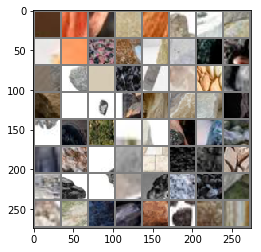

291
tensor([6, 0, 2, 0, 2, 6, 0, 5, 0, 6, 2, 4, 0, 4, 6, 0, 3, 5, 0, 0, 6, 2, 3, 2,
        1, 0, 0, 6, 4, 4, 6, 0, 2, 5, 4, 6, 0, 2, 6, 0, 3, 2, 6, 0, 5, 6, 1, 3,
        0, 2, 4, 6, 6, 0, 6, 5, 6, 5, 6, 2, 0, 0, 4, 6])
(64, 3, 32, 32)
('6_1100.jpg', '0_2646.jpg', '2_2832.jpg', '0_4237.jpg', '2_669.jpg', '6_1114.jpg', '0_3558.jpg', '5_1812.jpg', '0_1429.jpg', '6_3065.jpg', '2_1485.jpg', '4_1806.jpg', '0_4551.jpg', '4_823.jpg', '6_1672.jpg', '0_2120.jpg', '3_1645.png', '5_1813.jpg', '0_3559.jpg', '0_4236.jpg', '6_1115.jpg', '2_668.jpg', '3_1490.jpg', '2_2833.jpg', '1_973.jpg', '0_2647.jpg', '0_4550.jpg', '6_1673.jpg', '4_822.jpg', '4_1807.jpg', '6_3064.jpg', '0_1428.jpg', '2_1490.jpg', '5_854.webp', '4_836.jpg', '6_1667.jpg', '0_4544.jpg', '2_2199.jpg', '6_1101.jpg', '0_4222.jpg', '3_1484.jpg', '2_2827.jpg', '6_258.jpg', '0_2653.jpg', '5_1807.jpg', '6_2408.jpg', '1_797.jpg', '3_447.jpg', '0_584.jpg', '2_654.jpg', '4_1185.jpg', '6_270.jpg', '6_321.jpeg', '0_1372.jpg', '6_2420.jpg', '5_1

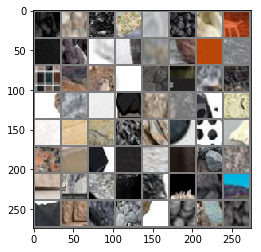

292
tensor([6, 0, 0, 3, 6, 3, 5, 0, 0, 4, 6, 1, 3, 0, 2, 4, 6, 2, 2, 5, 0, 2, 0, 2,
        5, 4, 4, 3, 4, 6, 5, 0, 0, 3, 6, 5, 4, 4, 2, 3, 2, 4, 5, 5, 0, 3, 0, 5,
        3, 4, 5, 4, 1, 2, 5, 3, 0, 0, 0, 2, 3, 0, 2, 4])
(64, 3, 32, 32)
('6_1883.jpg', '0_4578.jpg', '0_3217.jpg', '3_335.jpg', '6_2352.jpg', '3_1648.JPEG', '5_1185.jpg', '0_1400.jpg', '0_1366.jpg', '4_2498.jpg', '6_2434.jpg', '1_783.jpg', '3_1218.JPEG', '0_590.jpg', '2_640.jpg', '4_1191.jpg', '6_264.jpg', '2_898.jpg', '2_873.jpg', '5_2301.jpg', '0_2684.jpg', '2_2628.jpg', '0_29.jpg', '2_1321.jpg', '5_1608.jpg', '4_2473.jpg', '4_2315.jpg', '3_1335.jpg', '4_639.jpg', '6_1868.jpg', '5_2467.jpg', '0_4587.jpg', '0_209.jpg', '3_1321.jpg', '6_3050.jpeg', '5_2473.jpg', '4_1608.jpg', '4_2301.jpg', '2_1453.jpg', '3_1692.png', '2_1335.jpg', '4_2467.jpg', '5_358.jpg', '5_2315.jpg', '0_2848.jpg', '3_1447.jpg', '0_15.jpg', '5_1634.jpg', '3_753.JPEG', '4_1146.jpg', '5_370.jpg', '4_163.jpg', '1_754.jpg', '2_2614.jpg', '5_3023.jpg', '3_484

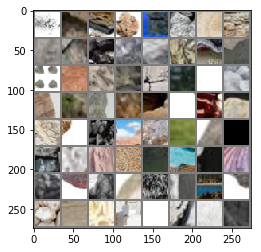

293
tensor([6, 4, 5, 4, 5, 4, 5, 6, 4, 0, 6, 6, 4, 4, 5, 4, 1, 5, 5, 4, 1, 3, 5, 2,
        0, 0, 2, 2, 5, 6, 2, 5, 3, 6, 0, 6, 2, 0, 0, 6, 5, 0, 1, 0, 0, 0, 5, 3,
        0, 6, 0, 5, 2, 6, 0, 2, 3, 2, 5, 3, 2, 5, 6, 5])
(64, 3, 32, 32)
('6_1854.jpg', '4_1620.jpg', '5_416.jpg', '4_2329.jpg', '5_1152.jpg', '4_3037.jpg', '5_1146.jpg', '6_2391.jpg', '4_3023.jpg', '0_235.jpg', '6_1698.jpg', '6_1840.jpg', '4_611.jpg', '4_1634.jpg', '5_402.jpg', '4_1152.jpg', '1_998.jpg', '5_364.jpg', '5_2329.jpg', '4_177.jpg', '1_740.jpg', '3_490.jpg', '5_3037.jpg', '2_2600.jpg', '0_553.jpg', '0_2874.jpg', '2_683.jpg', '2_1309.jpg', '5_1620.jpg', '6_2178.jpg', '2_1686.jpg', '5_833.jpg', '3_87.jpg', '6_1471.jpg', '0_2323.jpg', '6_728.jpg', '2_3091.jpg', '0_2445.jpg', '0_3983.jpg', '6_1317.jpg', '5_3411.webp', '0_4034.jpg', '1_768.png', '0_1158.jpg', '0_976.jpg', '0_2451.jpg', '5_199.jpg', '3_1686.jpg', '0_4020.jpg', '6_1303.jpg', '0_3029.jpg', '5_827.jpg', '2_318.jpg', '6_1465.jpg', '0_2337.jpg', '2_3085.jpg

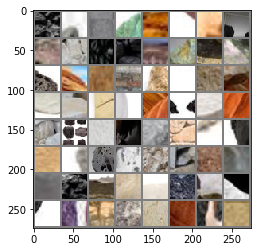

294
tensor([6, 4, 6, 0, 4, 2, 0, 0, 4, 1, 0, 4, 6, 3, 0, 0, 2, 6, 5, 0, 5, 2, 6, 6,
        5, 2, 5, 6, 3, 3, 3, 0, 2, 4, 6, 2, 0, 6, 0, 0, 5, 4, 0, 4, 5, 4, 5, 0,
        6, 4, 0, 2, 5, 0, 2, 4, 0, 5, 2, 2, 3, 6, 3, 6])
(64, 3, 32, 32)
('6_2144.jpg', '4_2856.jpg', '6_2622.jpg', '0_2479.jpg', '4_1387.jpg', '2_456.jpg', '0_786.jpg', '0_3767.jpg', '4_1393.jpg', '1_581.jpg', '0_3773.jpg', '4_2842.jpg', '6_2636.jpg', '3_991.JPEG', '0_1164.jpg', '0_1602.jpg', '2_1876.jpg', '6_2150.jpg', '5_3590.jpg', '0_3015.jpg', '5_2856.jpg', '2_324.jpg', '6_2.jpg', '6_700.jpg', '5_628.jpg', '2_3052.jpg', '5_2665.jpg', '6_933.jpg', '3_1137.jpg', '3_1536.JPEG', '3_44.jpg', '0_1831.jpg', '2_1645.jpg', '4_2671.jpg', '6_2805.jpg', '2_1123.jpg', '0_779.jpg', '6_3007.jpeg', '0_3798.jpg', '0_2486.jpg', '5_2103.jpg', '4_1378.jpg', '0_3940.jpg', '4_59.jpg', '5_3209.jpg', '4_349.jpg', '5_2117.jpg', '0_3954.jpg', '6_1893.jpeg', '4_2665.jpg', '0_1825.jpg', '2_1651.jpg', '5_1378.jpg', '0_2121.png', '2_1889.jpg', '4_21

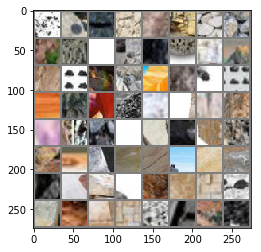

295
tensor([6, 2, 5, 5, 4, 5, 4, 2, 1, 5, 3, 2, 0, 5, 2, 4, 1, 4, 5, 4, 5, 4, 4, 5,
        4, 0, 6, 2, 3, 0, 2, 5, 1, 4, 4, 0, 5, 0, 4, 5, 4, 4, 5, 2, 1, 5, 0, 5,
        0, 0, 3, 3, 2, 5, 0, 6, 0, 0, 0, 1, 2, 1, 0, 3])
(64, 3, 32, 32)
('6_2303.jpeg', '2_1679.jpg', '5_1350.jpg', '5_614.jpg', '4_1422.jpg', '5_2659.jpg', '4_407.jpg', '2_2370.jpg', '1_230.jpg', '5_2881.jpg', '3_78.jpg', '2_495.jpg', '0_745.jpg', '5_3221.jpg', '2_2416.jpg', '4_71.jpg', '1_556.jpg', '4_361.jpg', '5_172.jpg', '4_1344.jpg', '5_1436.jpg', '4_2895.jpg', '4_2659.jpg', '5_1422.jpg', '4_2881.jpg', '0_3565.png', '6_1129.png', '2_481.jpg', '3_1679.jpg', '0_751.jpg', '2_2402.jpg', '5_3235.jpg', '1_542.jpg', '4_65.jpg', '4_375.jpg', '0_989.jpg', '5_166.jpg', '0_3968.jpg', '4_1350.jpg', '5_600.jpg', '4_1436.jpg', '4_413.jpg', '5_3553.jpg', '2_2364.jpg', '1_224.jpg', '5_2895.jpg', '0_1819.jpg', '5_1344.jpg', '0_1986.jpg', '0_2257.jpg', '3_591.JPEG', '3_1080.jpg', '2_278.jpg', '5_947.jpg', '0_4140.jpg', '6_1263.jpg', '0

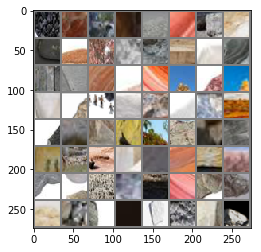

296
tensor([2, 0, 0, 6, 4, 1, 3, 6, 6, 5, 0, 6, 1, 4, 5, 6, 2, 0, 3, 2, 0, 5, 6, 6,
        4, 5, 0, 2, 0, 5, 3, 2, 0, 6, 0, 0, 5, 1, 4, 0, 5, 6, 4, 2, 0, 6, 1, 4,
        2, 5, 0, 1, 6, 1, 2, 5, 0, 5, 4, 5, 6, 2, 0, 2])
(64, 3, 32, 32)
('2_2589.jpg', '0_802.jpg', '0_2243.jpg', '6_648.jpg', '4_598.jpg', '1_1038.jpg', '3_1094.jpg', '6_890.jpg', '6_1511.jpg', '5_953.jpg', '0_1992.jpg', '6_660.jpg', '1_1010.jpg', '4_1595.jpg', '5_2936.jpg', '6_1539.jpg', '2_244.jpg', '0_3175.jpg', '3_1269.png', '2_1916.jpg', '0_1762.jpg', '5_1581.jpg', '6_730.jpeg', '6_2756.jpg', '4_2922.jpg', '5_3396.jpg', '0_3613.jpg', '2_522.jpg', '0_4.jpg', '5_3382.jpg', '3_725.jpg', '2_536.jpg', '0_4168.jpg', '6_112.jpg', '0_2519.jpg', '0_1010.jpg', '5_1595.jpg', '1_620.png', '4_2936.jpg', '0_432.jpeg', '5_2703.webp', '6_2024.jpg', '4_2088.jpg', '2_1902.jpg', '0_1776.jpg', '6_674.jpg', '1_1004.jpg', '4_1581.jpg', '2_250.jpg', '5_2922.jpg', '0_180.jpg', '1_393.jpg', '6_847.jpg', '1_378.jpg', '2_2238.jpg', '5_984.jpg',

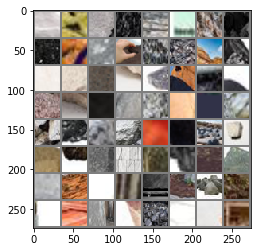

297
tensor([6, 1, 4, 0, 4, 5, 5, 4, 0, 5, 0, 3, 6, 3, 2, 6, 1, 1, 4, 0, 2, 0, 6, 3,
        0, 5, 5, 6, 5, 0, 2, 0, 2, 5, 1, 4, 5, 4, 0, 4, 4, 3, 5, 2, 1, 0, 6, 5,
        4, 3, 6, 5, 1, 4, 4, 2, 5, 1, 0, 2, 0, 5, 2, 5])
(64, 3, 32, 32)
('6_2971.jpg', '1_41.jpg', '4_2705.jpg', '0_3834.jpg', '4_229.jpg', '5_2077.jpg', '5_3369.jpg', '4_1218.jpg', '0_3820.jpg', '5_2063.jpg', '0_619.jpg', '3_1731.jpg', '6_2568.png', '3_657.JPEG', '2_1043.jpg', '6_2965.jpg', '1_55.jpg', '1_807.png', '4_2711.jpg', '0_1789.jpg', '2_1725.jpg', '0_1951.jpg', '6_853.jpg', '3_1520.JPEG', '0_2280.jpg', '5_2705.jpg', '5_748.jpg', '6_74.jpg', '5_1224.jpg', '0_1979.jpg', '2_287.jpg', '0_157.jpg', '2_2204.jpg', '5_3433.jpg', '1_344.jpg', '4_573.jpg', '5_760.jpg', '4_1556.jpg', '0_3808.jpg', '4_1230.jpg', '4_215.jpg', '3_342.JPEG', '5_3355.jpg', '2_2562.jpg', '1_422.jpg', '0_631.jpg', '6_2795.jpg', '5_1542.jpg', '4_2739.jpg', '3_533.png', '6_2959.jpg', '5_1556.jpg', '1_69.jpg', '4_1224.jpg', '4_201.jpg', '2_2576.jpg', 

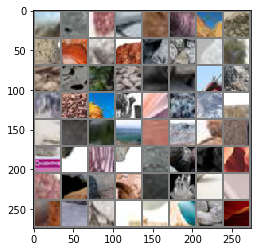

298
tensor([4, 5, 4, 5, 2, 5, 6, 0, 2, 6, 0, 3, 4, 4, 6, 0, 6, 6, 0, 4, 0, 6, 4, 3,
        5, 0, 2, 6, 2, 0, 2, 5, 3, 2, 6, 2, 3, 0, 5, 6, 5, 0, 6, 1, 1, 3, 0, 0,
        4, 0, 6, 0, 1, 3, 0, 4, 6, 0, 6, 6, 5, 6, 2, 6])
(64, 3, 32, 32)
('4_567.jpg', '5_774.jpg', '4_1542.jpg', '5_1230.jpg', '2_1296.jpg', '5_1967.jpg', '6_338.jpg', '0_2733.jpg', '2_2947.jpg', '6_1061.jpg', '0_4342.jpg', '3_269.jpg', '4_1973.jpg', '4_956.jpg', '6_1707.jpg', '0_2055.jpg', '6_3110.jpg', '6_2591.jpeg', '0_1548.jpg', '4_1967.jpg', '0_4430.jpg', '6_1713.jpg', '4_942.jpg', '3_1296.jpg', '5_589.jpg', '0_2041.jpg', '2_2953.jpg', '6_1075.jpg', '2_708.jpg', '0_3439.jpg', '2_1282.jpg', '5_1973.jpg', '3_916.png', '2_6.jpg', '6_304.jpg', '2_720.jpg', '3_529.JPEG', '0_3411.jpg', '5_3194.jpg', '6_2554.jpg', '5_1783.jpg', '0_1206.jpg', '6_2232.jpg', '1_350.png', '1_185.jpg', '3_255.jpg', '0_396.jpg', '0_4418.jpg', '4_1797.jpg', '0_2069.jpg', '6_462.jpg', '0_3363.jpg', '1_191.jpg', '3_241.jpg', '0_382.jpg', '4_1783.jpg',

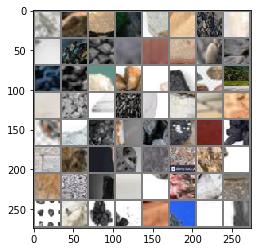

299
tensor([3, 5, 0, 0, 5, 2, 5, 5, 2, 0, 4, 2, 6, 3, 2, 4, 4, 5, 0, 4, 0, 6, 2, 4,
        6, 5, 6, 0, 5, 4, 4, 4, 5, 2, 0, 3, 2, 1, 2, 5, 5, 2, 5, 2, 6, 5, 0, 0,
        6, 2, 5, 5, 4, 5, 4, 5, 2, 6, 4, 1, 3, 5, 2, 0])
(64, 3, 32, 32)
('3_527.jpg', '5_3180.jpg', '0_4381.jpg', '0_2928.jpg', '5_2275.jpg', '2_907.jpg', '5_25.jpg', '5_238.jpg', '2_2984.jpg', '0_1522.jpeg', '4_2507.jpg', '2_1255.jpg', '6_1277.png', '3_600.jpeg', '2_1533.jpg', '4_2261.jpg', '4_1768.jpg', '5_2513.jpg', '0_3388.jpg', '4_995.jpg', '0_369.jpg', '6_3046.jpeg', '2_38.jpg', '4_759.jpg', '6_1908.jpg', '5_2507.jpg', '6_489.jpg', '0_2082.jpg', '5_3619.jpg', '4_981.jpg', '4_2275.jpg', '4_2513.jpg', '5_1768.jpg', '2_1241.jpg', '0_4395.jpg', '3_1533.jpg', '2_2748.jpg', '1_608.jpg', '2_913.jpg', '5_2261.jpg', '5_31.jpg', '2_2990.jpg', '5_1740.jpg', '2_1269.jpg', '6_2597.jpg', '5_1998.jpg', '0_433.jpg', '0_2914.jpg', '6_2742.png', '2_2760.jpg', '5_19.jpg', '5_2249.jpg', '4_1032.jpg', '5_204.jpg', '4_1754.jpg', '5_562.jpg

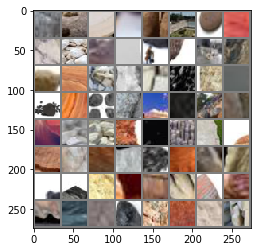

300
tensor([5, 5, 4, 4, 3, 5, 3, 4, 6, 1, 4, 2, 5, 3, 0, 0, 5, 2, 4, 5, 5, 3, 6])
(23, 3, 32, 32)
('5_1026.jpg', '5_1032.jpg', '4_2249.jpg', '4_1740.jpg', '3_1432.JPEG', '5_576.jpg', '3_315.JPEG', '4_765.jpg', '6_1934.jpg', '1_152.jpg', '4_1998.jpg', '2_2012.jpg', '5_3625.jpg', '3_282.jpg', '0_2900.jpg', '0_427.jpg', '5_3143.jpg', '2_2774.jpg', '4_1026.jpg', '5_210.jpg', '5_1754.jpg', '3_731.png', '6_2583.jpg')
<class 'torch.Tensor'>


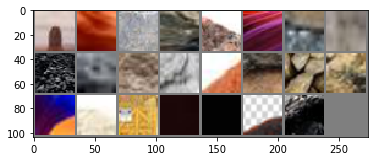

In [94]:



def imshow(img):
    img = img / 2 + 0.5
    plt.imshow(np.transpose(img.numpy(),(1,2,0)))
    plt.show()

    
dataSet=FlameSet('/Users/liuchu/Desktop/Dataset2/')
dataloader = torch.utils.data.DataLoader(dataSet, batch_size=64, shuffle=False)

for i,(images,labels,names) in enumerate(dataloader):
    print(i)
    print(labels)
    print(images.numpy().shape)
    print(names)
    v = torchvision.utils.make_grid(images)
    print(type(v))
    imshow(v)

In [ ]:
BATCH_SIZE = 128
# 学习率
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
LR = 0.1
net = ResNet(ResidualBlock).to(device)
# 定义损失函数
criterion = nn.CrossEntropyLoss()  # 损失函数为交叉熵，多用于多分类问题
# 优化方式为mini-batch momentum-SGD，并采用L2正则化（权重衰减）
optimizer = optim.SGD(net.parameters(), lr=LR, momentum=0.9, weight_decay=5e-4)
# 训练网络
# loop over the dataset multiple times
for epoch in range(5):
    running_loss = 0.0
    for i, data in enumerate(dataloader, 0):
        # 取数据
        inputs, labels,names = data
        inputs, labels = inputs.to(device), labels.to(device)  # 将输入和目标在每一步都送入GPU
        # 将梯度置零
        optimizer.zero_grad()
        # 训练
        outputs = net(inputs)
#         print(outputs.shape)
#         print(labels.shape)
#         print(names)
        loss = criterion(outputs, labels).to(device)
        loss.backward()  # 反向传播
        optimizer.step()  # 优化
        # 统计数据
        running_loss += loss.item()
        print('[%d, %5d] loss: %.3f' % (epoch + 1, i + 1, running_loss))
        running_loss = 0.0

[1,     1] loss: 2.291
[1,     2] loss: 3.314
[1,     3] loss: 4.854
[1,     4] loss: 9.691
[1,     5] loss: 6.170
[1,     6] loss: 3.583
[1,     7] loss: 2.238
[1,     8] loss: 10.934
[1,     9] loss: 7.825
[1,    10] loss: 2.220
[1,    11] loss: 4.789
[1,    12] loss: 4.513
[1,    13] loss: 3.879
[1,    14] loss: 3.968
[1,    15] loss: 5.028
[1,    16] loss: 2.714
[1,    17] loss: 4.761
[1,    18] loss: 3.274
[1,    19] loss: 4.292
[1,    20] loss: 2.897
[1,    21] loss: 2.970
[1,    22] loss: 2.967
[1,    23] loss: 3.170
[1,    24] loss: 2.889
[1,    25] loss: 5.990
[1,    26] loss: 3.671
[1,    27] loss: 3.593
[1,    28] loss: 3.052
[1,    29] loss: 2.391
[1,    30] loss: 2.797
[1,    31] loss: 2.392
[1,    32] loss: 3.692
[1,    33] loss: 2.414
[1,    34] loss: 2.571
[1,    35] loss: 3.711
[1,    36] loss: 3.201
[1,    37] loss: 2.543
[1,    38] loss: 2.586
[1,    39] loss: 1.846
[1,    40] loss: 3.102
[1,    41] loss: 2.856
[1,    42] loss: 2.214
[1,    43] loss: 2.284
[1,    44]